<a href="https://colab.research.google.com/github/LaneLewis/pgms-project/blob/main/gpml_vae.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
!pip install torch
!pip install numpy
!pip install matplotlib
!pip install tqdm
gpu_info = !nvidia-smi
gpu_info = '\n'.join(gpu_info)
if gpu_info.find('failed') >= 0:
  print('Not connected to a GPU')
else:
  print(gpu_info)

  Using cached nvidia_cuda_nvrtc_cu12-12.1.105-py3-none-manylinux1_x86_64.whl (23.7 MB)
  Using cached nvidia_cuda_runtime_cu12-12.1.105-py3-none-manylinux1_x86_64.whl (823 kB)
  Using cached nvidia_cuda_cupti_cu12-12.1.105-py3-none-manylinux1_x86_64.whl (14.1 MB)
  Using cached nvidia_cudnn_cu12-8.9.2.26-py3-none-manylinux1_x86_64.whl (731.7 MB)
  Using cached nvidia_cublas_cu12-12.1.3.1-py3-none-manylinux1_x86_64.whl (410.6 MB)
  Using cached nvidia_cufft_cu12-11.0.2.54-py3-none-manylinux1_x86_64.whl (121.6 MB)
  Using cached nvidia_curand_cu12-10.3.2.106-py3-none-manylinux1_x86_64.whl (56.5 MB)
  Using cached nvidia_cusolver_cu12-11.4.5.107-py3-none-manylinux1_x86_64.whl (124.2 MB)
  Using cached nvidia_cusparse_cu12-12.1.0.106-py3-none-manylinux1_x86_64.whl (196.0 MB)
  Using cached nvidia_nccl_cu12-2.19.3-py3-none-manylinux1_x86_64.whl (166.0 MB)
  Using cached nvidia_nvtx_cu12-12.1.105-py3-none-manylinux1_x86_64.whl (99 kB)
  Using cached nvidia_nvjitlink_cu12-12.4.127-py3-none-m

In [ ]:
import copy
import torch
from torch.nn.modules import Module
from tqdm import tqdm
from torch.utils.data import TensorDataset
from torch.utils.data import DataLoader
import gc
import matplotlib.pyplot as plt
import numpy as np
import torch
import math
import torch.nn as nn
import pickle as pkl
from torch.func import jacrev

In [ ]:
class FeedforwardNNDecoder(nn.Module):
    #NOTE this is completely untested!
    def __init__(self,layers_list,latent_dims,observed_dims,device="cpu"):
        super().__init__()
        self.layers = nn.ModuleList()
        self.input_dim = latent_dims
        input_size = latent_dims
        for size,activation in layers_list:
            linear_layer = nn.Linear(input_size,size)
            self.layers.append(linear_layer)
            input_size = size
            if activation is not None:
                assert isinstance(activation, Module),"Each tuples should contain a size (int) and a torch.nn.modules.Module."
                self.layers.append(activation)
        self.layers.append(nn.Linear(input_size,observed_dims))
        self.to(device)

    def forward(self,input_data):
        for layer in self.layers:
            input_data = layer(input_data)
        return input_data

class ParabolaDecoder(nn.Module):
    def __init__(self,alpha,device="cpu"):
        super().__init__()
        self.alpha = torch.nn.Parameter(torch.tensor(alpha,requires_grad=True,device=device))
    def forward(self,Z):
        '''takes in a two dimensional latent variable and embeds it into a 3d parabola
        Z - tensor of shape [batch_size,samples, timesteps, dims_in]
        returns X a tensor of shape [batch_size, samples, timesteps, dims_in+1]
        '''
        extra_dim = torch.linalg.norm(Z,dim=-1)**2
        return torch.cat((Z,self.alpha*extra_dim.unsqueeze(-1)),dim=-1)
        #return torch.cat((self.alpha*Z+10.0,self.alpha*Z+10.0),dim=-1)

class HighDParabolaDecoder(nn.Module):
    def __init__(self,latent_dims,observation_dims,device="cpu",alpha=10.0):
        super().__init__()
        self.alpha = torch.nn.Parameter(torch.tensor(alpha,requires_grad=True,device=device))
        self.parabola_to_embedding_layer = nn.Linear(latent_dims+1,observation_dims,device=device)

    def forward(self,Z):
        '''takes in a k dimensional latent variable and embeds it into an n d parabola
        Z - tensor of shape [batch_size,samples, timesteps, dims_in]
        returns X a tensor of shape [batch_size, samples, timesteps, dims_in+1]
        '''
        extra_dim = torch.linalg.norm(Z,dim=-1)**2
        parabola = torch.cat((Z,self.alpha*extra_dim.unsqueeze(-1)),dim=-1)
        return self.parabola_to_embedding_layer(parabola)

class FeedforwardEncoder(nn.Module):
    def __init__(self,layers_list,latent_dims,observed_dims,timesteps,device="cpu"):
        super().__init__()
        self.input_dims = observed_dims*timesteps
        self.output_dims = latent_dims*timesteps*2
        self.layers = nn.ModuleList()
        self.latent_dims = latent_dims
        input_size = self.input_dims
        for size,activation in layers_list:
            linear_layer = nn.Linear(input_size,size)
            self.layers.append(linear_layer)
            input_size = size
            if activation is not None:
                assert isinstance(activation, nn.Module),"Each tuples should contain a size (int) and a torch.nn.modules.Module."
                self.layers.append(activation)
        self.layers.append(nn.Linear(input_size,self.output_dims))
        self.to(device)

    def forward(self,x):
        batch,timesteps,observed_dims = x.shape
        u = x.reshape((batch, observed_dims*timesteps))
        for layer in self.layers:
            u = layer(u)
        out = u.reshape((batch,timesteps,2*self.latent_dims))
        means = out[:,:,self.latent_dims:]
        sds = out[:,:,:self.latent_dims]
        sds_tensor = torch.stack([torch.diag_embed(sds[batch_i,:,:].T**2 + 0.0001) for batch_i in range(sds.shape[0])])
        corr_sds = sds_tensor.permute(0,2,3,1)
        return means,corr_sds

In [ ]:
class SquareLeakyReLU(nn.Module):
    def __init__(self,alpha):
        super().__init__()
        self.alpha = alpha
        self.relu = nn.LeakyReLU(alpha)
    def forward(self,x):
        return torch.square(self.relu(x))

class PositiveLinear(nn.Module):
    #from ghub
    def __init__(self, in_features, out_features,device="cpu"):
        super(PositiveLinear, self).__init__()
        self.in_features = in_features
        self.out_features = out_features
        self.log_weight = nn.Parameter(torch.Tensor(out_features, in_features))
        self.reset_parameters()
        self.to(device)

    def reset_parameters(self):
        nn.init.xavier_uniform_(self.log_weight)

    def forward(self, input):
        return nn.functional.linear(input, self.log_weight.exp())

class ConvexLayer(nn.Module):
    def __init__(self,input_size,output_size,activation,first_layer=False,layer_minus_1_size=None,device="cpu"):
        #wasnt sure the proper way to init bias here
        if not first_layer:
            assert not (layer_minus_1_size is None)
        super().__init__()
        self.first_layer = first_layer
        self.input_u_w = PositiveLinear(input_size,output_size,device=device)
        if not first_layer:
            self.input_z_w = PositiveLinear(layer_minus_1_size,output_size,device=device)
        self.activation = activation
        self.bias = nn.Parameter(torch.Tensor(output_size))
        std = 1/math.sqrt(output_size)
        self.bias.data.uniform_(-std,std)
        self.to(device)

    def forward(self,initial_input, layer_minus_1=None):
        if not self.first_layer:
            linear_sum = self.input_u_w(initial_input) + self.input_z_w(layer_minus_1) + self.bias
        else:
            linear_sum = self.input_u_w(initial_input) + self.bias
        return self.activation(linear_sum)

class BrenierMapNN(nn.Module):
    def __init__(self,hidden_layer_sizes,input_size,alpha=0.2,device="cpu"):
        super().__init__()
        self.layers = []
        for index,layer_size in enumerate(hidden_layer_sizes):
            if index == 0:
                l = ConvexLayer(input_size,layer_size,activation=SquareLeakyReLU(alpha),first_layer=True,device=device)
            else:
                l = ConvexLayer(input_size,layer_size,activation=nn.LeakyReLU(alpha),
                                first_layer=False,layer_minus_1_size=hidden_layer_sizes[index-1],device=device)
            self.layers.append(l)
        final_layer = ConvexLayer(input_size,1,nn.LeakyReLU(alpha),first_layer=False,layer_minus_1_size=layer_size,device=device)
        self.layers.append(final_layer)
        self.layers = nn.ModuleList(self.layers)
    def forward_convex(self,u):
        z = u
        for index, l in enumerate(self.layers):
            if index == 0:
                z = l(u)
            else:
                z = l(u, z)
        return z
    def forward(self, u):
        return batched_jacobian(self.forward_convex,u)

def batched_jacobian(func,inputs):
    return torch.squeeze(torch.vmap(jacrev(func))(inputs))

class ConvexFeedforward(nn.Module):
    def __init__(self, first_map_layer_sizes, second_map_layer_sizes,latent_dims,observed_dims,device="cpu"):
        super().__init__()
        self.latent_dims = latent_dims
        self.observed_dims = observed_dims
        self.first_map_layer_sizes = first_map_layer_sizes
        self.second_map_layer_sizes = second_map_layer_sizes
        self.first_map = BrenierMapNN(first_map_layer_sizes,latent_dims,device=device)
        self.second_map = BrenierMapNN(second_map_layer_sizes,observed_dims,device=device)
        self.betas = torch.concat([torch.eye(latent_dims,requires_grad=False,device=device),torch.zeros(observed_dims - latent_dims,latent_dims,requires_grad=False,device=device)])
        self.to(device)
    def forward(self,latent_input):
        collapsed = math.prod(latent_input.shape[0:-1])
        batch_collapsed_input = latent_input.reshape((collapsed,latent_input.shape[-1]))
        out_shape = list(latent_input.shape)
        out_shape[-1] = self.observed_dims
        v = self.first_map.forward(batch_collapsed_input)
        v = torch.matmul(self.betas,v.T).T
        v = self.second_map.forward(v)
        out_v = v.reshape(out_shape)
        return out_v

In [ ]:

class GPMLDataStruct():
    def __init__(self,latent_dims,observation_dims,taus=None,R_diag=None,
                 signal_sds=None,noise_sds=None,forward_model=None,device="cpu"):
        self.observation_dims = observation_dims
        self.latent_dims = latent_dims
        if taus == None:
            self.log_taus = torch.rand((latent_dims),requires_grad=False,device=device)
        else:
            assert len(taus) == latent_dims
            log_taus = [math.log(tau) for tau in taus]
            self.log_taus = torch.tensor(log_taus,requires_grad=False,device=device)
        #initializes R
        if R_diag == None:
            self.log_R_diag = torch.rand((self.observation_dims),requires_grad=False,device=device)
        else:
            assert len(R_diag) == observation_dims
            log_R_diag = [math.log(r) for r in R_diag]
            self.log_R_diag = torch.tensor(log_R_diag,requires_grad=False,device=device)
        #initializes signal sds
        if signal_sds == None:
            self.signal_sds = (1.0 - 0.01)*torch.ones((self.latent_dims),requires_grad=False,device=device)
        else:
            assert len(signal_sds) == latent_dims
            self.signal_sds = torch.tensor(signal_sds,requires_grad=False,device=device)
        #initializes noise_sds
        if noise_sds == None:
            self.noise_sds = 0.01*torch.ones((self.latent_dims),requires_grad=False,device=device)
        else:
            assert len(noise_sds) == latent_dims
            self.noise_sds = torch.tensor(noise_sds,requires_grad=False,device=device)
        if forward_model == None:
            self.forward_model = nn.Linear(latent_dims,observation_dims)
        else:
            self.forward_model = forward_model
        self.device=device
        assert self.log_taus.shape == self.signal_sds.shape == self.noise_sds.shape
        assert len(self.log_R_diag) == self.observation_dims

    def sde_kernel_matrices(self,times:torch.Tensor)->torch.Tensor:
        '''implements simultaneous construction of the sde kernal
            for multiple taus, signal_sds, noise_sds

            timesteps - tensor of floats with shape (timesteps)
            taus - tensor of shape (latent_dims): time consts of each GP
            signal_sds - tensor of shape (latent_dims): signal_sds of the GP
            noise_sds - tensor of shape (latent_dims): noise_sds of the GP

            returns kernels - tensor of shape [timesteps,timesteps,latent_dims]:
                                which gives the kernal matrices for each latent_dim
        '''
        #NOTE: this function passes its test cases
        taus = torch.exp(self.log_taus)
        timesteps = times.shape[0]
        data_times_square = torch.outer(torch.square(times),torch.ones(timesteps,device=self.device,requires_grad=False))
        exp_shared_term = -1*(data_times_square + data_times_square.T - 2 * torch.outer(times,times))
        exp_taus_term = 2*torch.square(taus)
        #has shape [timesteps,timesteps,latent_dims]
        signal_term = (self.signal_sds**2)*torch.exp(exp_shared_term.unsqueeze(2)/exp_taus_term)
        noise_term = (self.noise_sds**2)*(torch.eye(timesteps,device=self.device).unsqueeze(2))
        output_matrix =  signal_term + noise_term
        return output_matrix

    def taus(self):
        return torch.exp(self.log_taus)

    def R_diag(self):
        return torch.exp(self.log_R_diag)

    def sample_model(self,samples,times):
        kernel_matrices = self.sde_kernel_matrices(times)
        R = torch.diag(self.R_diag())
        time_steps = torch.zeros(kernel_matrices.shape[0],device=self.device)
        prior_samples = torch.distributions.MultivariateNormal(time_steps,kernel_matrices.permute(2,0,1)).sample((samples,)).permute(0,2,1)
        decoding_manifold_means = self.forward_model.forward(prior_samples)
        data_samples = torch.distributions.MultivariateNormal(decoding_manifold_means,R).sample((1,)).squeeze()
        return prior_samples, data_samples

In [ ]:
def sample_encoding_dist(encoding_mus:torch.Tensor,encoding_Sigmas:torch.Tensor,samples:int)->torch.Tensor:
    '''
    samples from the encoding distribution a number of times equal to samples

    encoding_mus - tensor of shape [batch_size,timesteps,latent_dims]
    encoding_Sigmas - tensor of shape [batch_size,time_steps,timesteps,latent_dims]

    returns encoding_samples - shape[batch_size,samples,timesteps,latent_dims]:
                                samples from the encoding distribution
    '''
    #consistent batch size
    assert encoding_mus.shape[0] == encoding_Sigmas.shape[0] == encoding_mus.shape[0]
    #consistent timestep size
    assert encoding_mus.shape[1] == encoding_Sigmas.shape[1] == encoding_Sigmas.shape[2]
    #consistent latent_dims
    assert encoding_mus.shape[2] == encoding_Sigmas.shape[3]

    batch_size = encoding_mus.shape[0]
    timesteps = encoding_mus.shape[1]
    latent_dims = encoding_mus.shape[2]
    #permutes to allow broadcasting
    batch_flat_mus = torch.permute(encoding_mus,(0,2,1)).reshape(batch_size,timesteps*latent_dims)
    batch_flat_covs = torch.vmap(convert_to_flat_cov)(encoding_Sigmas)
    batch_dist = torch.distributions.MultivariateNormal(batch_flat_mus,batch_flat_covs)
    flat_samples = batch_dist.rsample((samples,))
    #samples are currently flat, they need to be unflattened
    reshaped_samples = flat_samples.reshape(samples,batch_size,latent_dims,timesteps).permute((1,0,3,2))
    return reshaped_samples


def kl_divergence(encoding_mus:torch.Tensor,encoding_Sigmas:torch.Tensor,K:torch.Tensor,device="cpu")->torch.Tensor:
    '''
    computes the kl divergence between the encoding distribution and the prior distribution across batches
    encoding_mus - tensor of shape [batch_size, timesteps, latent_dims]
    encoding_Sigmas - tensor of shape [batch_size, timesteps, timesteps, latent_dims]
    K - tensor of shape [timesteps, timesteps, latent_dims]

    returns kl_divergences - tensor of shape [batch_size]
    '''
    #NOTE passes its unit test, should have more since there is some method overlap between test and this
    assert encoding_mus.shape[0] == encoding_Sigmas.shape[0]
    assert encoding_mus.shape[1] == encoding_Sigmas.shape[1] == K.shape[0] == K.shape[1]
    assert encoding_mus.shape[2] == encoding_Sigmas.shape[3] == K.shape[2]
    batch_size = encoding_mus.shape[0]
    timesteps = encoding_mus.shape[1]
    latent_dims = encoding_mus.shape[2]
    block_diag_K = torch.block_diag(*[K[:,:,i] for i in range(K.shape[2])])

    #permutes in order to reshape correctly into flattened
    batch_flat_mus = torch.permute(encoding_mus,(0,2,1)).reshape(batch_size,timesteps*latent_dims)
    batch_flat_covs = torch.vmap(convert_to_flat_cov)(encoding_Sigmas)
    batched_normal_dist = torch.distributions.MultivariateNormal(batch_flat_mus,batch_flat_covs)
    target_dist = torch.distributions.MultivariateNormal(torch.zeros(timesteps*latent_dims,requires_grad=False,device=device),block_diag_K)
    return torch.distributions.kl.kl_divergence(batched_normal_dist,target_dist)

def convert_to_flat_cov(single_encoding_Sigmas):
    '''
    single_encoding_Sigmas - shape [timesteps,timesteps,latent_dims] : covariance matrices across latents
    return flat_block_cov - shape [timesteps*latent_dims,timesteps*latent_dims] :
                            block diagonal cov matrix for covariance of flattened distribution
    '''
    return torch.block_diag(*map(torch.squeeze, single_encoding_Sigmas.split(1,dim=2)))

def ll_loss(batch_X,decoding_manifold_means,R):

    #decoding_manifold_means shape [batchsize, samples, timesteps, observed_dims]
    data_dist = torch.distributions.MultivariateNormal(decoding_manifold_means.permute(1,0,2,3),R)
    #testing
    data_prob = data_dist.log_prob(batch_X)
    summed_over_time = torch.sum(data_prob,dim=2)
    return summed_over_time.permute(1,0)

class GPML_VAE(nn.Module,GPMLDataStruct):
    def __init__(self,device:str,latent_dims:int,observation_dims:int,times:torch.Tensor,
                 encoder_model:object,decoder_model:object,
                 signal_sds:list[float]=None, noise_sds:list[float]=None,
                 initial_taus:list[float]=None,initial_R_diag:list[float]=None,
                 train_taus = True, train_R_diag = True, train_decoder=True,train_encoder=True)->object:
        '''
        Implements the GPML framework.
        device - torch device to use
        latent_dims - int specifying the number of latent dims (Z)
        observation_dims - int specifying the number of observation dims (X)
        times - tensor of times specifying the time of each observation
        signal_sds - list of positive floats (size latent_dims) specifying the signal sd of the GP covariance
                    None initializes all parameters to 1.0 - 0.001
        noise_sds - list of positive floats (size latent_dims) specifying the signal sd of the GP covariance
                    None initializes all parameters to 0.001
        initial_taus - list of positive floats (size latent_dims) specifying the time constant of the GP covariance.
                       None initializes the parameters randomly
        initial_R_diag - list of positive floats (size latent_dims) specifying the diagonal noise of the observations (X)
        encoder_model - object with methods: .parameters() which returns the an iterator on the model parameters
                                             .forward(X) -> mu, Sigma.
                                                This function takes data and returns the mean and covariance of a mv normal distribution.
                                                X has shape [batch_size,timesteps,observation_dims]
                                                mu has shape [batch_size,timesteps,latent_dims]
                                                Sigma has shape [batch_size,timesteps,latent_dims,latent_dims]
        decoder_model - .parameters() which returns the an iterator on the model parameters
                        .forward(Z) -> manifold_mean
                            This function takes in samples from the latent space and returns the mean
                            of the random manifold that the data is generated from.
                            Z has shape [batch_size,samples,timesteps,observation_dims]
        '''
        self.latent_dims = latent_dims
        self.observation_dims = observation_dims
        #initializes tau
        #initialize base classes
        nn.Module.__init__(self)
        GPMLDataStruct.__init__(self,latent_dims,observation_dims,initial_taus,
                                initial_R_diag,signal_sds,noise_sds,decoder_model,device)
        #builds all the passed internal variables
        self.encoder_model = encoder_model
        self.timesteps = times.shape[0]
        self.times = times
        #adds to the parameter set
        self.log_R_diag = nn.Parameter(self.log_R_diag)
        self.log_taus = nn.Parameter(self.log_taus)
        self.device = device

        if train_taus:
            self.log_taus.requires_grad = True
        else:
            self.log_taus.requires_grad = False
        if train_R_diag:
            self.log_R_diag.requires_grad = True
        else:
            self.log_R_diag.requires_grad = False
        if train_decoder:
            for p in decoder_model.parameters():
                p.requires_grad = True
        else:
            for p in decoder_model.parameters():
                p.requires_grad = False
        if train_encoder:
            for p in encoder_model.parameters():
                p.requires_grad = True
        else:
            for p in encoder_model.parameters():
                p.requires_grad = False

    def forward(self,X,approx_elbo_samples=1,loss_hyper=1.0):
        Ks = self.sde_kernel_matrices(self.times)
        encoding_mus,encoding_Sigmas = self.encoder_model.forward(X)
        #computes the ll expectation term
        encoding_dist_samples = sample_encoding_dist(encoding_mus,encoding_Sigmas,approx_elbo_samples)
        decoding_manifold_means = self.forward_model.forward(encoding_dist_samples)

        log_likelihood_sample_losses = ll_loss(X,decoding_manifold_means,torch.diag(self.R_diag()))
        approx_individual_log_likelihood= torch.mean(log_likelihood_sample_losses,dim=1)
        #computes the kl divergence term
        kl_divergence_term = kl_divergence(encoding_mus,encoding_Sigmas,Ks,device=self.device)
        #combines them together to get the approximate elbo per item in the batch
        #print(torch.sum(kl_divergence_term))
        individual_elbos = -1*approx_individual_log_likelihood + loss_hyper*kl_divergence_term
        return individual_elbos, kl_divergence_term, -1*approx_individual_log_likelihood

    def fit(self,X_train:torch.Tensor,X_validation:torch.Tensor,lr=0.001,epochs=100,batch_size=1,approx_elbo_loss_samples=100,
            log_save_name="latest",hyper_scheduler=None,save_cycle=100,grad_clip=0.01,mm=0.4,plotting_true_taus=None,
            plotting_true_R_diag=None):
        '''
        X_train- tensor of shape (iid_samples,time_steps,observation_dims): Gives the training data consisting of
                     data assumed to be generated by independent gaussian process latents with an sde kernel and then
                     tranformed onto a nonlinear statistical manifold and then sampled from with a normal distribution.
        encoder_optimizer - optimizer object that implements the method .step() which is called after every batch:
                            optimizer for the encoder model parameters.
        decoder_optimizer - optimizer object that implements the method .step() which is called after every batch:
                            optimizer for the encoder model parameters.
        optimize_taus - bool: indicates whether or not to run the optimizer on taus
        optimize_R - bool: indicates whether or not to run the optimizer on R
        batch_size - int: indicates the batch size to split the data into for each gradient step
        '''
        #constructs an optimizer for the parameters tau and R, makes a dummy optimizer if none is passed
        self.taus_trajectory = []
        self.R_diag_trajectory = []
        self.validation_loss = []
        self.training_loss = []
        self.neg_ll_train_loss = []
        self.kl_loss = []
        optimizer = torch.optim.SGD(self.parameters(),lr=lr,momentum=mm)
        #optimizer = torch.optim.Adam(self.parameters(),lr=lr)
        #constructs an optimizer for the parameters tau and R, makes a dummy optimizer if none is passed
        #begins the main training loop
        batched_X_train = DataLoader(TensorDataset(X_train),batch_size=batch_size,shuffle=False,drop_last=False)
        for epoch in tqdm(range(epochs),desc=f"VAE Fit",colour="cyan"):
            if not hyper_scheduler is None:
                hyper_param = hyper_scheduler(epoch)
            else:
                hyper_param = 1.0
            epoch_total_losses = []
            epoch_kl_losses = []
            epoch_neg_ll_losses = []
            for (batch_X,) in batched_X_train:
                optimizer.zero_grad()
                batch_neg_elbos,batch_kls,batch_neg_lls = self.forward(batch_X,approx_elbo_loss_samples,loss_hyper=hyper_param)
                loss = torch.mean(batch_neg_elbos)
                loss.backward()
                #clips the grad
                torch.nn.utils.clip_grad_norm_(self.parameters(), grad_clip)
                #steps the grad
                optimizer.step()
                #training loss
                epoch_total_losses.append(loss.clone().detach())
                epoch_neg_ll_losses.append(torch.mean(batch_neg_lls).clone().detach())
                epoch_kl_losses.append(torch.mean(batch_kls).clone().detach())

            self.training_loss.append(np.mean(torch.stack(epoch_total_losses).cpu().numpy()))
            self.neg_ll_train_loss.append(np.mean(torch.stack(epoch_neg_ll_losses).cpu().numpy()))
            self.kl_loss.append(np.mean(torch.stack(epoch_kl_losses).cpu().numpy()))
            self.taus_trajectory.append(self.taus().clone().detach().cpu().numpy())
            self.R_diag_trajectory.append(self.R_diag().clone().detach().cpu().numpy())
            gc.collect()
            if not X_validation is None:
                with torch.no_grad():
                    validation_neg_lls = self.forward(X_validation,approx_elbo_loss_samples)[0]
                    self.validation_loss.append(torch.mean(validation_neg_lls).clone().detach().numpy())
            if epoch%save_cycle == 0:
                plot_loss(self.training_loss,self.neg_ll_train_loss,self.kl_loss,self.validation_loss,log_save_name)
                plot_taus(self.taus_trajectory,log_save_name,plotting_true_taus)
                plot_R_diag(self.R_diag_trajectory,log_save_name,plotting_true_R_diag)

def save_log(data,filename):
    with open(f"./logs/{filename}.pkl","wb") as f:
        pkl.dump(data,f)

def plot_loss(epochs_total_loss,epochs_ll_loss,epochs_kl_loss,epochs_validation_loss,filename):
    epochs = range(len(epochs_total_loss))
    plt.title(f"GPML VAE Estimator: {filename} Loss Over Epochs")
    last_total_loss = '%.4f'%(epochs_total_loss[-1])
    last_kl_loss = '%.4f'%(epochs_ll_loss[-1])
    last_ll_loss =  '%.4f'%(epochs_kl_loss[-1])
    plt.plot(epochs,epochs_total_loss,color="black",label=f"Total Loss: {last_total_loss}")
    plt.plot(epochs,epochs_ll_loss,color = "red",label=f"LL Loss: {last_kl_loss}")
    plt.plot(epochs,epochs_kl_loss,color="blue",label=f" KL Loss: {last_ll_loss}")
    if len(epochs_validation_loss) > 0:
        plt.plot(epochs,epochs_validation_loss,label="Test Loss",color="purple")
    plt.ylabel("Loss")
    plt.xlabel("Epochs")
    plt.yscale("symlog")
    plt.legend()
    plt.show()
    plt.savefig(f"./{filename}_Loss.png")
    plt.cla()

def plot_taus(epochs_taus,filename,true_taus=None):
    if not true_taus is None:
      for tau in true_taus:
          plt.axhline(tau,color="red",linestyle="--")
    epochs = range(len(epochs_taus))
    plt.title(f"GPML VAE Estimator: {filename} Taus Over Epochs")
    epochs_taus = np.array(epochs_taus)
    for tau_i in range(epochs_taus.shape[1]):
      decimals = '%.4f'%(epochs_taus[-1,tau_i])
      plt.plot(epochs,epochs_taus[:,tau_i],label=f"{decimals}")
    plt.ylabel("Tau")
    plt.xlabel("Epochs")
    plt.legend()
    plt.show()
    plt.savefig(f"./{filename}_Taus.png")
    plt.cla()

def plot_R_diag(epochs_R_diag,filename,true_R_diag=None):
    if not true_R_diag is None:
      for r in true_R_diag:
          plt.axhline(r,color="red", linestyle="--")
    epochs = range(len(epochs_R_diag))
    plt.title(f"GPML VAE Estimator: {filename} R Over Epochs")
    epochs_R_diag = np.array(epochs_R_diag)
    for r_i in range(epochs_R_diag.shape[1]):
      decimals = '%.4f'%(epochs_R_diag[-1,r_i])
      plt.plot(epochs,epochs_R_diag[:,r_i],label=f"{decimals}")
    plt.ylabel("R")
    plt.xlabel("Epochs")
    plt.legend()
    plt.show()
    plt.savefig(f"./{filename}_R_diag.png")
    plt.cla()

def cycle_scheduler(epochs,cycle_length,stop_cycle=0.9,ratio=0.5):
    full_value_epochs = math.floor(epochs*stop_cycle)
    num_cycles = math.floor(full_value_epochs/cycle_length)
    cycles = 0
    out = []
    for epoch in range(epochs):
        if cycles == num_cycles:
            out.append(1)
        else:
            if epoch%cycle_length == 0:
                cycles += 1
            cycle_dist = (epoch - math.floor(epoch/cycle_length)*cycle_length)/(ratio*cycle_length)
            cycle_dist = min(cycle_dist,1)
            out.append(cycle_dist)
    return out

def cycler(epochs, cycle_length,stop_cycle=0.9,ratio=0.5):
    out = cycle_scheduler(epochs,cycle_length,stop_cycle,ratio=0.5)
    def n_one(epoch):
        return out[epoch]
    return n_one

In [ ]:
class HighDParabolaDecoder(nn.Module):
    def __init__(self,latent_dims,observation_dims,device="cpu",alpha=1.0):
        super().__init__()
        self.alpha = torch.nn.Parameter(torch.tensor(alpha,requires_grad=True,device=device))
        self.parabola_to_embedding_layer = nn.Linear(latent_dims+1,observation_dims,device=device)
        self.parabola_mixing = nn.Linear(latent_dims,latent_dims,device=device)

    def forward(self,Z):
        '''takes in a k dimensional latent variable and embeds it into an n d parabola
        Z - tensor of shape [batch_size,samples, timesteps, dims_in]
        returns X a tensor of shape [batch_size, samples, timesteps, dims_in+1]
        '''
        extra_dim = torch.linalg.norm(Z,dim=-1)**2
        #mixing_Z = self.parabola_mixing(Z)
        parabola = torch.cat((Z,self.alpha*extra_dim.unsqueeze(-1)),dim=-1)
        return self.parabola_to_embedding_layer(parabola)

class LinearDecoder(nn.Module):
    def __init__(self,latent_dim,observed_dim,init_vals = None,device="cpu"):
        super().__init__()
        self.weights = nn.Linear(latent_dim,observed_dim,device=device)
        if not init_vals is None:
            with torch.no_grad():
                self.weights.weight.copy_(init_vals)
    def forward(self,z):
        return self.weights(z)

def dataset_constructor(forward_model,latent_dims,observed_dims,time_start=0.0,time_end=10.0,time_divisions=10,
            R_diag = [0.1,0.1,0.1],taus=[2.0,5.0],signal_sds = 0.99,
            noise_sds = 0.01,samples = 1000,device="cpu"):
    times = torch.linspace(time_start,time_end,time_divisions,device=device,requires_grad=False)
    true_model = GPMLDataStruct(latent_dims,observed_dims,taus,R_diag,
                                [signal_sds]*latent_dims,[noise_sds]*latent_dims,
                                forward_model,device=device)
    Z,X = true_model.sample_model(samples,times)
    variable_dict = {"times":times,"X":X,"taus":torch.tensor(taus,device=device,requires_grad=False),
                     "R_diag":torch.tensor(R_diag,device=device,requires_grad=False),"Z":Z,"model":true_model}
    return variable_dict

class LinearEncoder(nn.Module):
    def __init__(self,latent_dim,observed_dim,timesteps,device="cpu"):
        super().__init__()
        self.weights = nn.Linear(observed_dim*timesteps,2*latent_dim*timesteps,device=device)
        self.latent_dims = latent_dim
        self.observed_dims = observed_dim
    def forward(self,x):
        #x has shape batch, observed_dims, timesteps
        batch,timesteps,observed_dims = x.shape
        x_in = x.reshape((batch, observed_dims*timesteps))
        x_out = self.weights(x_in)
        out = x_out.reshape((batch,timesteps,2*self.latent_dims))
        means = out[:,:,self.latent_dims:]
        sds = out[:,:,:self.latent_dims]
        sds_tensor = torch.stack([torch.diag_embed(sds[batch_i,:,:].T**2 + 0.0001) for batch_i in range(sds.shape[0])])
        corr_sds = sds_tensor.permute(0,2,3,1)
        return means,corr_sds

class FeedforwardEncoder(nn.Module):
    def __init__(self,layers_list,latent_dims,observed_dims,
                 timesteps,device="cpu",rank=0):
        super().__init__()
        self.input_dims = observed_dims*timesteps
        self.output_dims = latent_dims*timesteps*(2+rank)
        self.layers = nn.ModuleList()
        self.latent_dims = latent_dims
        self.rank = rank
        input_size = self.input_dims
        for size,activation in layers_list:
            linear_layer = nn.Linear(input_size,size)
            self.layers.append(linear_layer)
            input_size = size
            if activation is not None:
                assert isinstance(activation, nn.Module),"Each tuples should contain a size (int) and a torch.nn.modules.Module."
                self.layers.append(activation)
        self.layers.append(nn.Linear(input_size,self.output_dims))
        self.to(device)

    def forward(self,x):
        batch,timesteps,observed_dims = x.shape
        u = x.reshape((batch, observed_dims*timesteps))
        for layer in self.layers:
            u = layer(u)
        out = u.reshape((batch,timesteps,(2+self.rank)*self.latent_dims))
        means = out[:,:,:self.latent_dims]
        sds = out[:,:,self.latent_dims:2*self.latent_dims]
        sds_tensor = torch.stack([torch.diag_embed(sds[batch_i,:,:].T**2 + 0.0001) for batch_i in range(sds.shape[0])])
        corr_sds = sds_tensor.permute(0,2,3,1)
        for r in range(self.rank):
            rank_vecs = out[:,:,(r+2)*self.latent_dims:(r+3)*self.latent_dims]
            corr_sds += torch.einsum("bil,bjl -> bijl",rank_vecs,rank_vecs)
        return means,corr_sds

class TestEncoder(nn.Module):
    def __init__(self,latent_dims,times,model:GPMLDataStruct,device="cpu"):
        super().__init__()
        self.model = model
        self.kernels = model.sde_kernel_matrices(times)
        self.means = torch.zeros((len(times),latent_dims,))
        self.times = times
        self.latent_dims = latent_dims

    def forward(self,x):
        batch_size = x.shape[0]
        self.means = torch.zeros((batch_size,len(self.times),self.latent_dims))
        out_kernels = torch.stack(batch_size*[self.kernels])
        return self.means, out_kernels


def get_mean_var(data):
    #data = [batch_size, timesteps, latents]
    batch_size,timesteps,latents = data.shape
    batch_collapsed = data.reshape(batch_size*timesteps,latents)
    variances = torch.var(batch_collapsed,dim=0)
    means = torch.mean(batch_collapsed,dim=0)
    return means, variances
def plot_dataset(dataset, index):

    plt.title("Example Latent Sample")
    plt.xlabel("Time")
    plt.ylabel("Z")
    latent = dataset["Z"][index]
    for i in range(latent.shape[1]):
        plt.plot(dataset["times"].cpu(),latent[:,i].cpu(),label=f"Tau: {dataset['taus'][i]}")
    plt.legend()
    plt.show()
    #plt.savefig(f"./logs/Z_sample{index}.png")
    plt.cla()

    plt.title("Example X Sample")
    plt.xlabel("Time")
    plt.ylabel("X")
    X = dataset["X"][index]
    print(X.shape)
    for i in range(X.shape[1]):
        plt.plot(dataset["times"].cpu(),X[:,i].cpu(),label=f"neuron {i}")
    plt.legend()
    plt.show()
    #plt.savefig(f"./logs/X_sample{index}.png")
    plt.cla()

def working_1d(true_tau = 1.0):
    device = "cpu"
    latent_dims = 1
    observation_dims = 2
    true_taus = [true_tau]
    true_R_diag = [0.001]*observation_dims
    with torch.no_grad():
        decoder = LinearDecoder(latent_dims,observation_dims)
        linear_dataset = dataset_constructor(decoder,latent_dims,observation_dims,
                                             taus = true_taus,R_diag=true_R_diag,samples=500,time_divisions=50,time_end=20.0)
    #linear encoder as is works
    #LinearEncoder(1,2,len(linear_dataset["times"]))
    encoder = LinearEncoder(latent_dims,observation_dims,len(linear_dataset["times"]))#FeedforwardEncoder([(200,nn.LeakyReLU()),(200,nn.LeakyReLU())],latent_dims,observation_dims,len(linear_dataset["times"]))#FeedforwardVAEEncoder([],latent_dims,observation_dims,len(linear_dataset["times"]),device=device)
    fit_decoder =  LinearDecoder(latent_dims,observation_dims)
    vae = GPML_VAE(device,latent_dims,observation_dims,linear_dataset["times"],encoder,decoder,train_decoder=False,
                initial_R_diag=true_R_diag,train_R_diag=False,train_taus=True,train_encoder=True)

    vae.fit(linear_dataset["X"],None,lr=0.001,epochs=100000,batch_size=20,approx_elbo_loss_samples=1,hyper_scheduler=None,grad_clip=5.0)

def const_scheduler(c):
  def out(epoch):
    return c
  return out

def steady_ramp_scheduler(zero_epoch,full_value_epoch):
    def steady_ramp(epoch):
        if epoch < zero_epoch:
            return 0
        else:
            return min((epoch-zero_epoch/full_value_epoch,1))
    return steady_ramp

def tester_parabola():
    device = "cuda"
    latent_dims = 1
    observation_dims = 5
    true_taus = [4.0]
    true_R_diag = 0.0001
    hetero_r = True
    if hetero_r:
        true_R_diag = [true_R_diag]*observation_dims
    signal_sds = 0.99
    noise_sds = 1 - signal_sds

    with torch.no_grad():
        forward_model = HighDParabolaDecoder(latent_dims,observation_dims,device=device,alpha=1.0)
        parabola_dataset = dataset_constructor(forward_model,latent_dims, observation_dims,taus = true_taus,R_diag=true_R_diag,
                                               samples=1000,time_divisions=30,time_end=20.0,signal_sds=signal_sds,
                                               noise_sds=noise_sds,device=device)
    #plots latent
    plot_dataset(parabola_dataset,0)
    #test_encoder = TestEncoder(latent_dims,parabola_dataset["times"],parabola_dataset["model"])
    #linear encoder as is works
    #LinearEncoder(1,2,len(linear_dataset["times"]))
    #encoder = FeedforwardEncoder([(2000,nn.LeakyReLU()),(2000,nn.LeakyReLU())],
    #                             latent_dims,observation_dims,len(parabola_dataset["times"]))#
    encoder = FeedforwardEncoder([(4000,nn.LeakyReLU()),(4000,nn.LeakyReLU())],
                                 latent_dims,observation_dims,len(parabola_dataset["times"]),device=device,rank=0)
    fit_decoder =  ConvexFeedforward([30],[30],latent_dims,observation_dims)
    #FeedforwardNNDecoder([(30, nn.LeakyReLU())],latent_dims=latent_dims,
    #                                    observed_dims=observation_dims,device=device)
    #FeedforwardNNDecoder([(30, nn.LeakyReLU()),(30, nn.LeakyReLU())],latent_dims=latent_dims,observed_dims=observation_dims)
    #ConvexFeedforward([30],[30],latent_dims,observation_dims)
    #if didnt work, try with correct decoder
    #try fixing R and decoder, see if taus go correct
    vae = GPML_VAE(device,latent_dims,observation_dims,parabola_dataset["times"],encoder,forward_model,
                   train_decoder=False,initial_R_diag=[0.01]*observation_dims,train_R_diag=True,train_taus=True,initial_taus=[2.0]*latent_dims,
                   train_encoder=True,signal_sds=[signal_sds]*latent_dims,noise_sds=[noise_sds]*latent_dims)
    c_vae = torch.compile(vae)
    epochs = 10000
    c_vae.fit(parabola_dataset["X"],None,lr=1e-6,epochs=epochs,batch_size=100,approx_elbo_loss_samples=1,grad_clip=1000.0,
            hyper_scheduler=None,mm=0.7,plotting_true_taus=true_taus,plotting_true_R_diag=true_R_diag,log_save_name="Brenier Map")
torch.manual_seed(0)

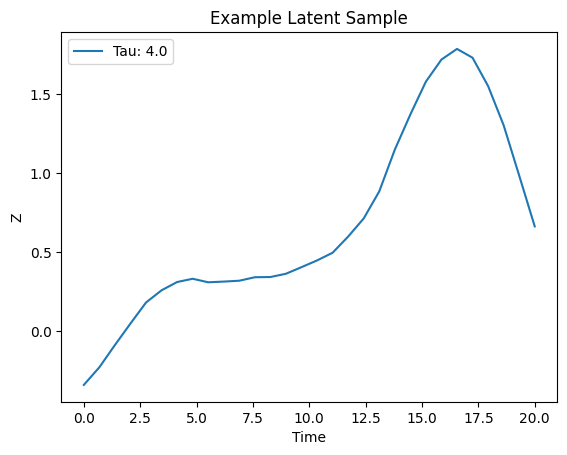

torch.Size([30, 5])


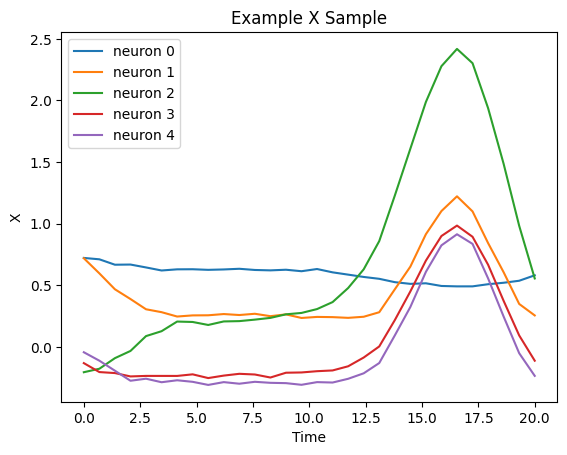

VAE Fit:   0%|          | 0/10000 [00:00<?, ?it/s]

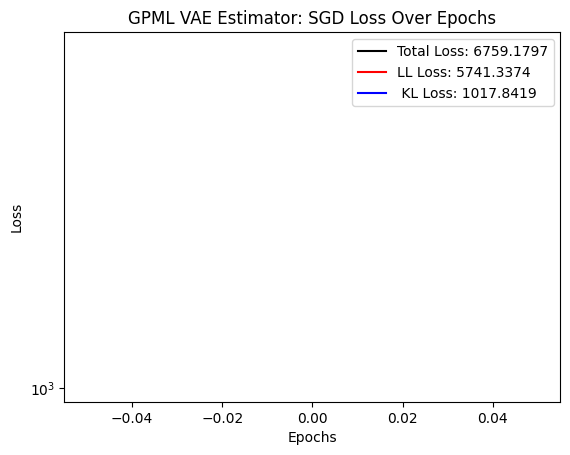

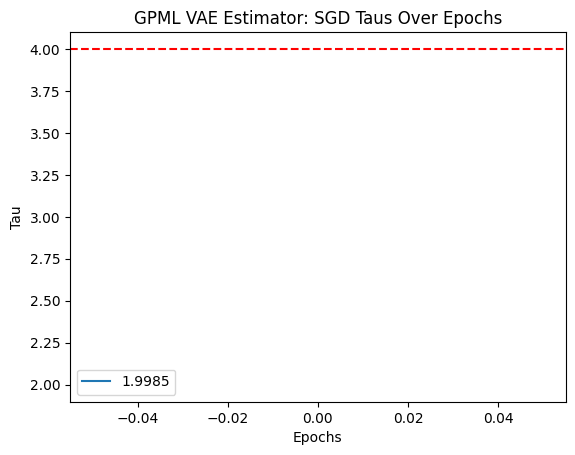

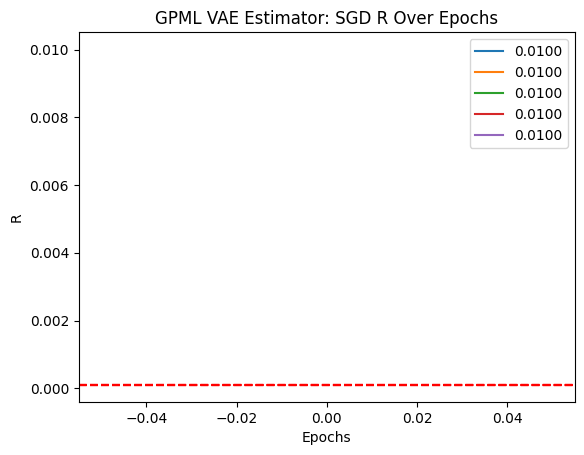

VAE Fit:   1%|          | 100/10000 [01:08<1:56:19,  1.42it/s]

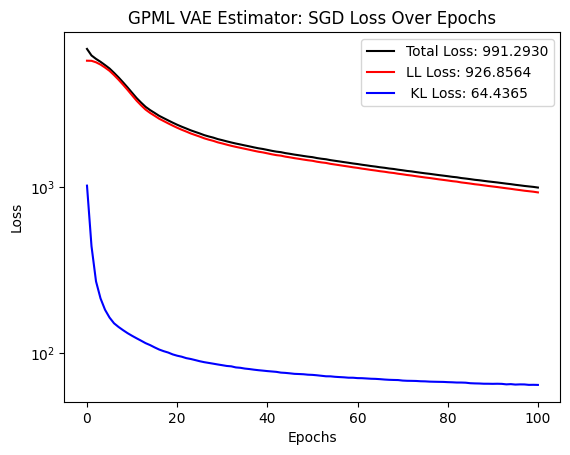

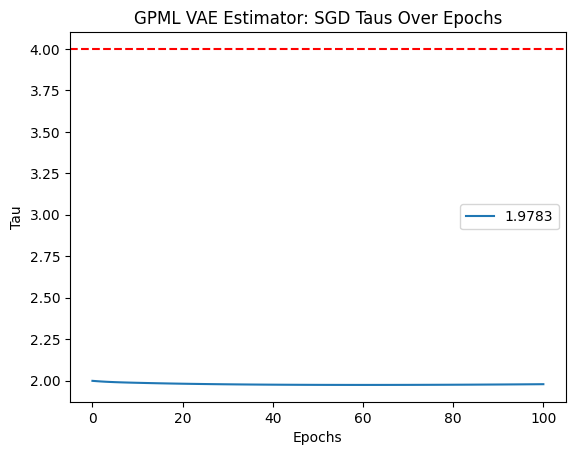

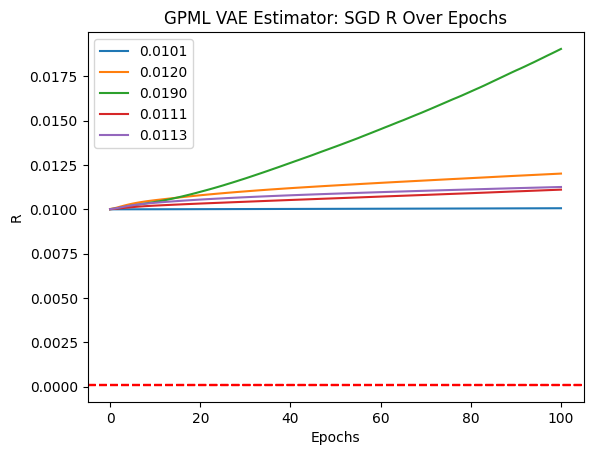

VAE Fit:   2%|▏         | 200/10000 [02:15<1:44:36,  1.56it/s]

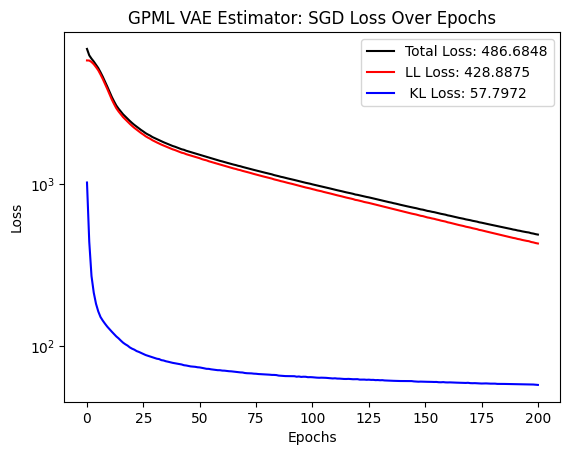

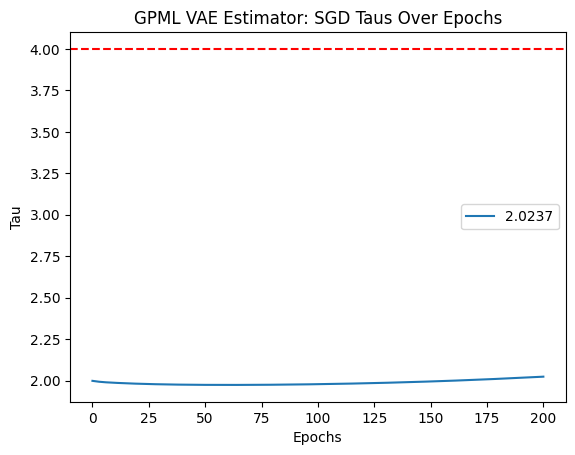

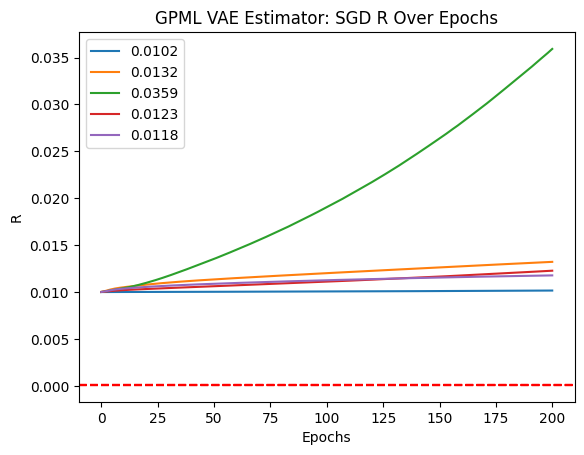

VAE Fit:   3%|▎         | 300/10000 [03:24<1:46:23,  1.52it/s]

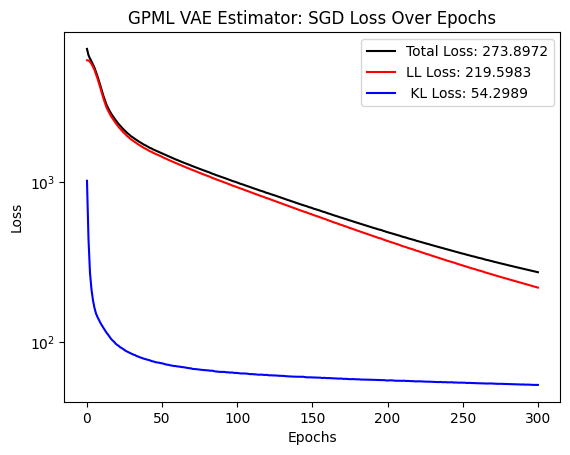

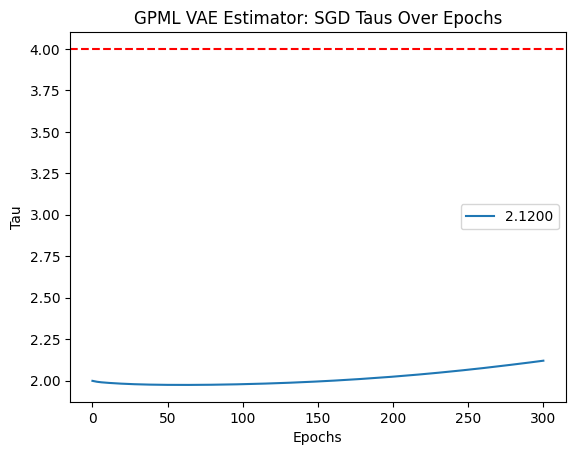

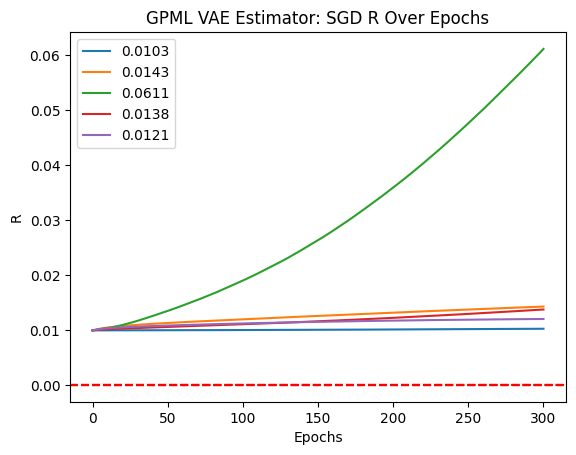

VAE Fit:   4%|▍         | 400/10000 [04:31<1:51:17,  1.44it/s]

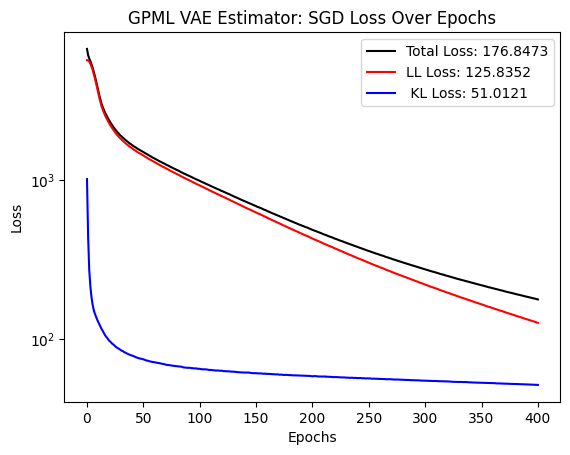

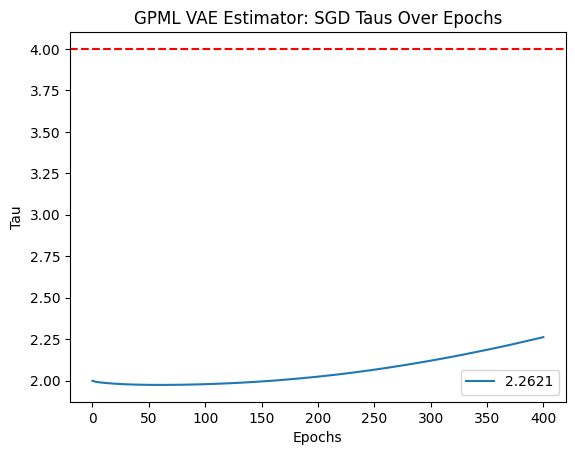

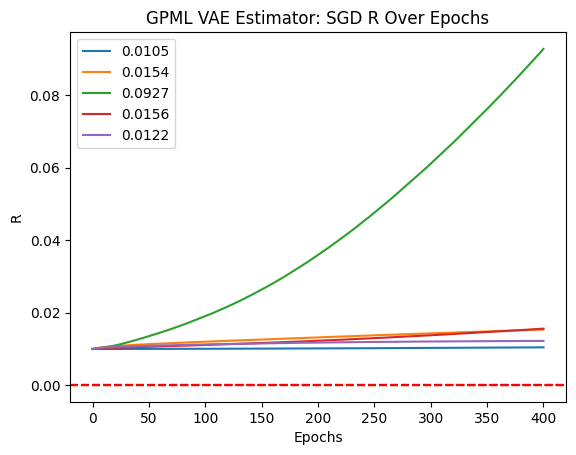

VAE Fit:   5%|▌         | 500/10000 [05:39<1:41:07,  1.57it/s]

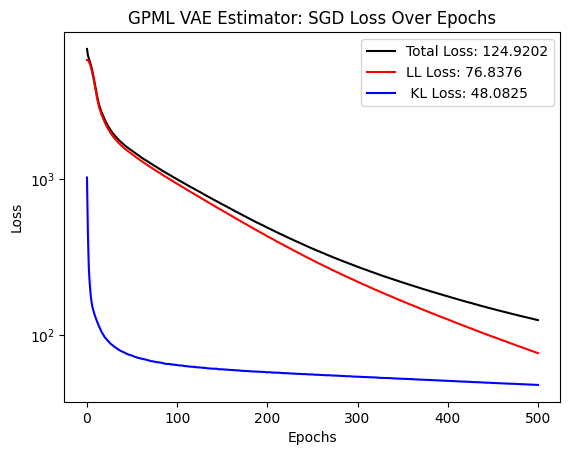

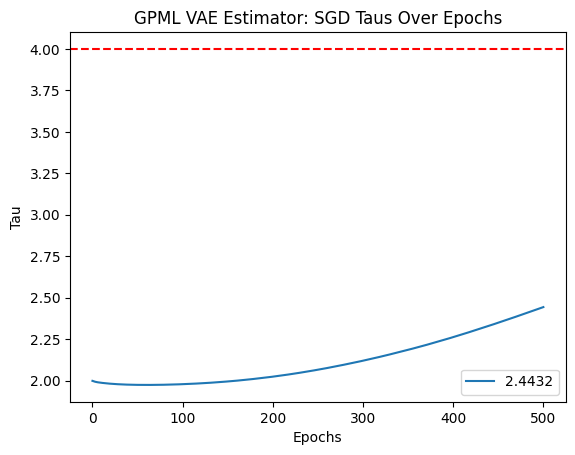

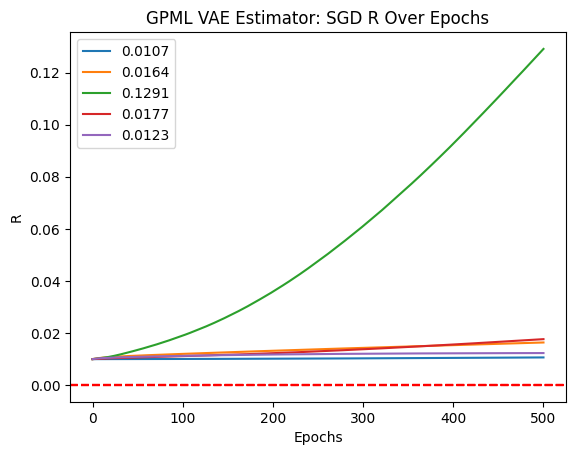

VAE Fit:   6%|▌         | 600/10000 [06:47<1:44:28,  1.50it/s]

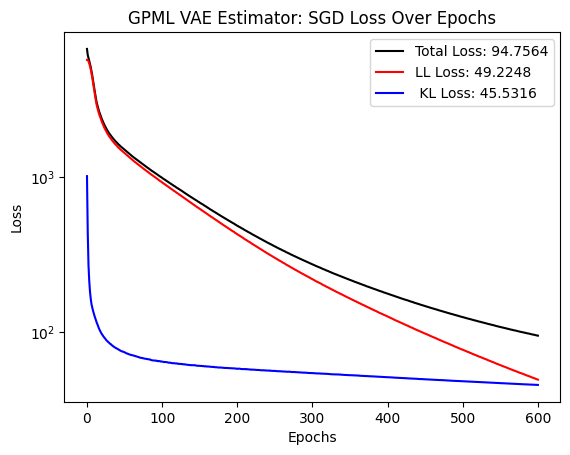

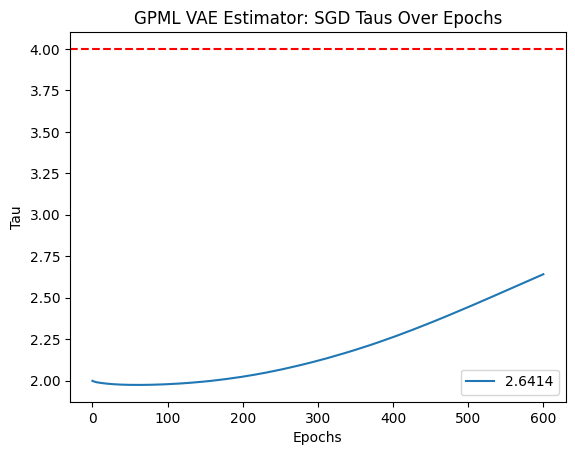

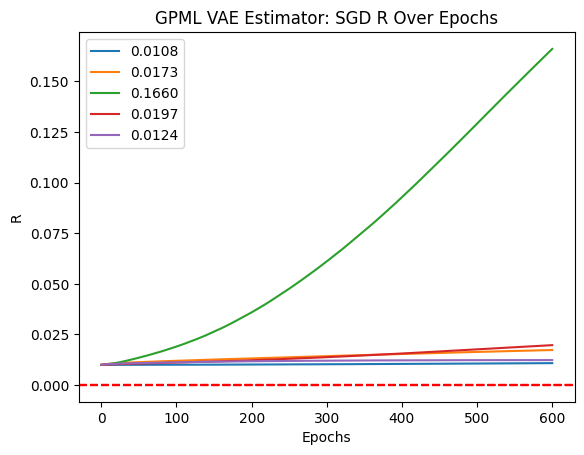

VAE Fit:   7%|▋         | 700/10000 [07:55<1:47:28,  1.44it/s]

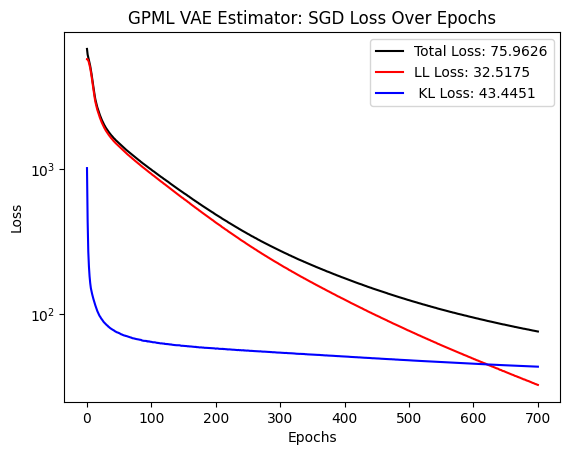

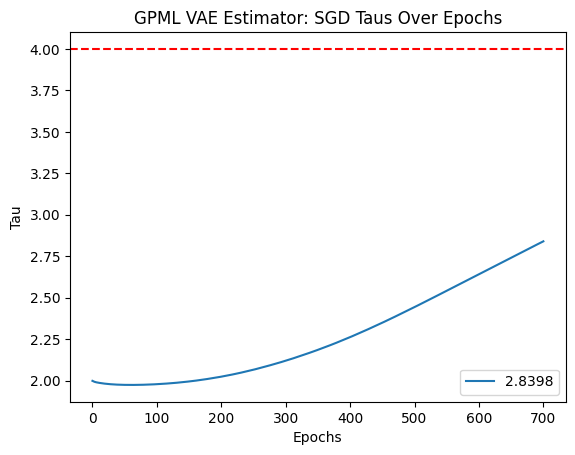

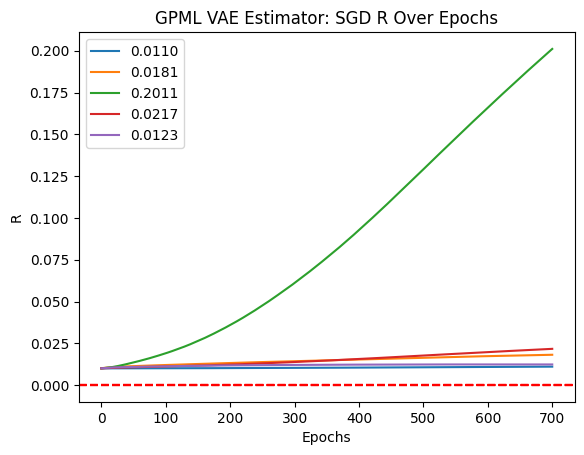

VAE Fit:   8%|▊         | 800/10000 [09:03<1:38:18,  1.56it/s]

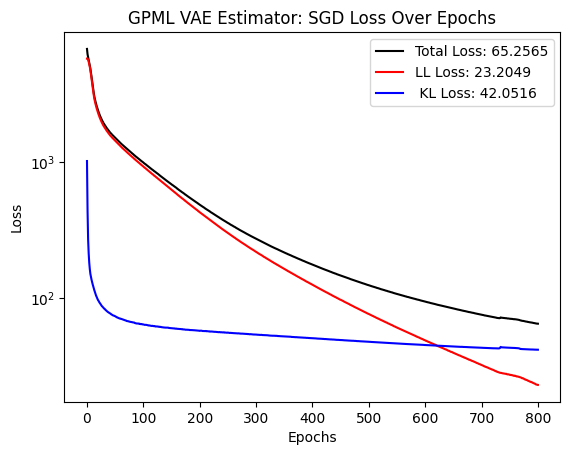

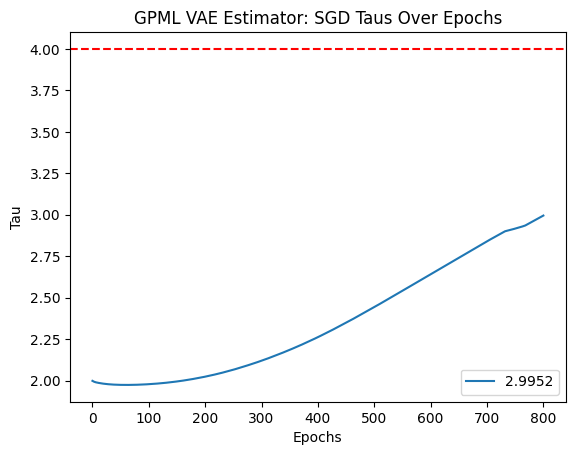

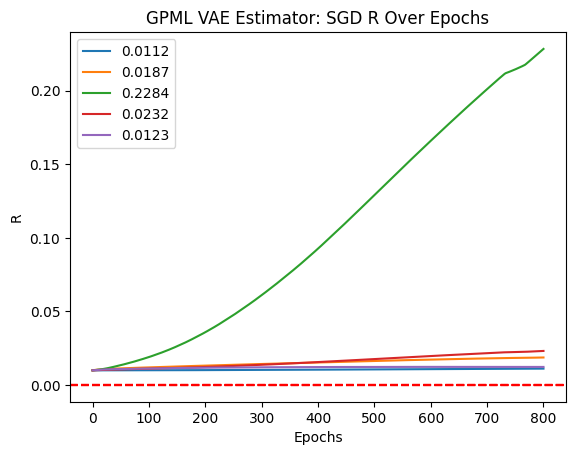

VAE Fit:   9%|▉         | 900/10000 [10:12<1:39:19,  1.53it/s]

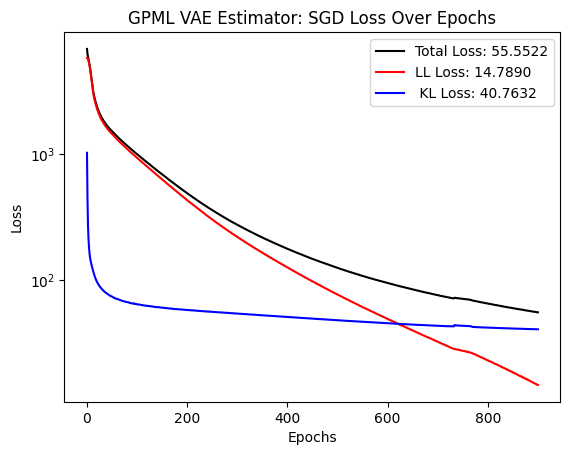

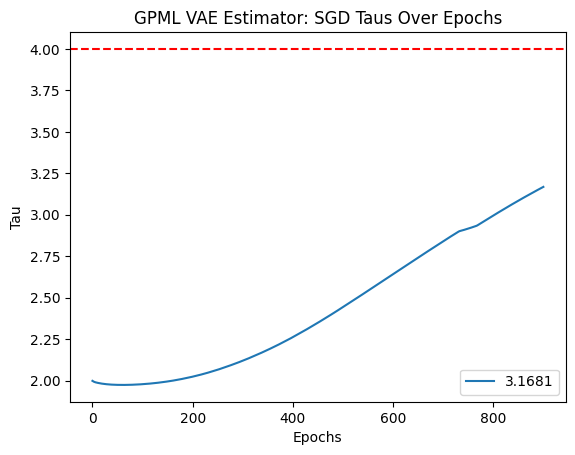

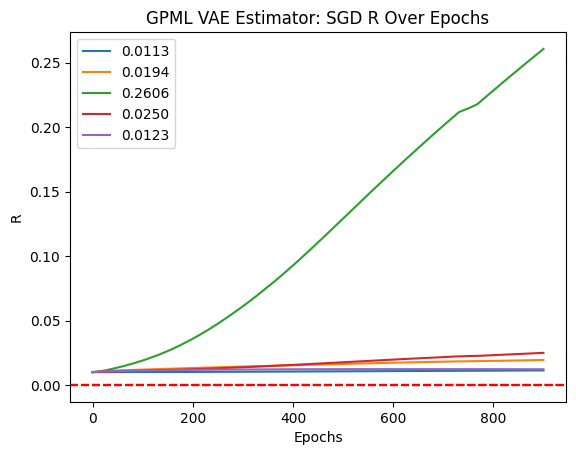

VAE Fit:  10%|█         | 1000/10000 [11:20<1:50:08,  1.36it/s]

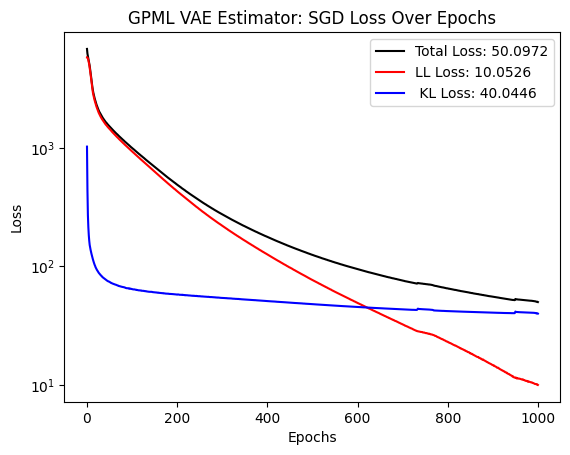

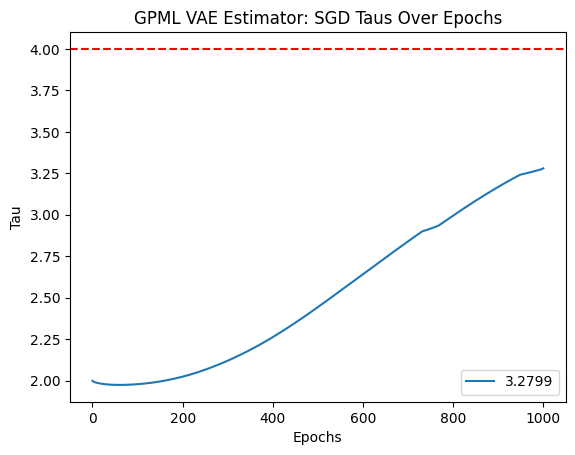

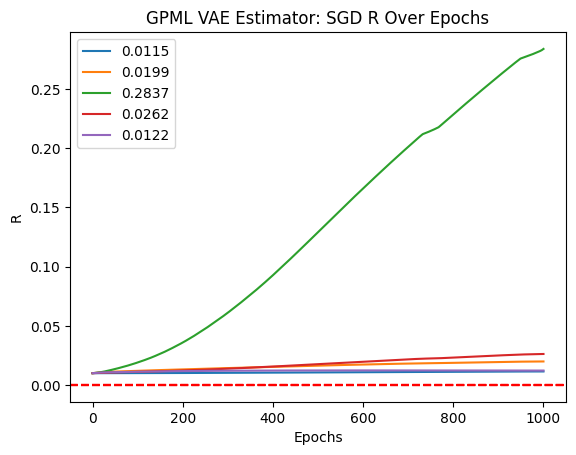

VAE Fit:  11%|█         | 1100/10000 [12:29<1:36:49,  1.53it/s]

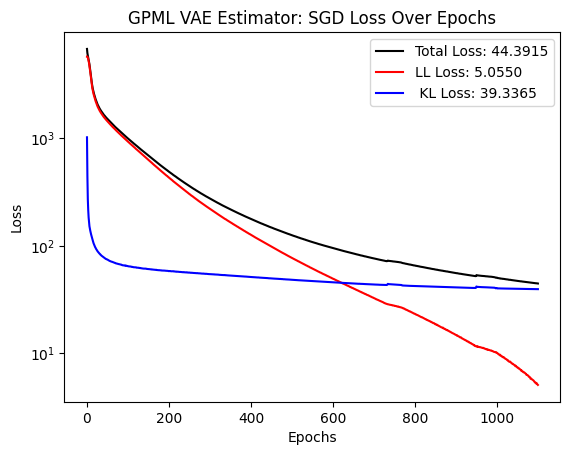

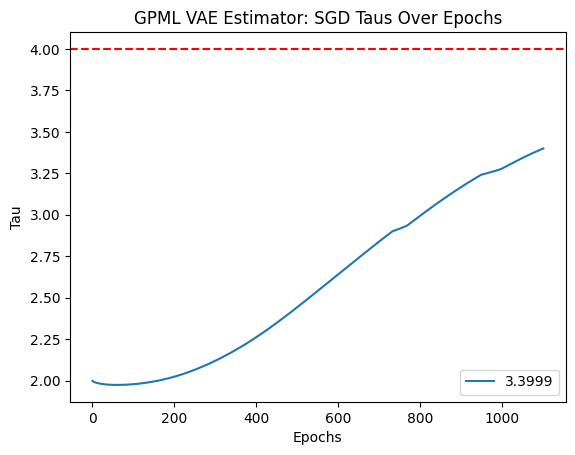

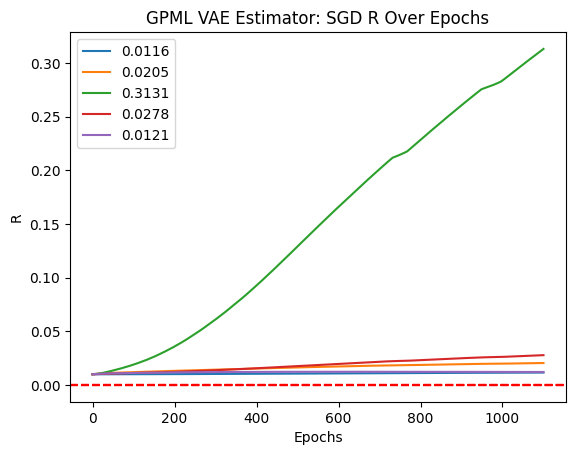

VAE Fit:  12%|█▏        | 1200/10000 [13:37<1:35:54,  1.53it/s]

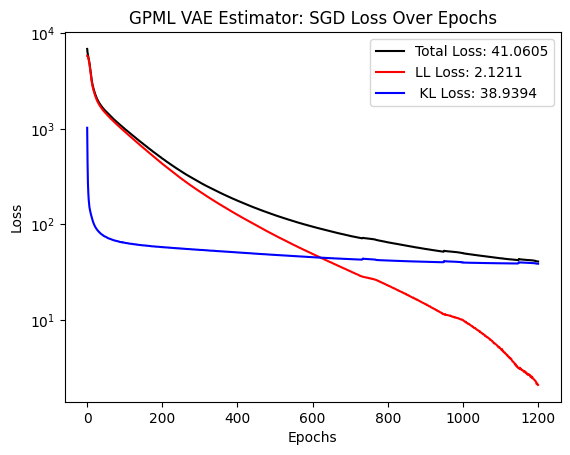

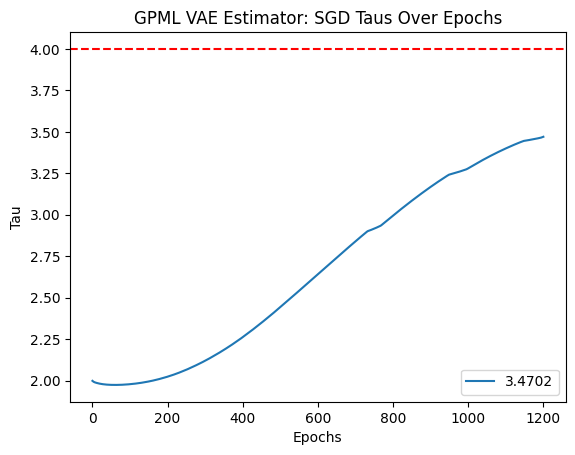

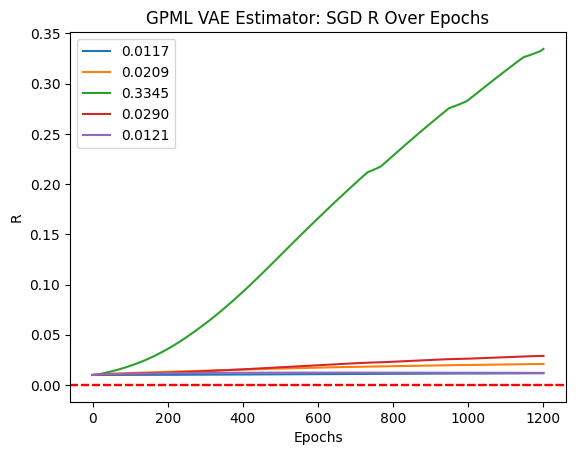

VAE Fit:  13%|█▎        | 1300/10000 [14:45<1:52:26,  1.29it/s]

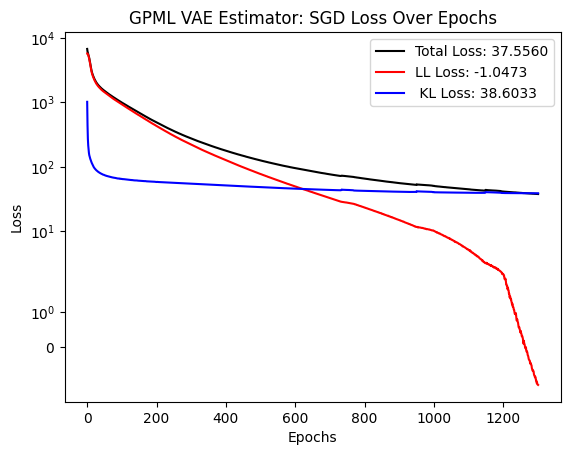

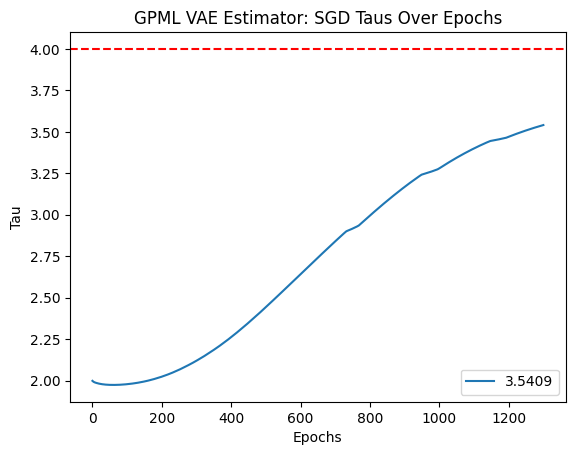

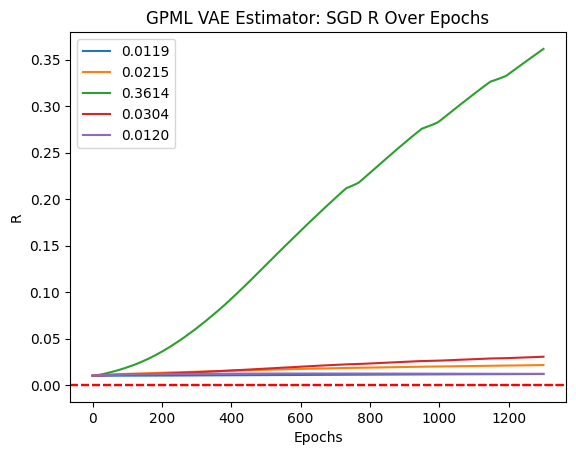

VAE Fit:  14%|█▍        | 1400/10000 [15:54<1:31:13,  1.57it/s]

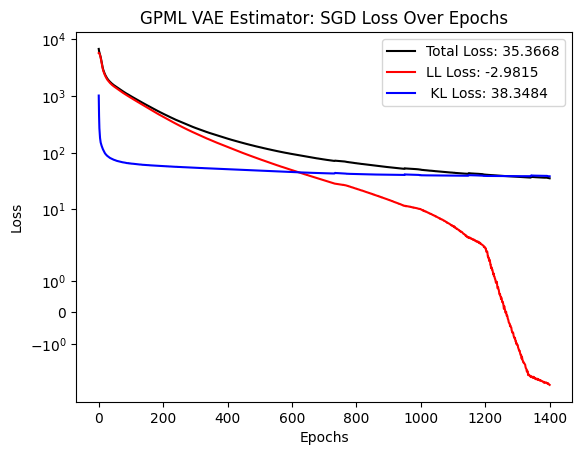

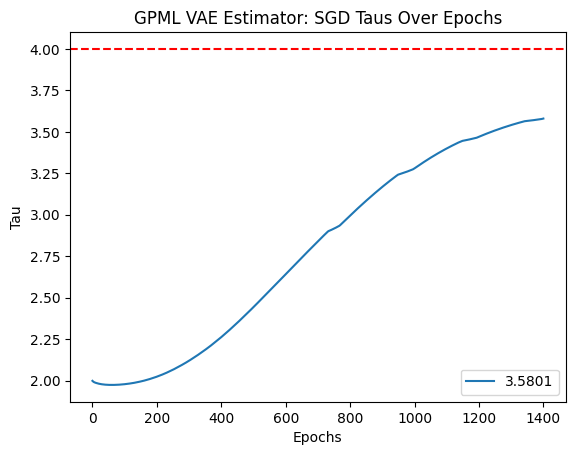

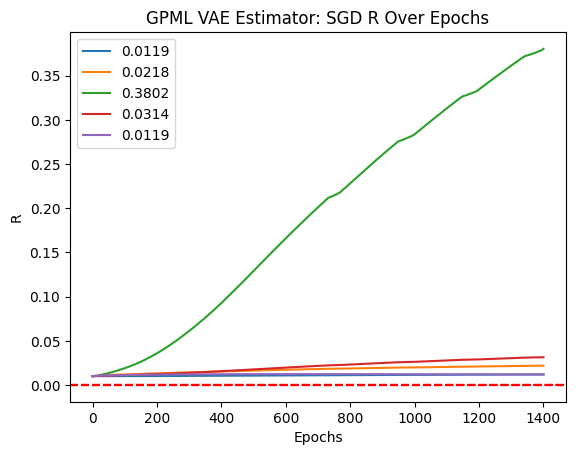

VAE Fit:  15%|█▌        | 1500/10000 [17:03<1:32:12,  1.54it/s]

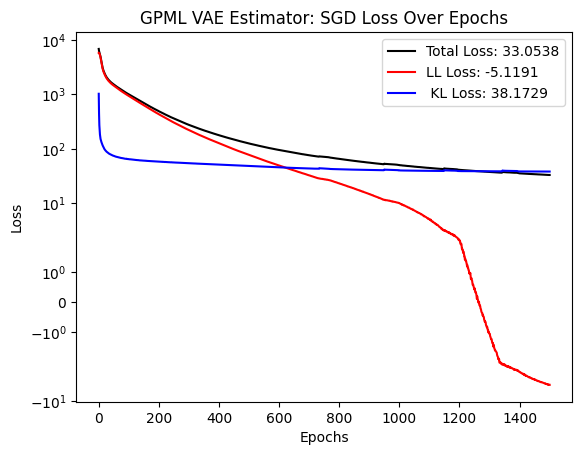

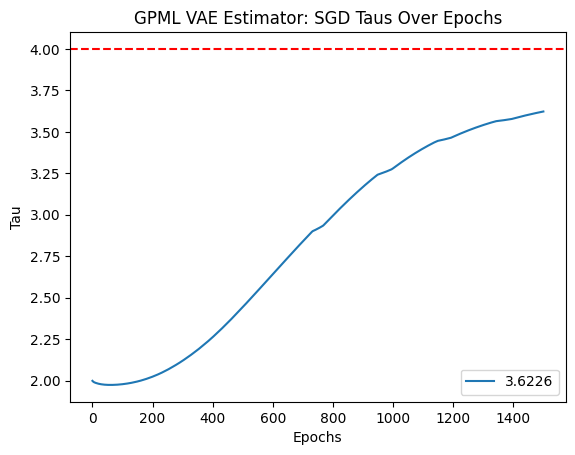

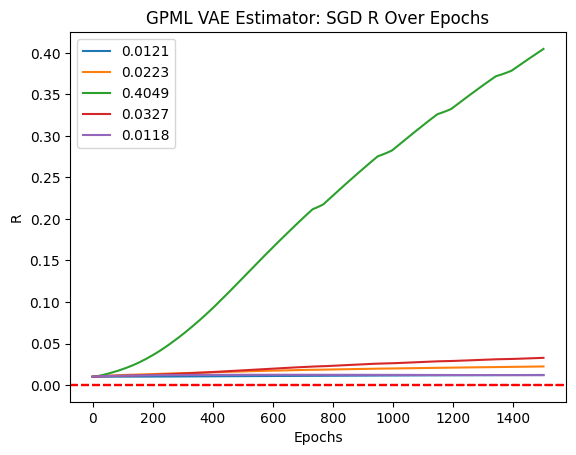

VAE Fit:  16%|█▌        | 1600/10000 [18:11<1:35:26,  1.47it/s]

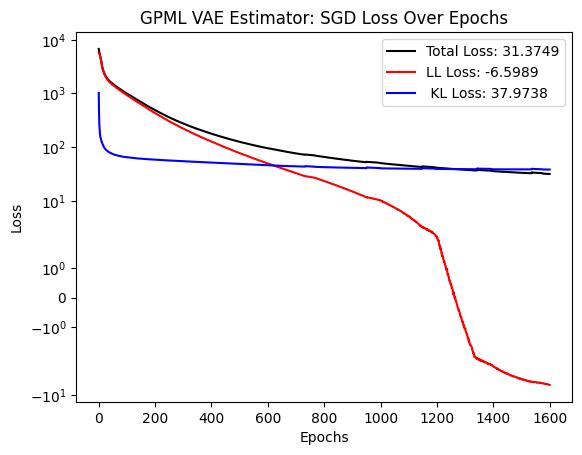

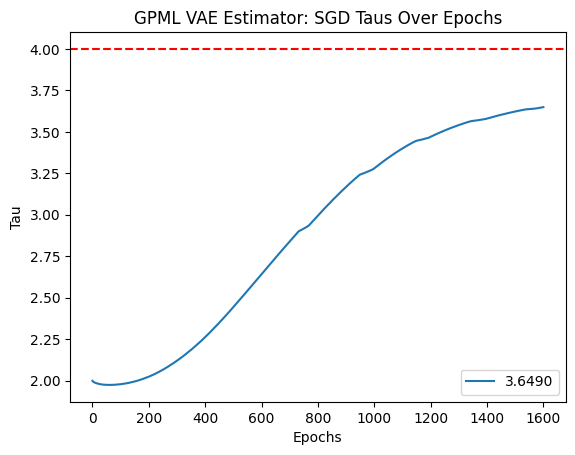

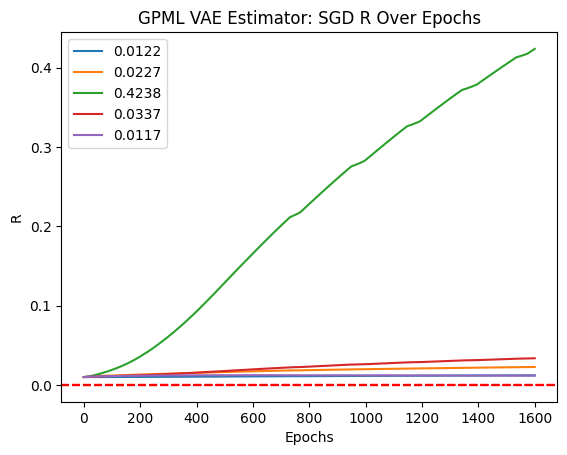

VAE Fit:  17%|█▋        | 1700/10000 [19:20<1:30:41,  1.53it/s]

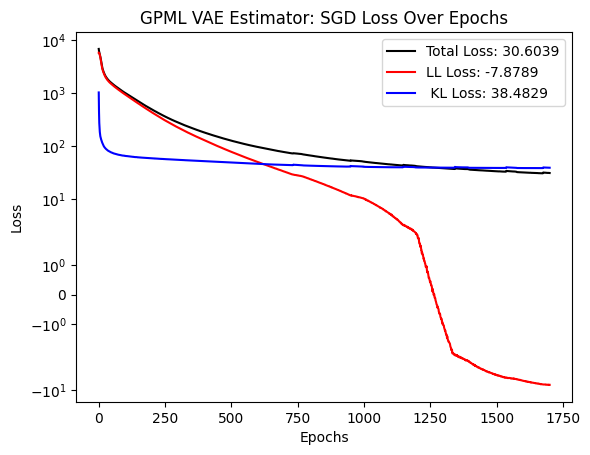

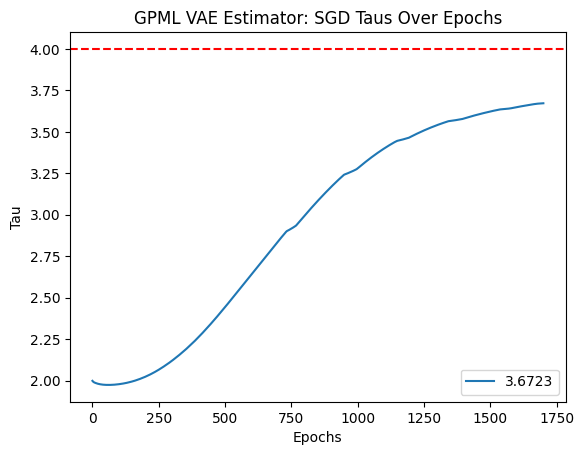

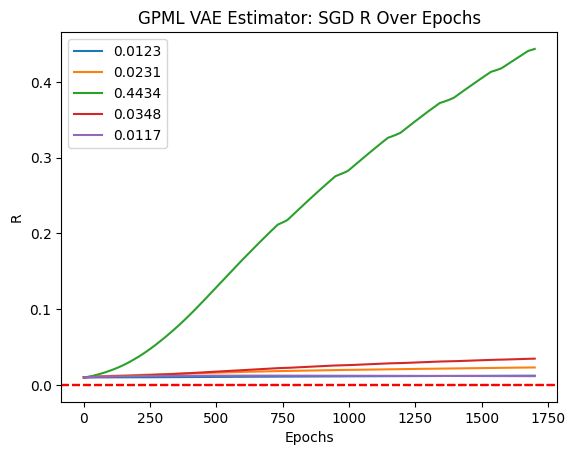

VAE Fit:  18%|█▊        | 1800/10000 [20:29<1:29:52,  1.52it/s]

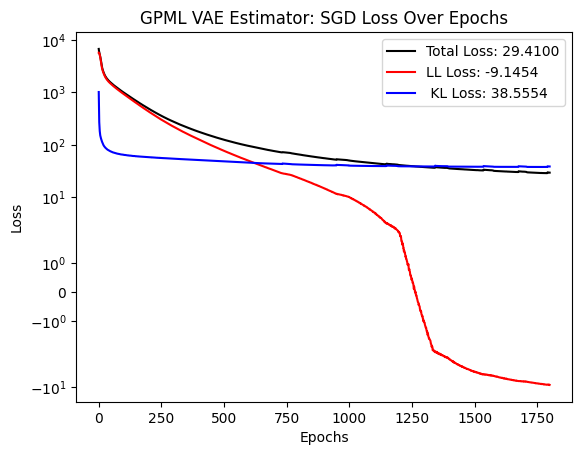

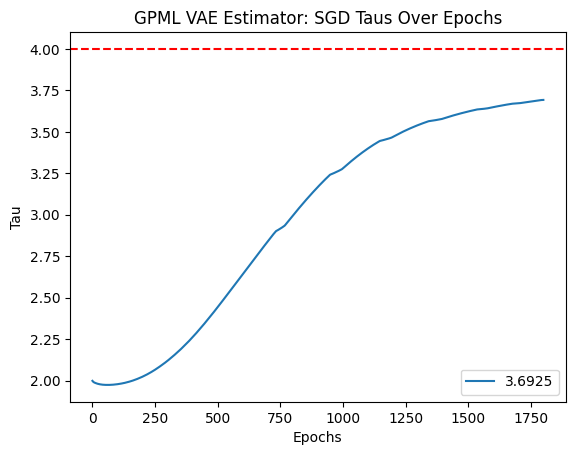

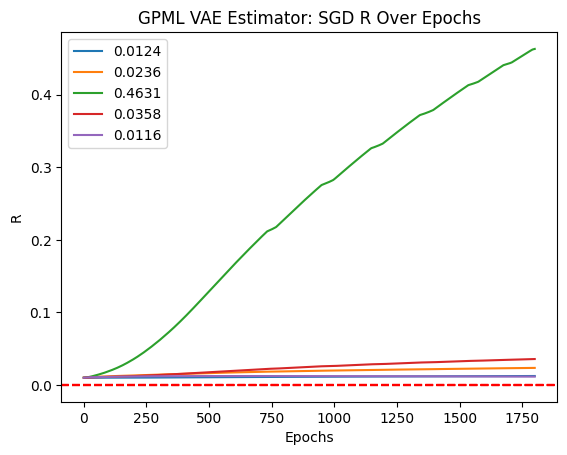

VAE Fit:  19%|█▉        | 1900/10000 [21:39<1:28:22,  1.53it/s]

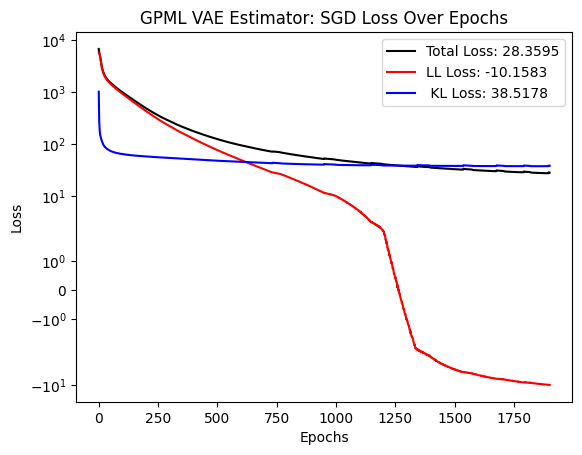

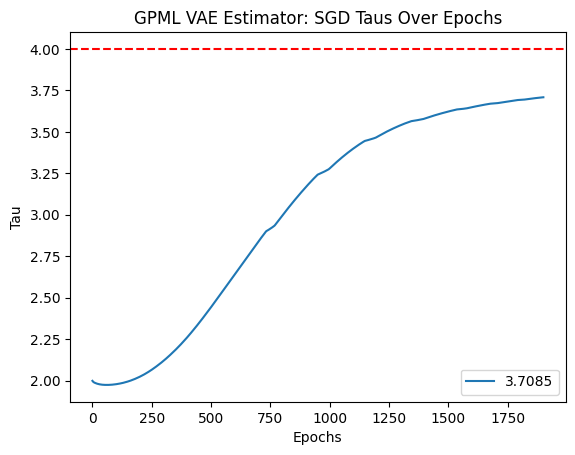

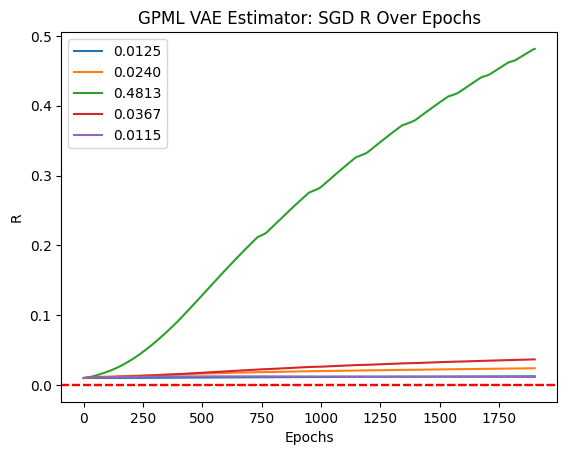

VAE Fit:  20%|██        | 2000/10000 [22:48<1:35:43,  1.39it/s]

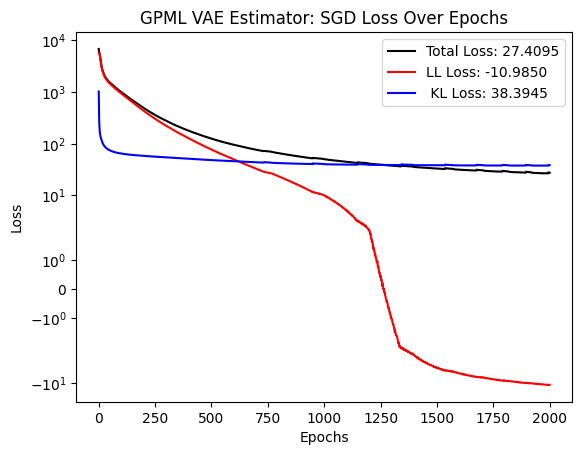

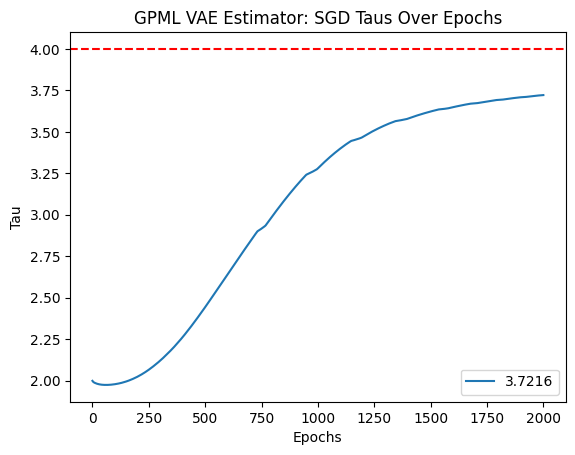

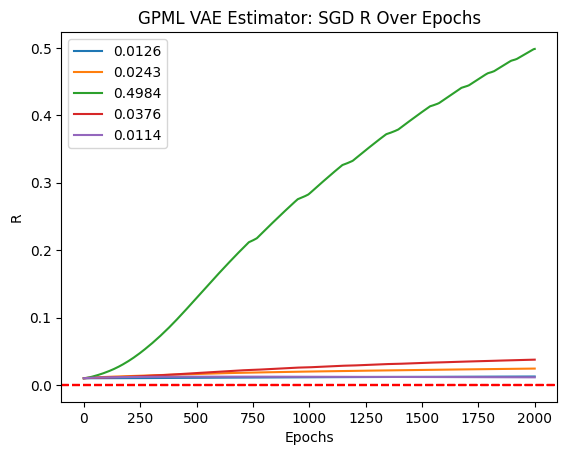

VAE Fit:  21%|██        | 2100/10000 [23:59<1:46:02,  1.24it/s]

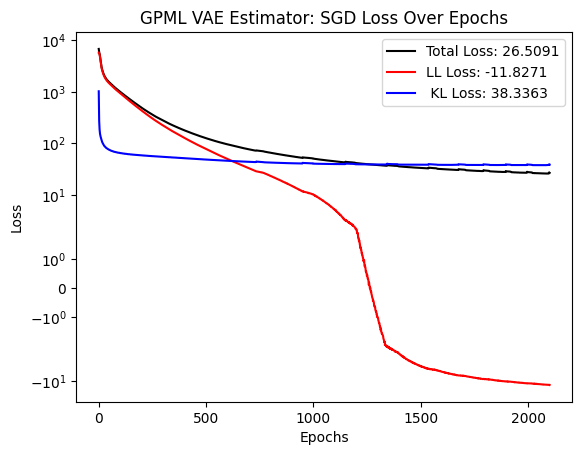

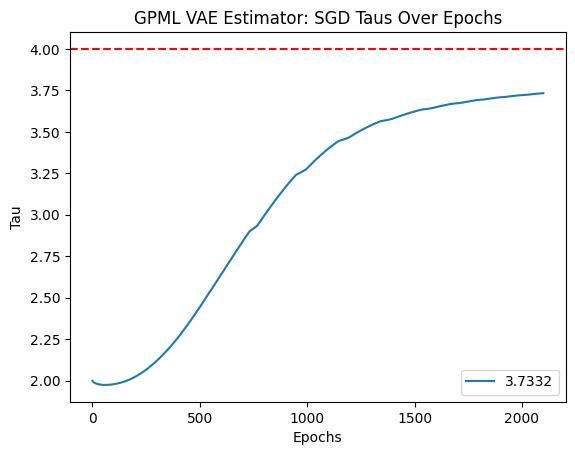

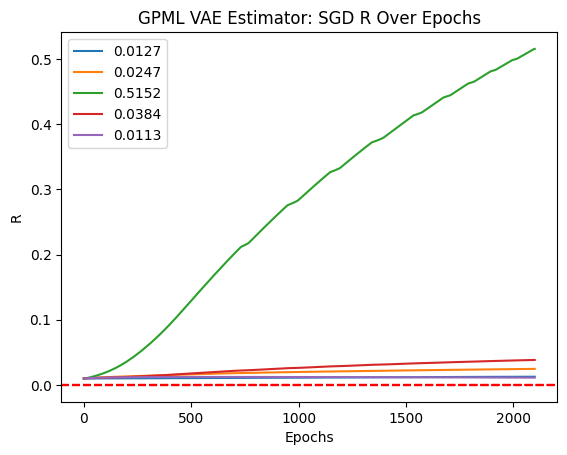

VAE Fit:  22%|██▏       | 2200/10000 [25:09<1:25:39,  1.52it/s]

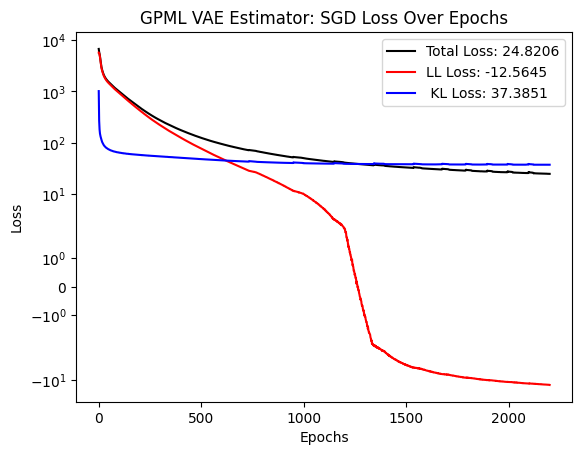

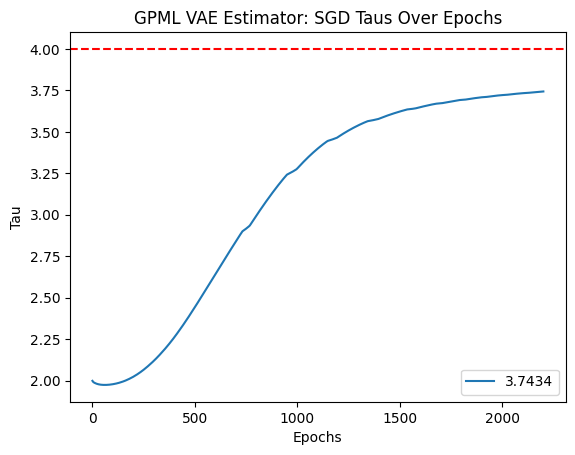

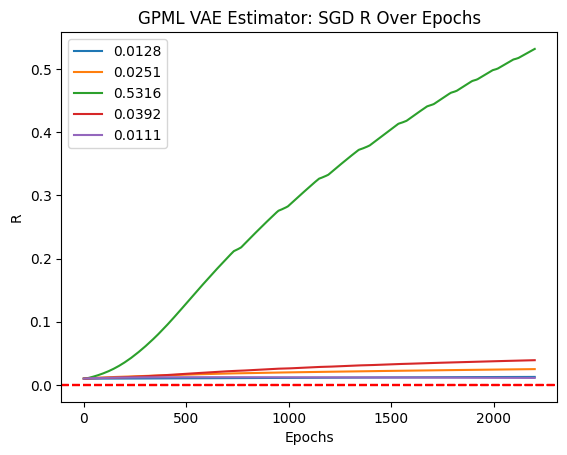

VAE Fit:  23%|██▎       | 2300/10000 [26:20<1:23:01,  1.55it/s]

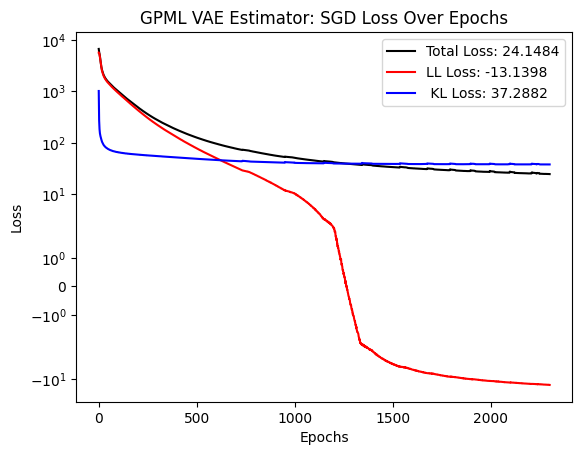

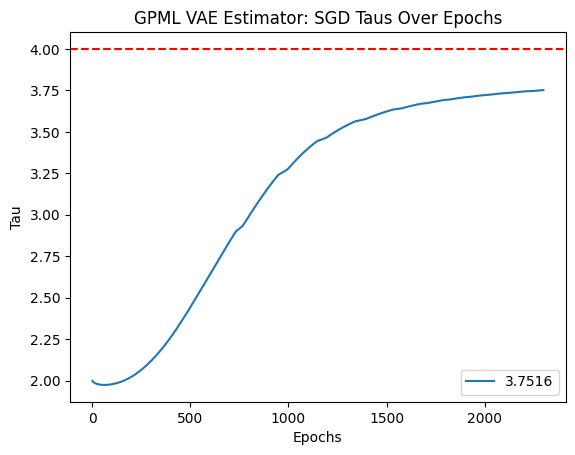

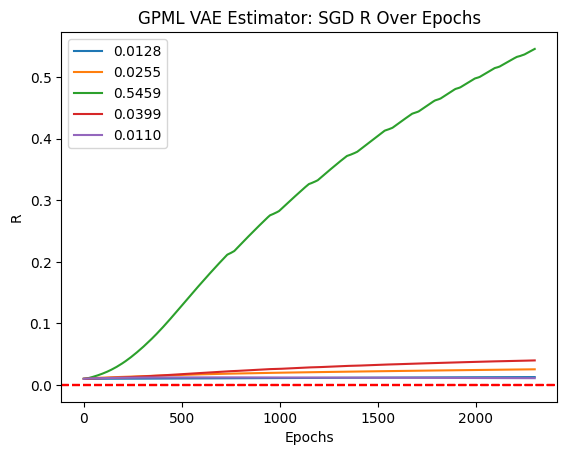

VAE Fit:  24%|██▍       | 2400/10000 [27:28<1:24:53,  1.49it/s]

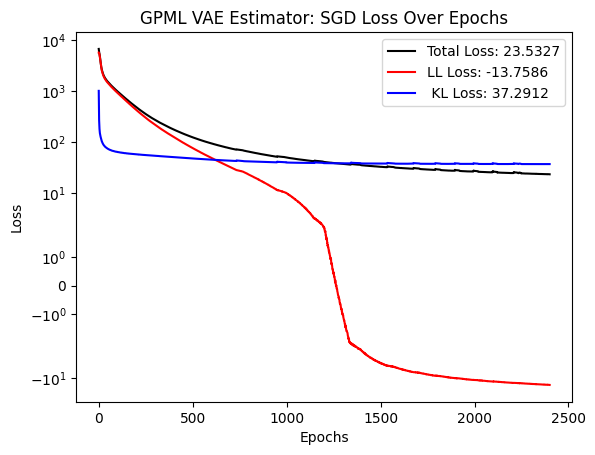

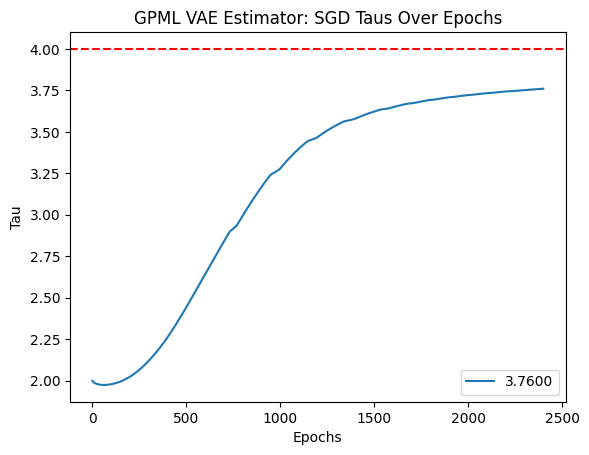

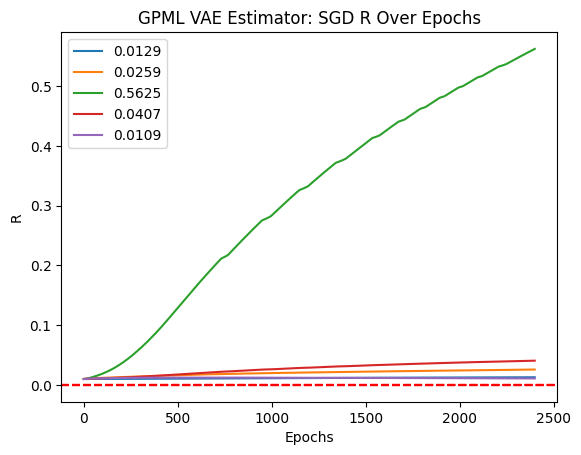

VAE Fit:  25%|██▌       | 2500/10000 [28:39<1:29:11,  1.40it/s]

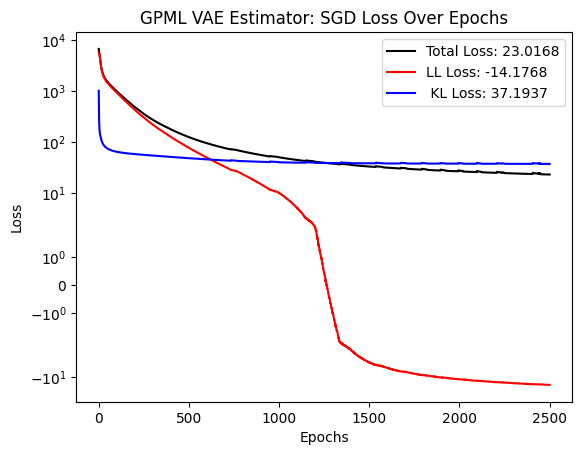

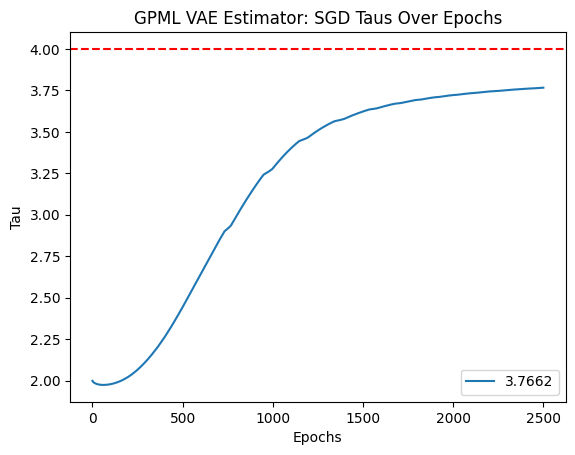

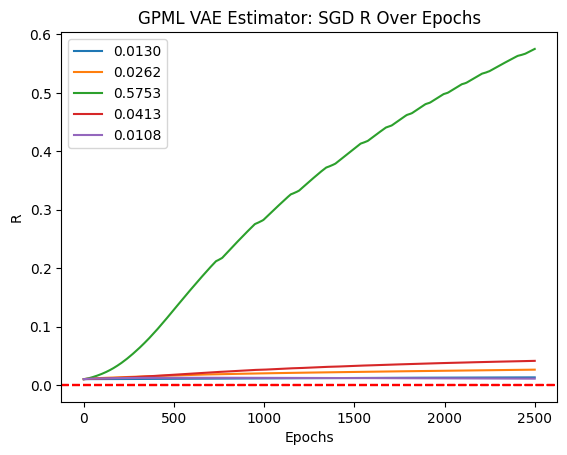

VAE Fit:  26%|██▌       | 2600/10000 [29:48<1:32:23,  1.33it/s]

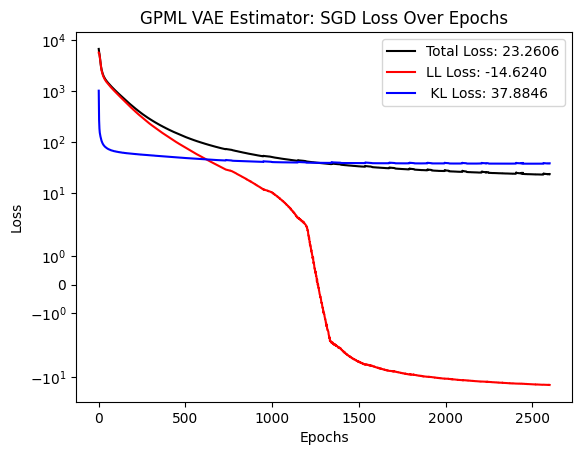

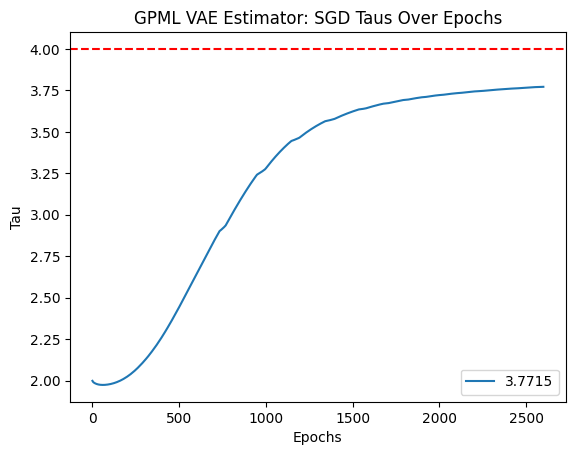

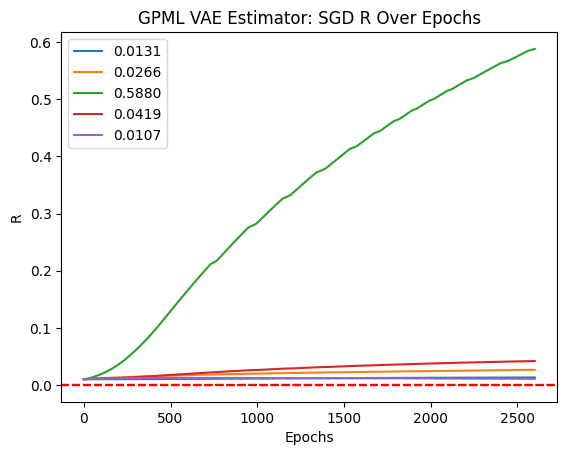

VAE Fit:  27%|██▋       | 2700/10000 [30:57<1:17:33,  1.57it/s]

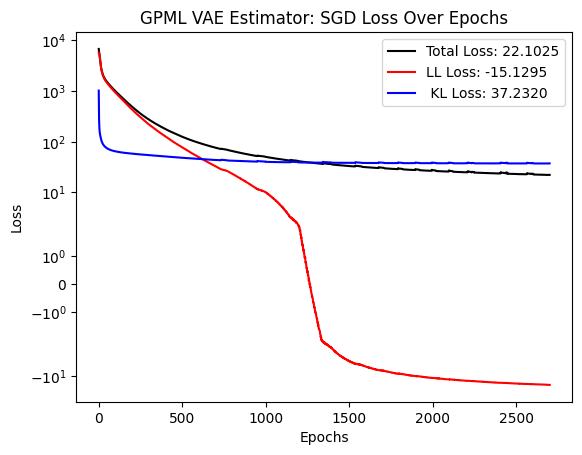

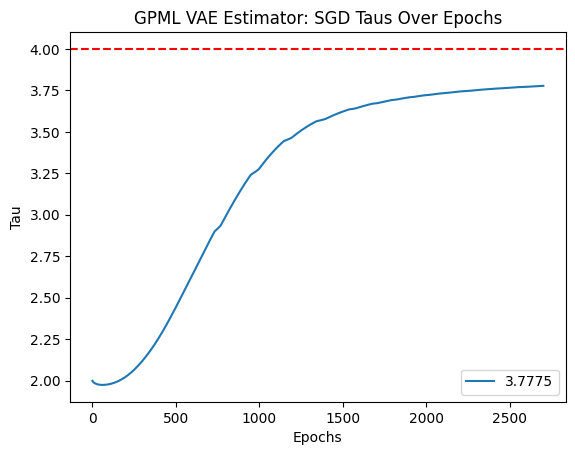

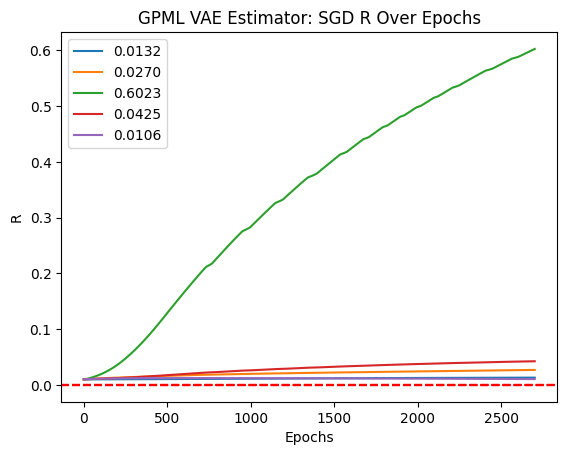

VAE Fit:  28%|██▊       | 2800/10000 [32:07<1:17:40,  1.54it/s]

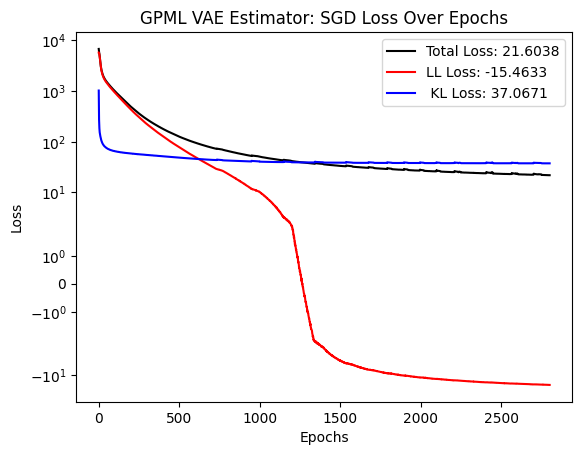

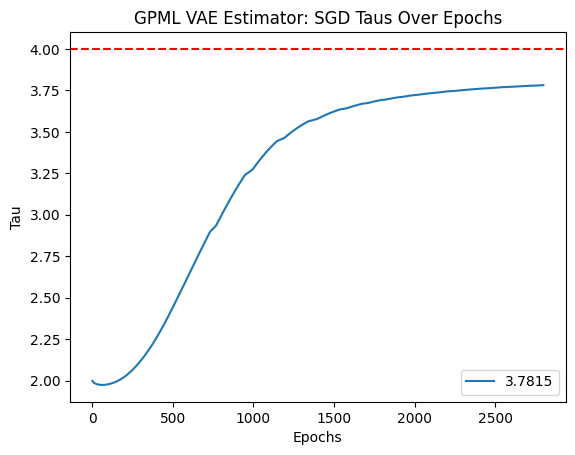

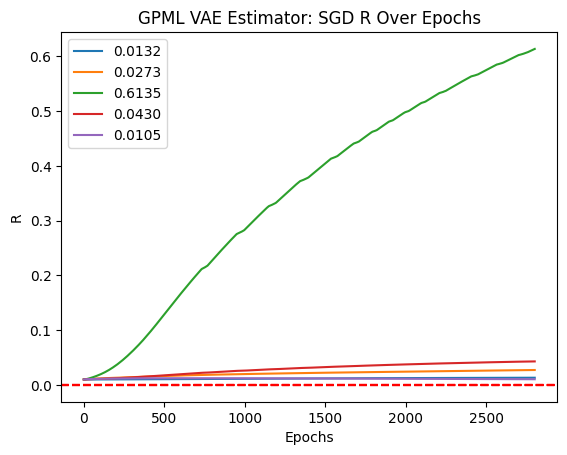

VAE Fit:  29%|██▉       | 2900/10000 [33:18<1:17:12,  1.53it/s]

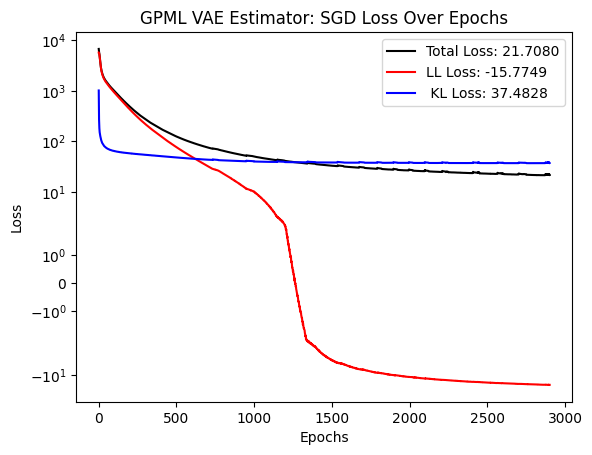

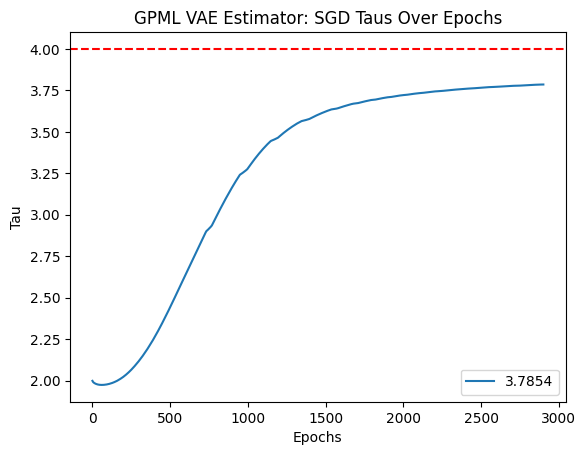

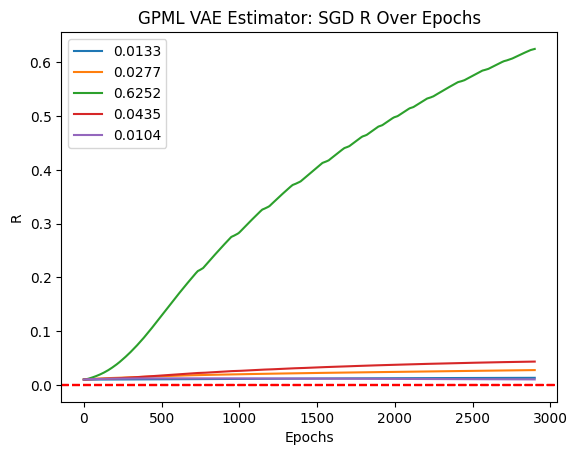

VAE Fit:  30%|███       | 3000/10000 [34:29<1:20:52,  1.44it/s]

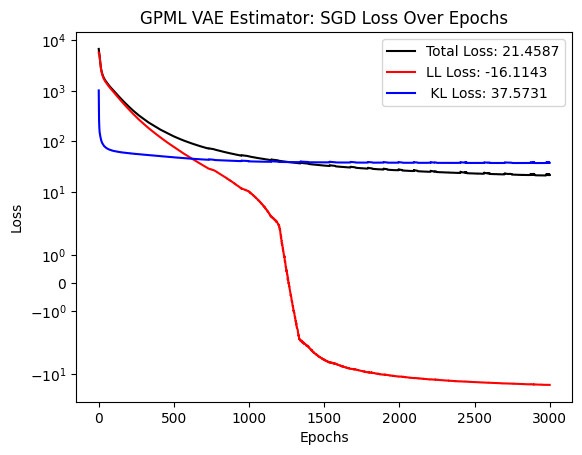

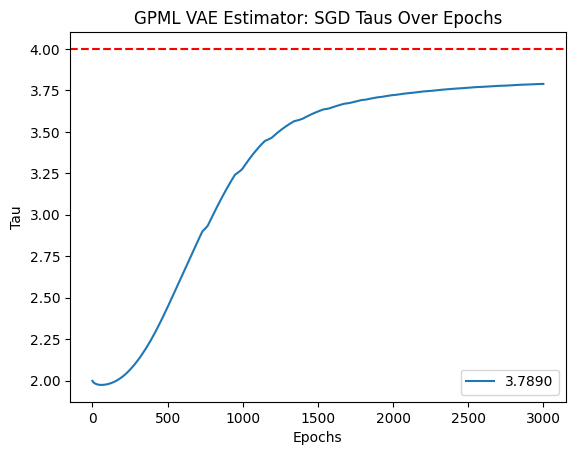

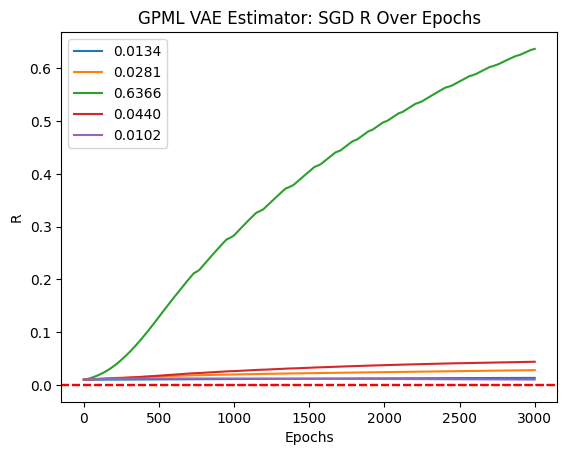

VAE Fit:  31%|███       | 3100/10000 [35:42<1:20:44,  1.42it/s]

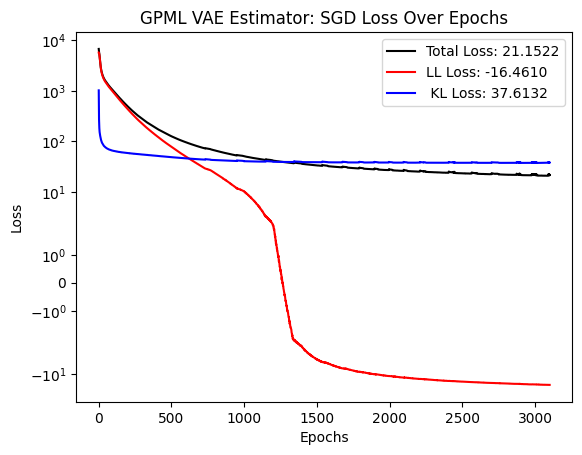

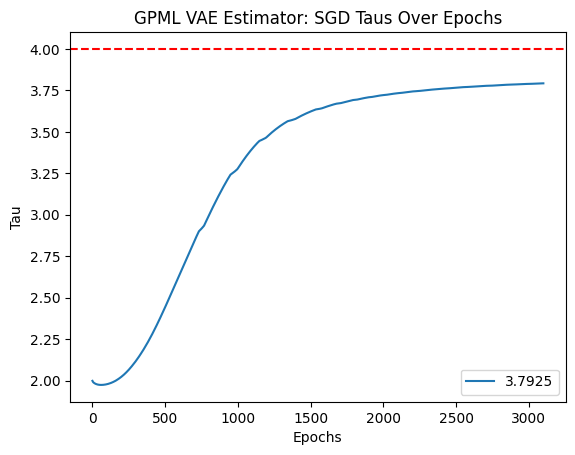

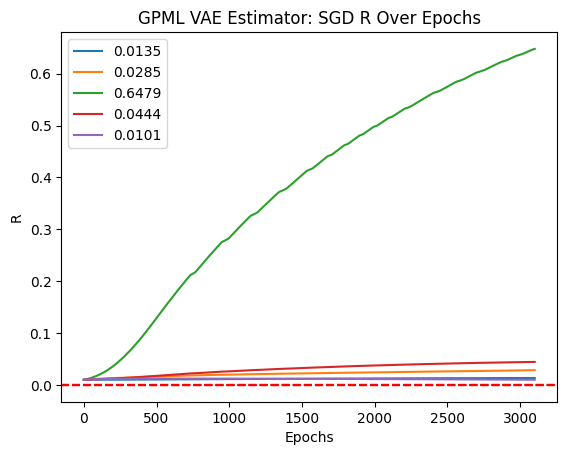

VAE Fit:  32%|███▏      | 3200/10000 [36:54<1:19:10,  1.43it/s]

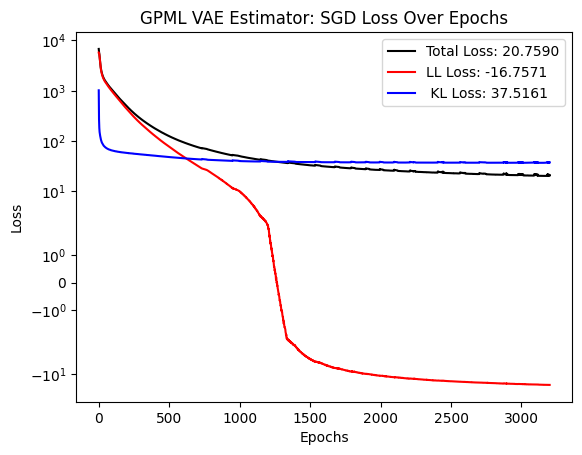

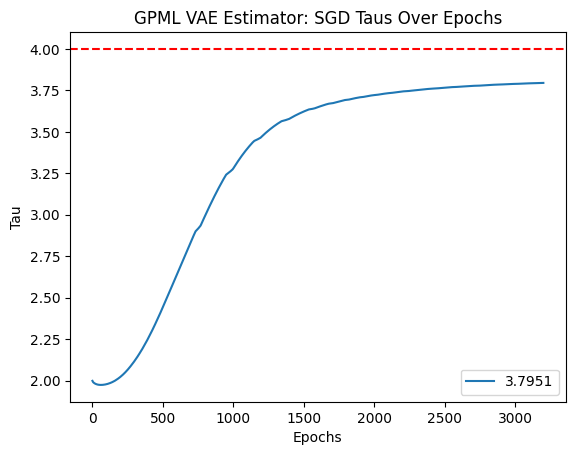

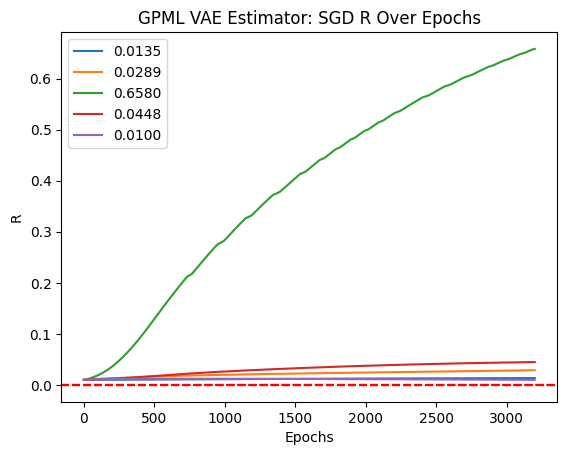

VAE Fit:  33%|███▎      | 3300/10000 [38:06<1:18:40,  1.42it/s]

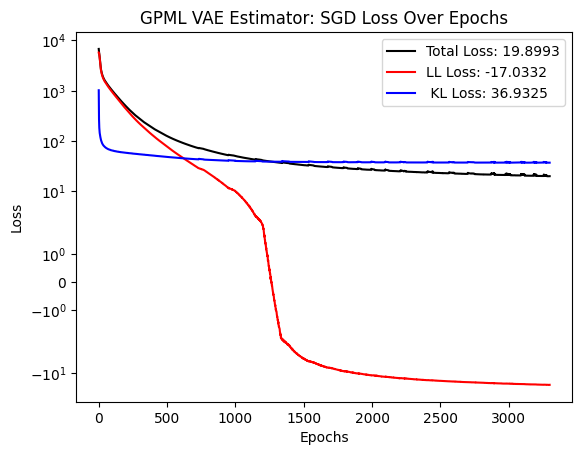

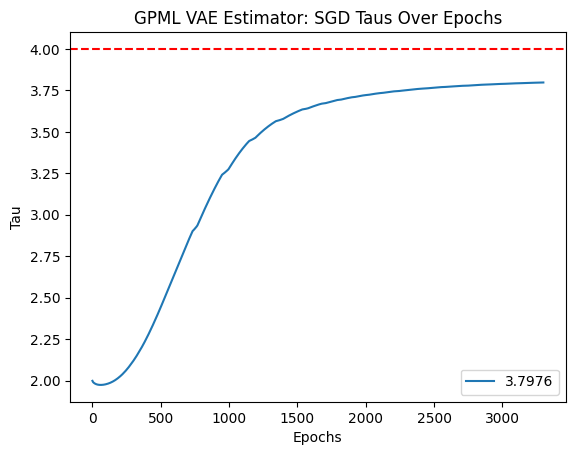

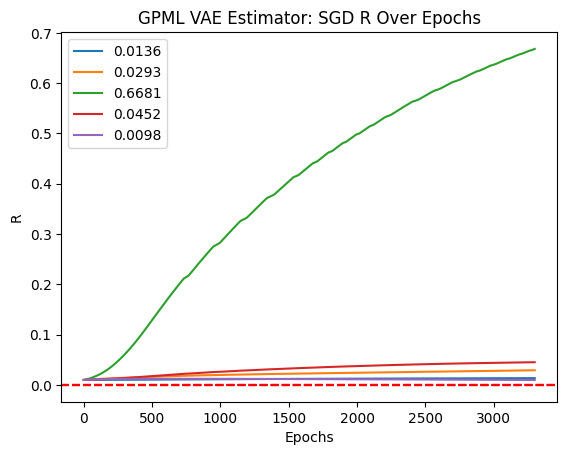

VAE Fit:  34%|███▍      | 3400/10000 [39:18<1:17:48,  1.41it/s]

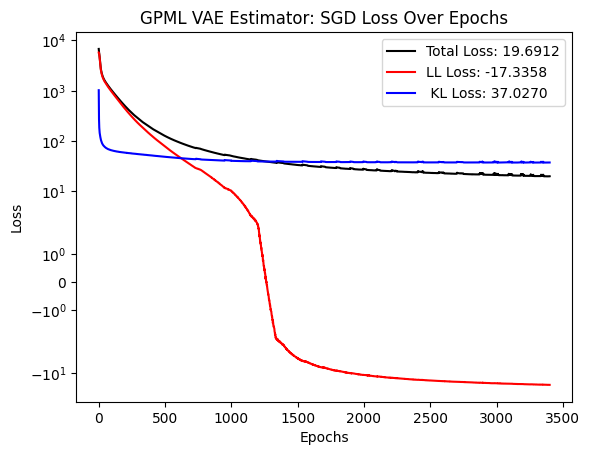

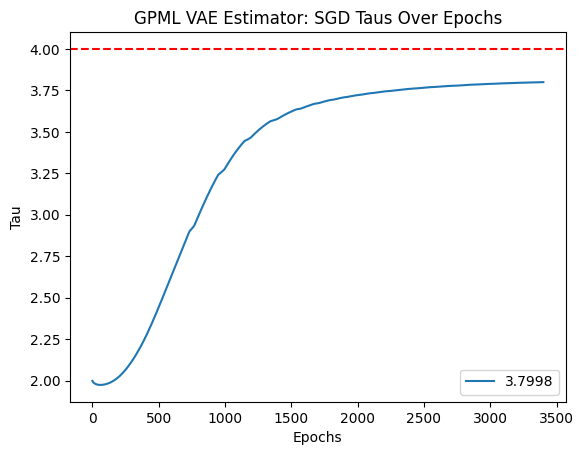

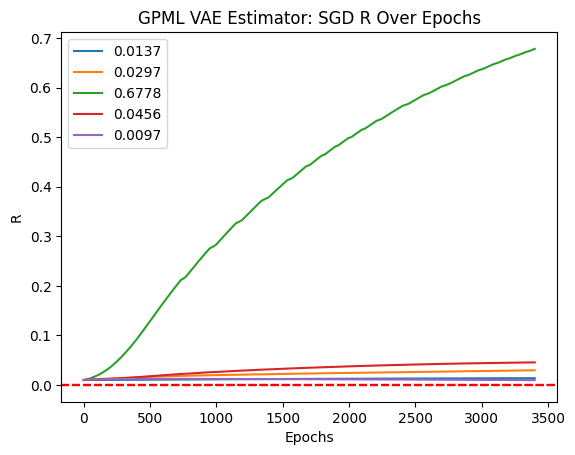

VAE Fit:  35%|███▌      | 3500/10000 [40:29<1:17:39,  1.40it/s]

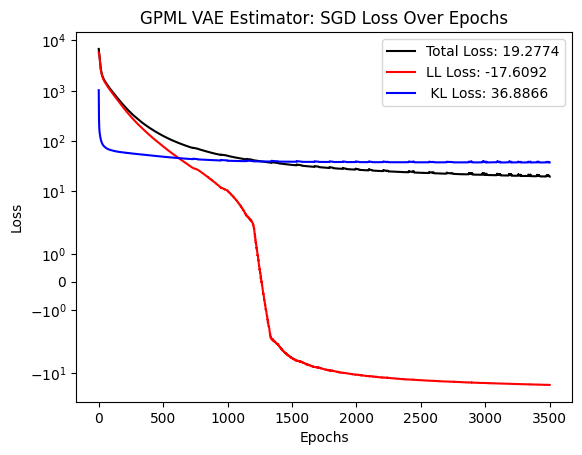

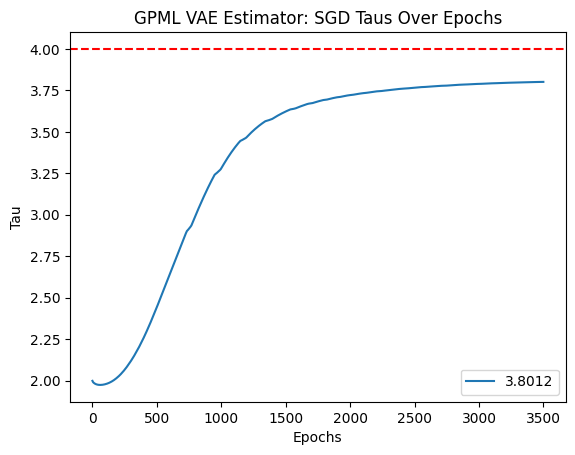

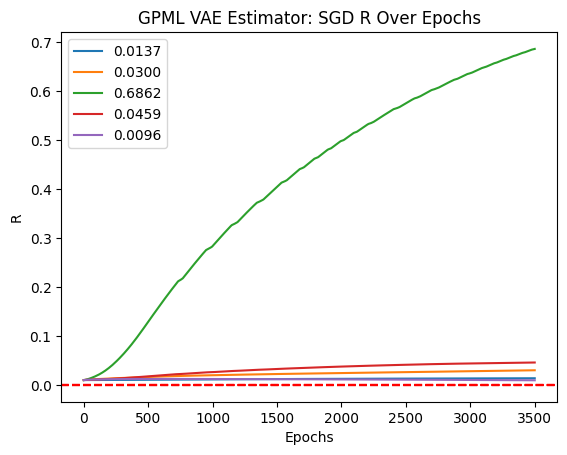

VAE Fit:  36%|███▌      | 3600/10000 [41:39<1:24:44,  1.26it/s]

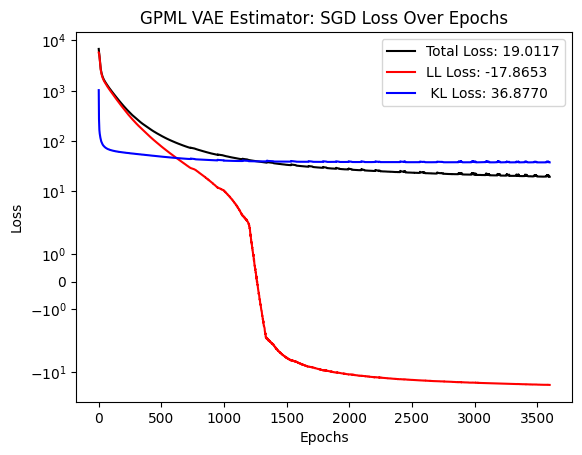

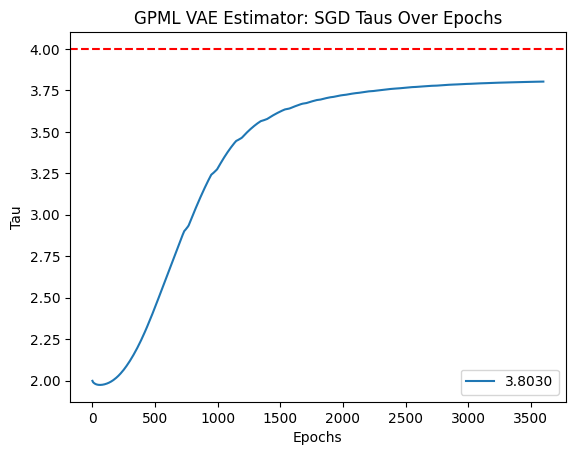

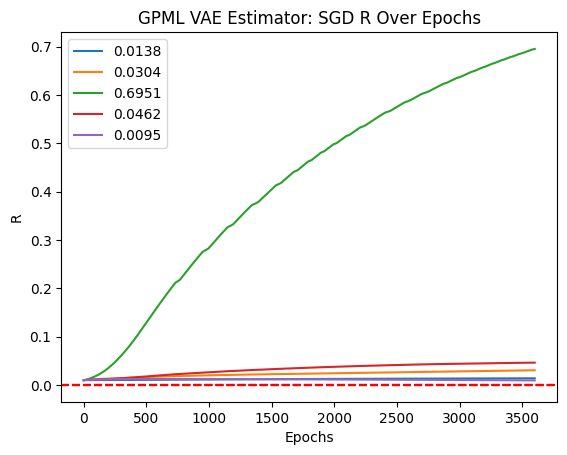

VAE Fit:  37%|███▋      | 3700/10000 [42:49<1:08:48,  1.53it/s]

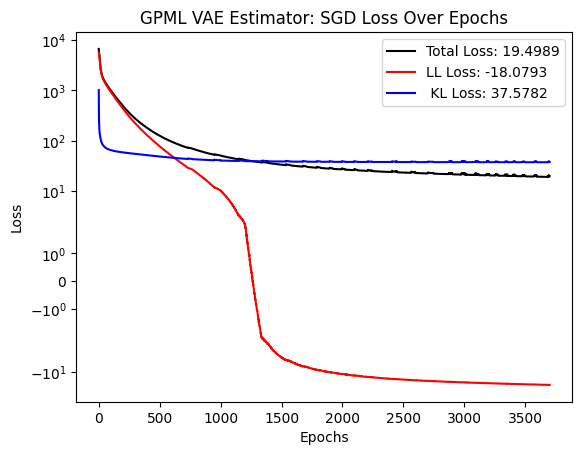

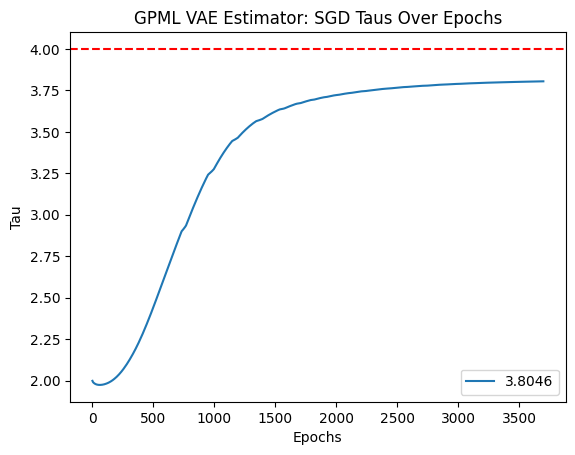

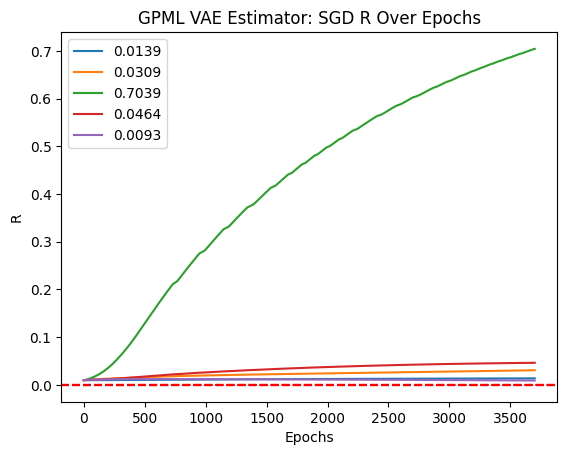

VAE Fit:  38%|███▊      | 3800/10000 [44:00<1:08:26,  1.51it/s]

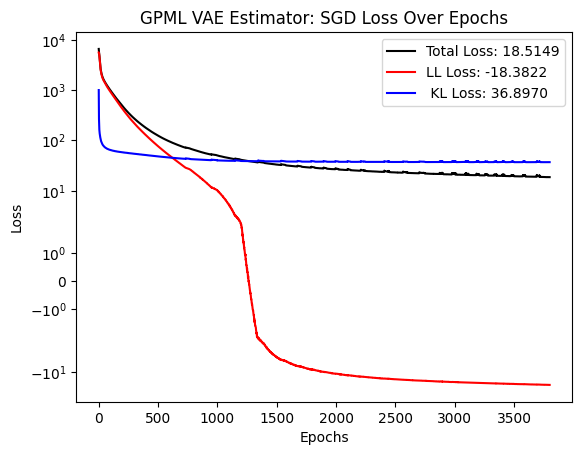

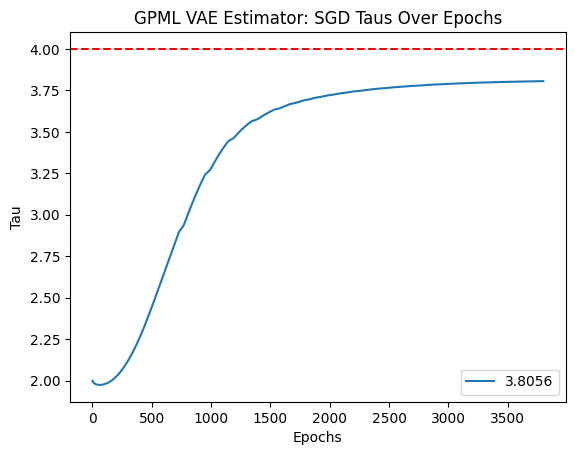

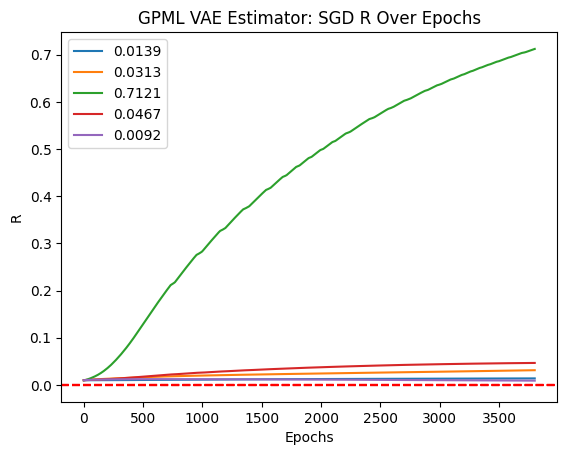

VAE Fit:  39%|███▉      | 3900/10000 [45:11<1:08:08,  1.49it/s]

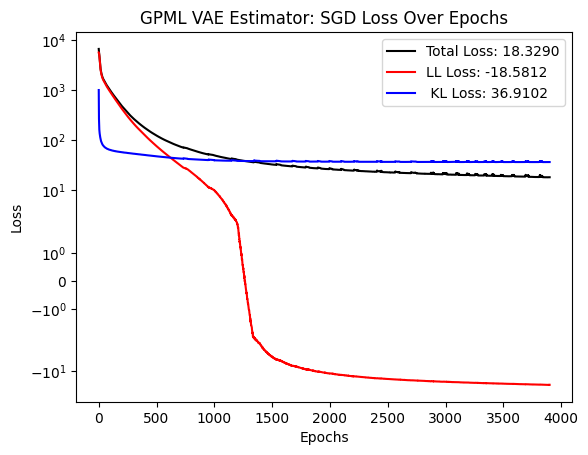

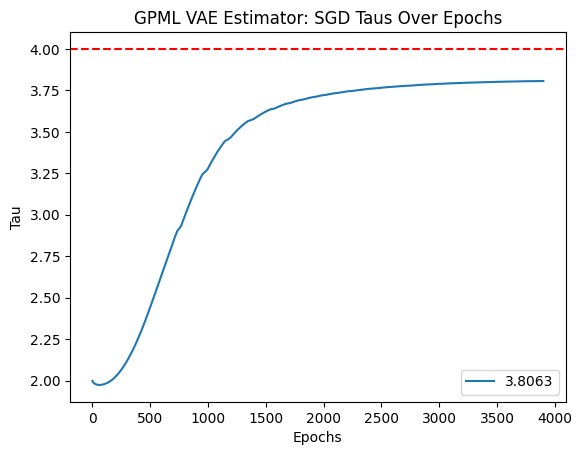

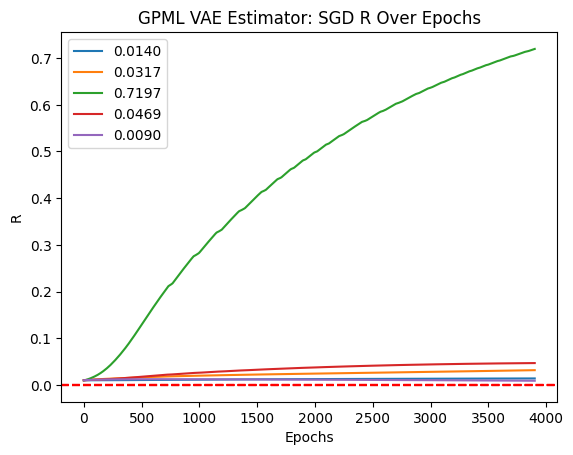

VAE Fit:  40%|████      | 4000/10000 [46:23<1:06:56,  1.49it/s]

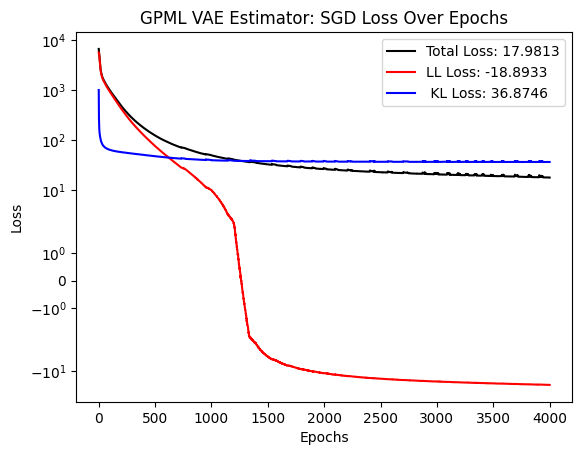

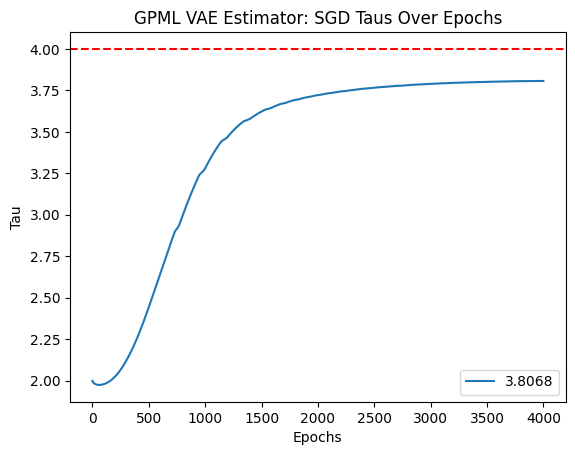

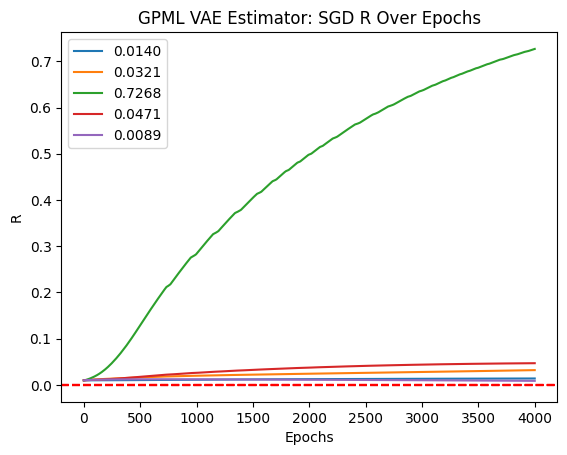

VAE Fit:  41%|████      | 4100/10000 [47:34<1:07:43,  1.45it/s]

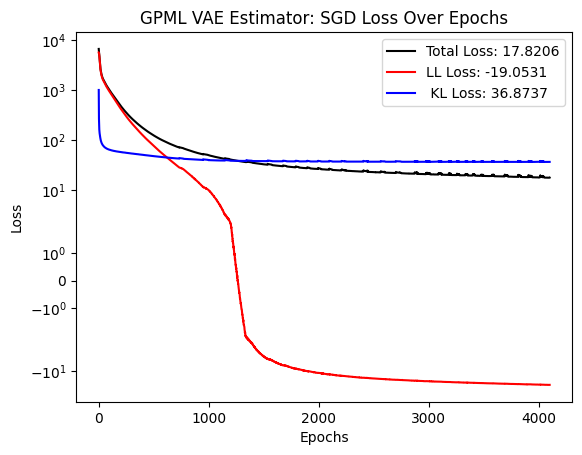

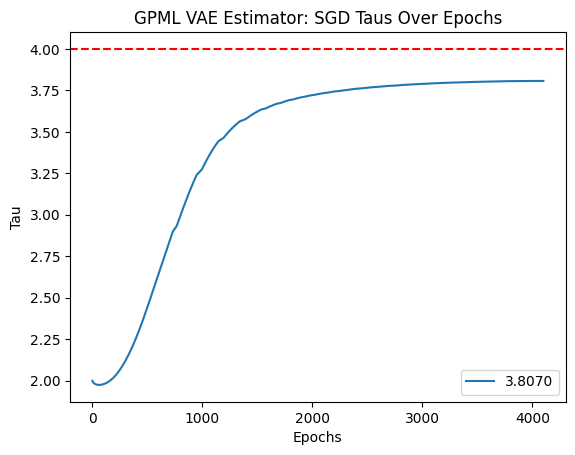

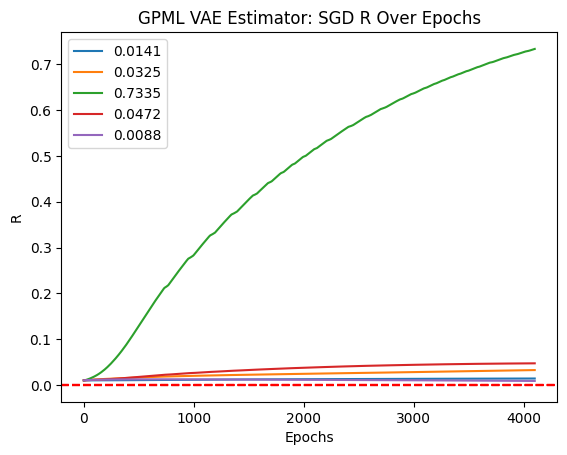

VAE Fit:  42%|████▏     | 4200/10000 [48:45<1:25:12,  1.13it/s]

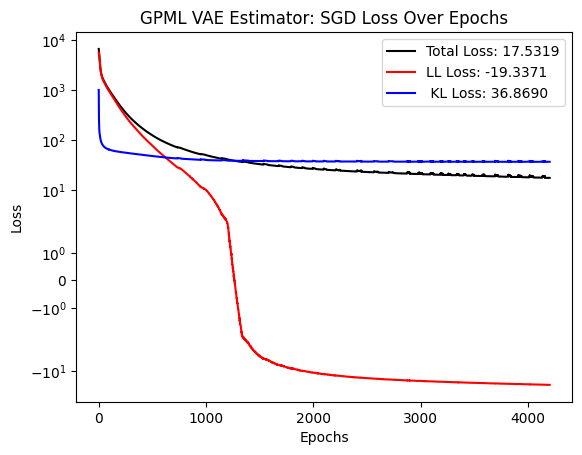

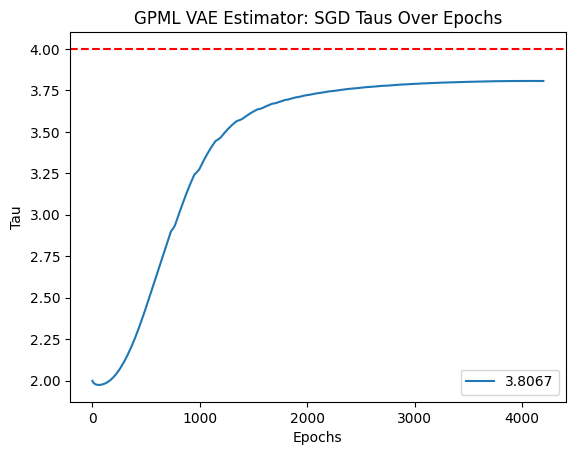

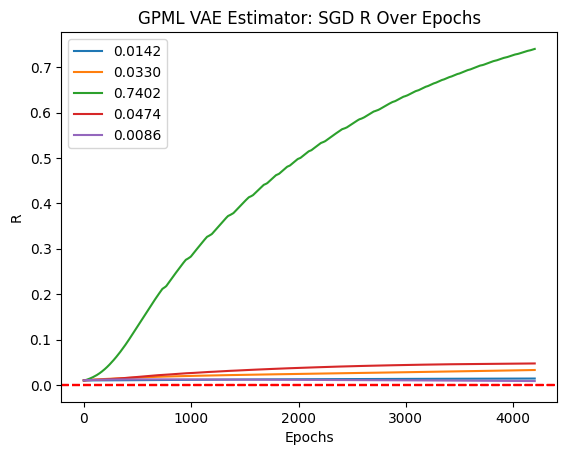

VAE Fit:  43%|████▎     | 4300/10000 [49:57<1:13:06,  1.30it/s]

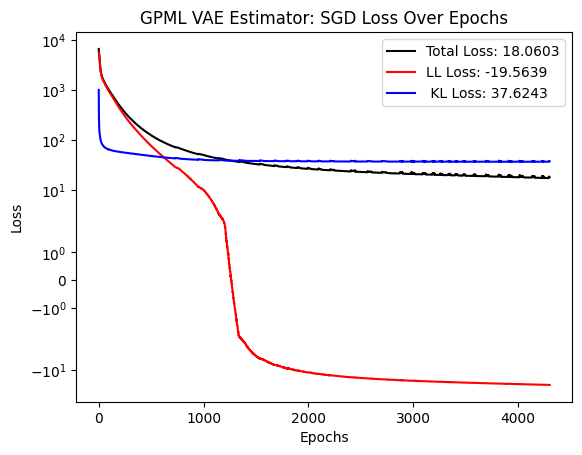

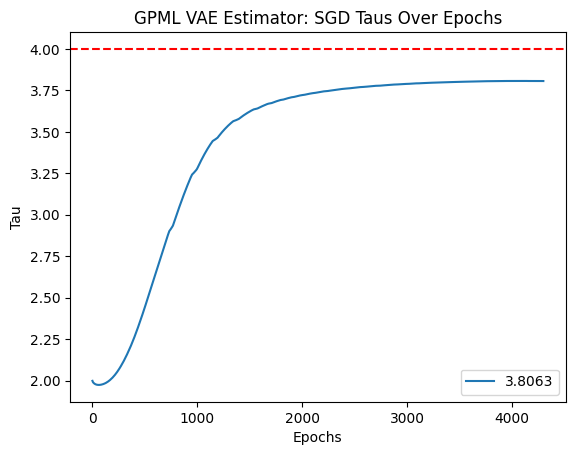

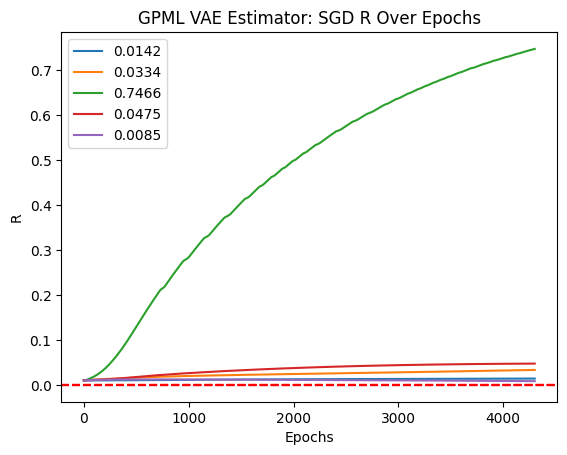

VAE Fit:  44%|████▍     | 4400/10000 [51:10<1:10:45,  1.32it/s]

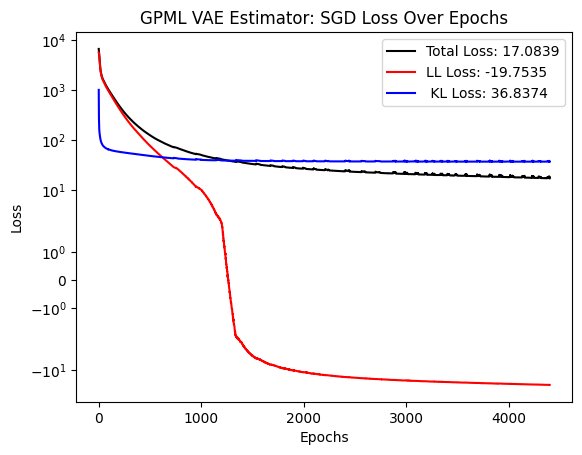

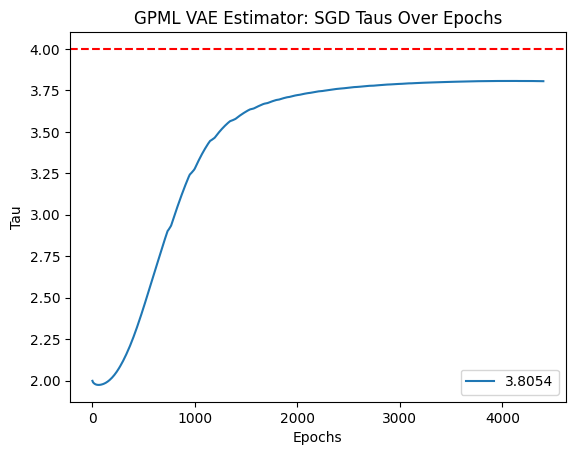

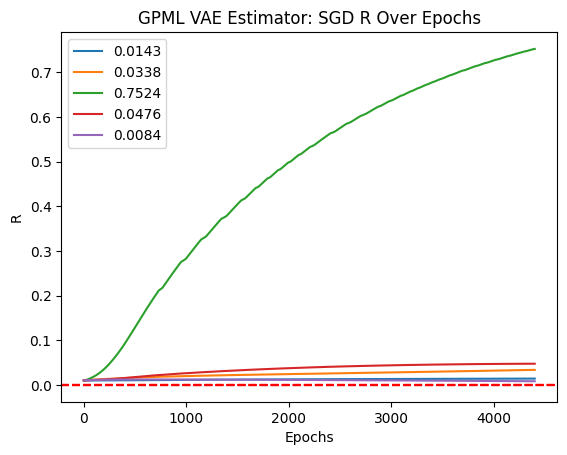

VAE Fit:  45%|████▌     | 4500/10000 [52:22<1:04:54,  1.41it/s]

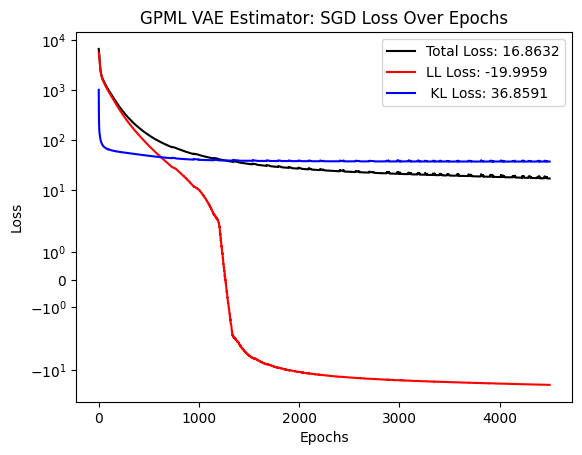

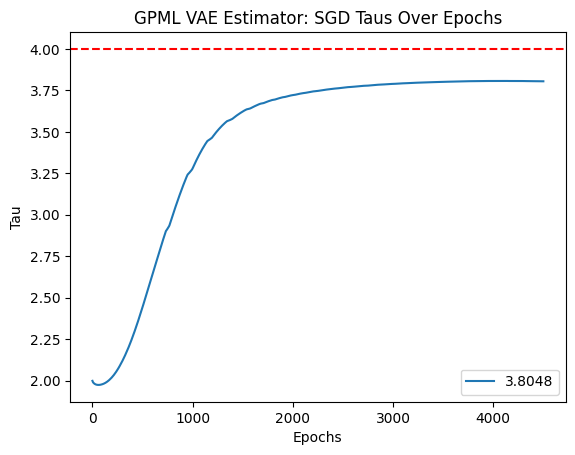

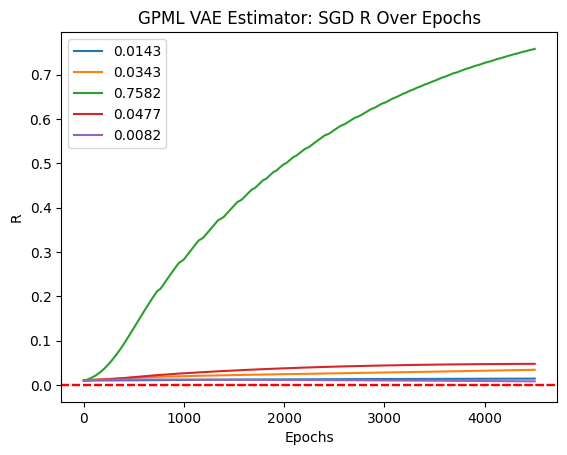

VAE Fit:  46%|████▌     | 4600/10000 [53:34<1:11:39,  1.26it/s]

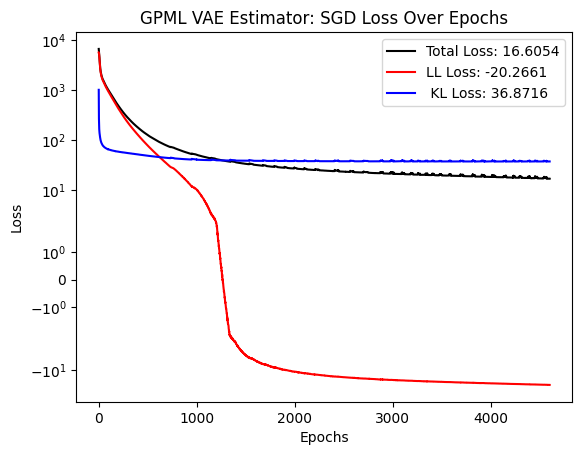

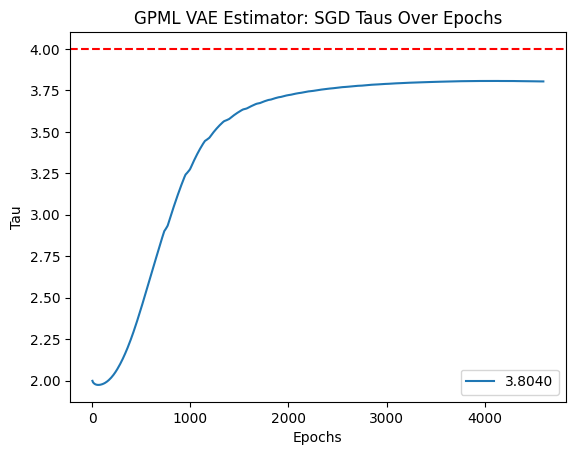

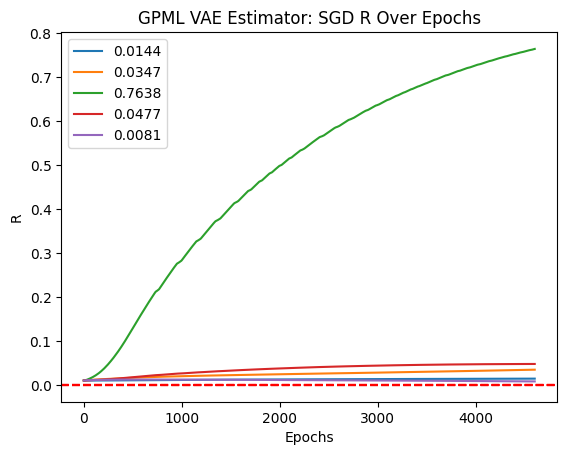

VAE Fit:  47%|████▋     | 4700/10000 [54:45<1:06:27,  1.33it/s]

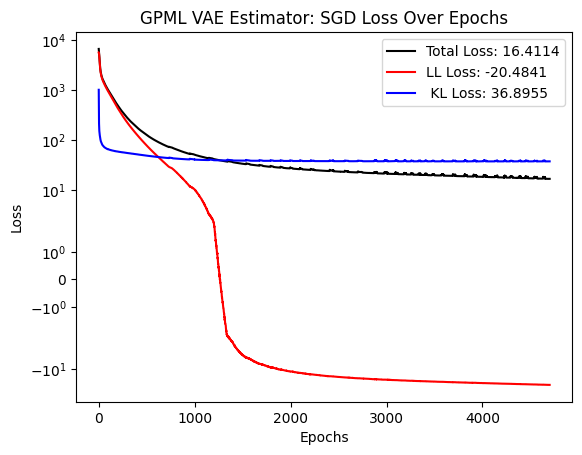

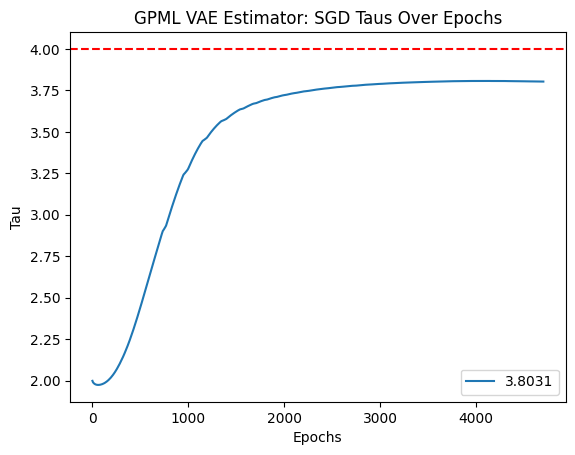

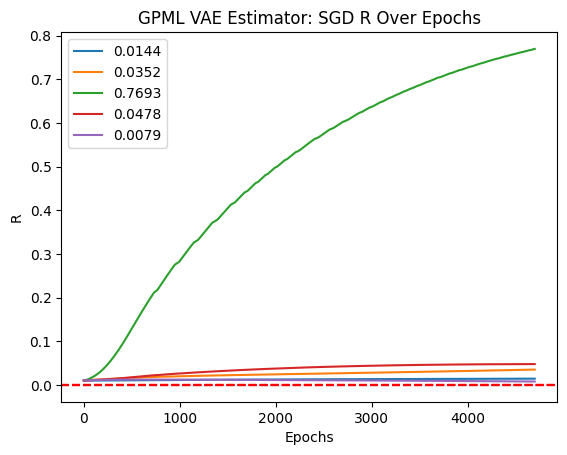

VAE Fit:  48%|████▊     | 4800/10000 [55:59<1:09:17,  1.25it/s]

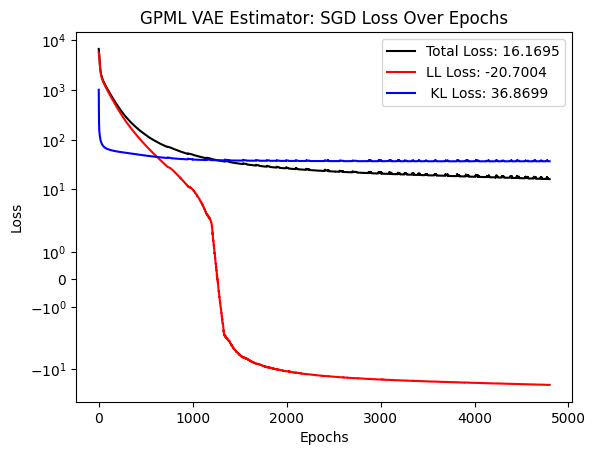

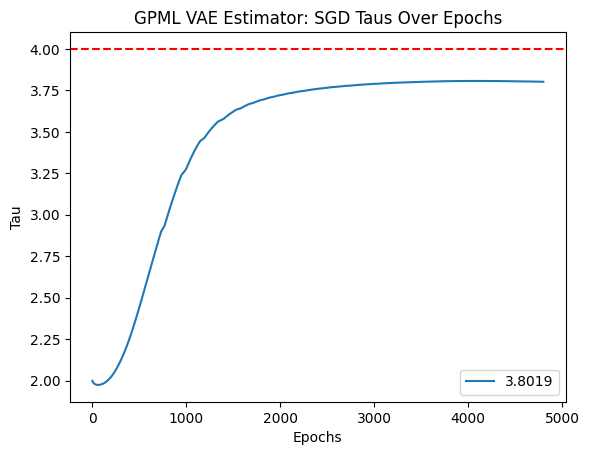

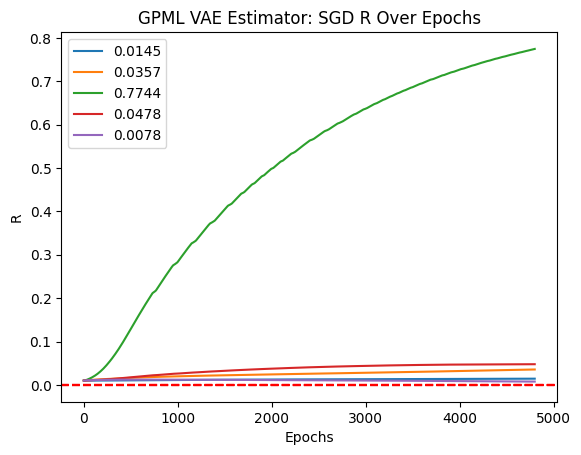

VAE Fit:  49%|████▉     | 4900/10000 [57:13<1:06:30,  1.28it/s]

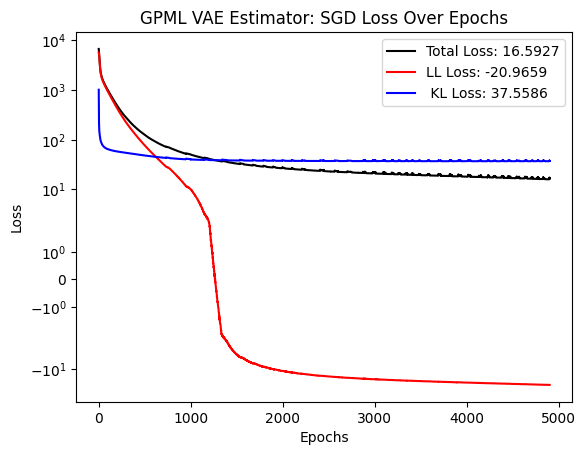

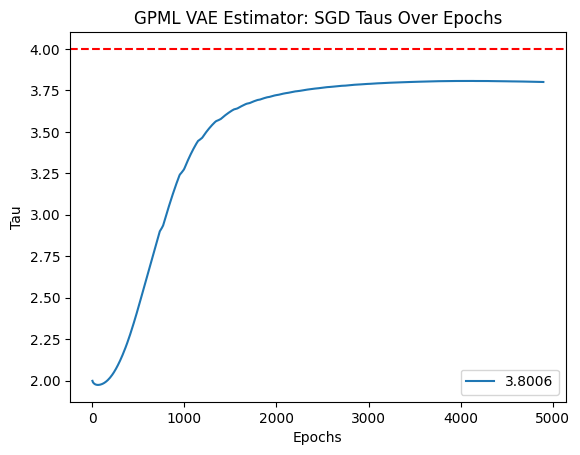

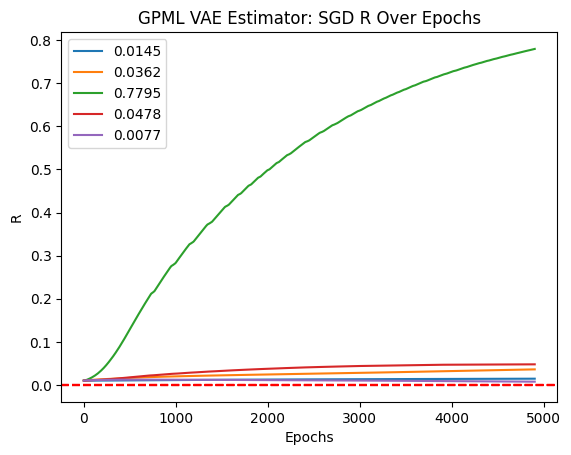

VAE Fit:  50%|█████     | 5000/10000 [58:27<1:01:21,  1.36it/s]

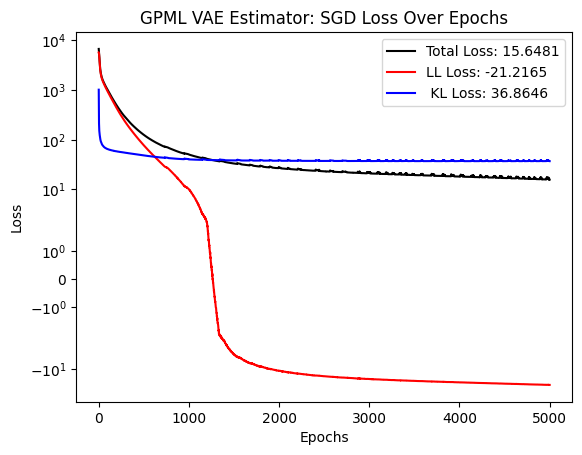

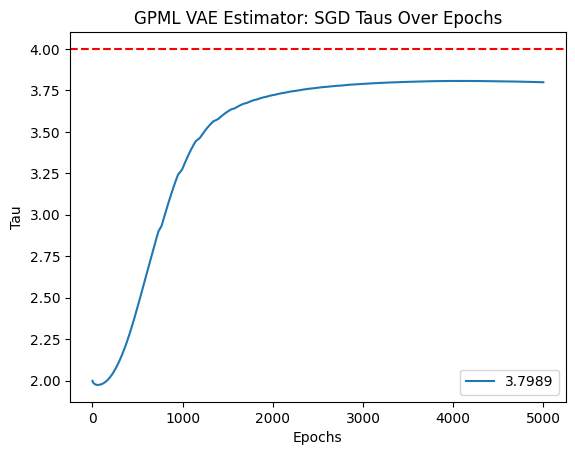

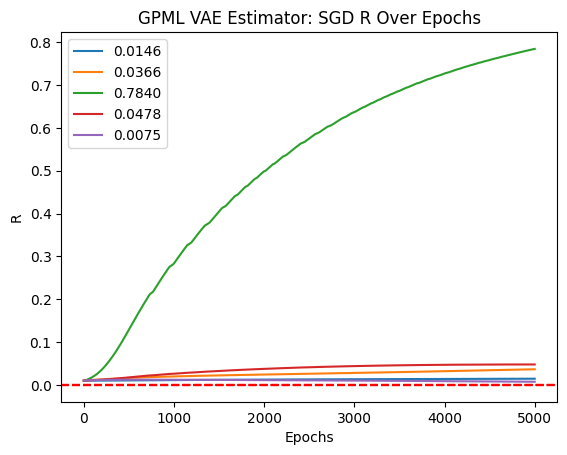

VAE Fit:  51%|█████     | 5100/10000 [59:40<59:53,  1.36it/s]

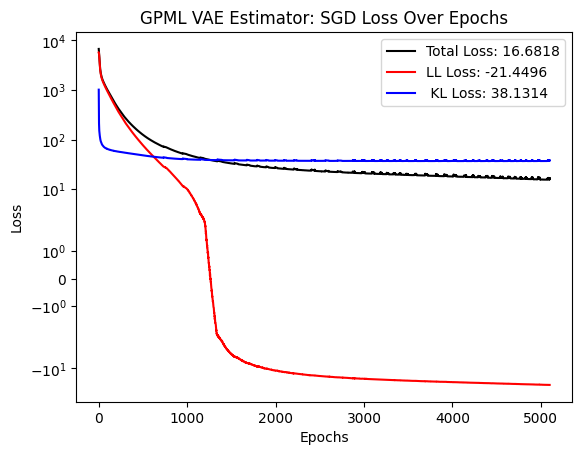

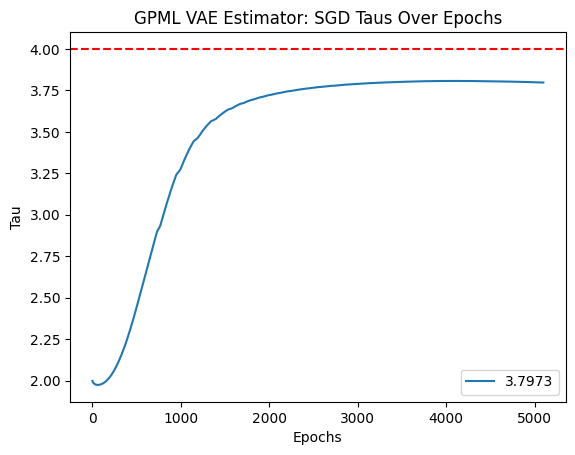

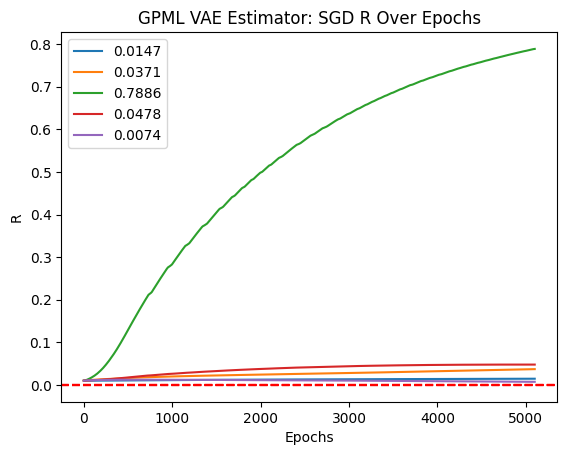

VAE Fit:  52%|█████▏    | 5200/10000 [1:00:53<56:15,  1.42it/s]

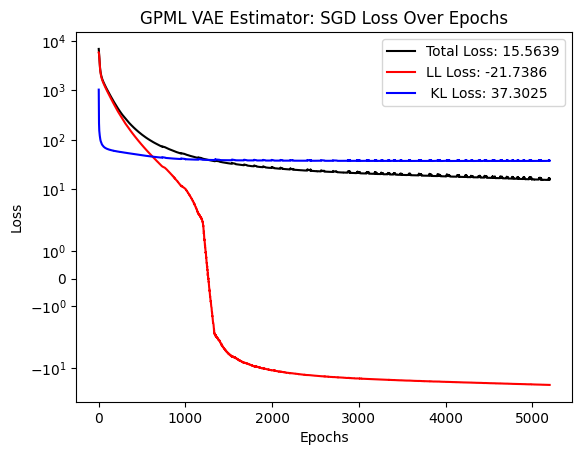

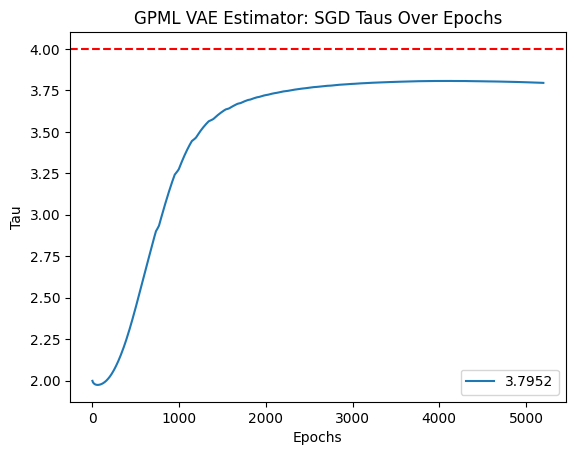

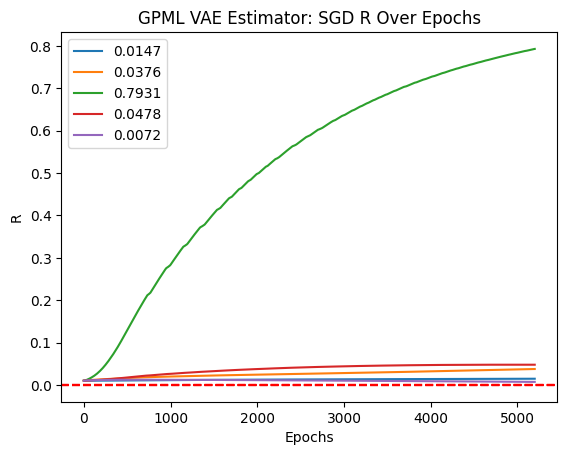

VAE Fit:  53%|█████▎    | 5300/10000 [1:02:08<54:04,  1.45it/s]

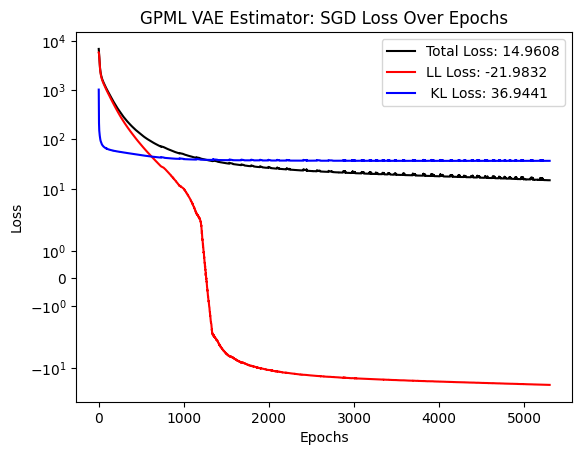

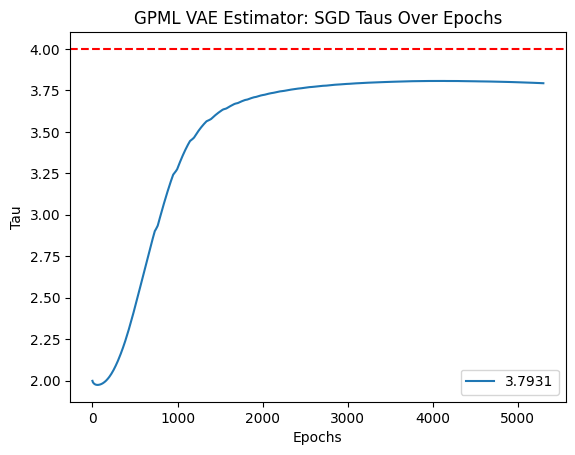

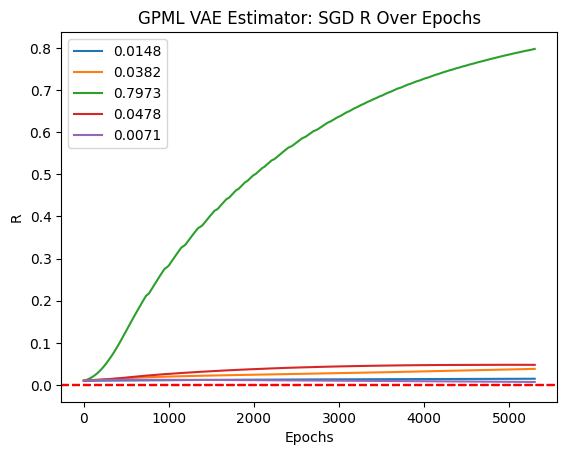

VAE Fit:  54%|█████▍    | 5400/10000 [1:03:21<53:44,  1.43it/s]

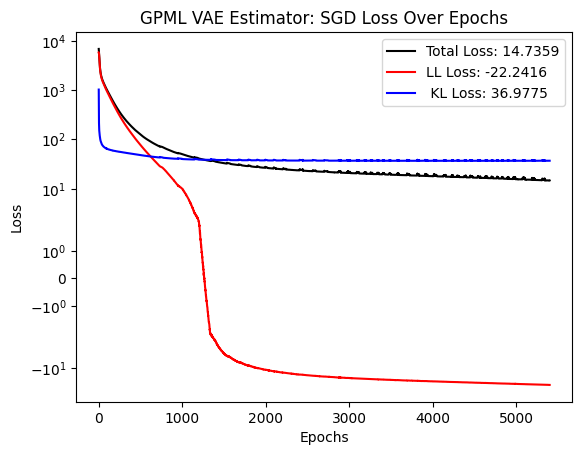

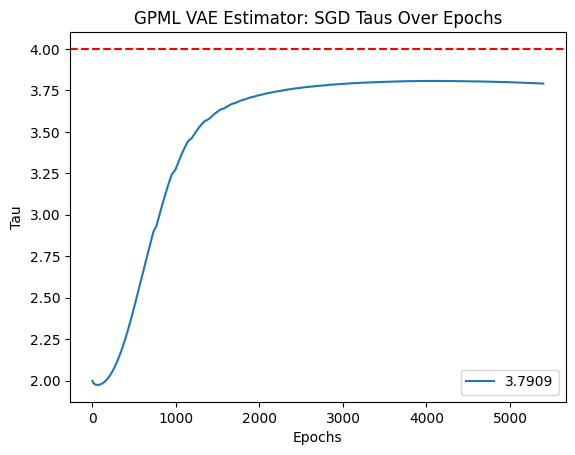

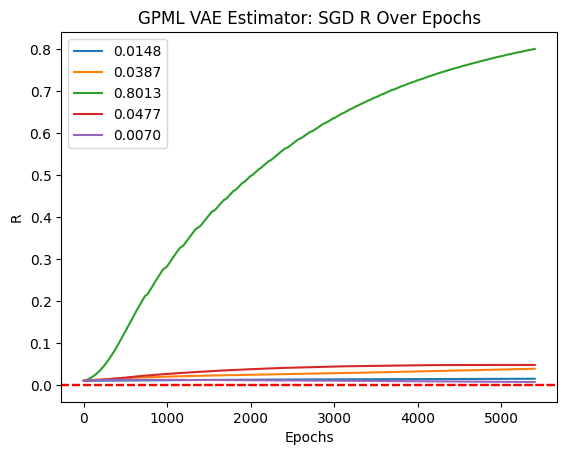

VAE Fit:  55%|█████▌    | 5500/10000 [1:04:35<51:49,  1.45it/s]

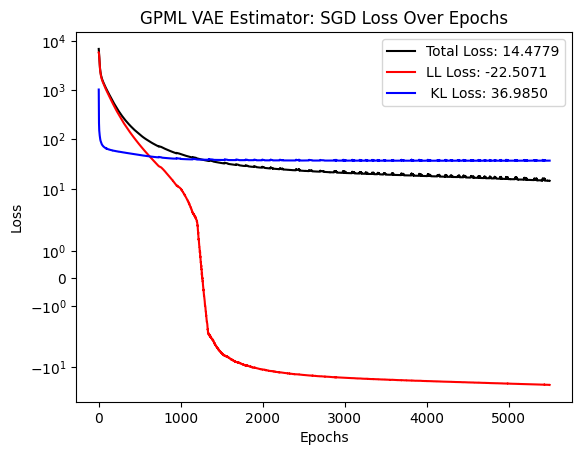

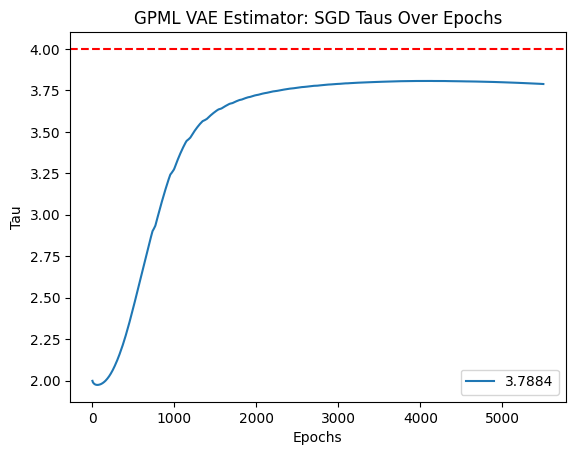

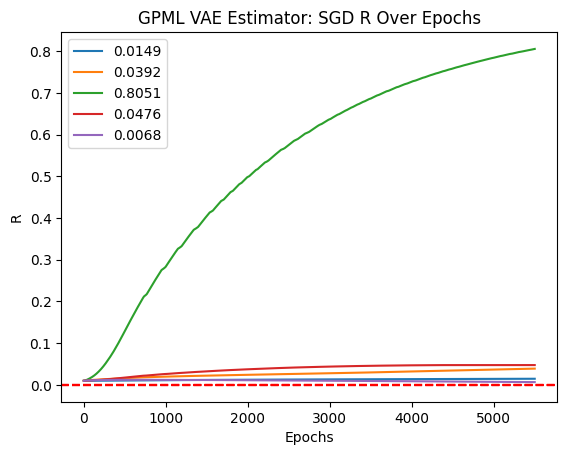

VAE Fit:  56%|█████▌    | 5600/10000 [1:05:49<51:03,  1.44it/s]

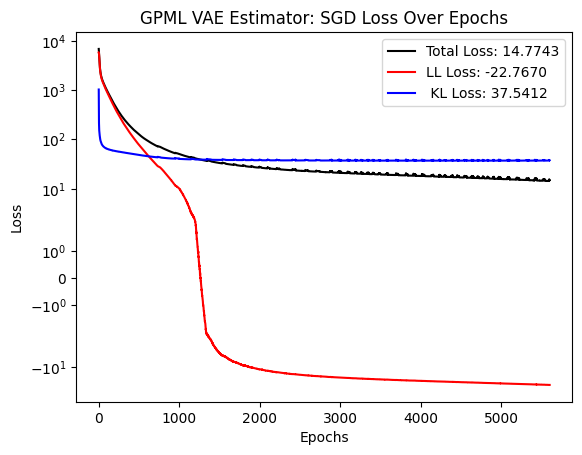

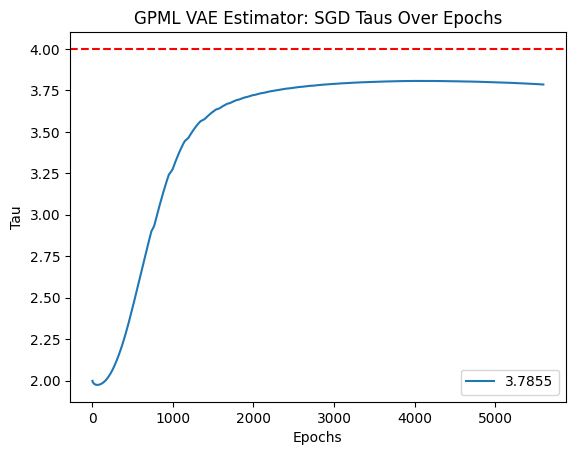

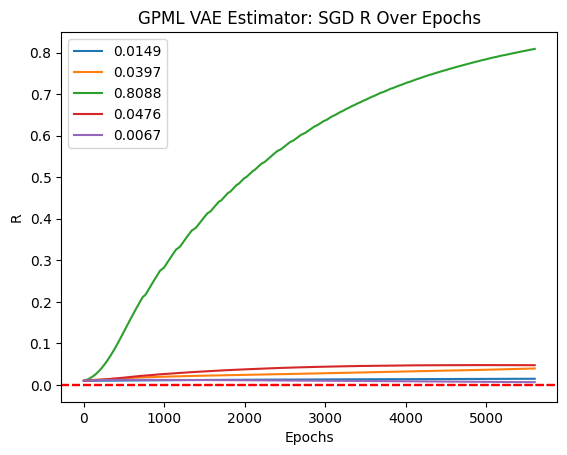

VAE Fit:  57%|█████▋    | 5700/10000 [1:07:04<49:31,  1.45it/s]

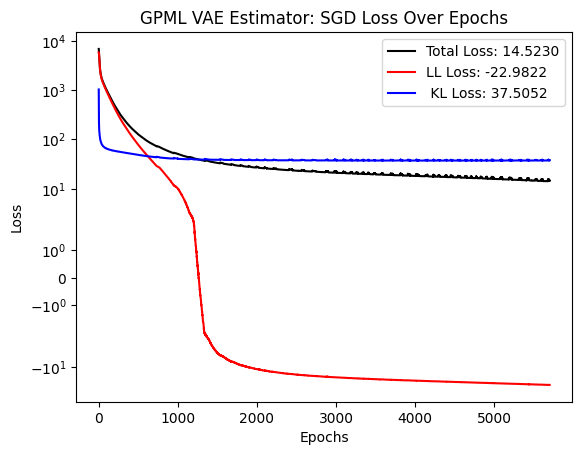

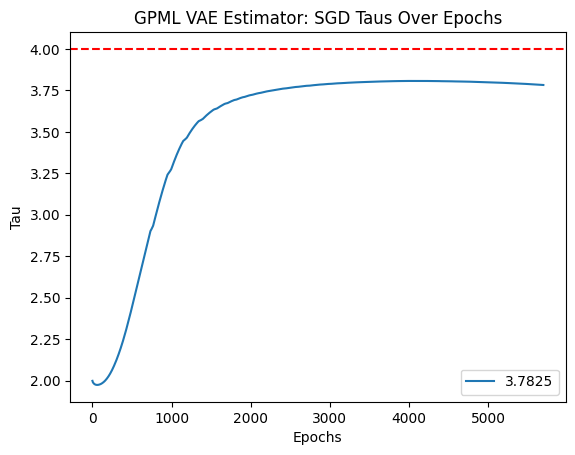

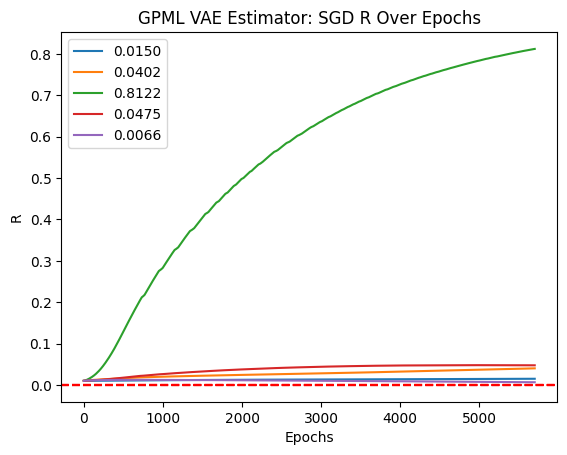

VAE Fit:  58%|█████▊    | 5800/10000 [1:08:19<54:25,  1.29it/s]

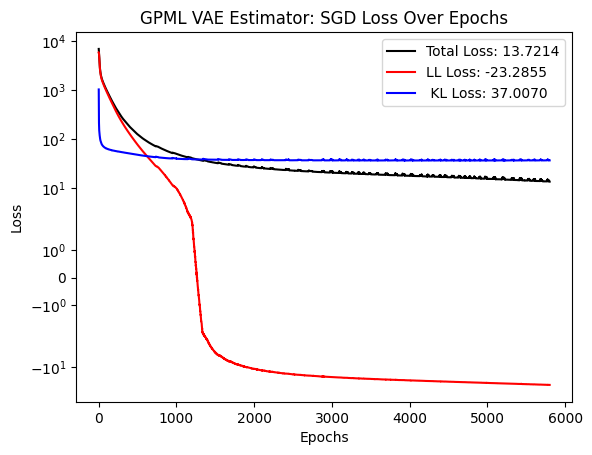

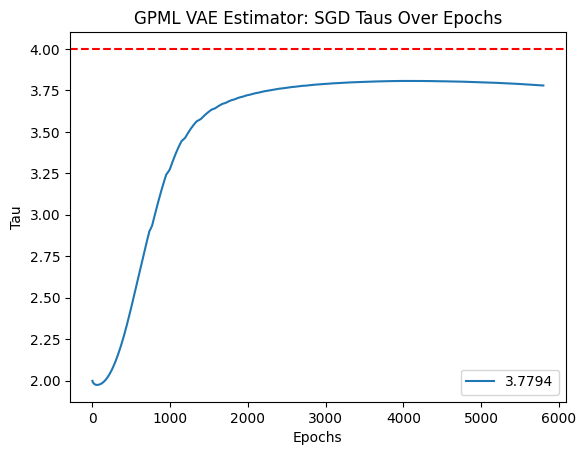

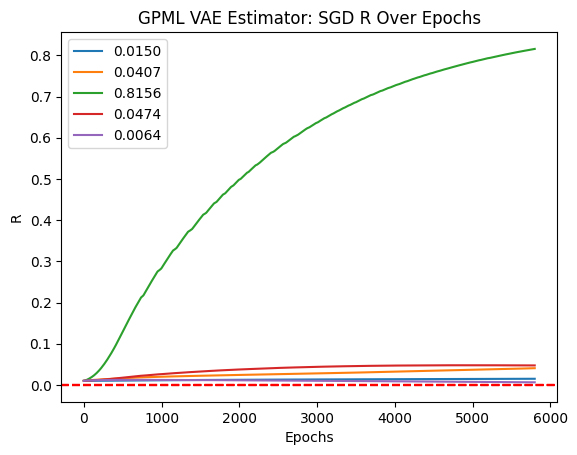

VAE Fit:  59%|█████▉    | 5900/10000 [1:09:33<53:27,  1.28it/s]

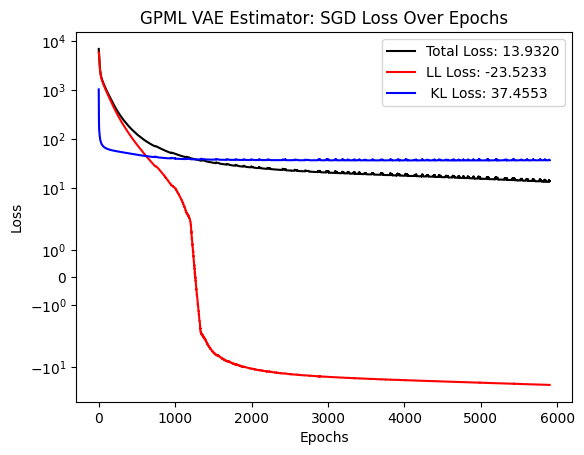

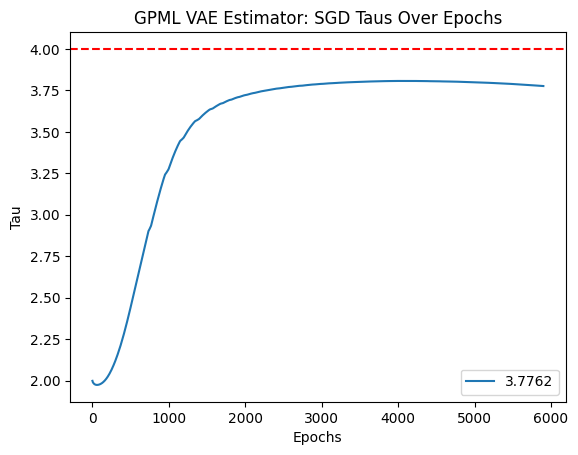

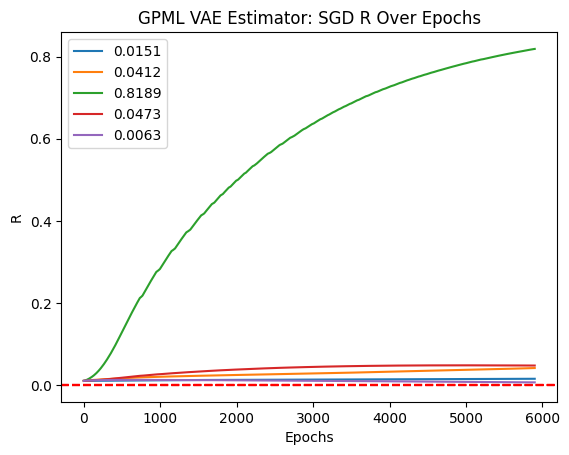

VAE Fit:  60%|██████    | 6000/10000 [1:10:48<50:24,  1.32it/s]

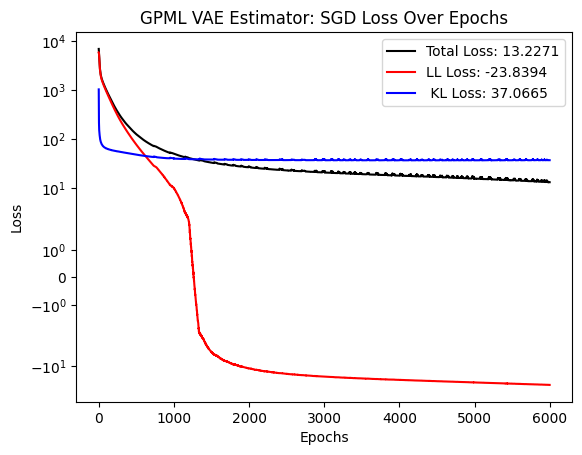

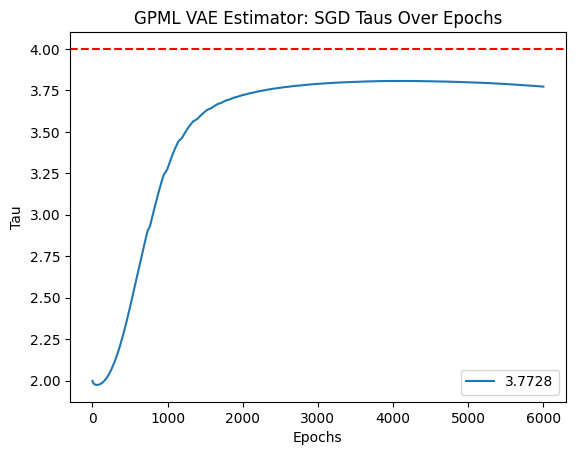

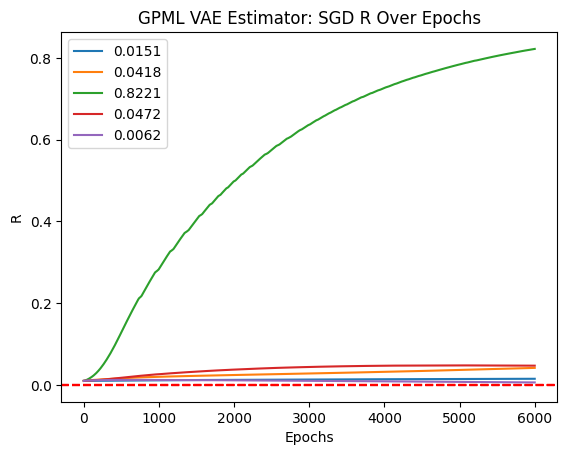

VAE Fit:  61%|██████    | 6100/10000 [1:12:02<46:52,  1.39it/s]

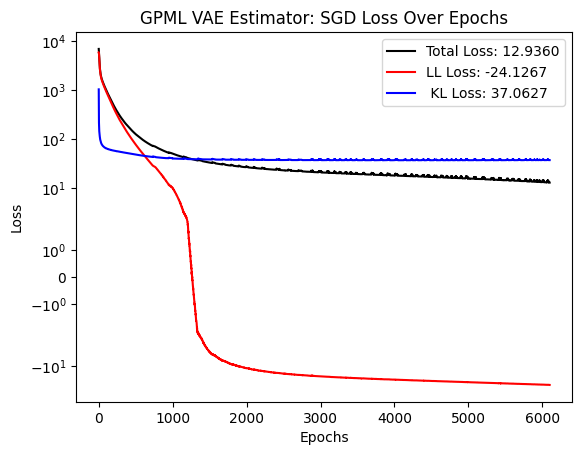

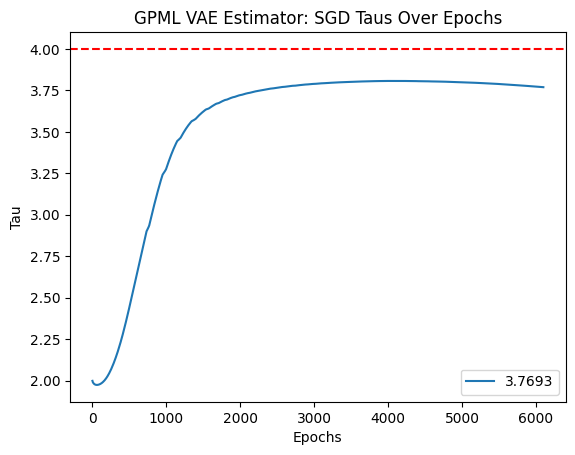

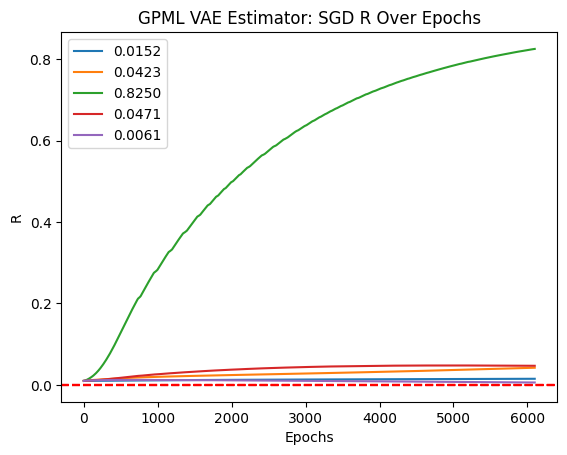

VAE Fit:  62%|██████▏   | 6200/10000 [1:13:16<45:25,  1.39it/s]

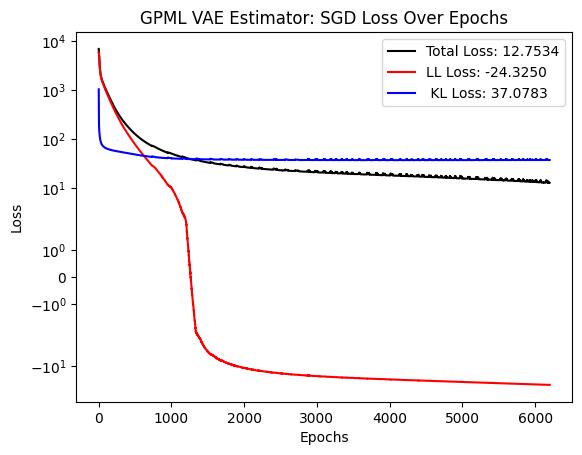

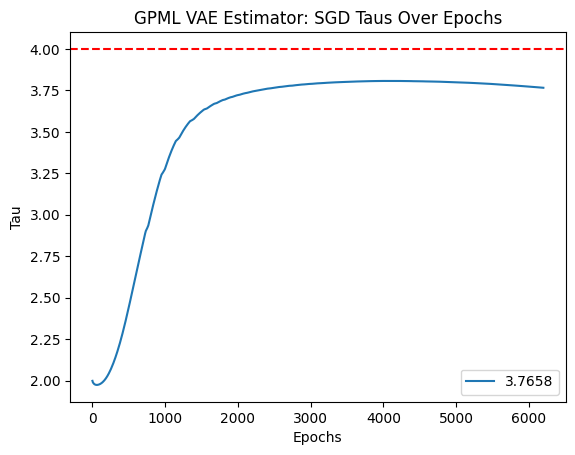

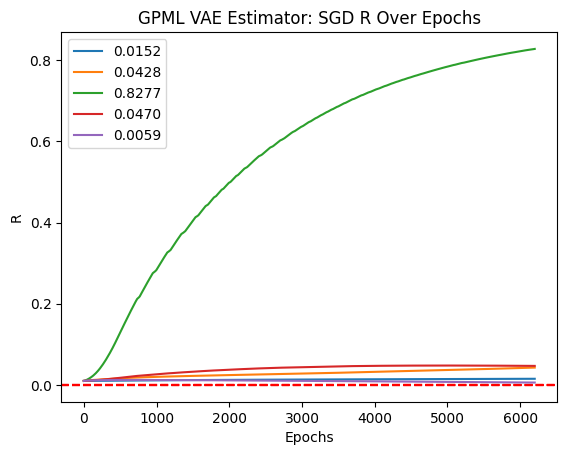

VAE Fit:  63%|██████▎   | 6300/10000 [1:14:30<44:36,  1.38it/s]

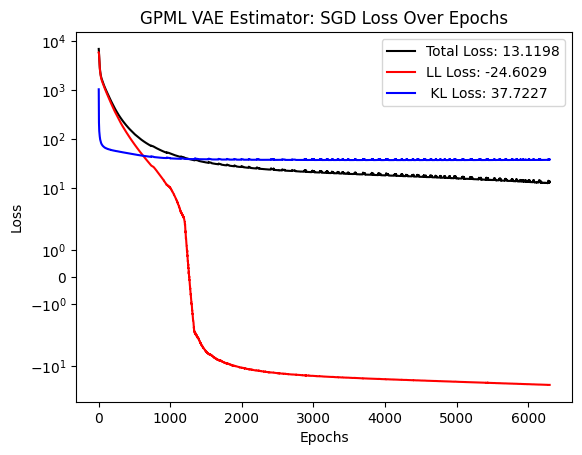

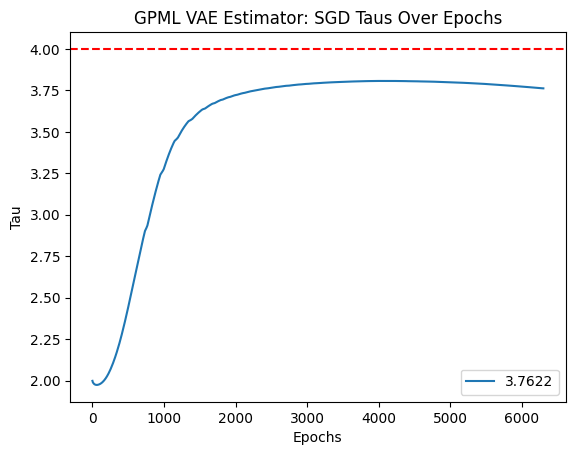

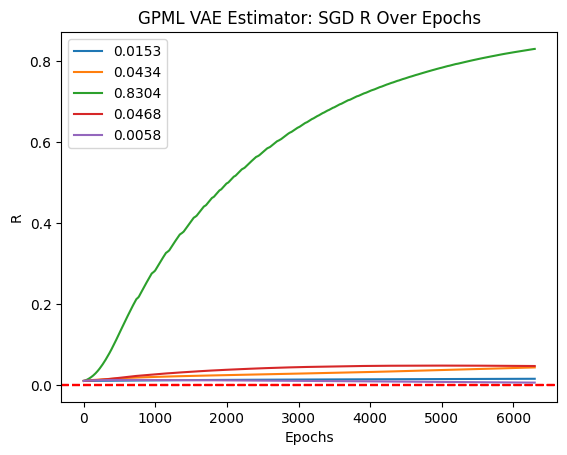

VAE Fit:  64%|██████▍   | 6400/10000 [1:15:45<41:48,  1.44it/s]

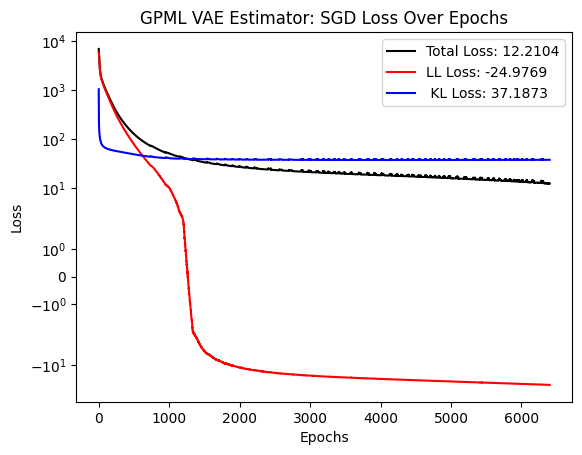

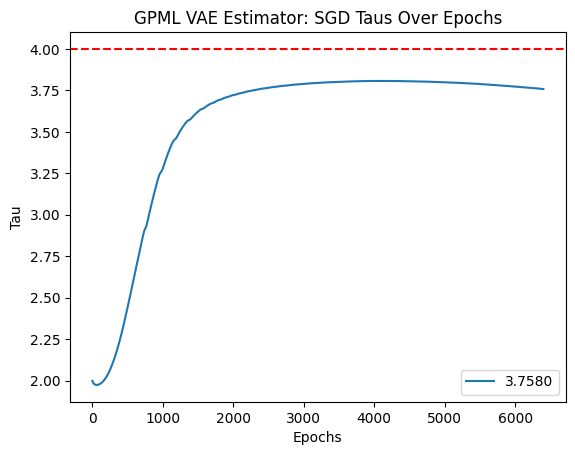

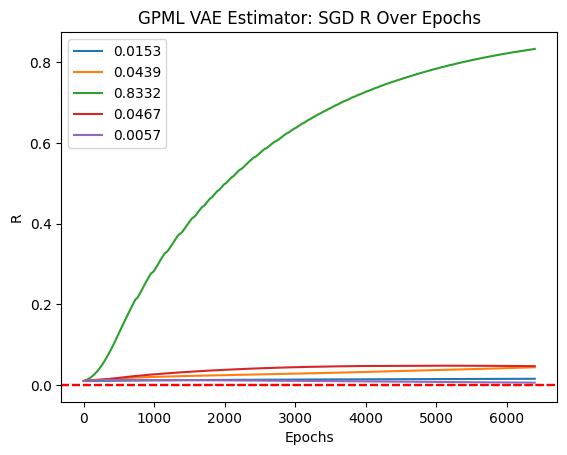

VAE Fit:  65%|██████▌   | 6500/10000 [1:16:58<41:07,  1.42it/s]

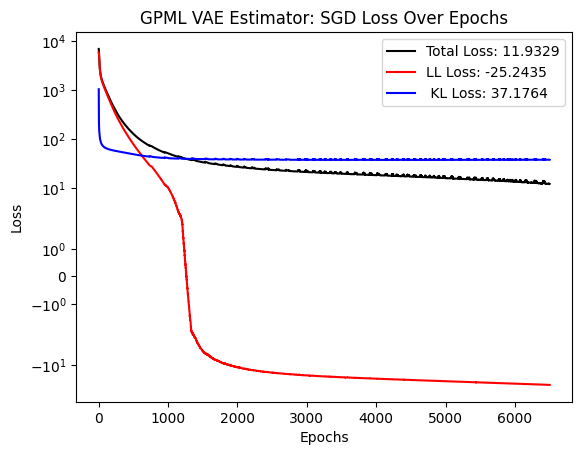

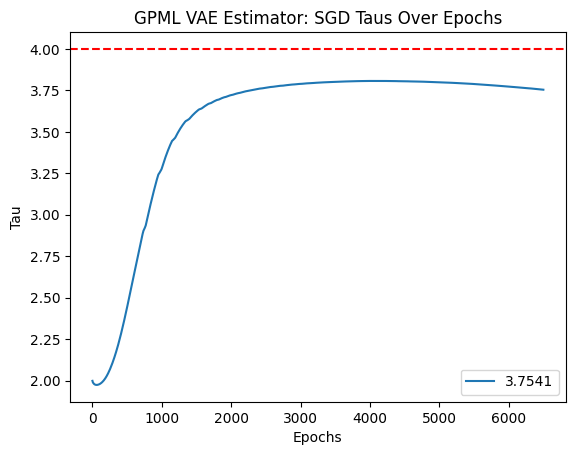

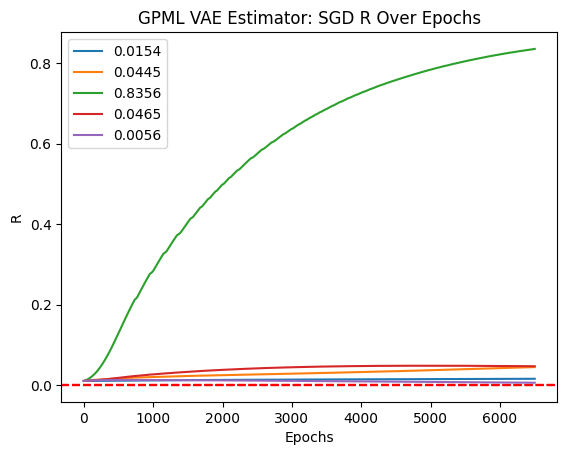

VAE Fit:  66%|██████▌   | 6600/10000 [1:18:14<43:51,  1.29it/s]

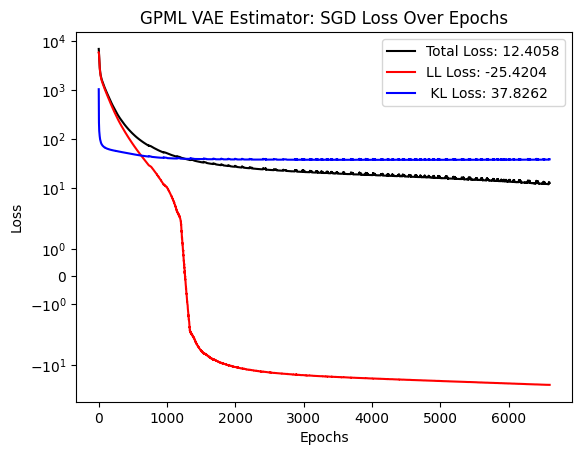

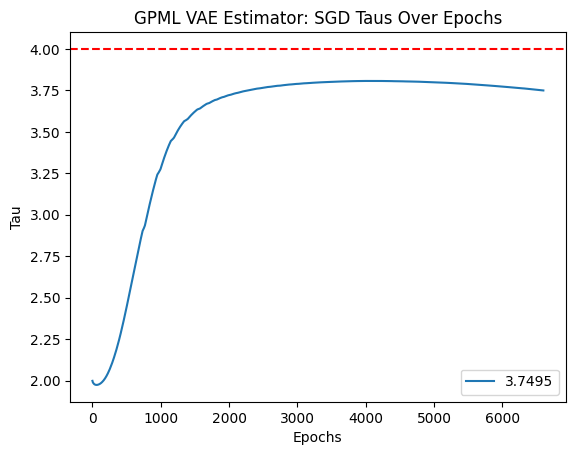

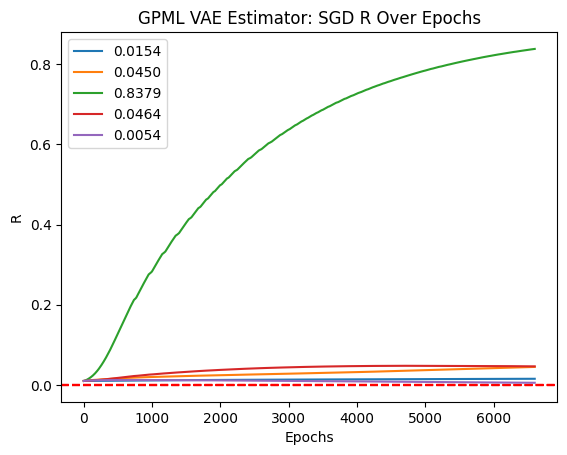

VAE Fit:  67%|██████▋   | 6700/10000 [1:19:29<43:25,  1.27it/s]

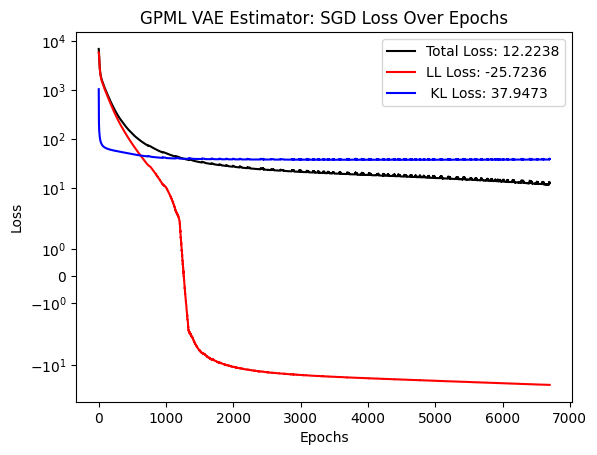

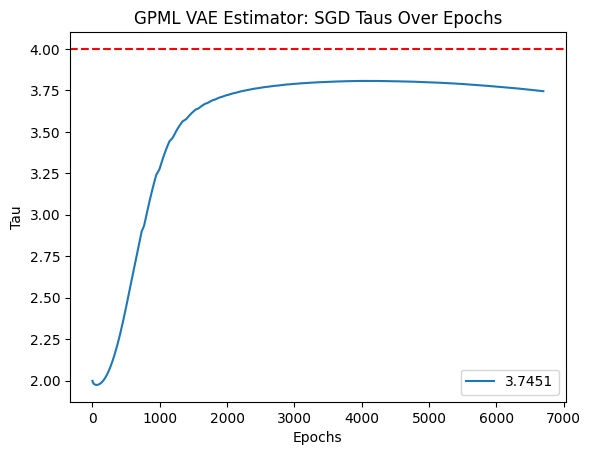

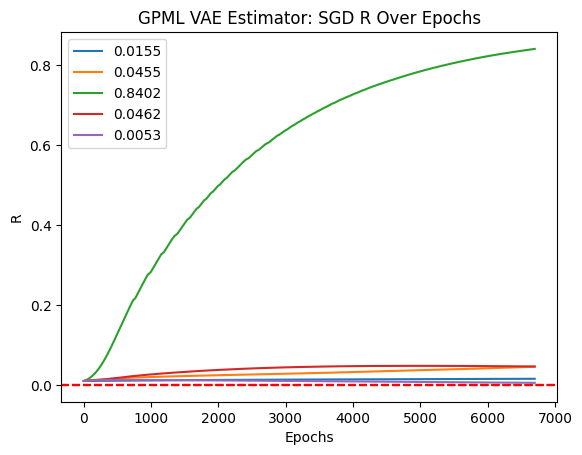

VAE Fit:  68%|██████▊   | 6800/10000 [1:20:44<38:21,  1.39it/s]

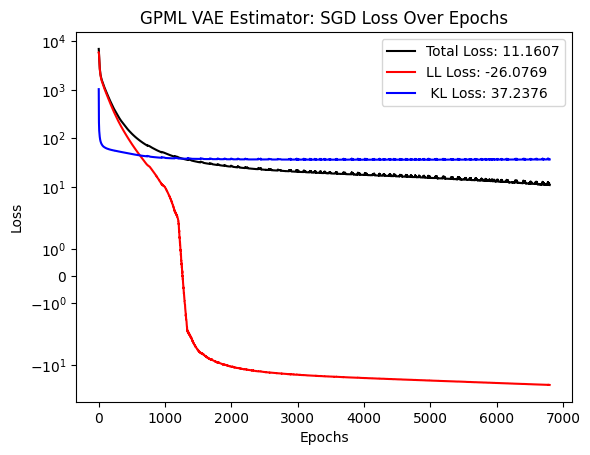

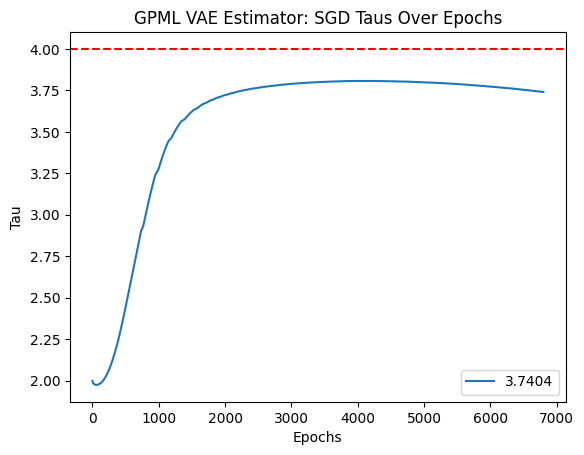

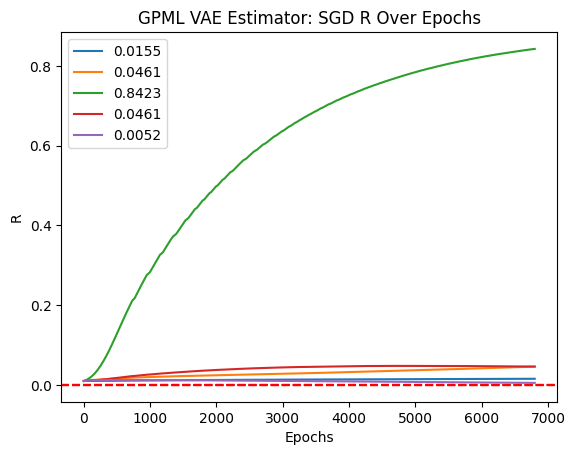

VAE Fit:  69%|██████▉   | 6900/10000 [1:21:57<36:14,  1.43it/s]

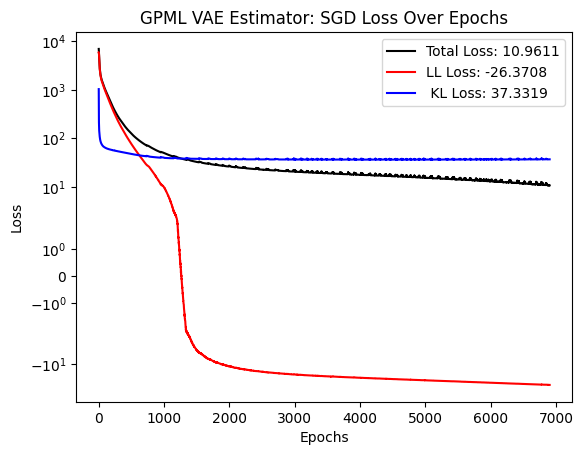

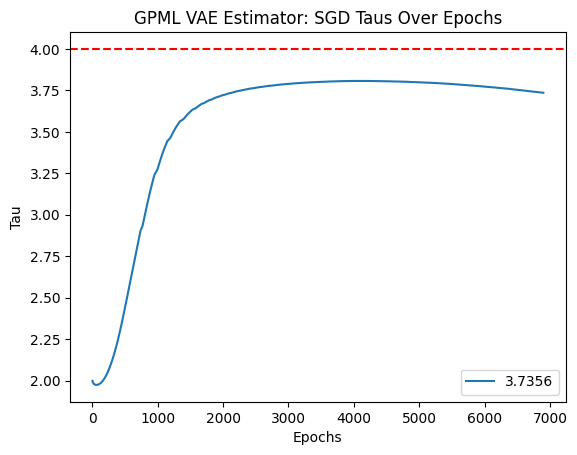

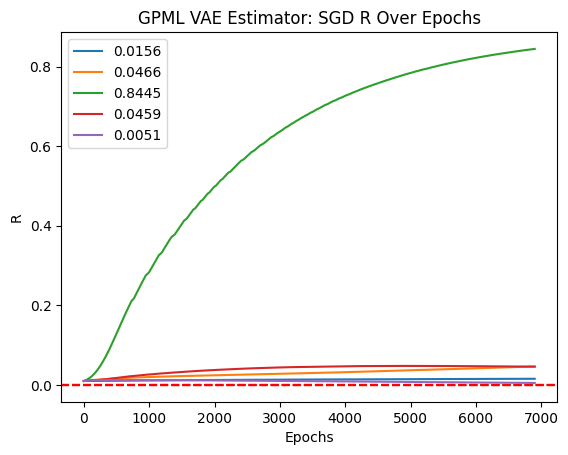

VAE Fit:  70%|███████   | 7000/10000 [1:23:11<34:54,  1.43it/s]

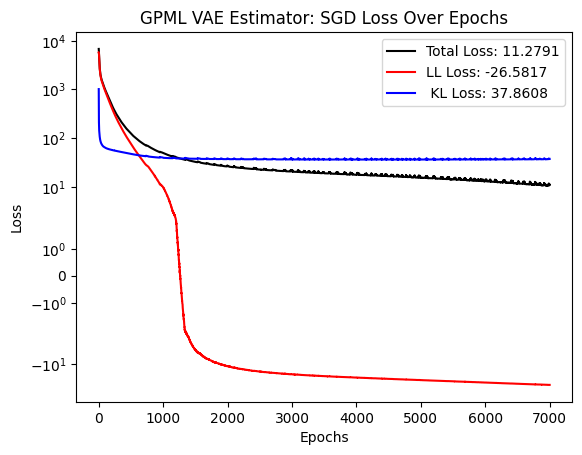

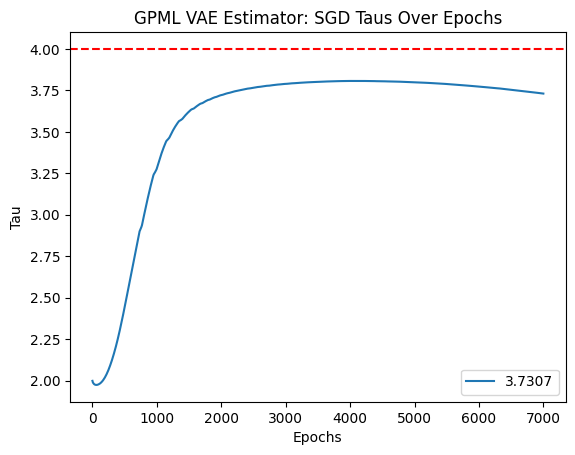

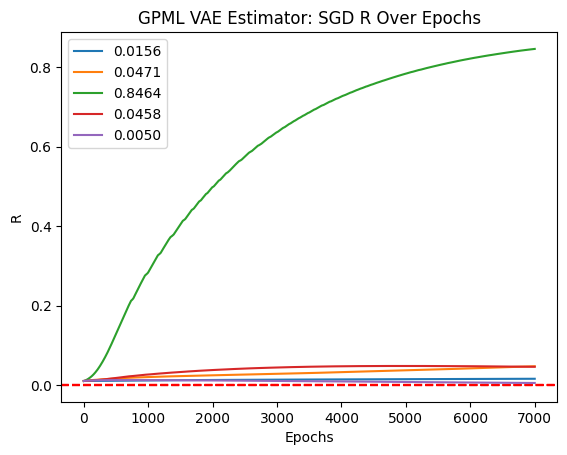

VAE Fit:  71%|███████   | 7100/10000 [1:24:25<33:21,  1.45it/s]

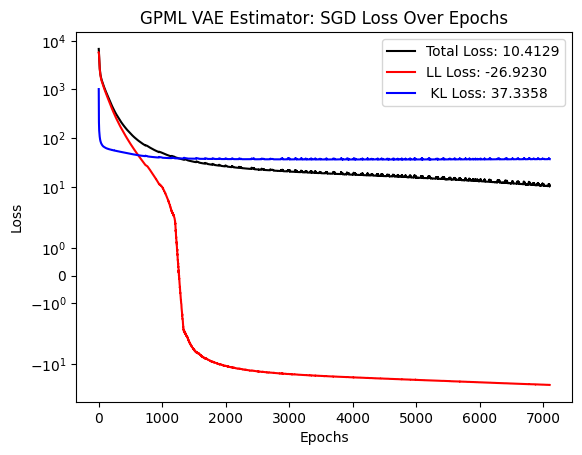

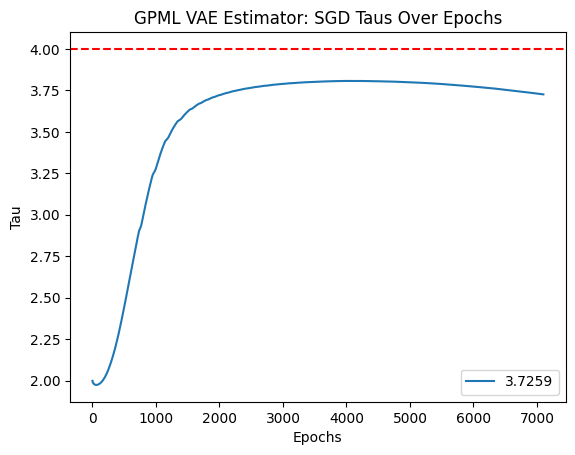

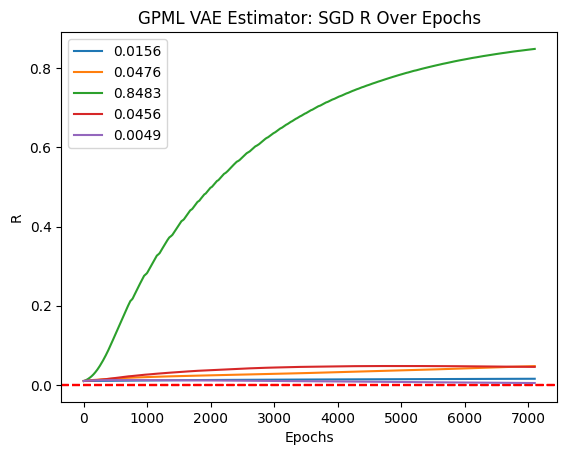

VAE Fit:  72%|███████▏  | 7200/10000 [1:25:38<32:58,  1.42it/s]

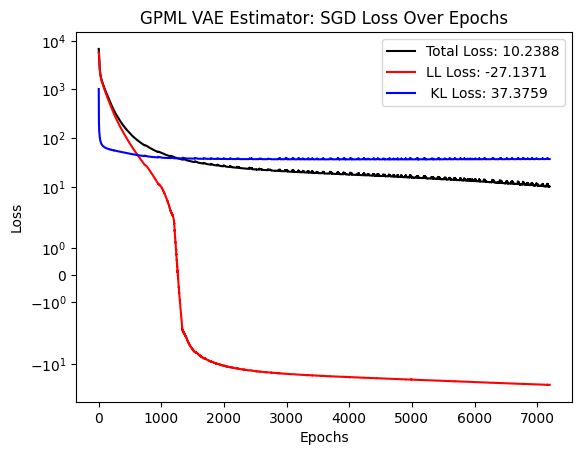

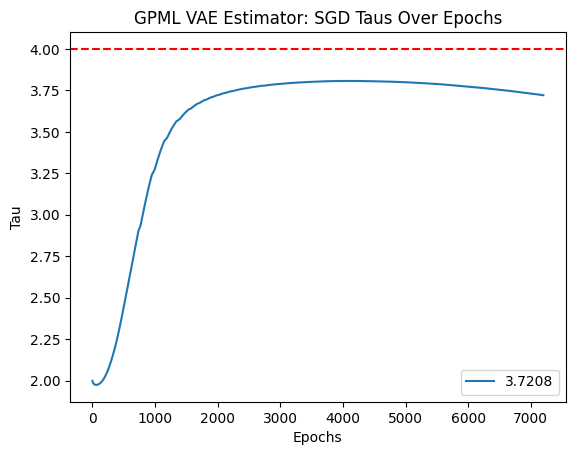

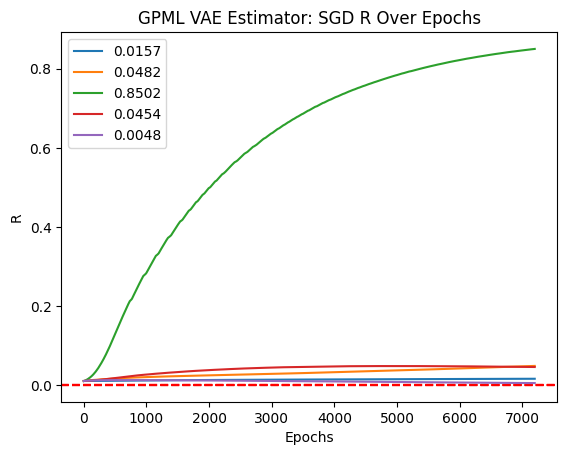

VAE Fit:  73%|███████▎  | 7300/10000 [1:26:51<30:58,  1.45it/s]

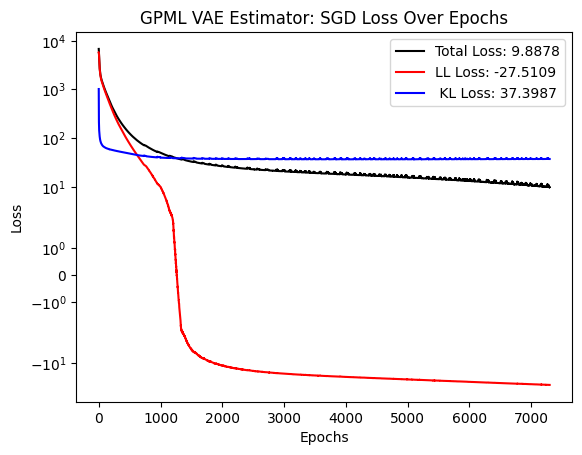

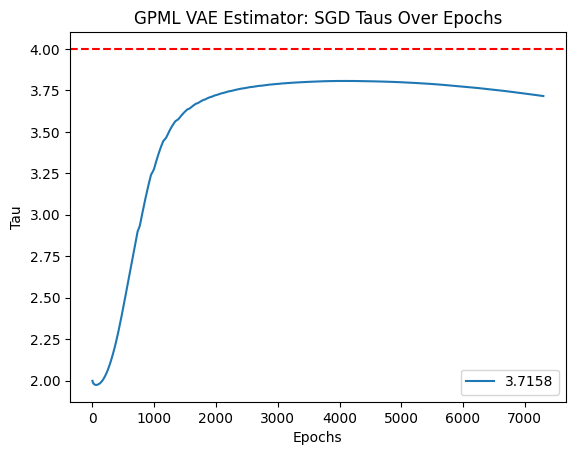

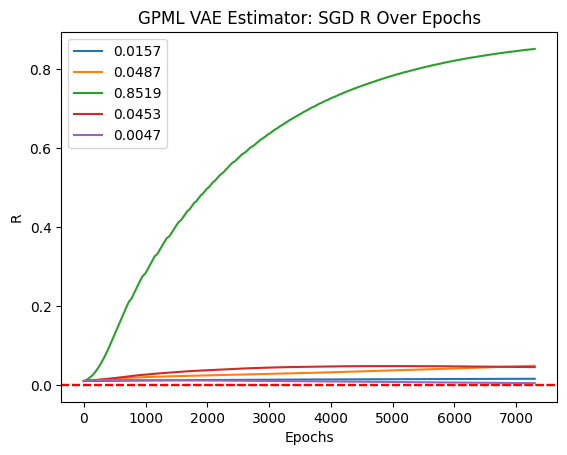

VAE Fit:  74%|███████▍  | 7400/10000 [1:28:05<30:05,  1.44it/s]

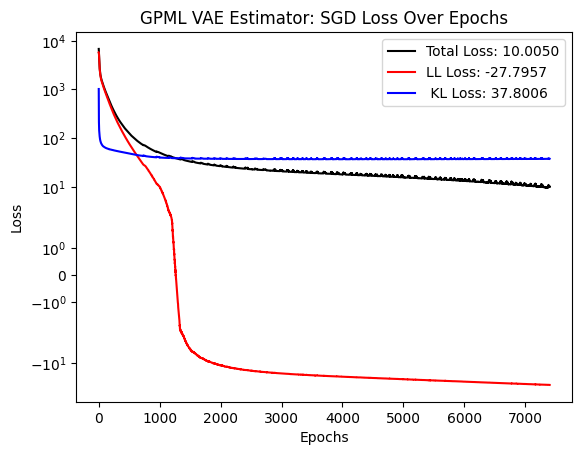

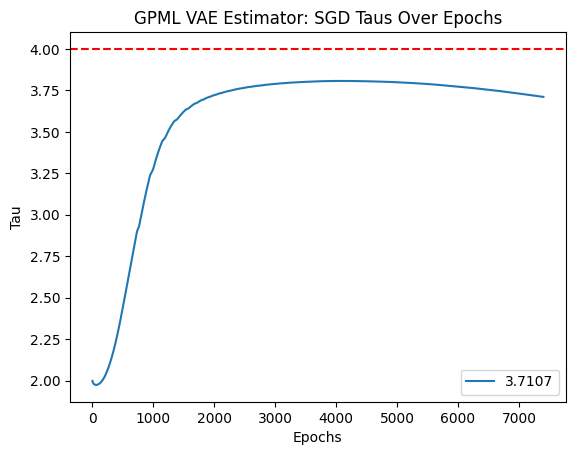

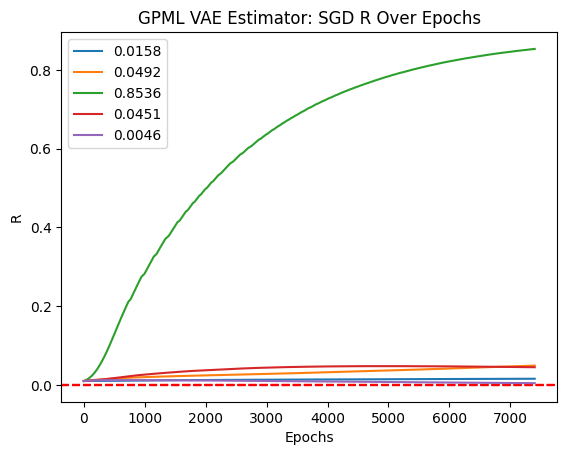

VAE Fit:  75%|███████▌  | 7500/10000 [1:29:18<28:31,  1.46it/s]

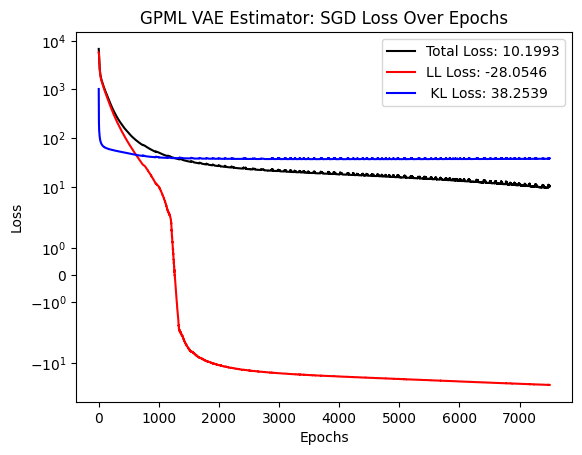

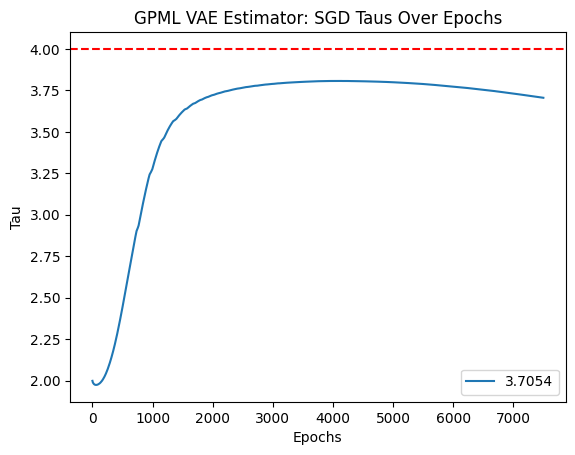

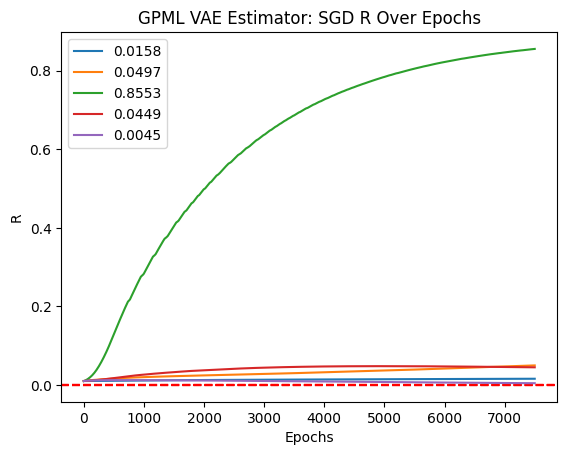

VAE Fit:  76%|███████▌  | 7600/10000 [1:30:31<27:28,  1.46it/s]

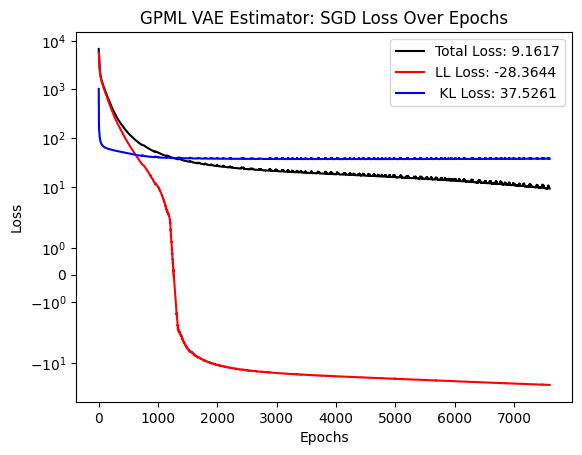

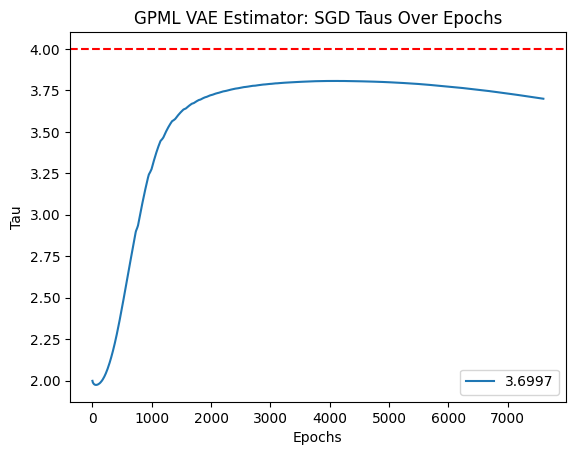

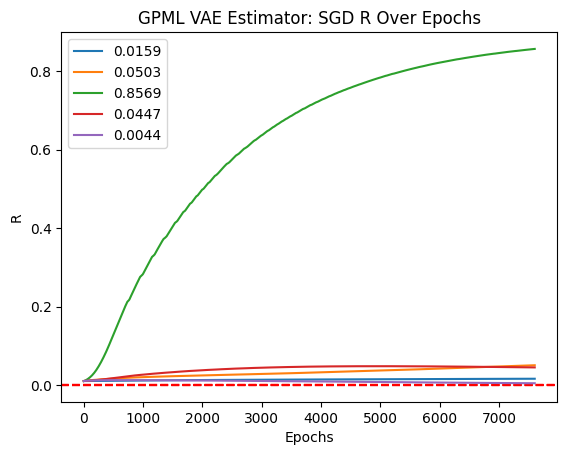

VAE Fit:  77%|███████▋  | 7700/10000 [1:31:42<25:46,  1.49it/s]

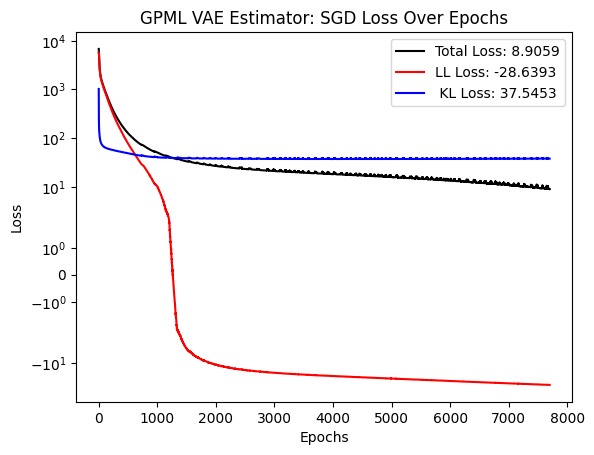

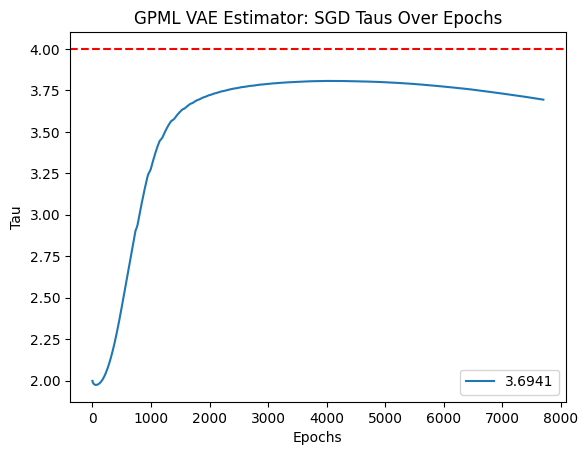

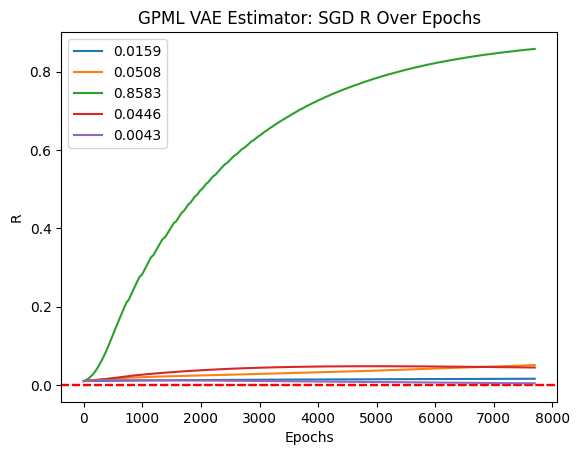

VAE Fit:  78%|███████▊  | 7800/10000 [1:32:54<24:30,  1.50it/s]

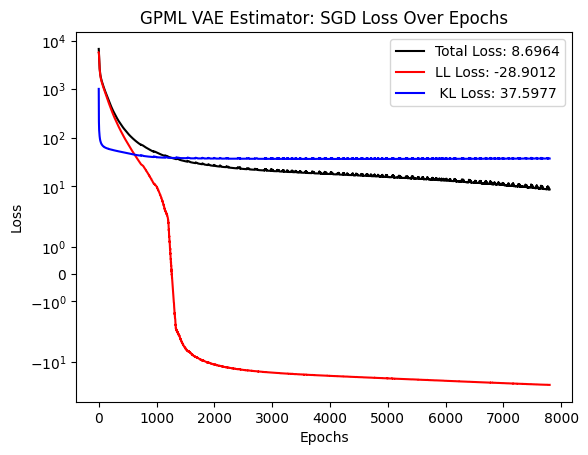

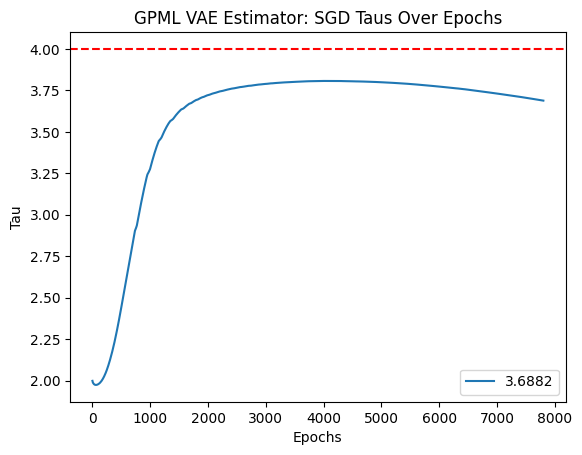

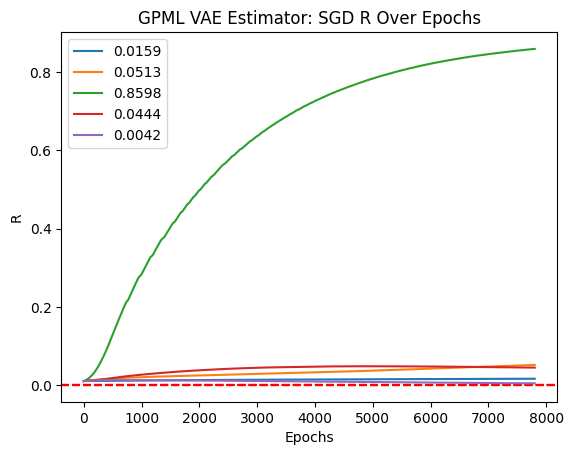

VAE Fit:  79%|███████▉  | 7900/10000 [1:34:06<23:55,  1.46it/s]

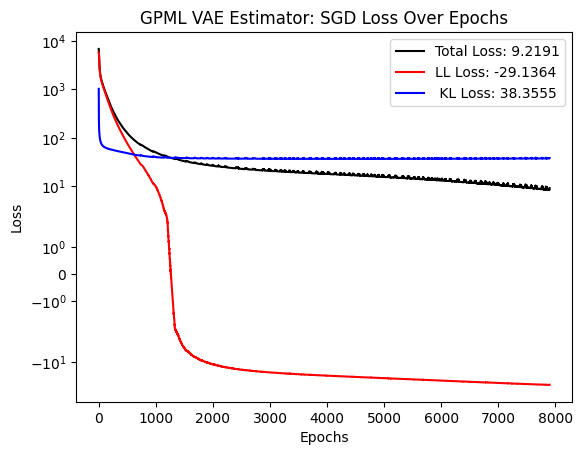

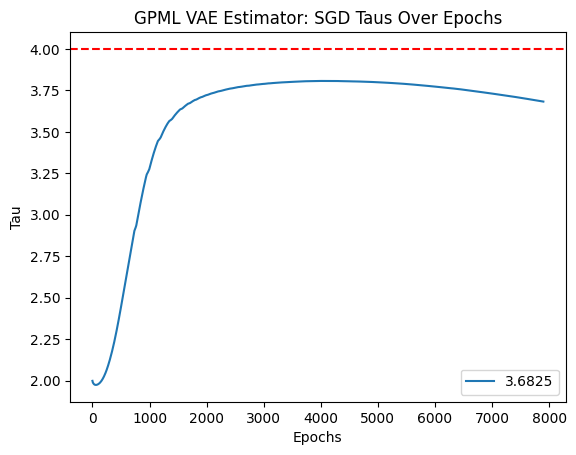

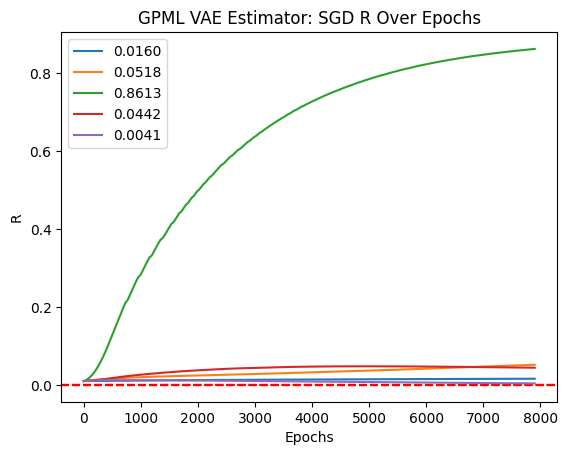

VAE Fit:  80%|████████  | 8000/10000 [1:35:17<23:52,  1.40it/s]

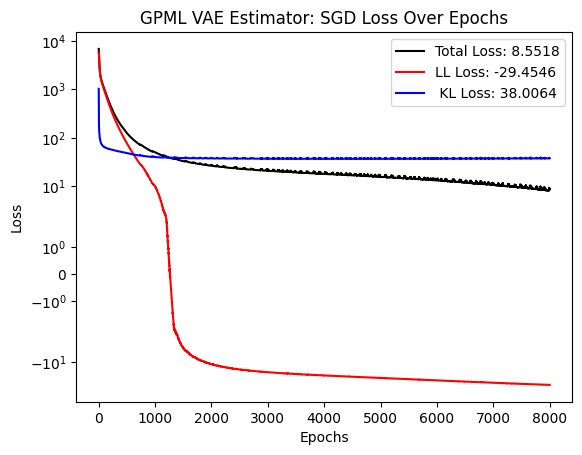

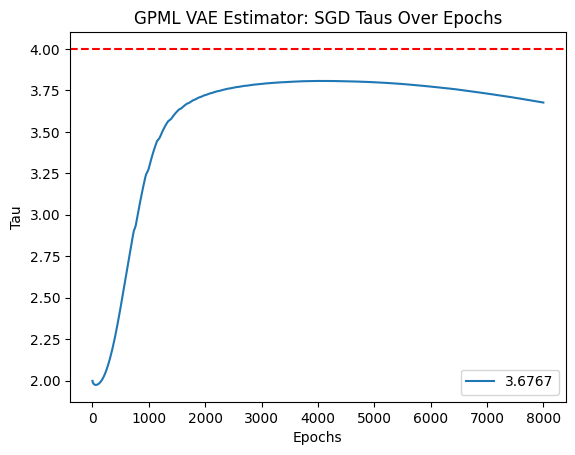

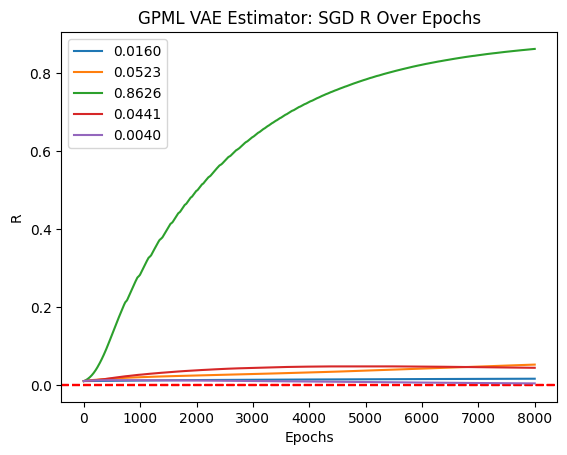

VAE Fit:  81%|████████  | 8100/10000 [1:36:30<23:38,  1.34it/s]

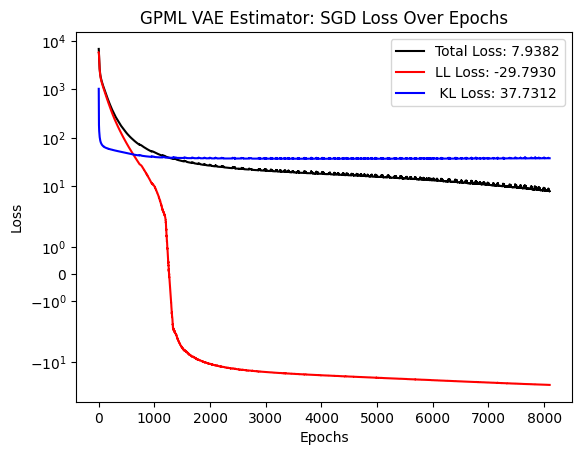

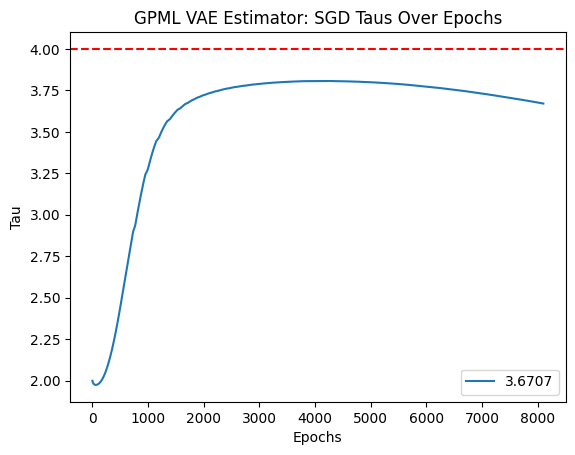

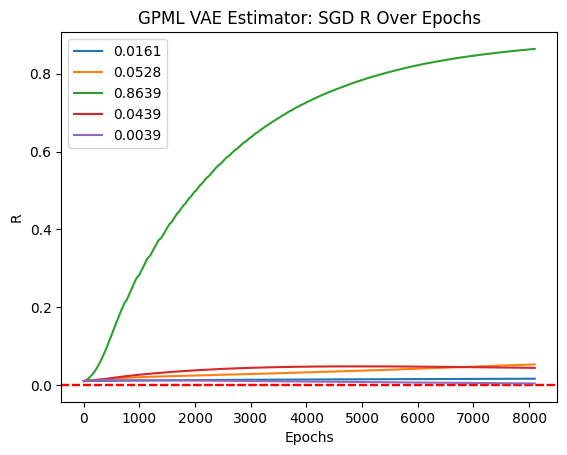

VAE Fit:  82%|████████▏ | 8200/10000 [1:37:42<24:40,  1.22it/s]

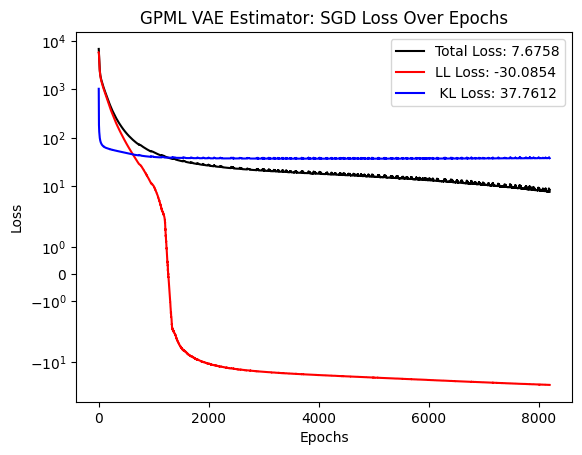

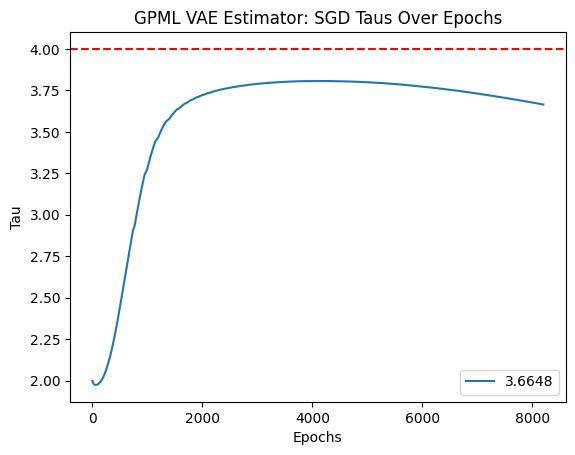

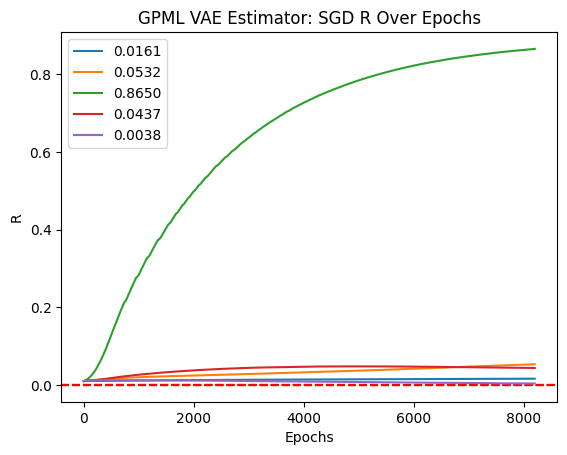

VAE Fit:  83%|████████▎ | 8300/10000 [1:38:54<22:33,  1.26it/s]

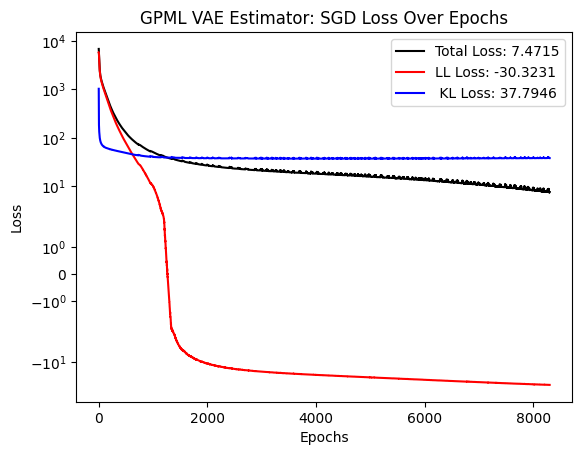

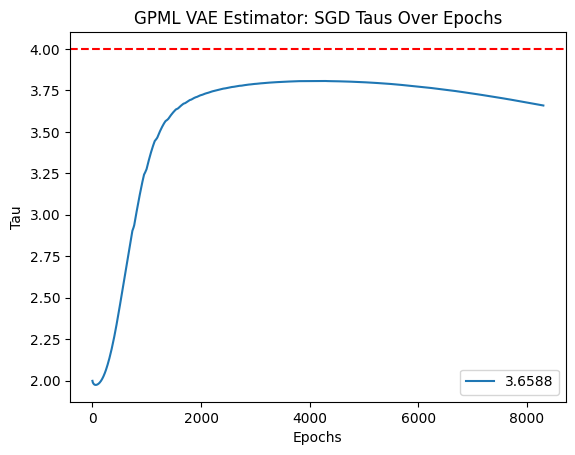

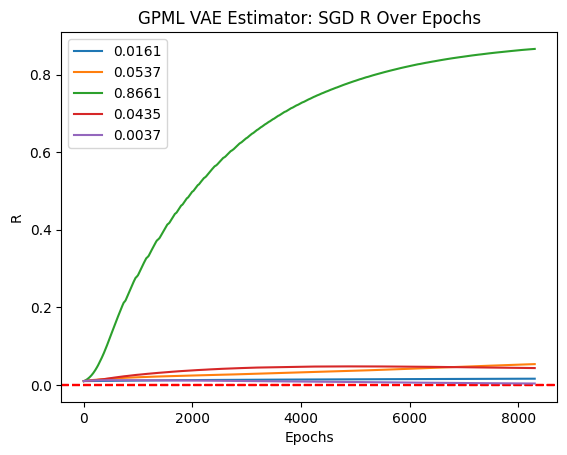

VAE Fit:  84%|████████▍ | 8400/10000 [1:40:06<20:45,  1.28it/s]

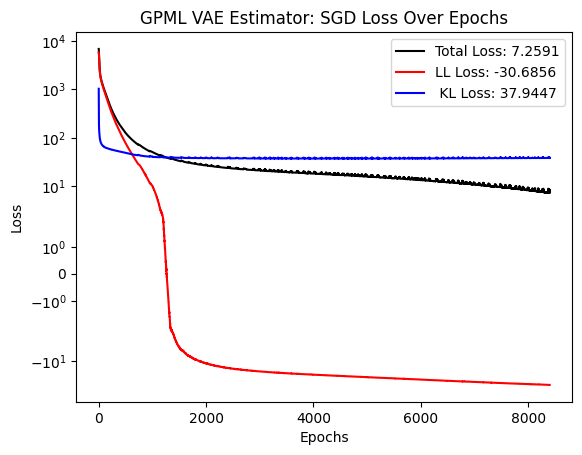

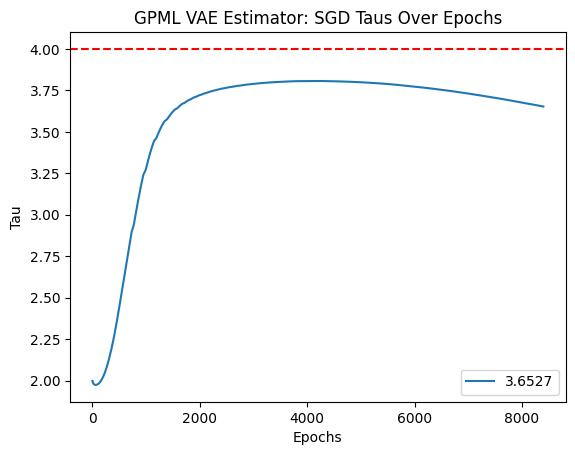

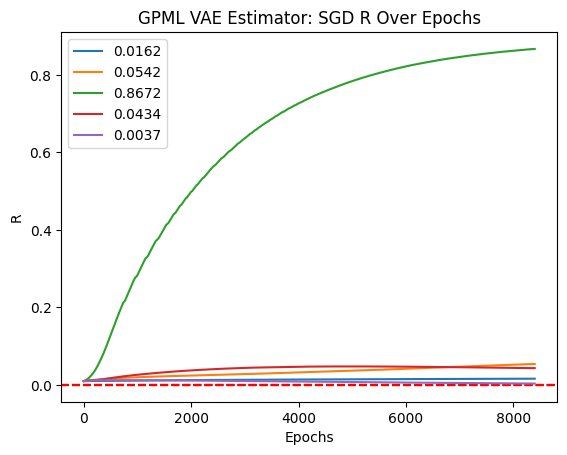

VAE Fit:  85%|████████▌ | 8500/10000 [1:41:20<18:54,  1.32it/s]

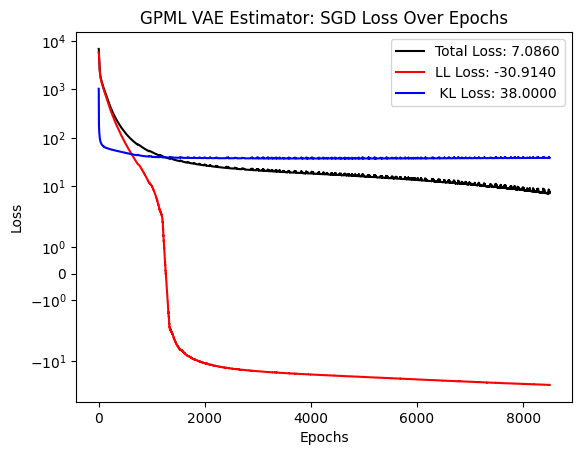

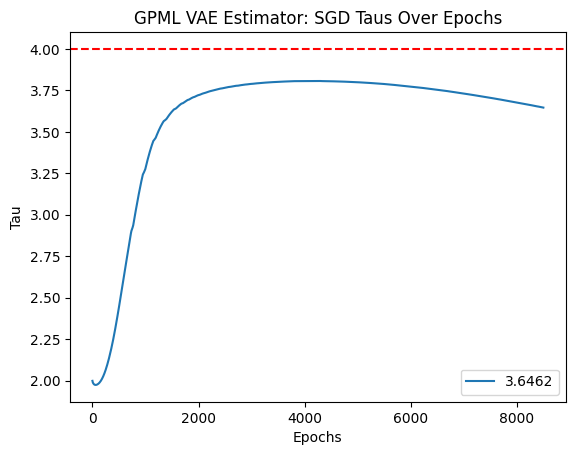

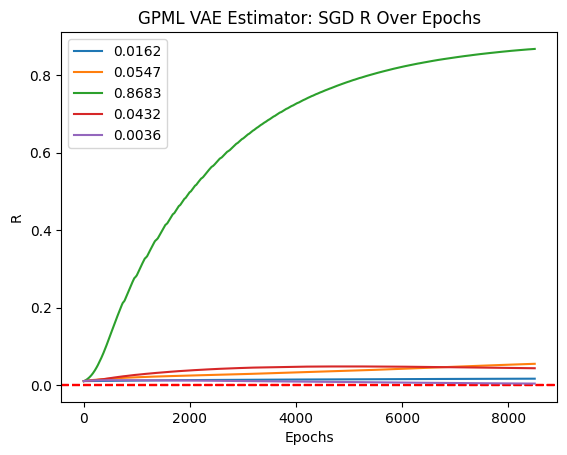

VAE Fit:  86%|████████▌ | 8600/10000 [1:42:32<16:09,  1.44it/s]

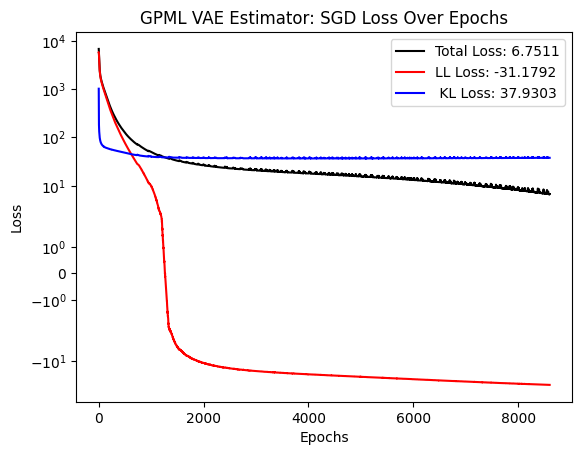

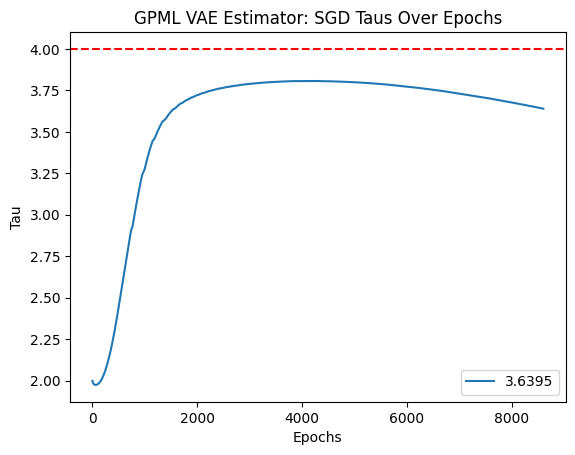

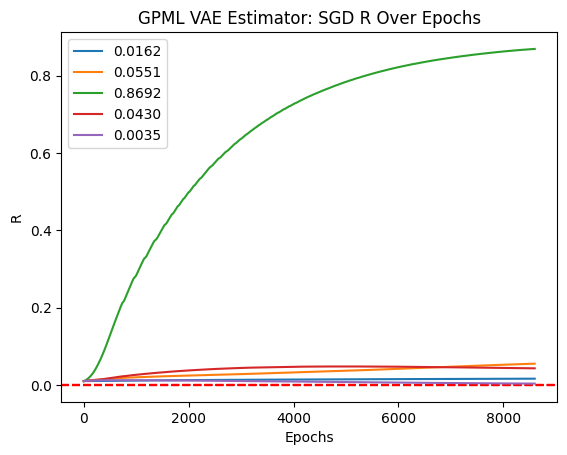

VAE Fit:  87%|████████▋ | 8700/10000 [1:43:44<14:51,  1.46it/s]

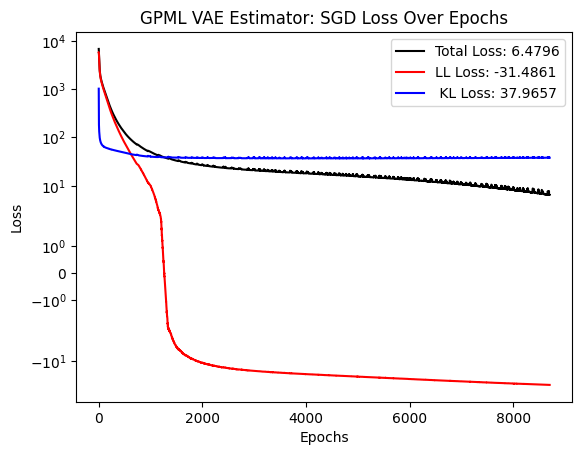

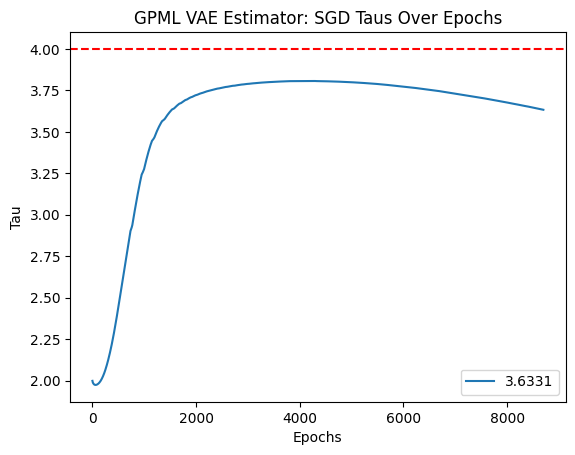

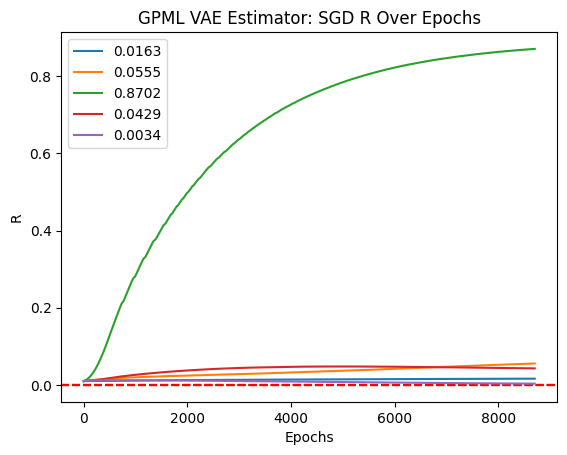

VAE Fit:  88%|████████▊ | 8800/10000 [1:44:58<13:38,  1.47it/s]

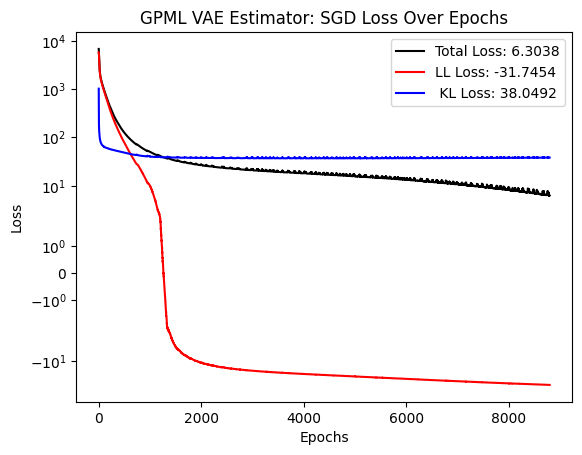

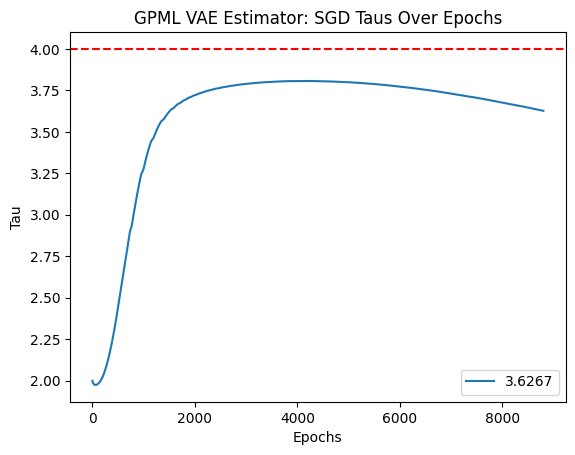

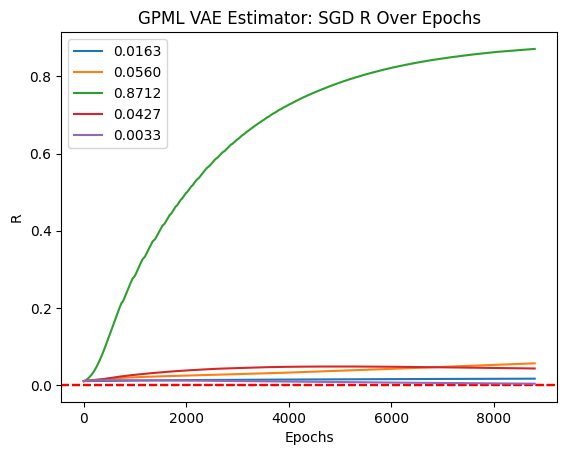

VAE Fit:  89%|████████▉ | 8900/10000 [1:46:10<12:27,  1.47it/s]

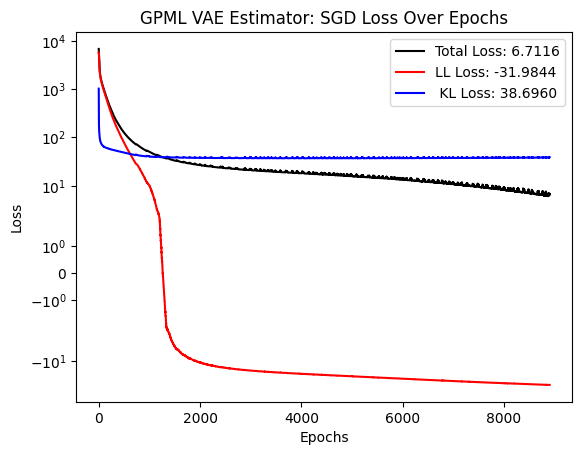

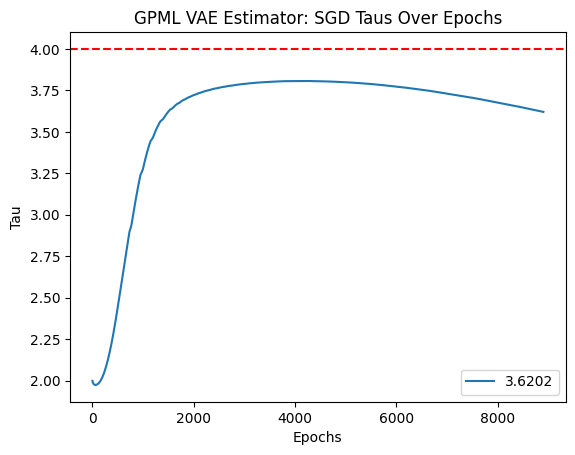

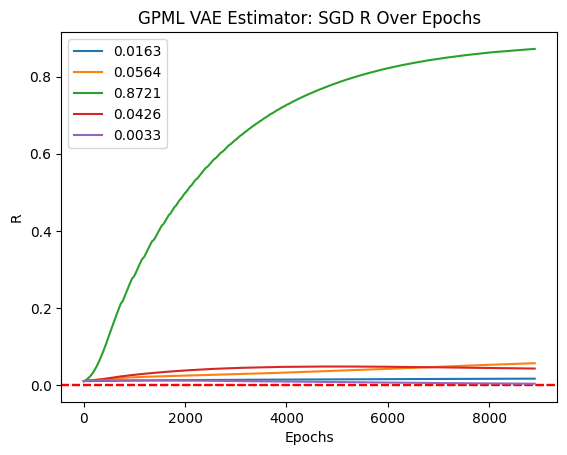

VAE Fit:  90%|█████████ | 9000/10000 [1:47:23<11:14,  1.48it/s]

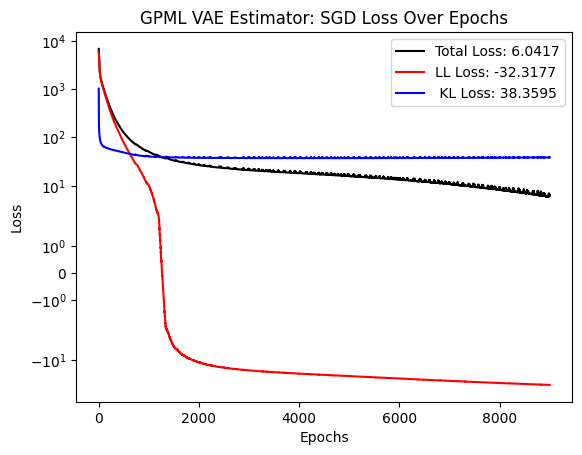

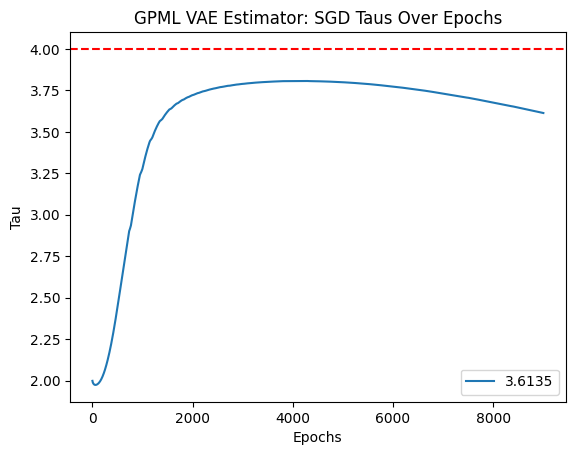

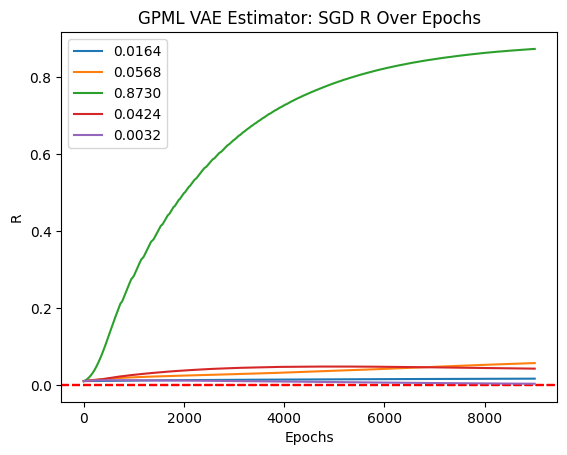

VAE Fit:  91%|█████████ | 9100/10000 [1:48:36<10:02,  1.49it/s]

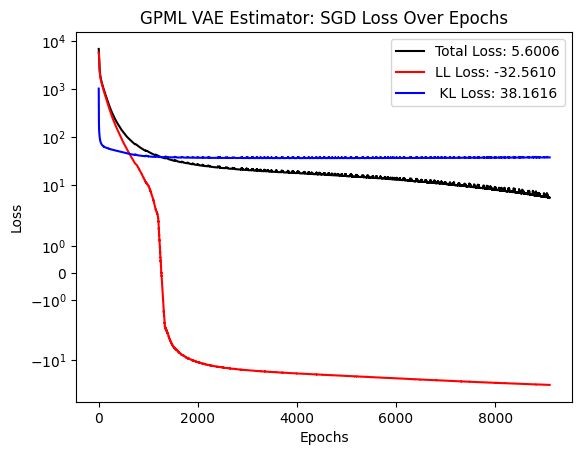

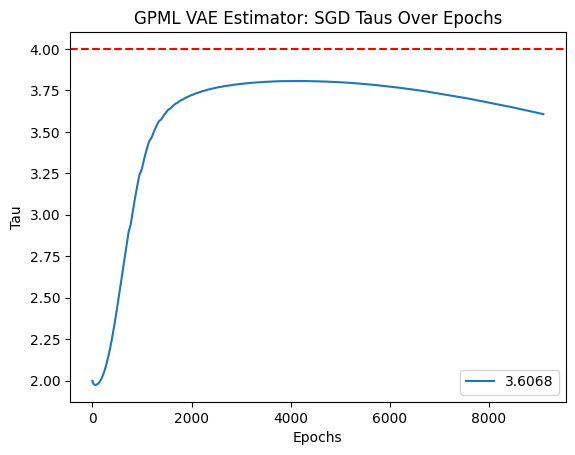

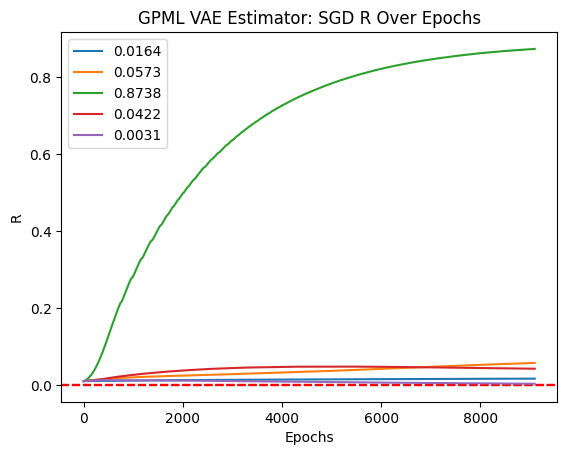

VAE Fit:  92%|█████████▏| 9200/10000 [1:49:49<08:59,  1.48it/s]

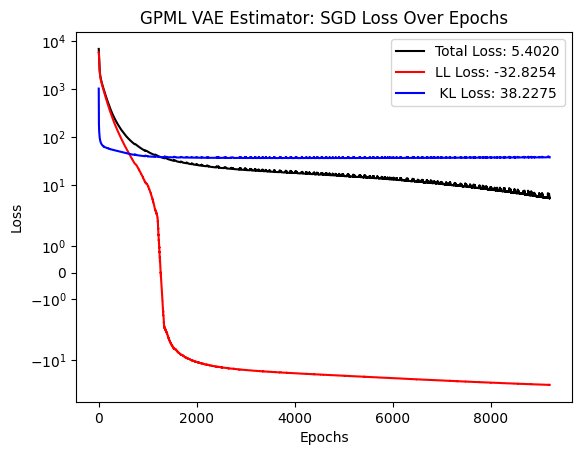

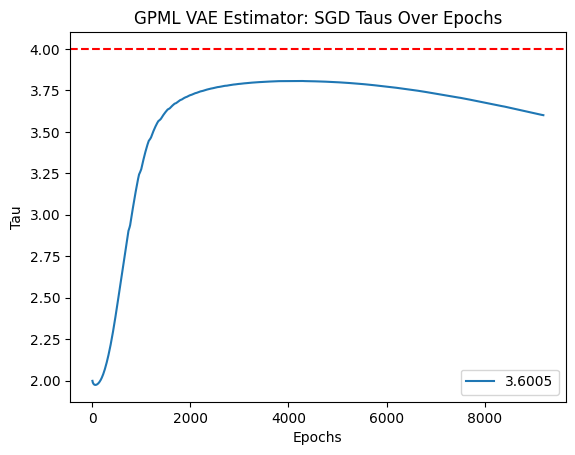

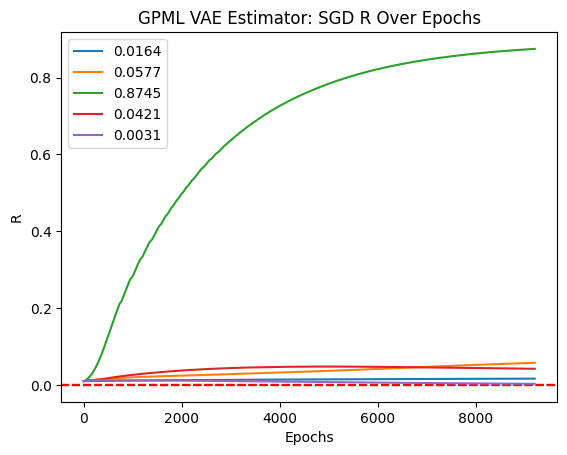

VAE Fit:  93%|█████████▎| 9300/10000 [1:51:01<07:55,  1.47it/s]

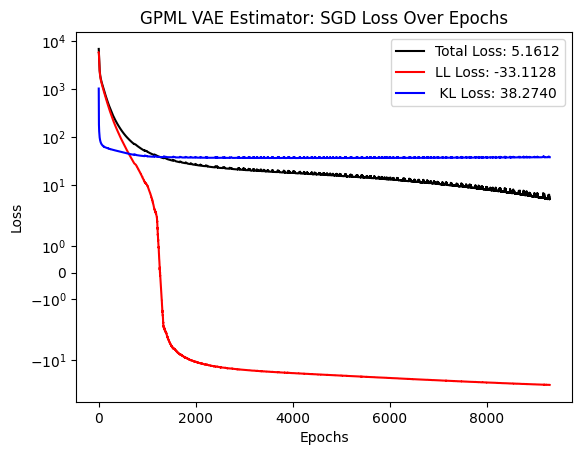

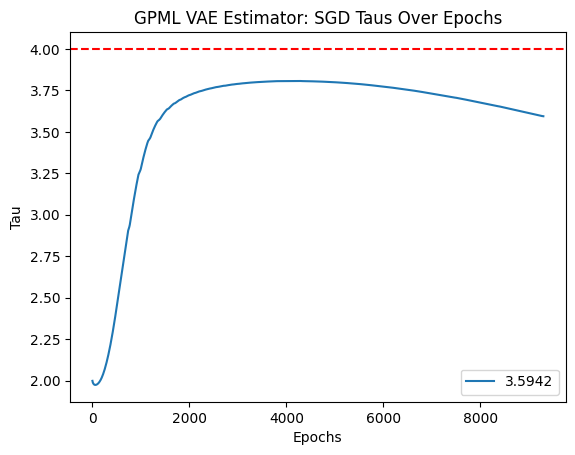

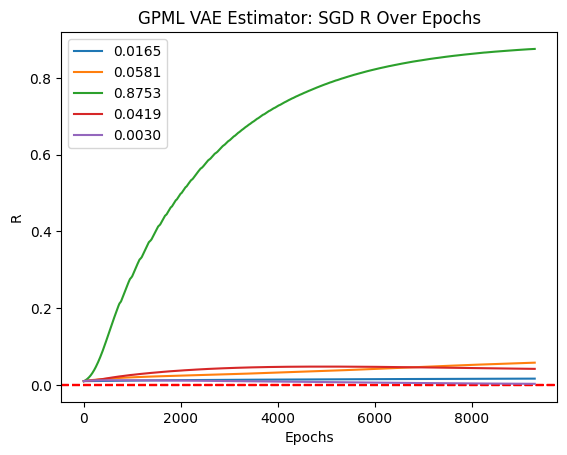

VAE Fit:  94%|█████████▍| 9400/10000 [1:52:14<06:53,  1.45it/s]

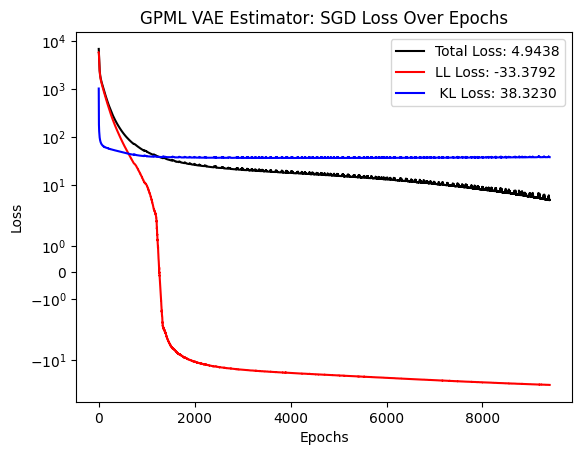

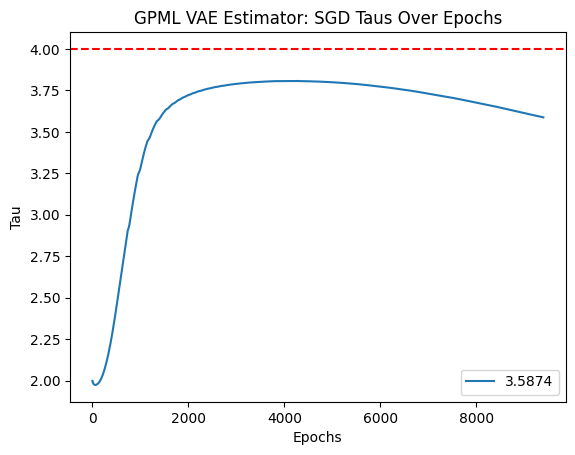

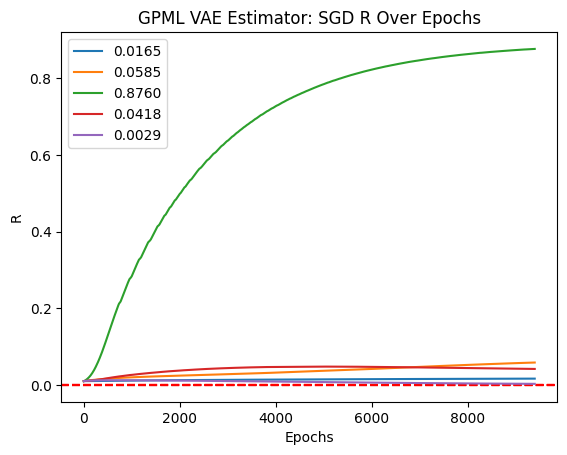

VAE Fit:  95%|█████████▌| 9500/10000 [1:53:28<05:50,  1.43it/s]

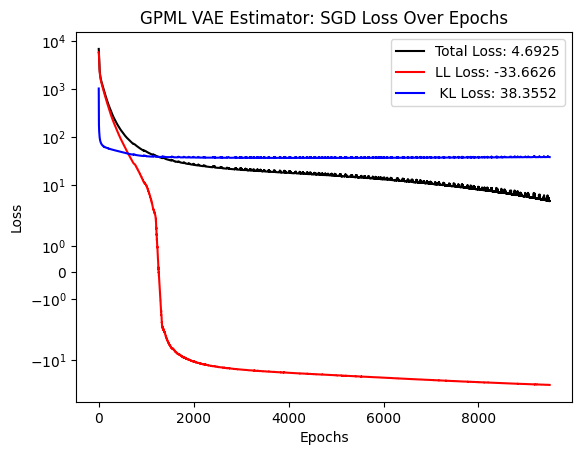

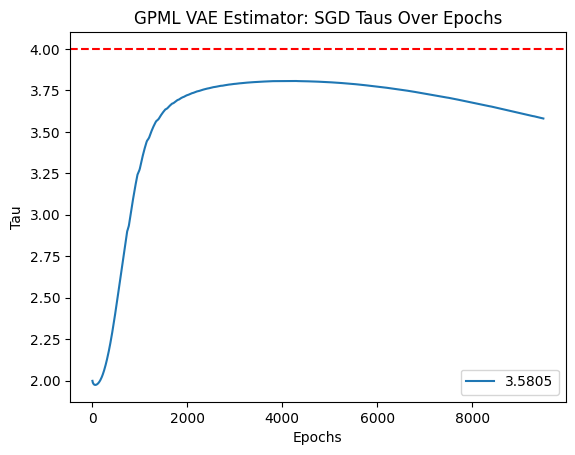

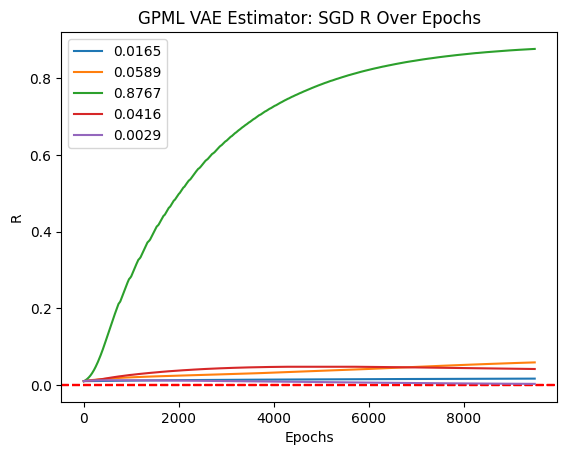

VAE Fit:  96%|█████████▌| 9600/10000 [1:54:48<05:48,  1.15it/s]

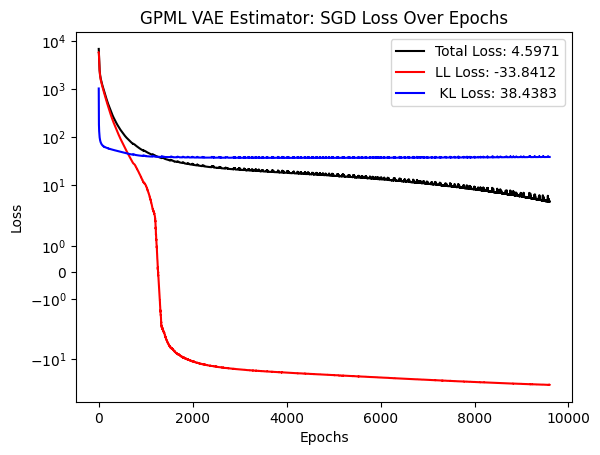

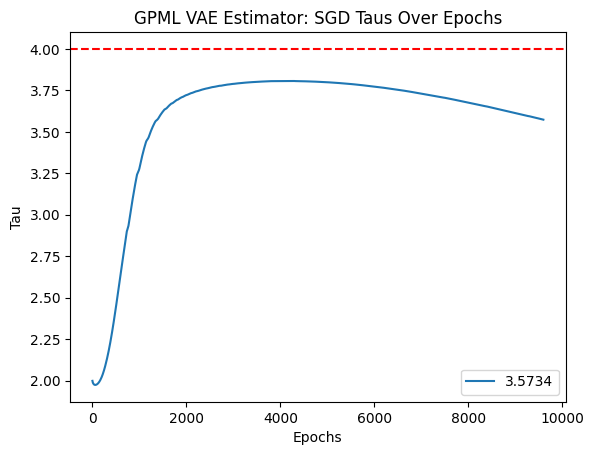

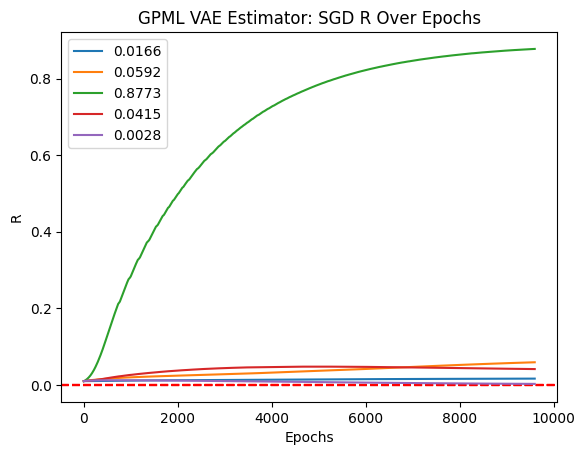

VAE Fit:  97%|█████████▋| 9700/10000 [1:56:10<03:58,  1.26it/s]

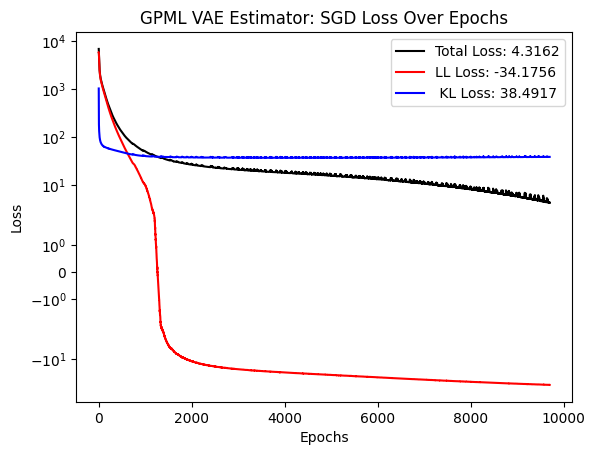

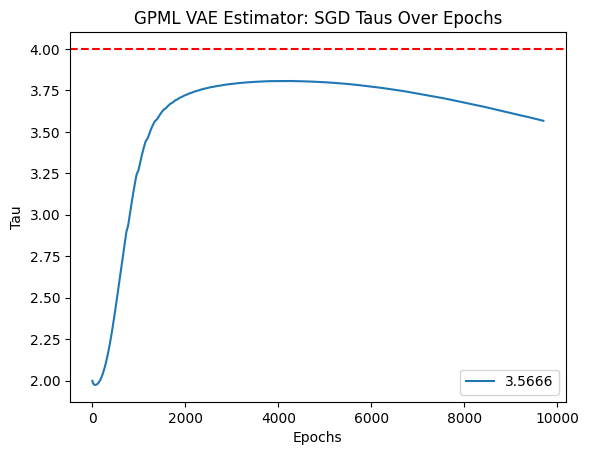

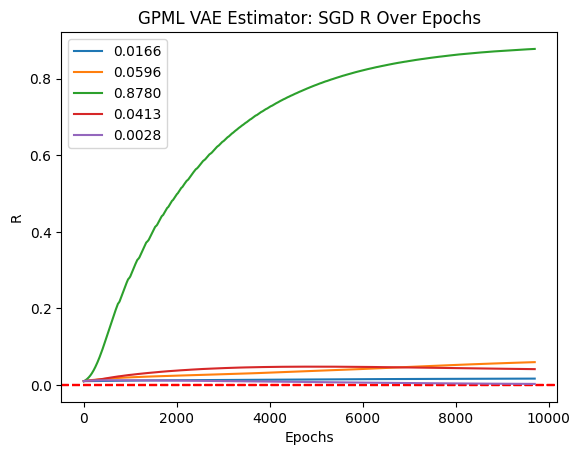

VAE Fit:  98%|█████████▊| 9800/10000 [1:57:33<02:46,  1.20it/s]

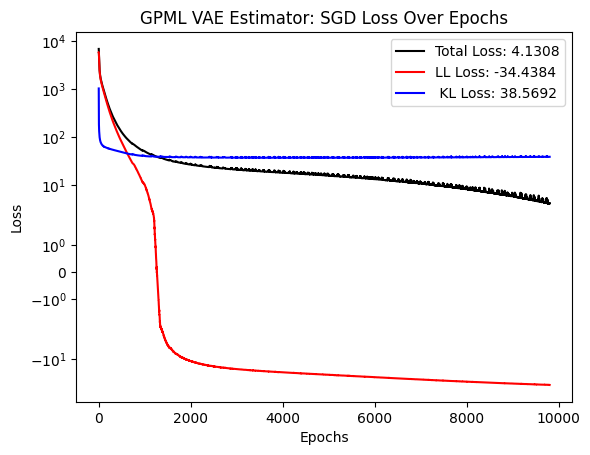

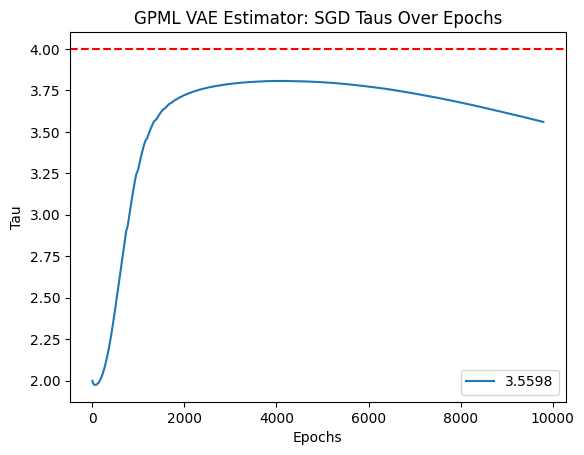

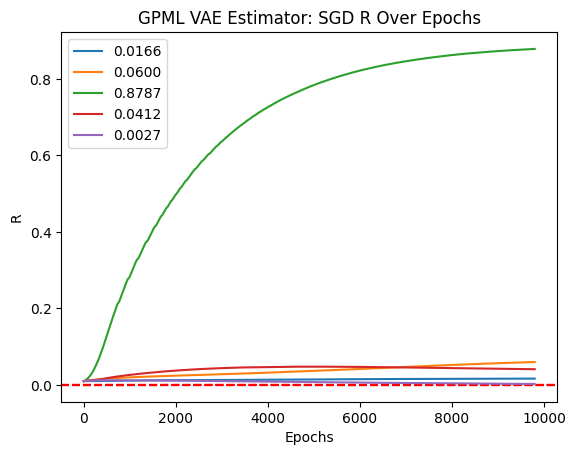

VAE Fit:  99%|█████████▉| 9900/10000 [1:58:53<01:13,  1.37it/s]

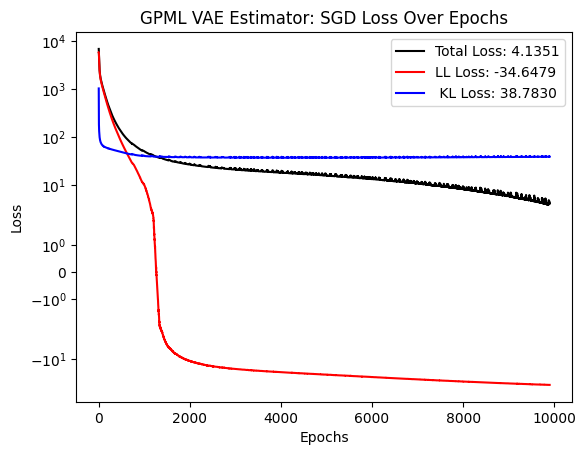

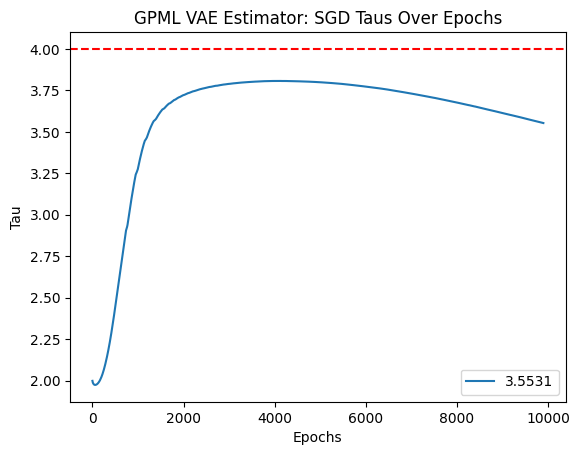

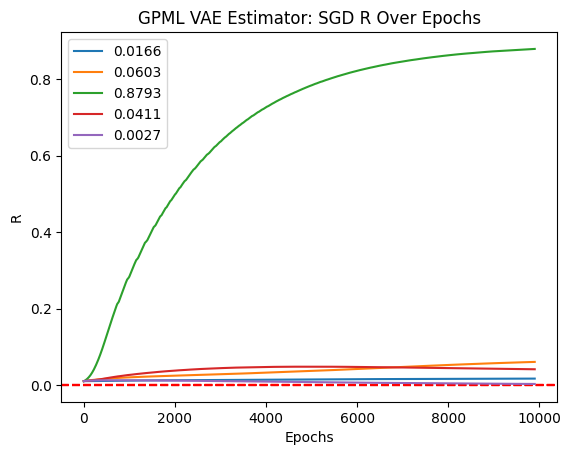

VAE Fit: 100%|██████████| 10000/10000 [2:00:09<00:00,  1.39it/s]


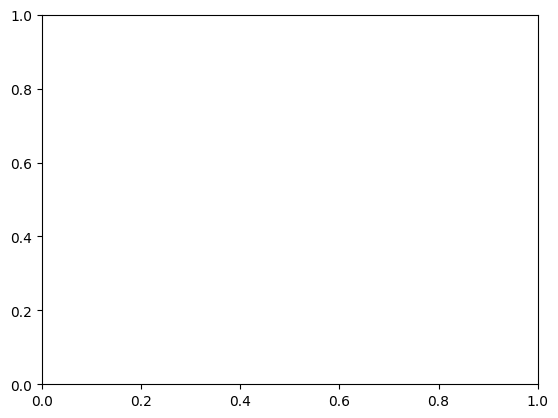

In [ ]:
def tester_parabola_linear():
    device = "cuda"
    latent_dims = 1
    observation_dims = 5
    true_taus = [4.0]
    true_R_diag = 0.0001
    hetero_r = True
    if hetero_r:
        true_R_diag = [true_R_diag]*observation_dims
    signal_sds = 0.99
    noise_sds = 1 - signal_sds

    with torch.no_grad():
        forward_model = HighDParabolaDecoder(latent_dims,observation_dims,device=device,alpha=1.0)
        parabola_dataset = dataset_constructor(forward_model,latent_dims, observation_dims,taus = true_taus,R_diag=true_R_diag,
                                               samples=1000,time_divisions=30,time_end=20.0,signal_sds=signal_sds,
                                               noise_sds=noise_sds,device=device)
    #plots latent
    plot_dataset(parabola_dataset,0)
    #test_encoder = TestEncoder(latent_dims,parabola_dataset["times"],parabola_dataset["model"])
    #linear encoder as is works
    #LinearEncoder(1,2,len(linear_dataset["times"]))
    #encoder = FeedforwardEncoder([(2000,nn.LeakyReLU()),(2000,nn.LeakyReLU())],
    #                             latent_dims,observation_dims,len(parabola_dataset["times"]))#
    encoder = FeedforwardEncoder([(4000,nn.LeakyReLU()),(4000,nn.LeakyReLU())],
                                 latent_dims,observation_dims,len(parabola_dataset["times"]),device=device,rank=0)
    fit_decoder =  FeedforwardNNDecoder([(30, nn.LeakyReLU())],latent_dims=latent_dims,observed_dims=observation_dims,device=device)
    #FeedforwardNNDecoder([(30, nn.LeakyReLU()),(30, nn.LeakyReLU())],latent_dims=latent_dims,observed_dims=observation_dims)
    #ConvexFeedforward([30],[30],latent_dims,observation_dims)
    #if didnt work, try with correct decoder
    #try fixing R and decoder, see if taus go correct
    vae = GPML_VAE(device,latent_dims,observation_dims,parabola_dataset["times"],encoder,forward_model,
                   train_decoder=False,initial_R_diag=[0.01]*observation_dims,train_R_diag=True,train_taus=True,initial_taus=[2.0]*latent_dims,
                   train_encoder=True,signal_sds=[signal_sds]*latent_dims,noise_sds=[noise_sds]*latent_dims)
    c_vae = torch.compile(vae)
    epochs = 10000
    c_vae.fit(parabola_dataset["X"],None,lr=1e-6,epochs=epochs,batch_size=100,approx_elbo_loss_samples=1,grad_clip=1000.0,
            hyper_scheduler=None,mm=0.7,plotting_true_taus=true_taus,plotting_true_R_diag=true_R_diag,log_save_name="SGD")
tester_parabola_linear()

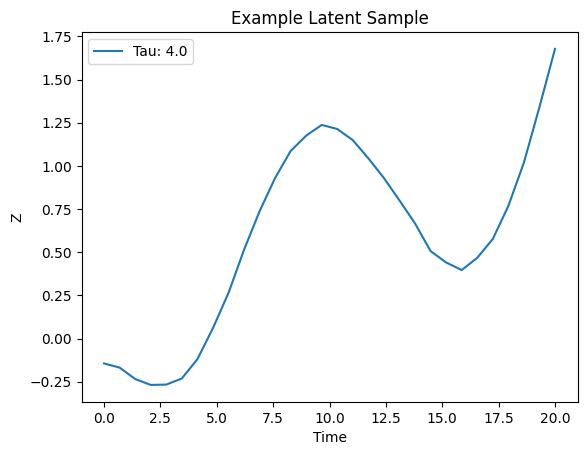

torch.Size([30, 5])


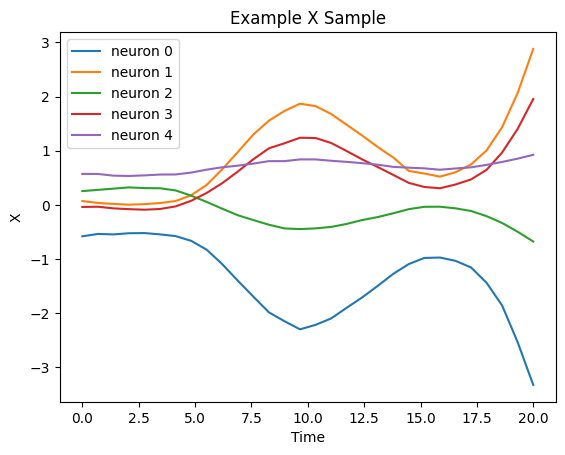

VAE Fit:   0%|          | 0/10000 [00:00<?, ?it/s]

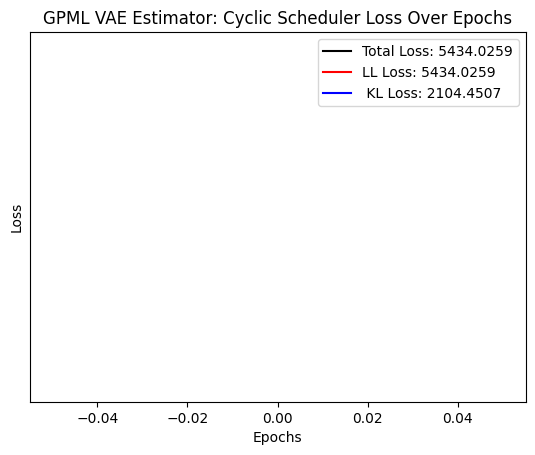

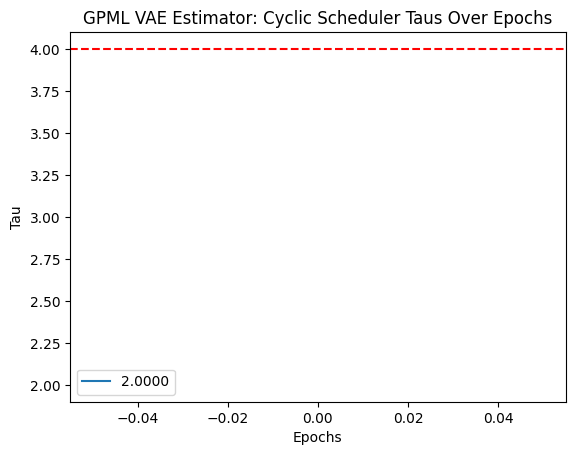

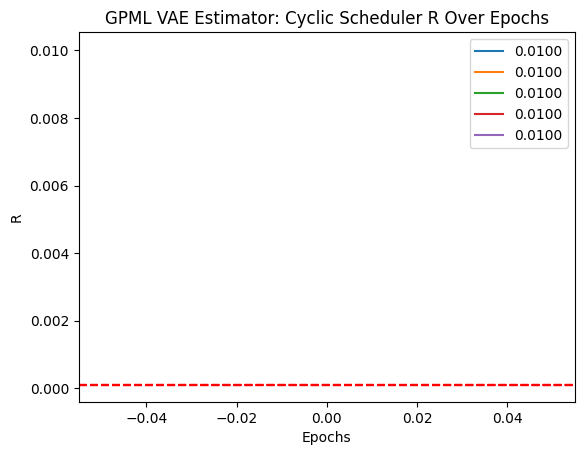

VAE Fit:   1%|          | 100/10000 [01:08<1:45:16,  1.57it/s]

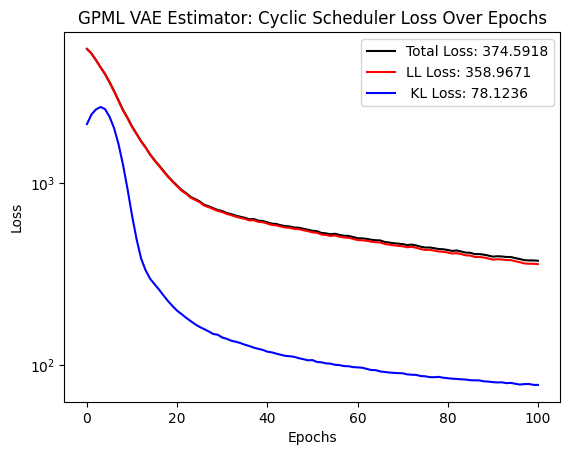

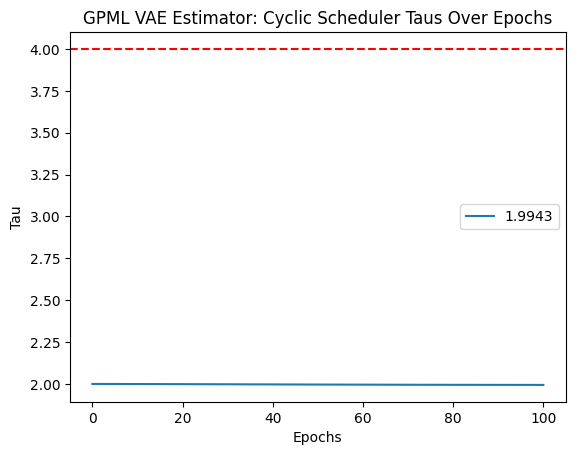

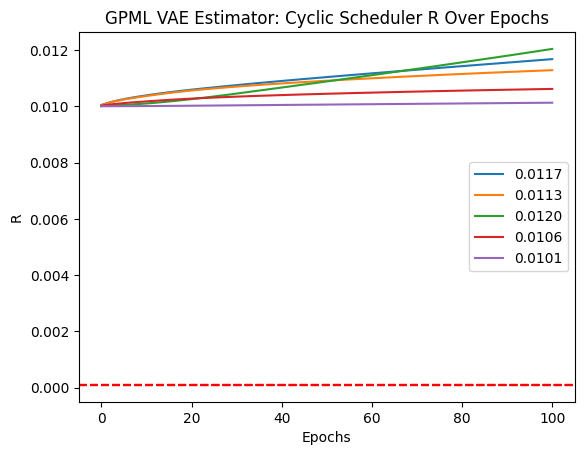

VAE Fit:   2%|▏         | 200/10000 [02:17<1:46:42,  1.53it/s]

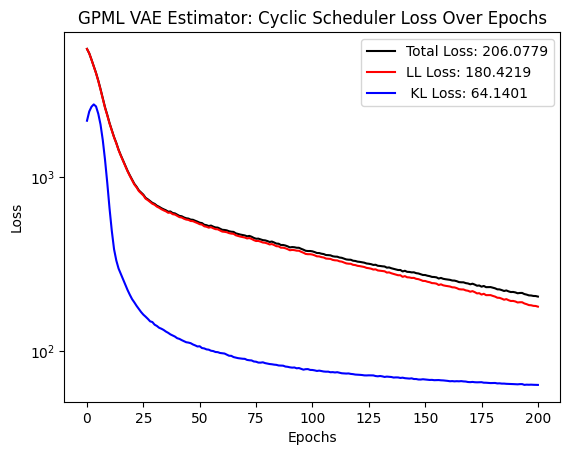

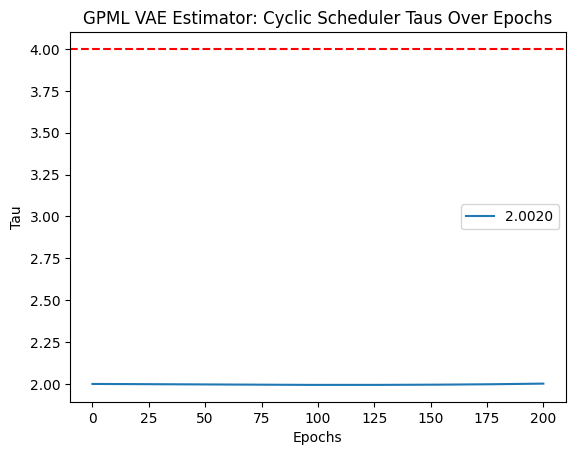

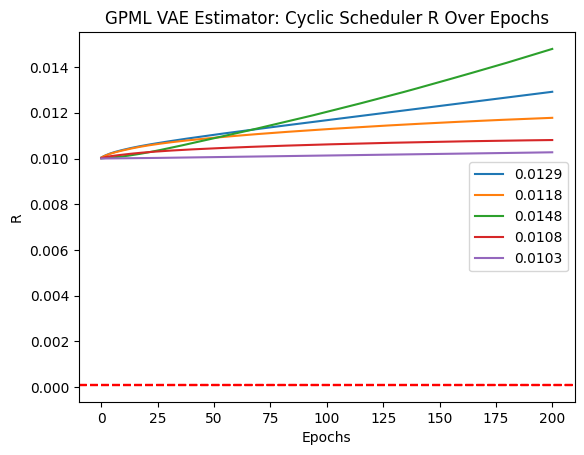

VAE Fit:   3%|▎         | 300/10000 [03:25<2:00:24,  1.34it/s]

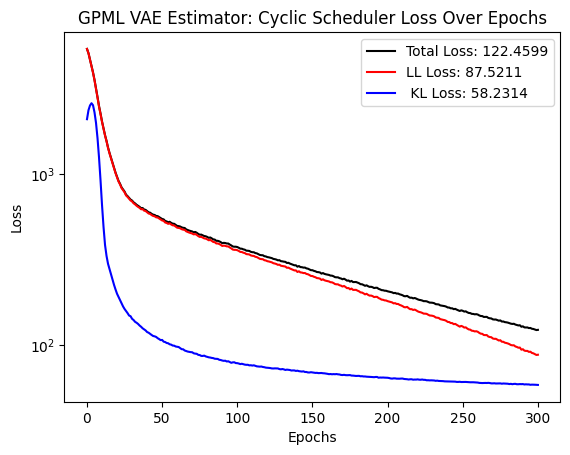

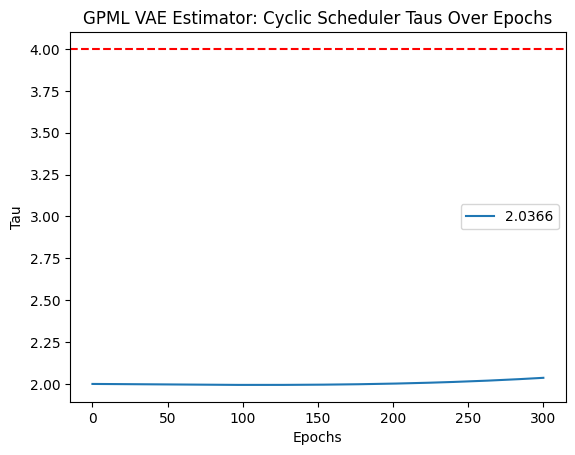

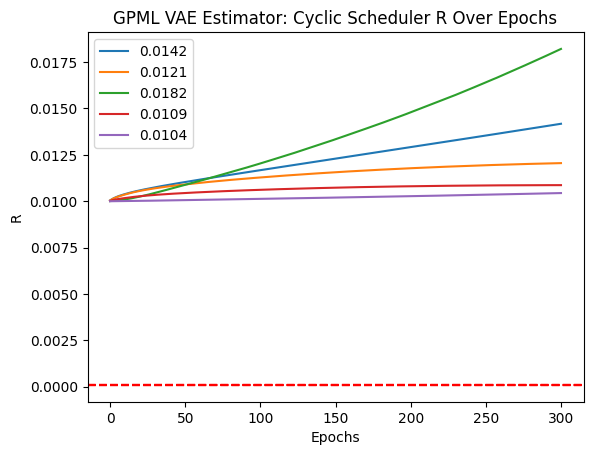

VAE Fit:   4%|▍         | 400/10000 [04:34<1:51:58,  1.43it/s]

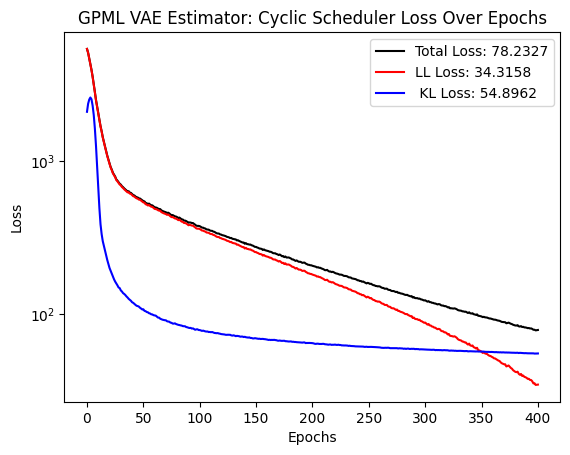

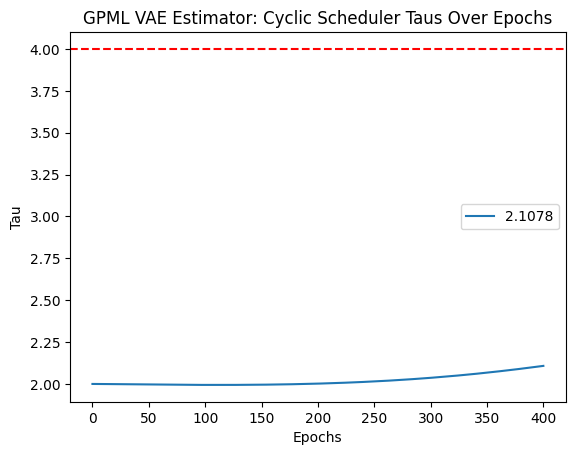

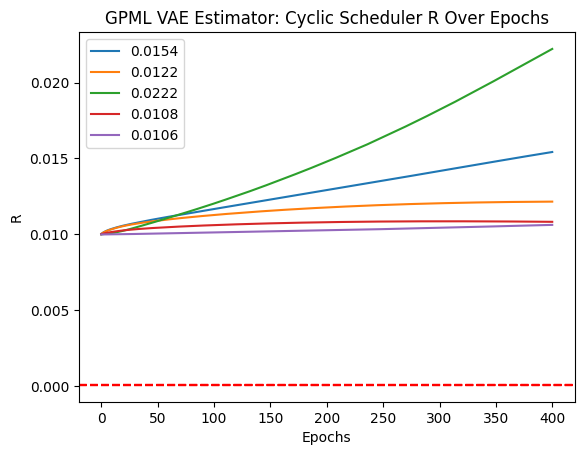

VAE Fit:   5%|▌         | 500/10000 [05:41<1:47:16,  1.48it/s]

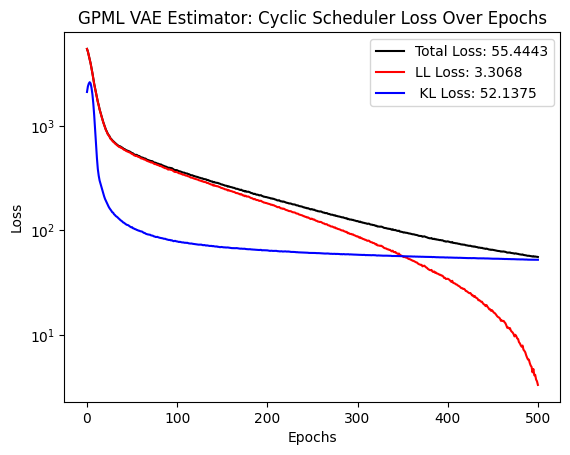

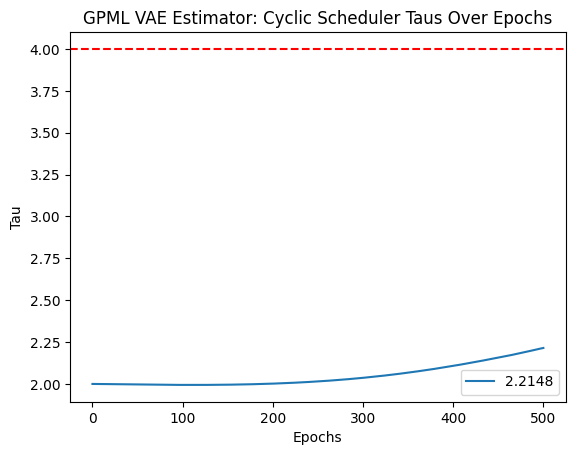

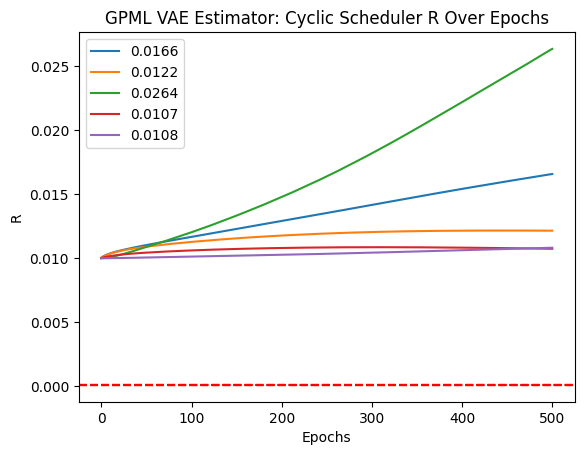

VAE Fit:   6%|▌         | 600/10000 [06:47<1:41:46,  1.54it/s]

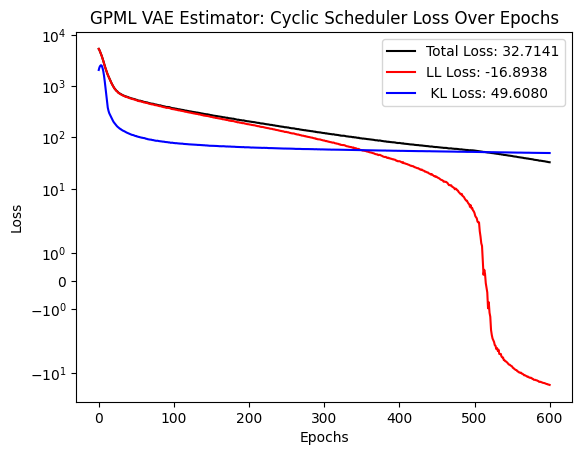

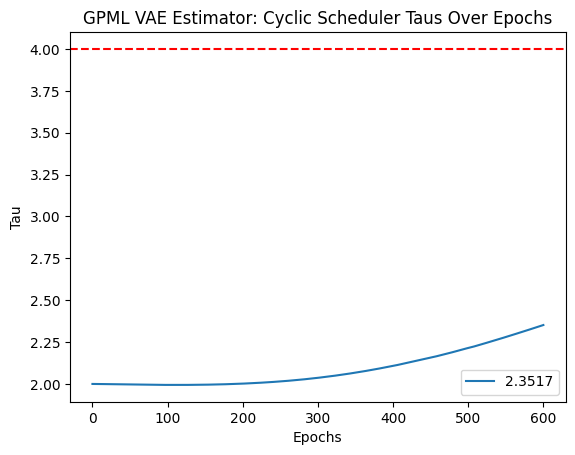

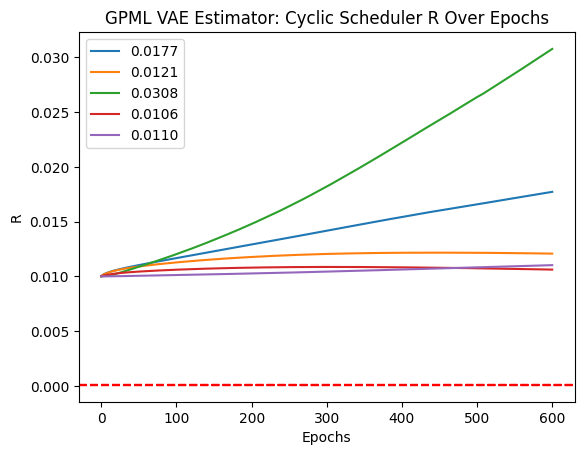

VAE Fit:   7%|▋         | 700/10000 [07:55<1:41:01,  1.53it/s]

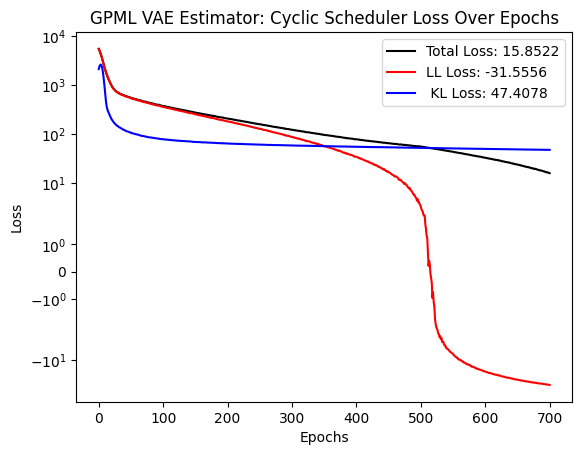

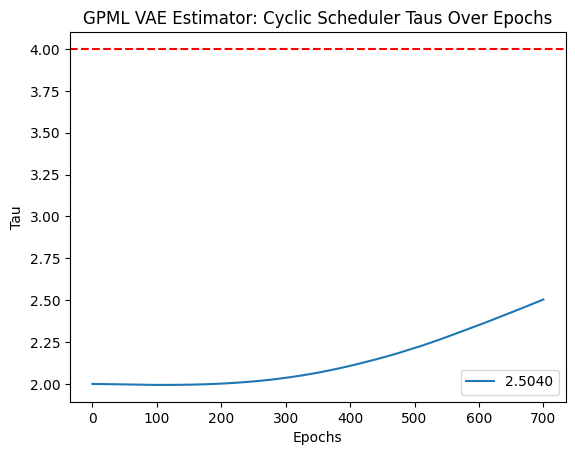

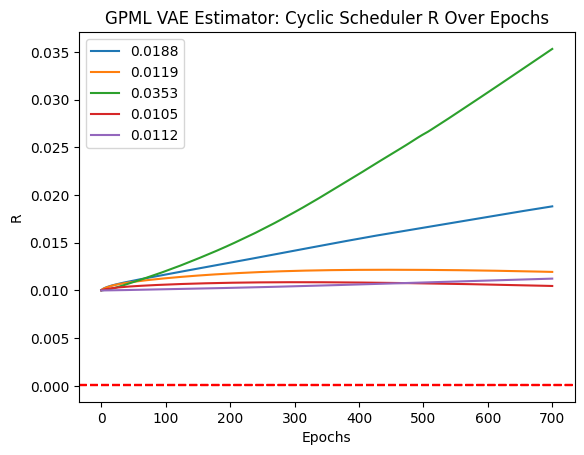

VAE Fit:   8%|▊         | 800/10000 [09:03<1:43:46,  1.48it/s]

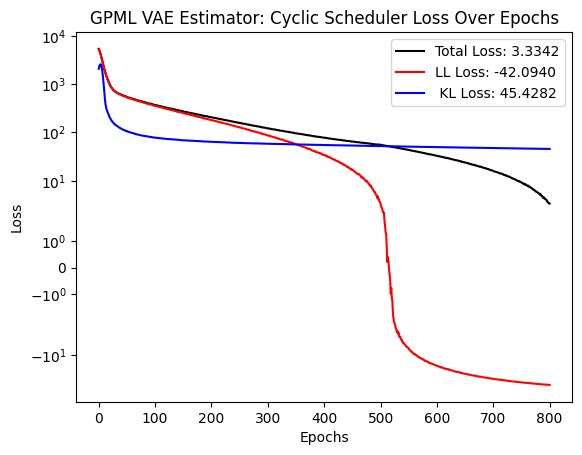

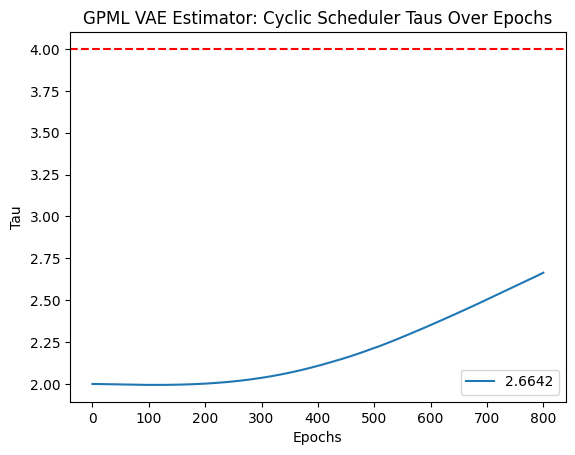

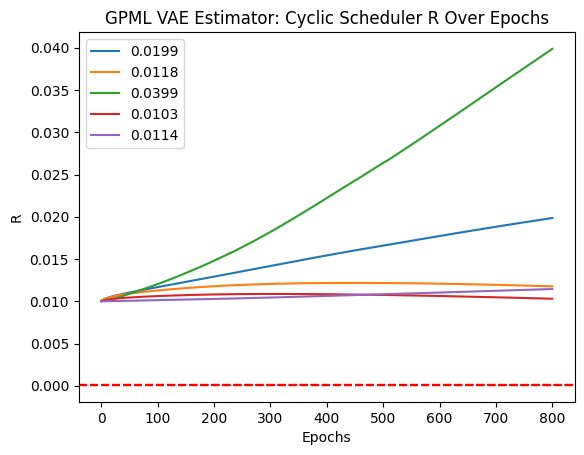

VAE Fit:   9%|▉         | 900/10000 [10:10<1:35:09,  1.59it/s]

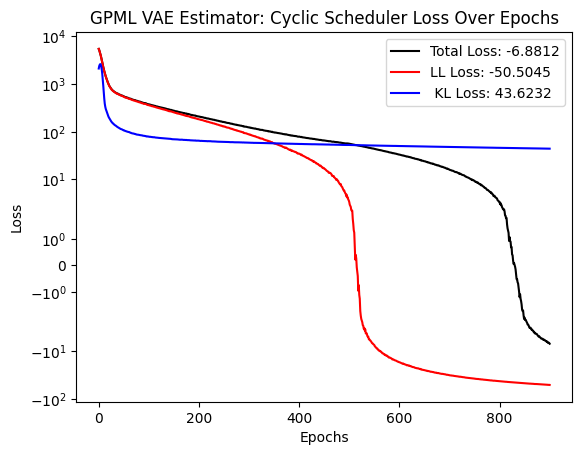

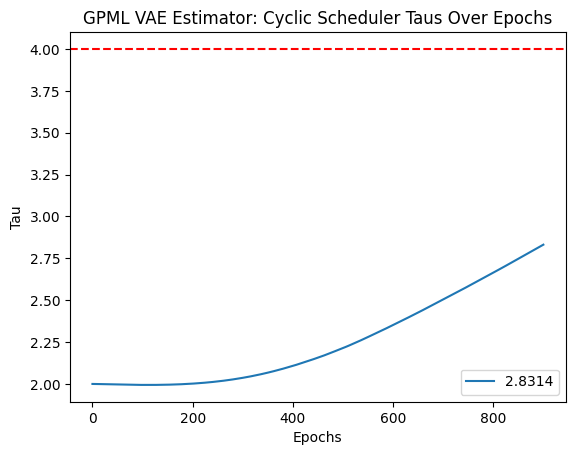

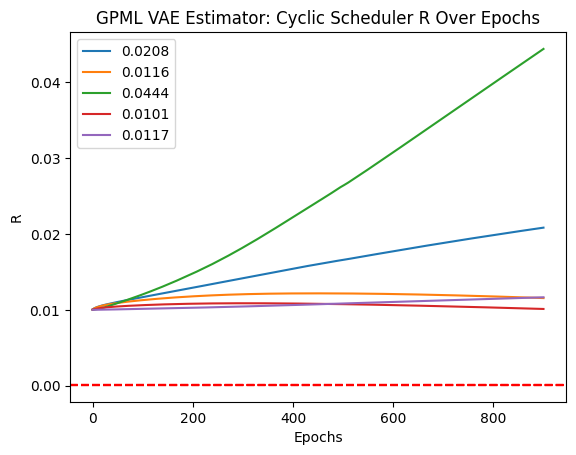

VAE Fit:  10%|█         | 1000/10000 [11:17<1:36:28,  1.55it/s]

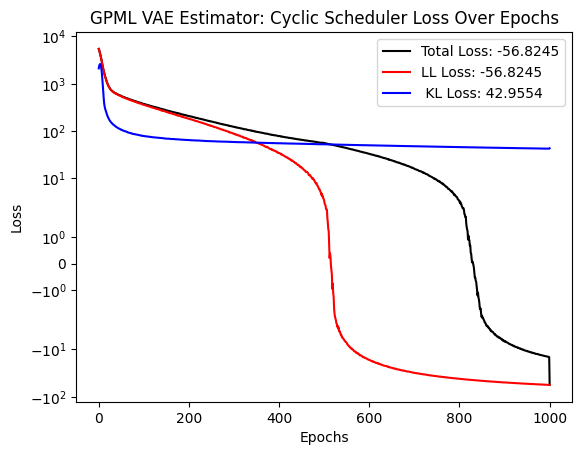

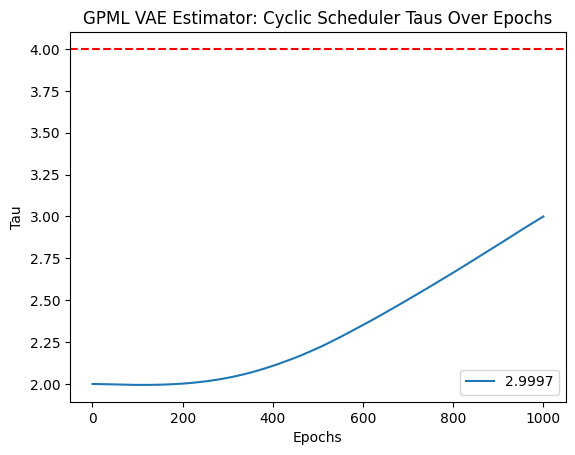

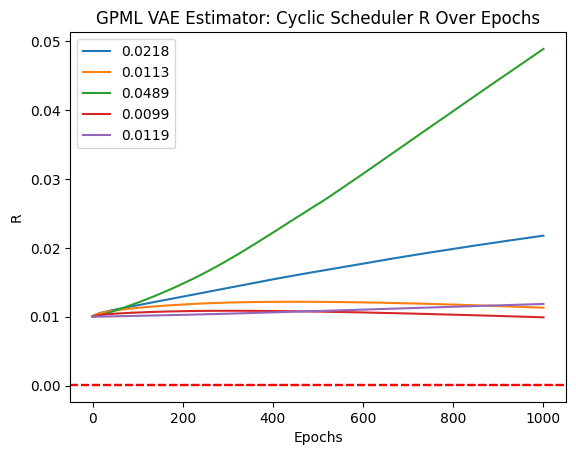

VAE Fit:  11%|█         | 1100/10000 [12:24<1:45:53,  1.40it/s]

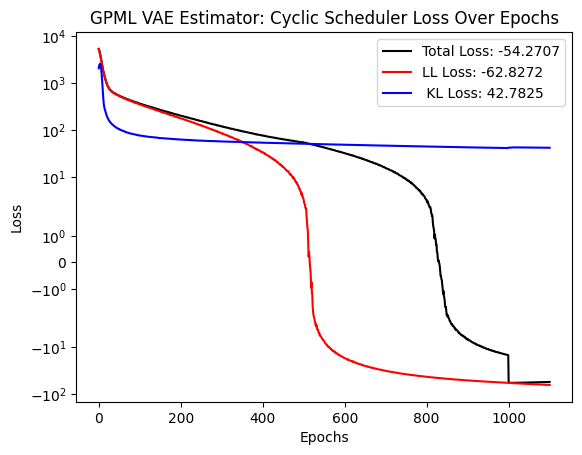

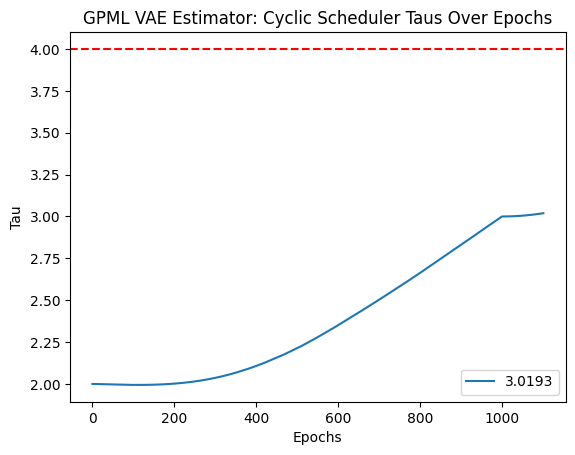

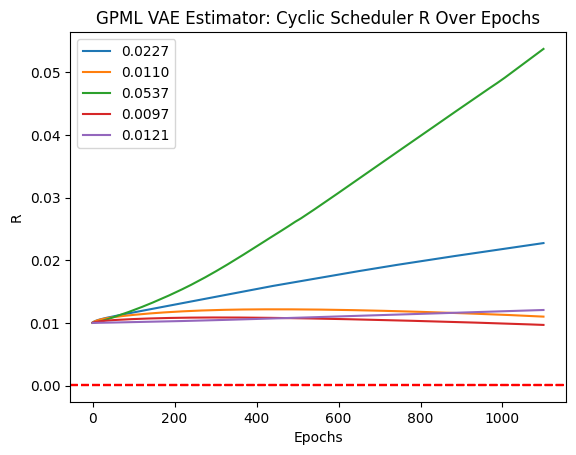

VAE Fit:  12%|█▏        | 1200/10000 [13:32<1:31:25,  1.60it/s]

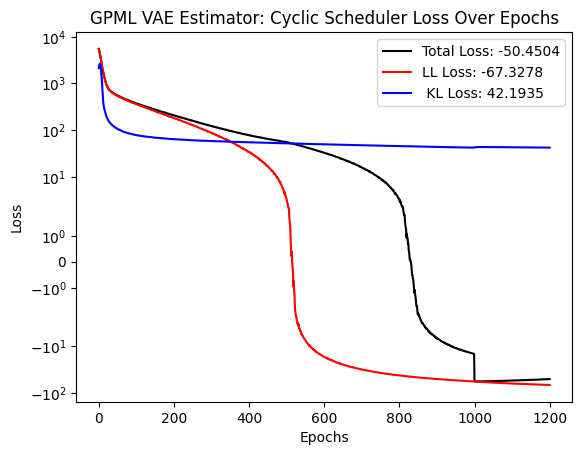

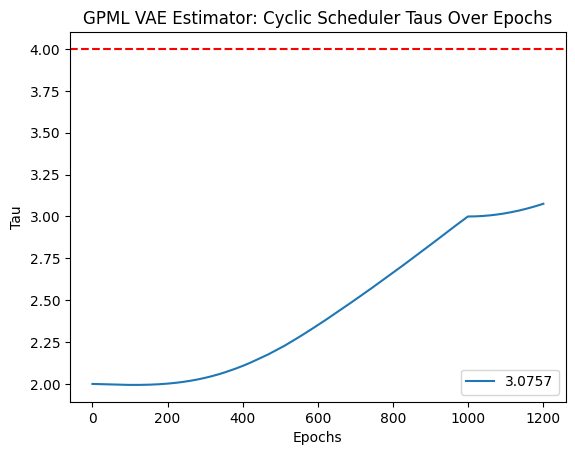

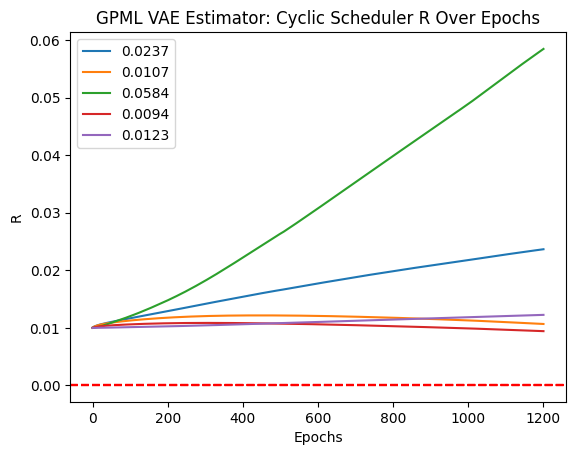

VAE Fit:  13%|█▎        | 1300/10000 [14:40<1:35:23,  1.52it/s]

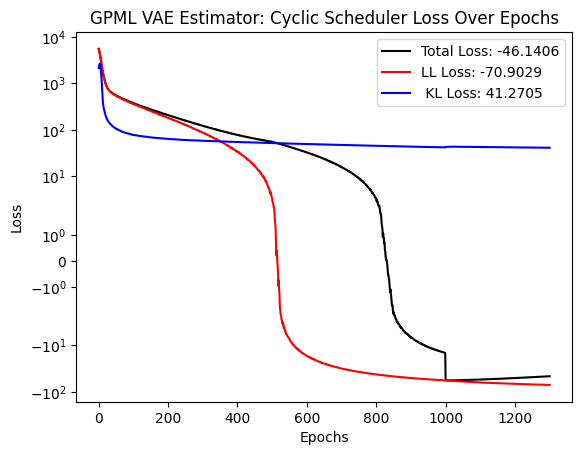

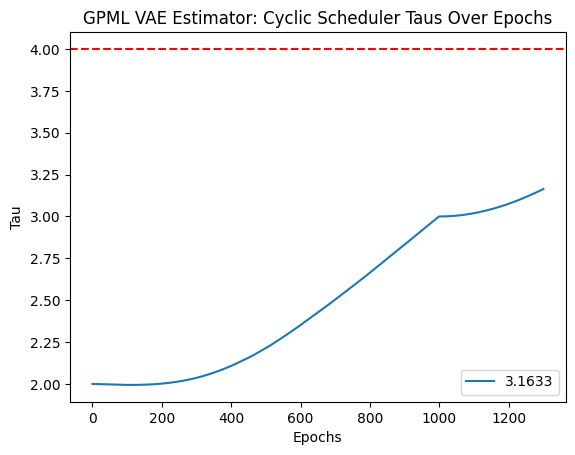

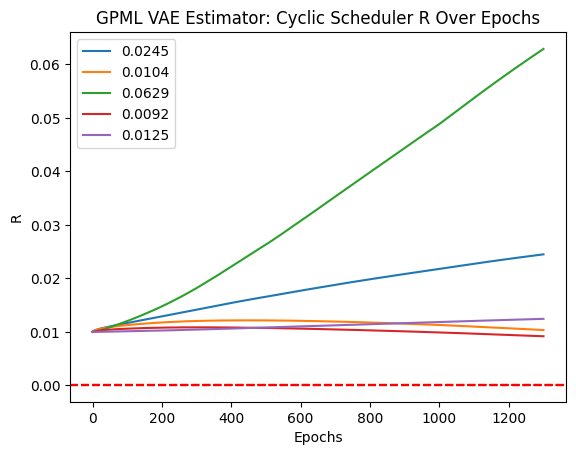

VAE Fit:  14%|█▍        | 1400/10000 [15:48<1:42:25,  1.40it/s]

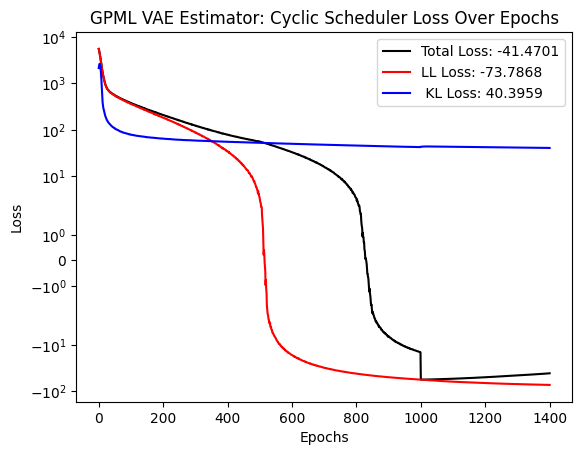

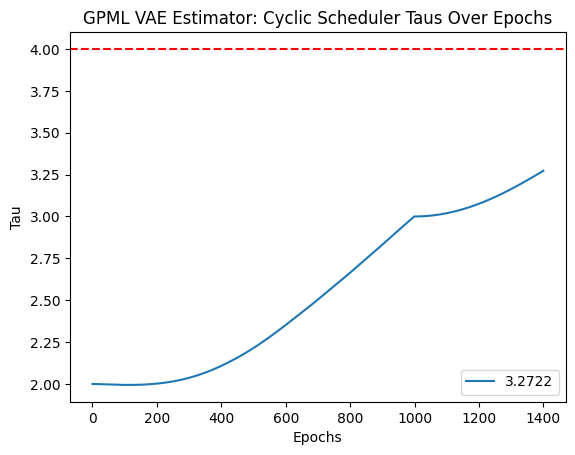

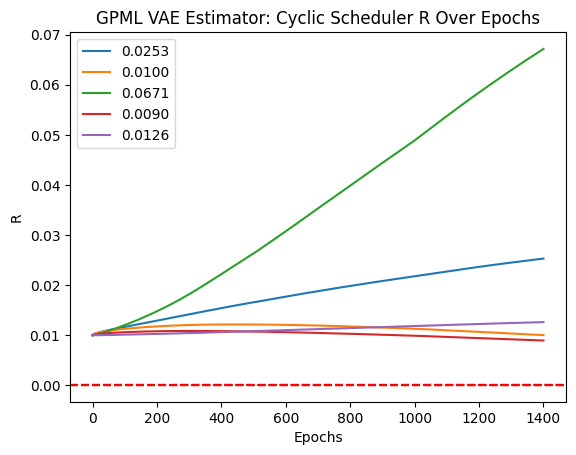

VAE Fit:  15%|█▌        | 1500/10000 [16:57<1:30:21,  1.57it/s]

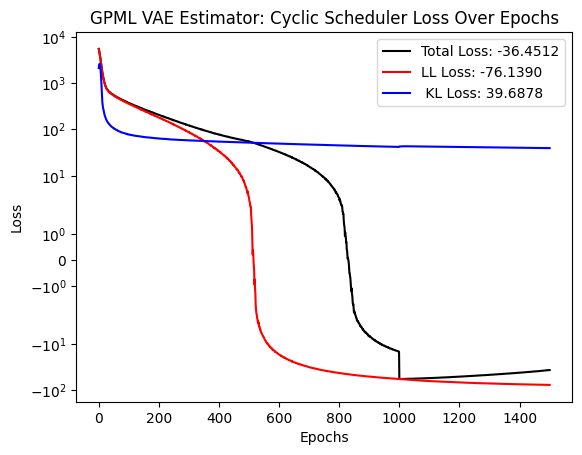

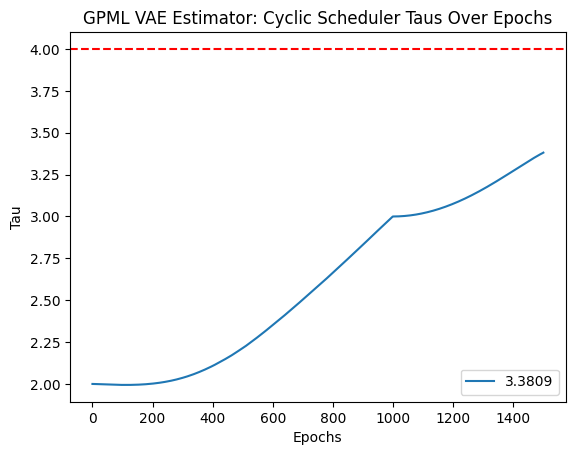

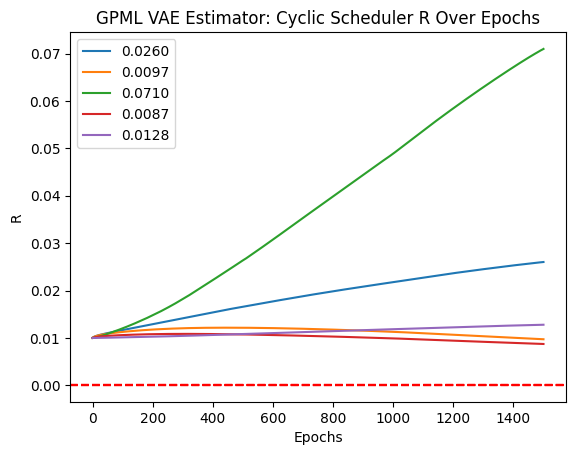

VAE Fit:  16%|█▌        | 1600/10000 [18:05<1:34:01,  1.49it/s]

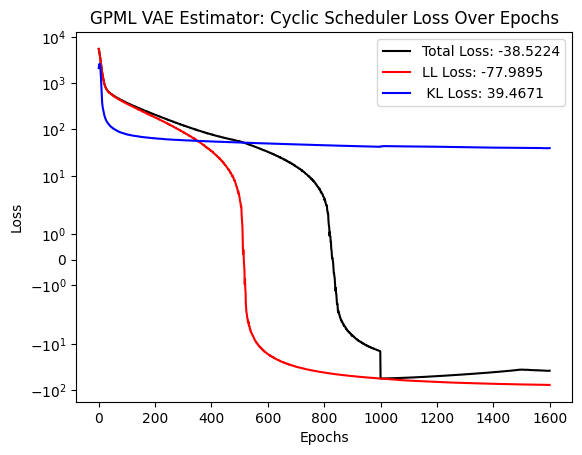

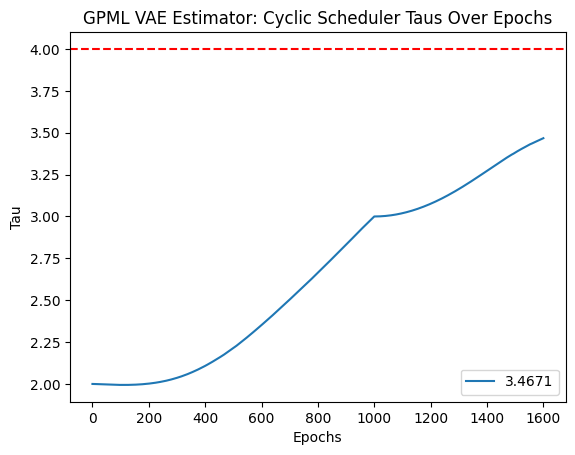

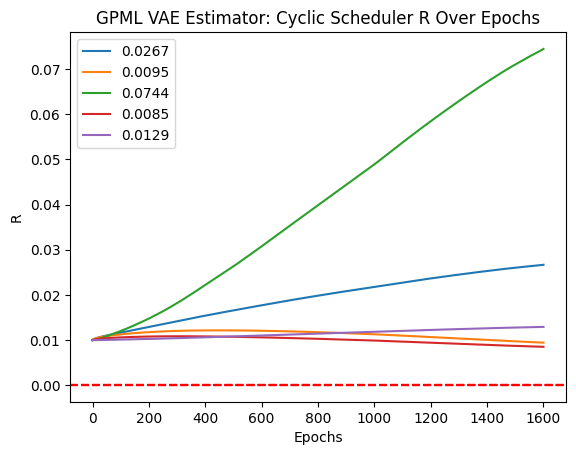

VAE Fit:  17%|█▋        | 1700/10000 [19:13<1:43:11,  1.34it/s]

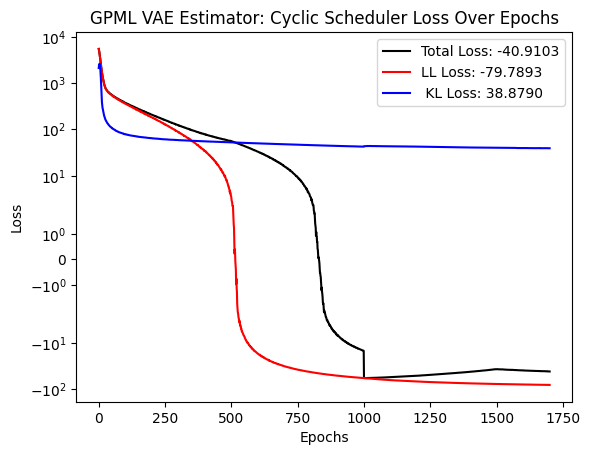

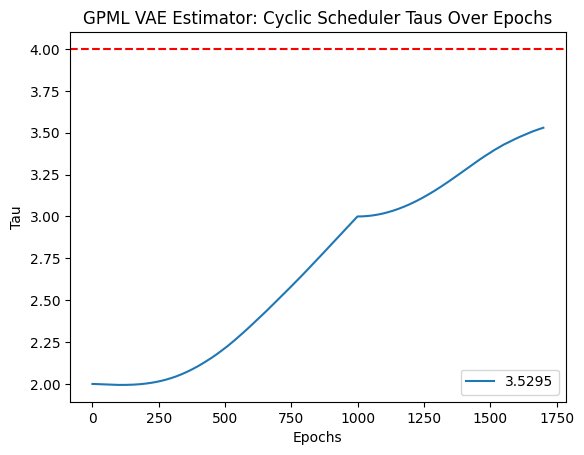

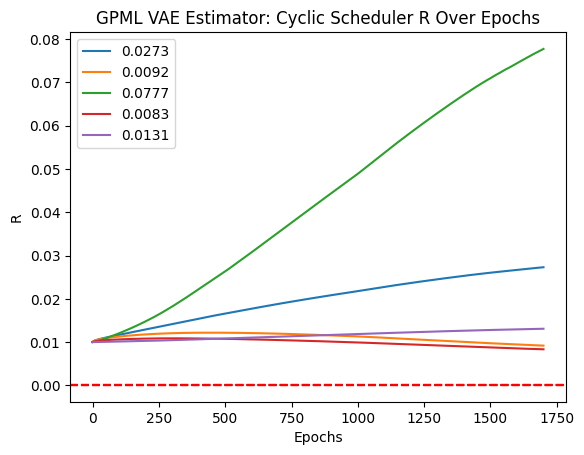

VAE Fit:  18%|█▊        | 1800/10000 [20:20<1:27:23,  1.56it/s]

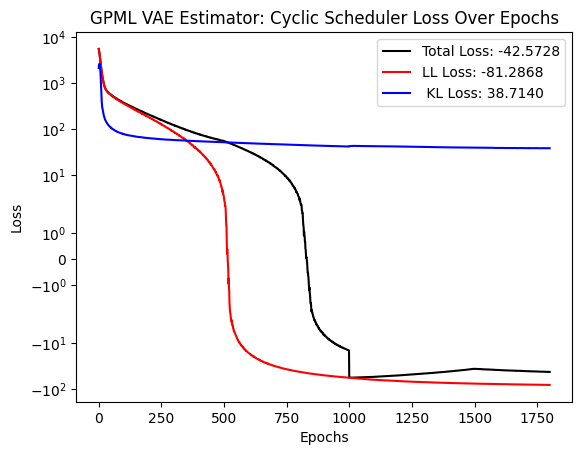

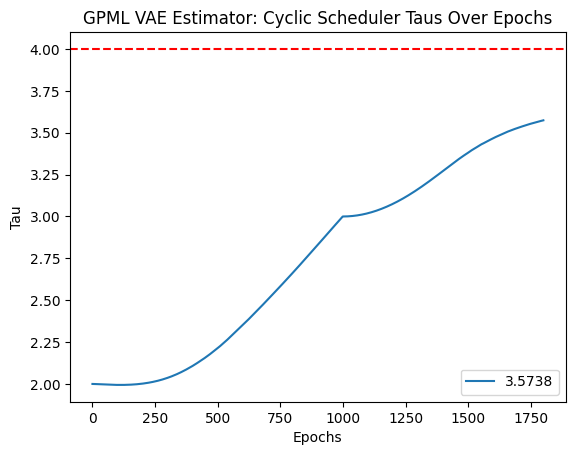

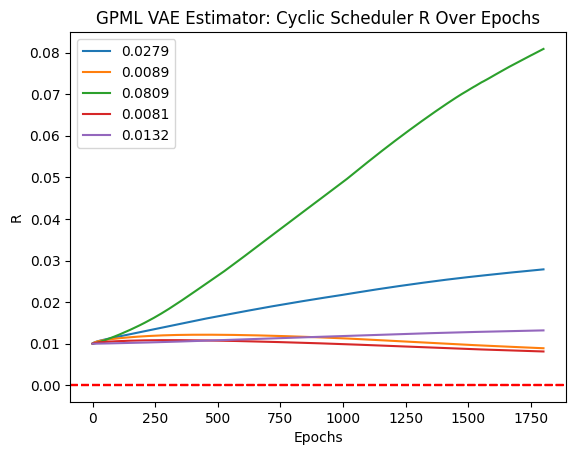

VAE Fit:  19%|█▉        | 1900/10000 [21:29<1:30:08,  1.50it/s]

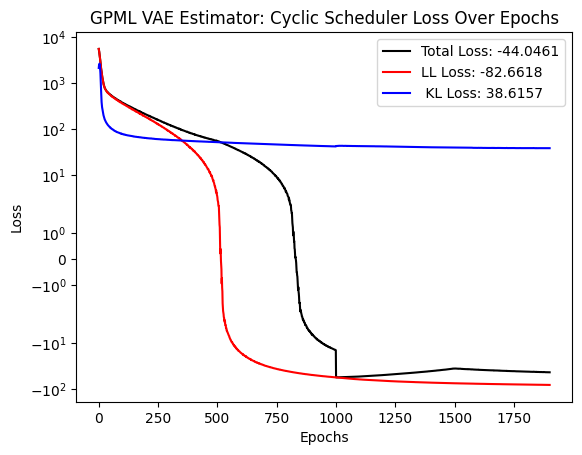

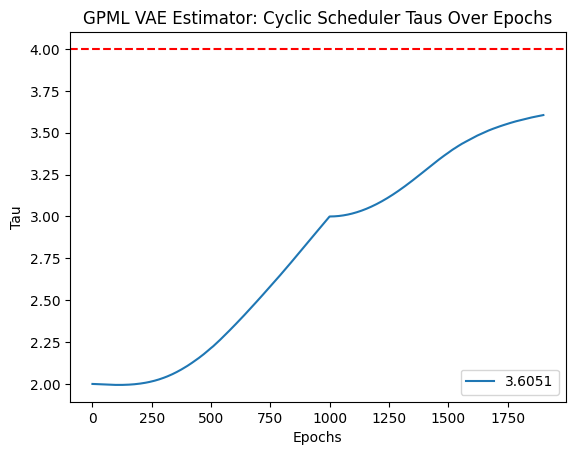

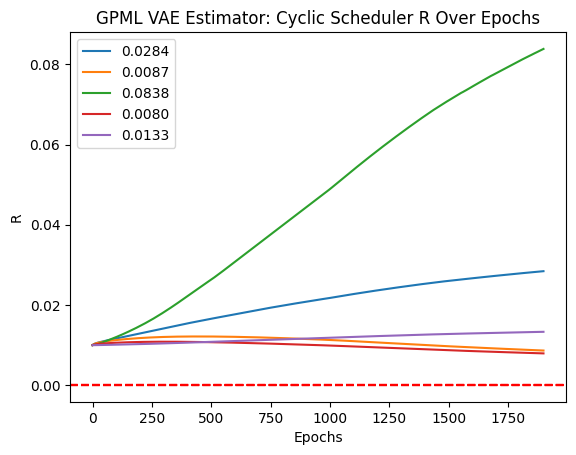

VAE Fit:  20%|██        | 2000/10000 [22:37<1:23:40,  1.59it/s]

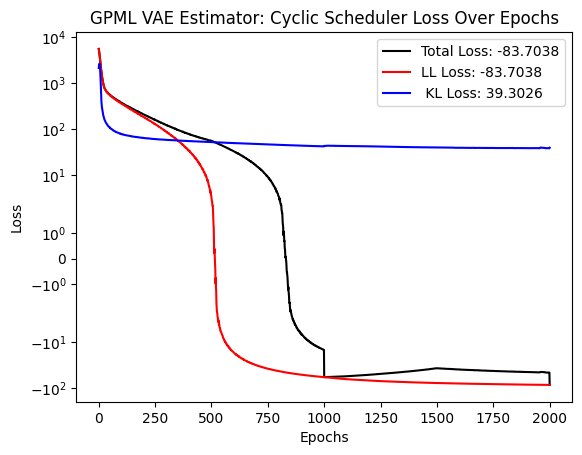

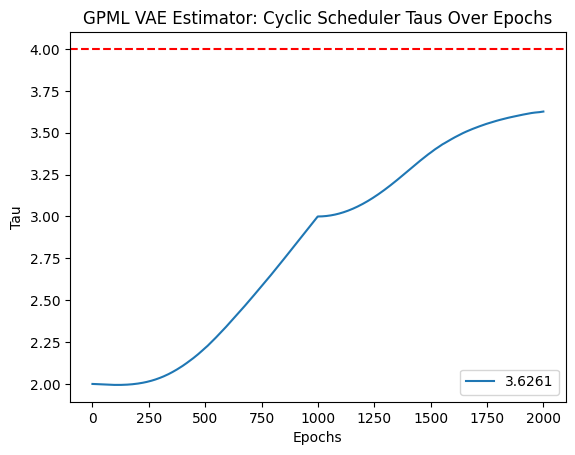

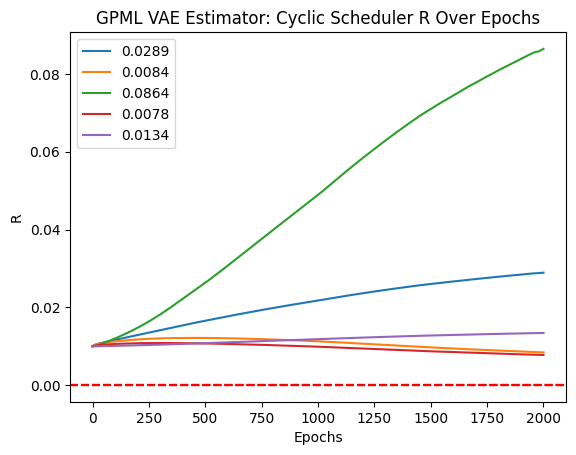

VAE Fit:  21%|██        | 2100/10000 [23:46<1:25:16,  1.54it/s]

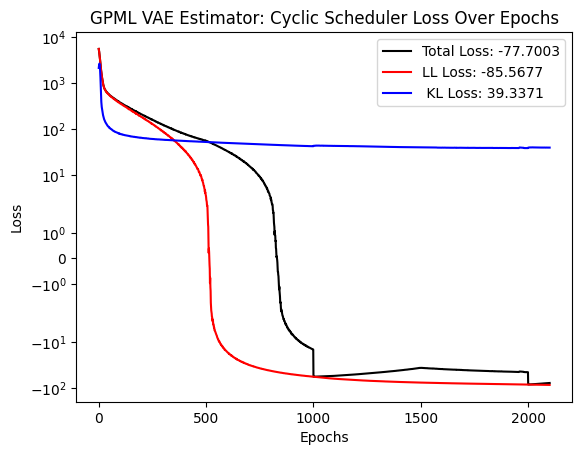

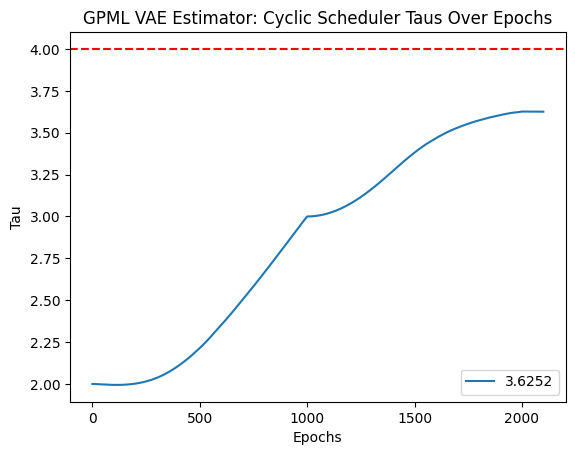

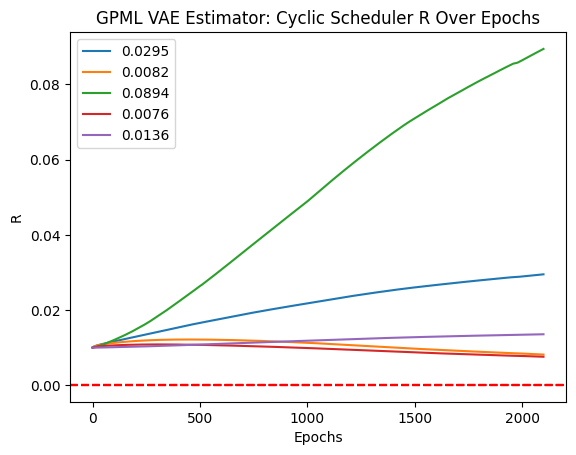

VAE Fit:  22%|██▏       | 2200/10000 [24:56<1:24:27,  1.54it/s]

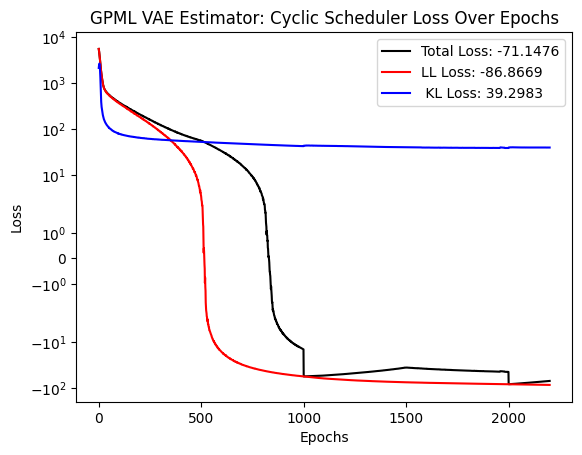

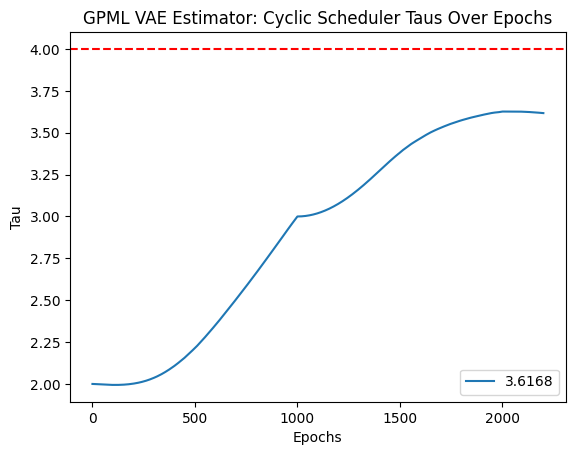

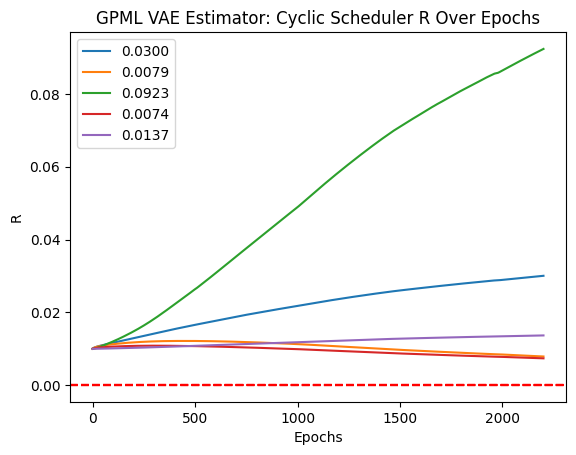

VAE Fit:  23%|██▎       | 2300/10000 [26:03<1:38:19,  1.31it/s]

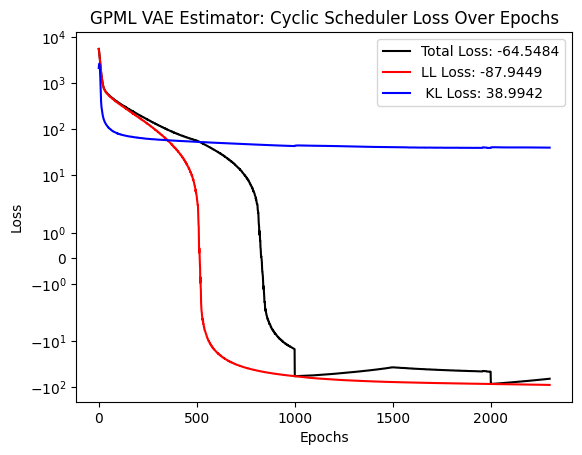

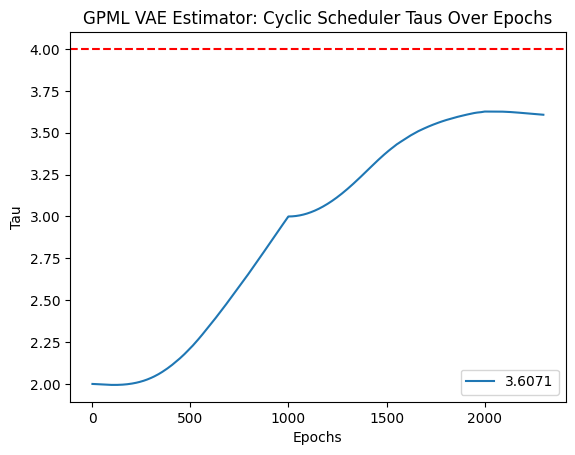

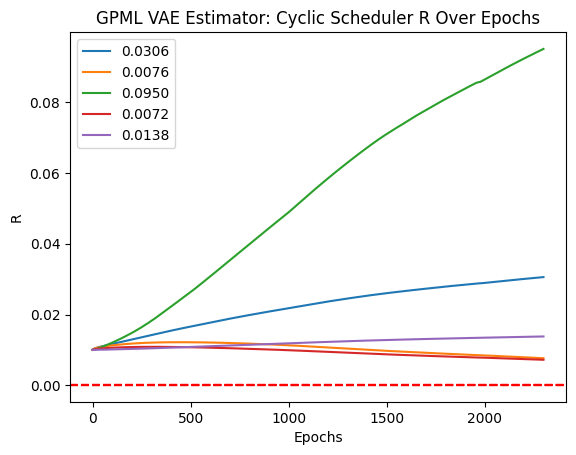

VAE Fit:  24%|██▍       | 2400/10000 [27:10<1:21:26,  1.56it/s]

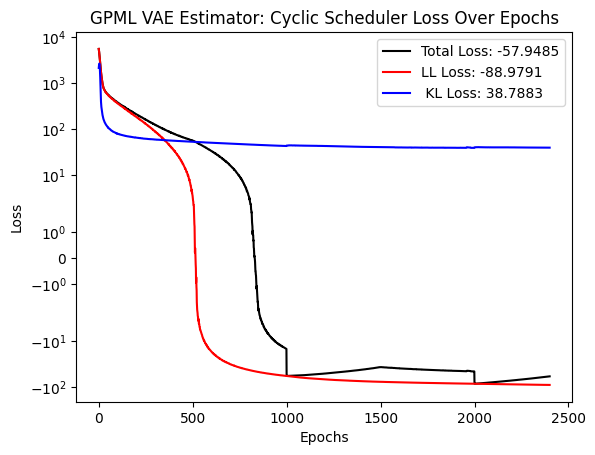

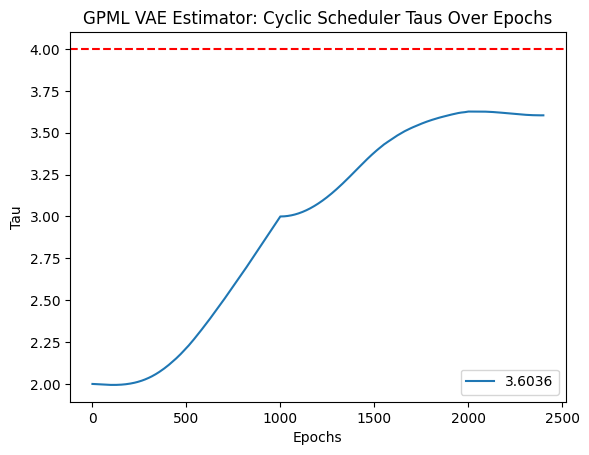

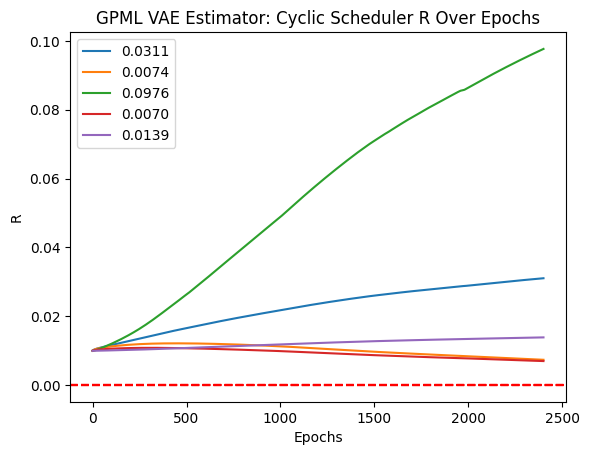

VAE Fit:  25%|██▌       | 2500/10000 [28:19<1:26:03,  1.45it/s]

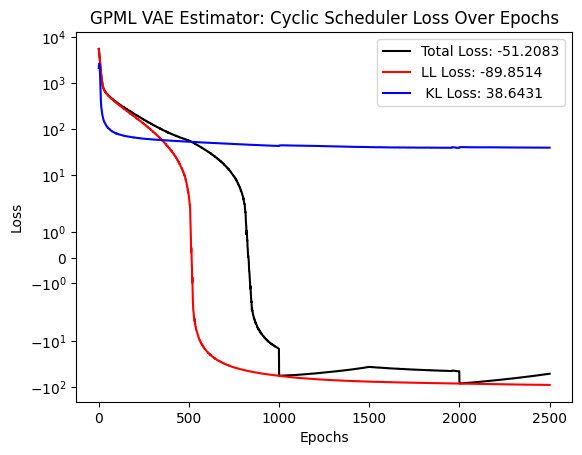

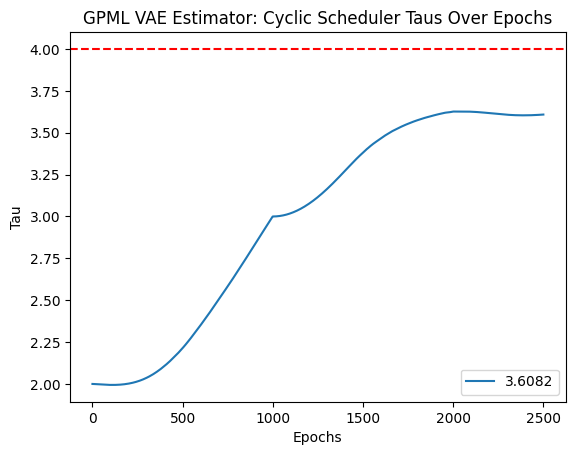

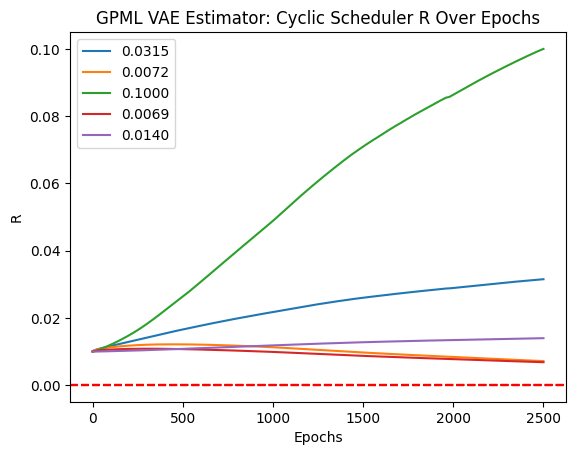

VAE Fit:  26%|██▌       | 2600/10000 [29:26<1:23:09,  1.48it/s]

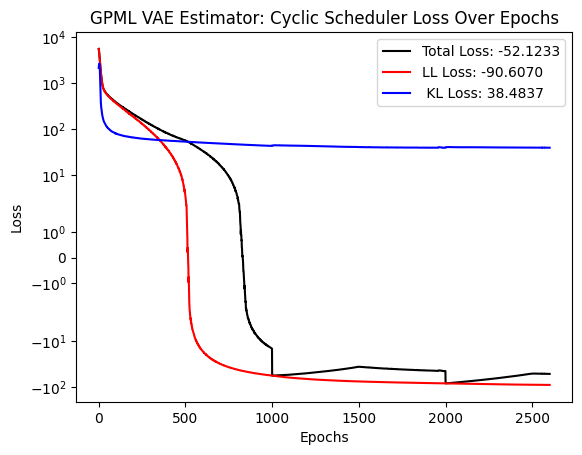

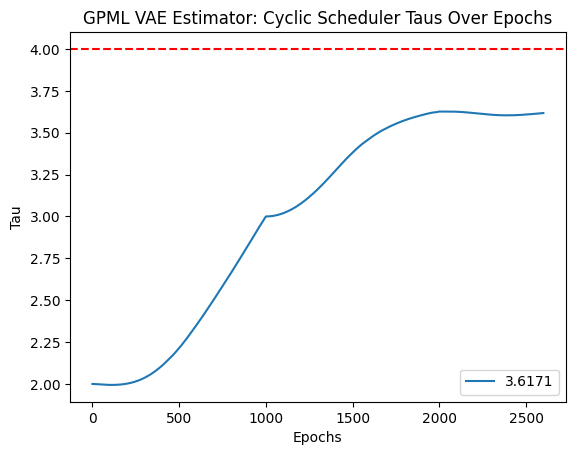

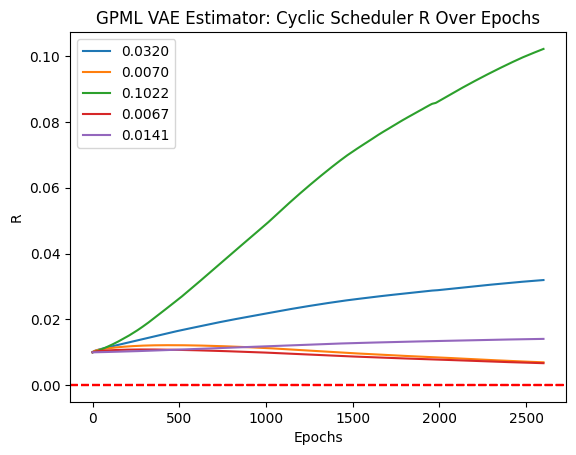

VAE Fit:  27%|██▋       | 2700/10000 [30:34<1:18:21,  1.55it/s]

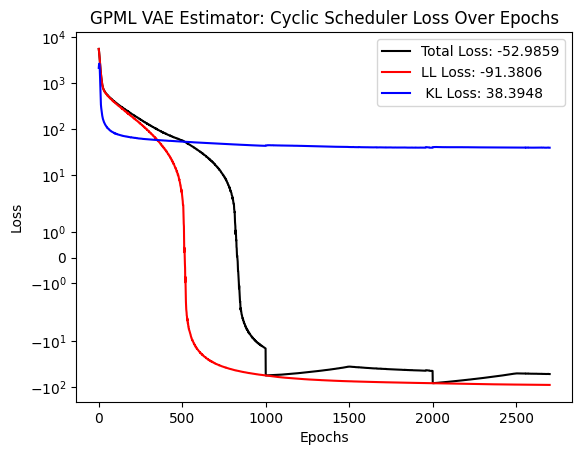

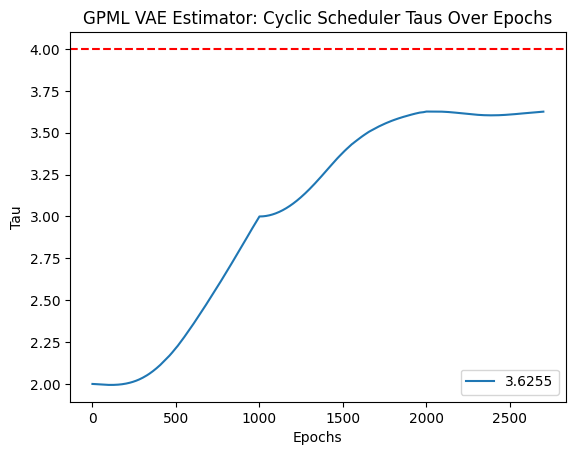

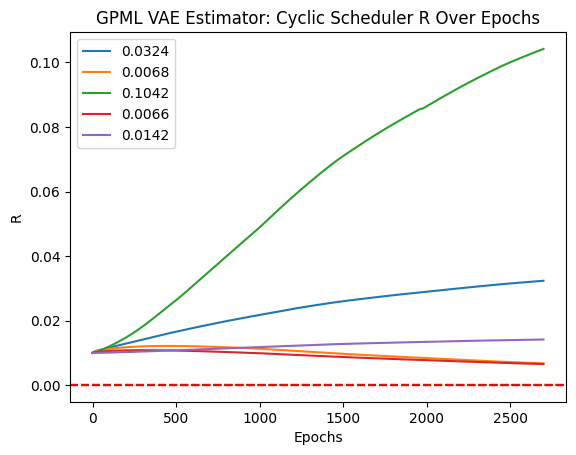

VAE Fit:  28%|██▊       | 2800/10000 [31:42<1:24:25,  1.42it/s]

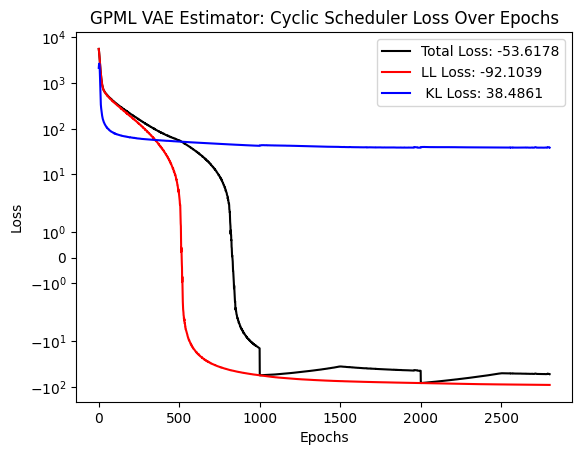

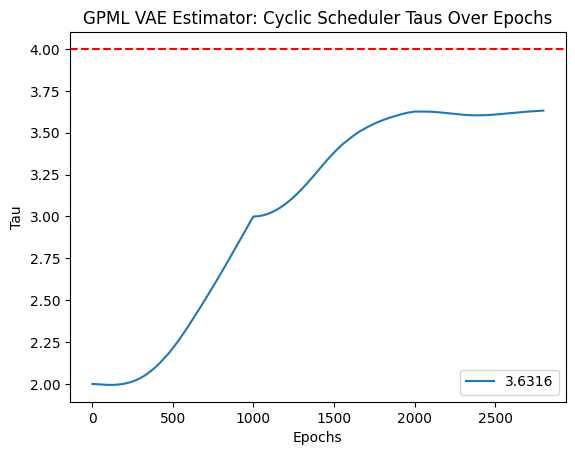

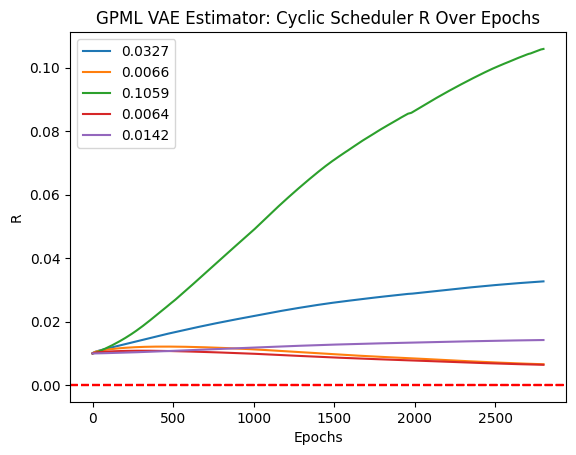

VAE Fit:  29%|██▉       | 2900/10000 [32:50<1:14:47,  1.58it/s]

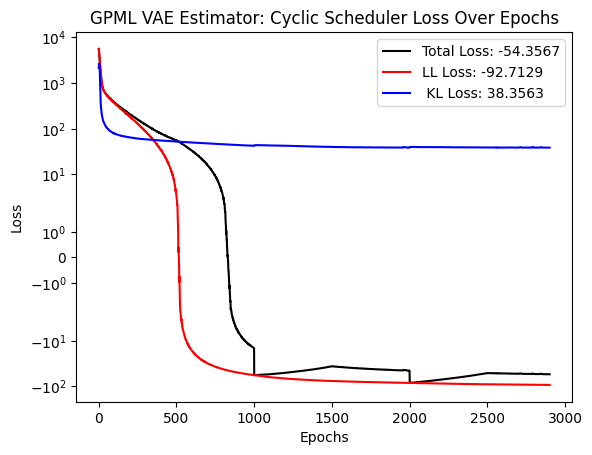

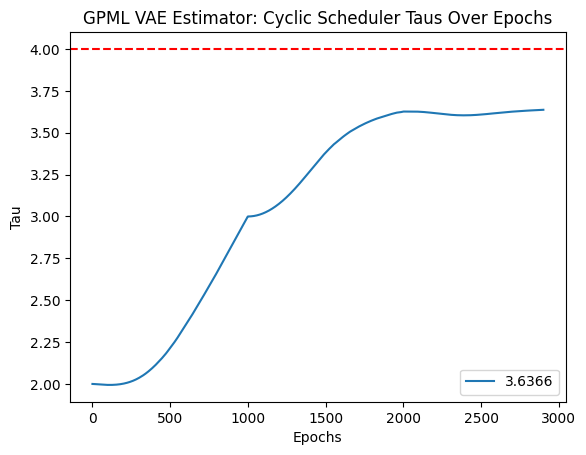

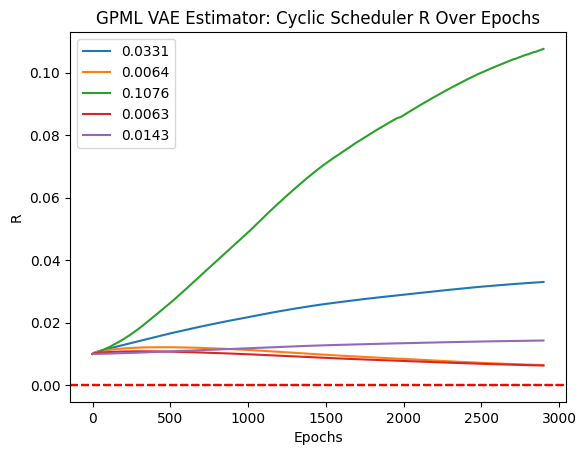

VAE Fit:  30%|███       | 3000/10000 [33:58<1:14:17,  1.57it/s]

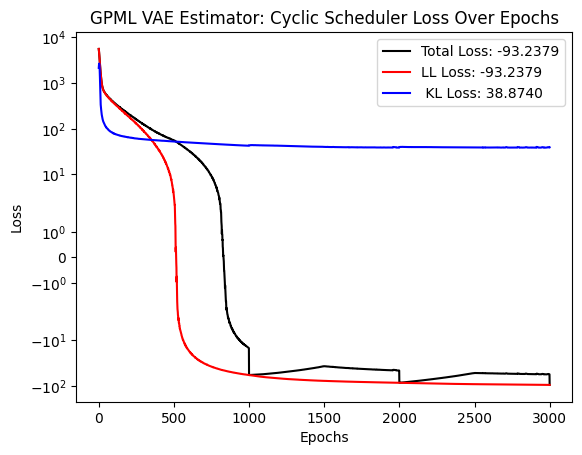

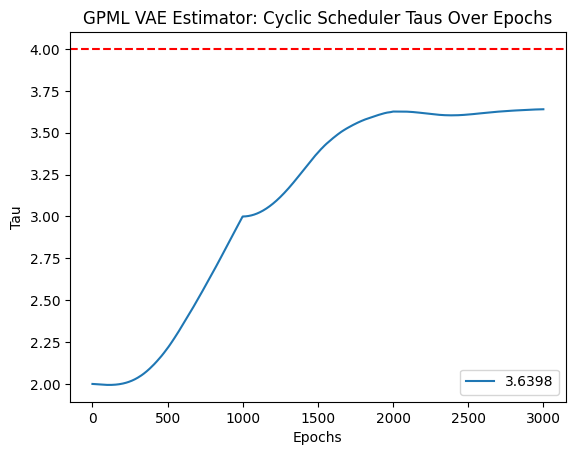

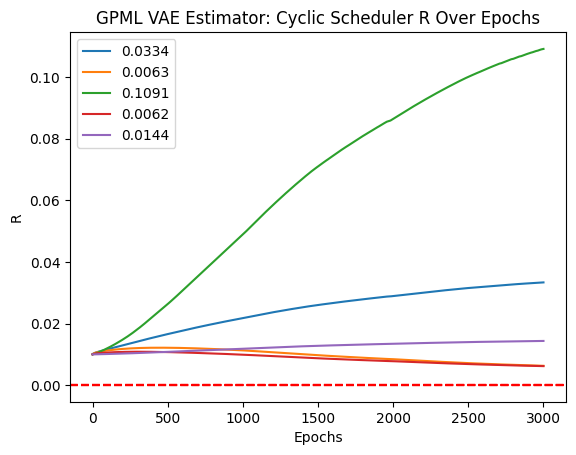

VAE Fit:  31%|███       | 3100/10000 [35:06<1:22:09,  1.40it/s]

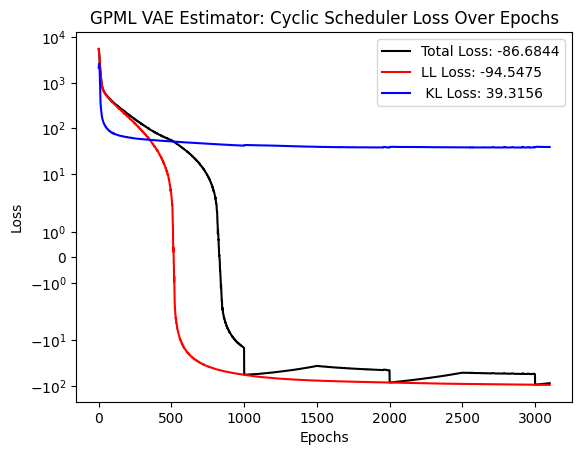

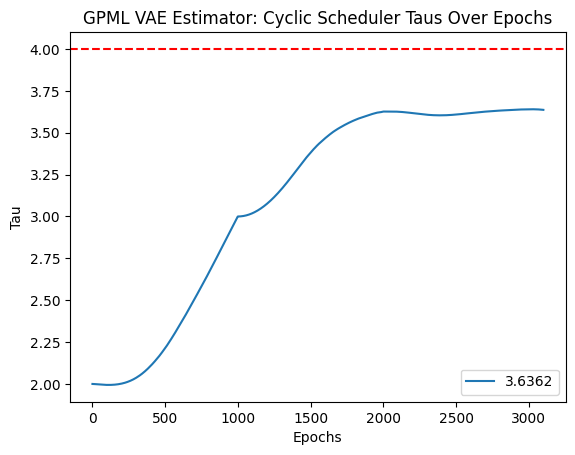

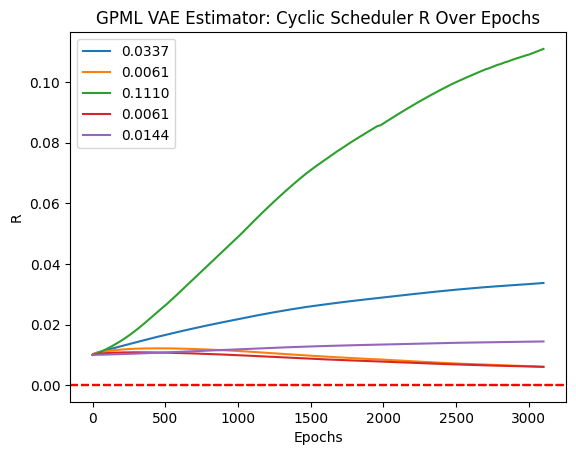

VAE Fit:  32%|███▏      | 3200/10000 [36:14<1:11:44,  1.58it/s]

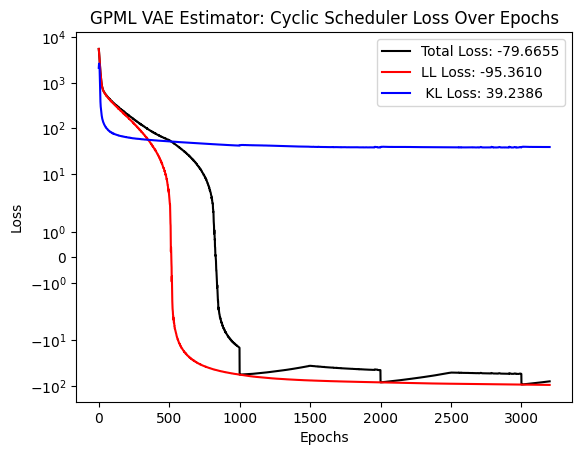

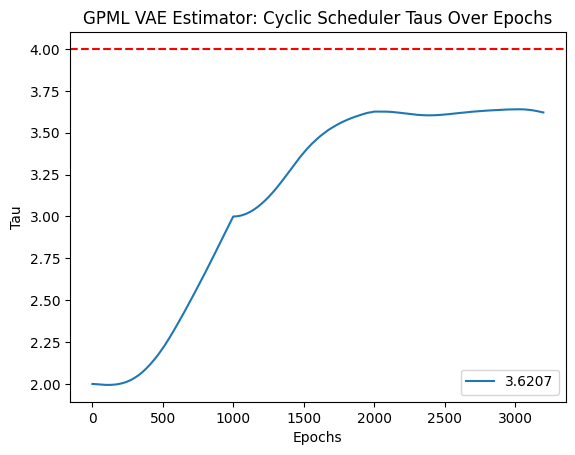

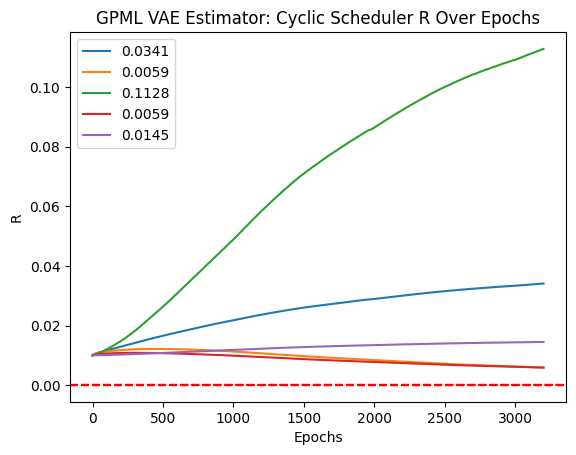

VAE Fit:  33%|███▎      | 3300/10000 [37:25<1:17:54,  1.43it/s]

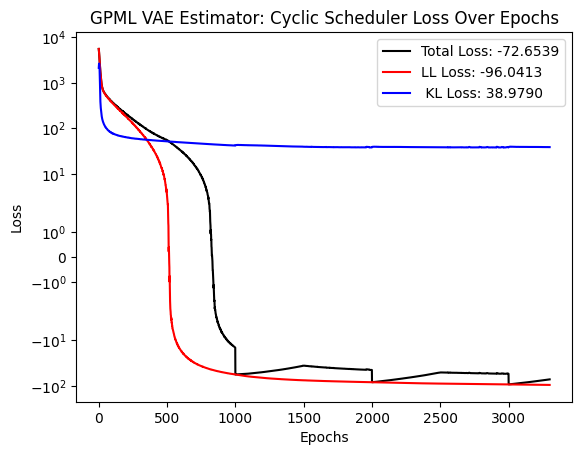

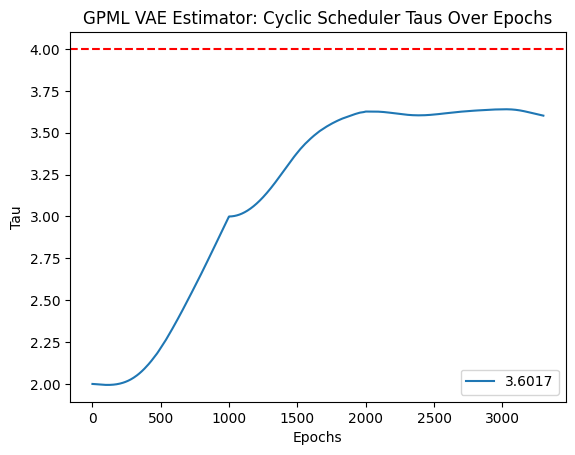

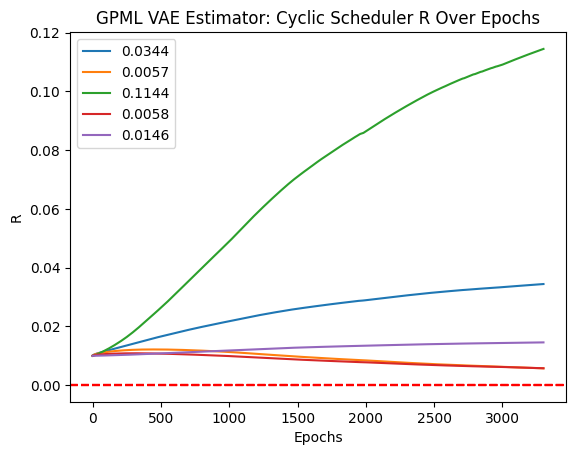

VAE Fit:  34%|███▍      | 3400/10000 [38:34<1:12:49,  1.51it/s]

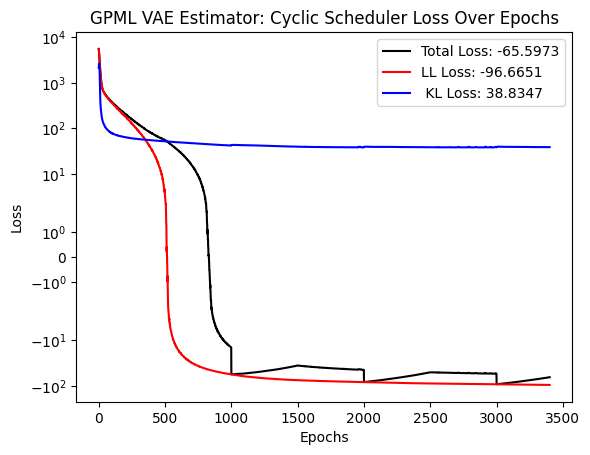

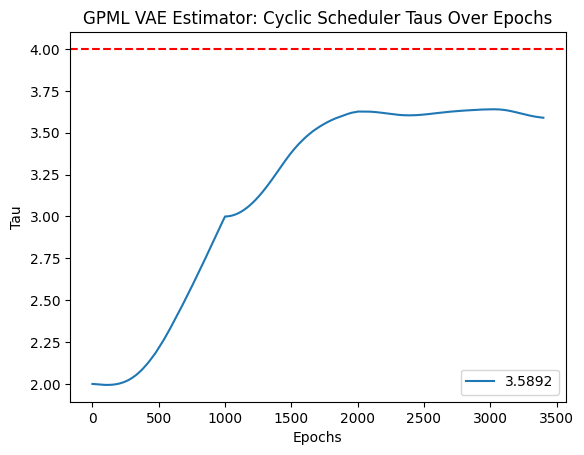

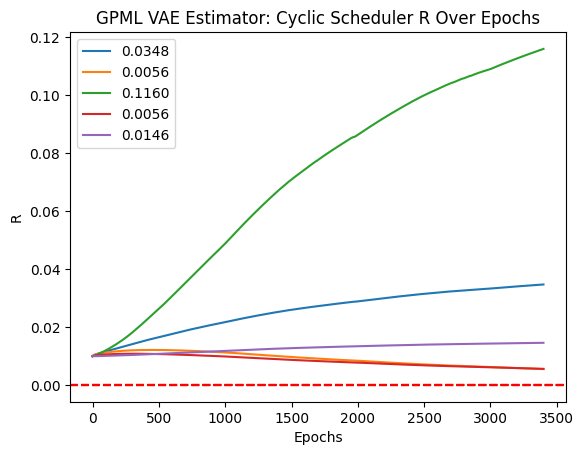

VAE Fit:  35%|███▌      | 3500/10000 [39:45<1:18:16,  1.38it/s]

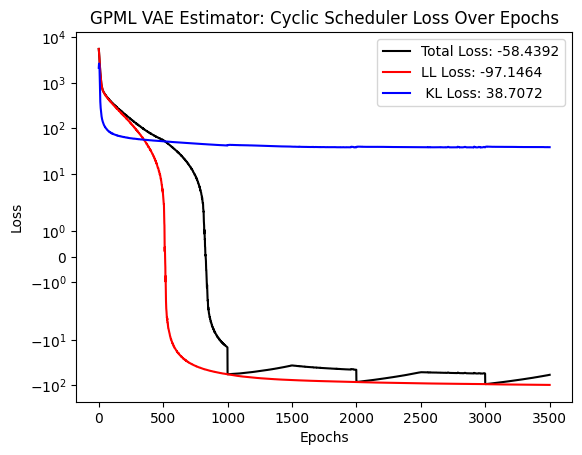

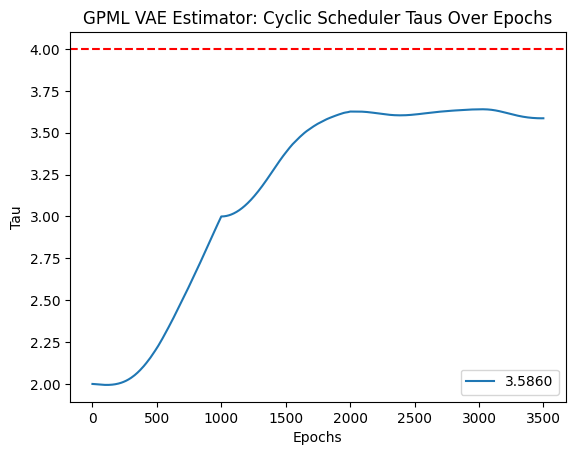

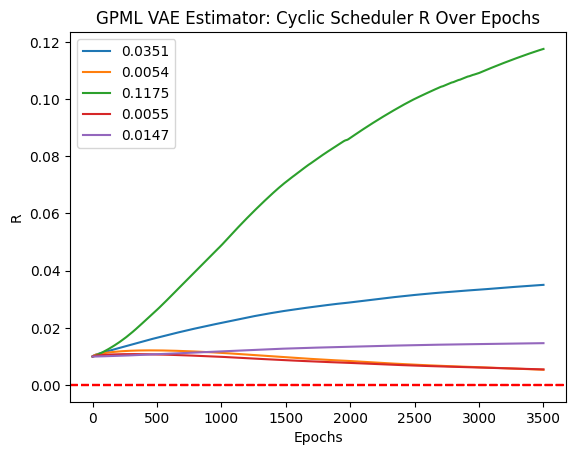

VAE Fit:  36%|███▌      | 3600/10000 [40:56<1:22:44,  1.29it/s]

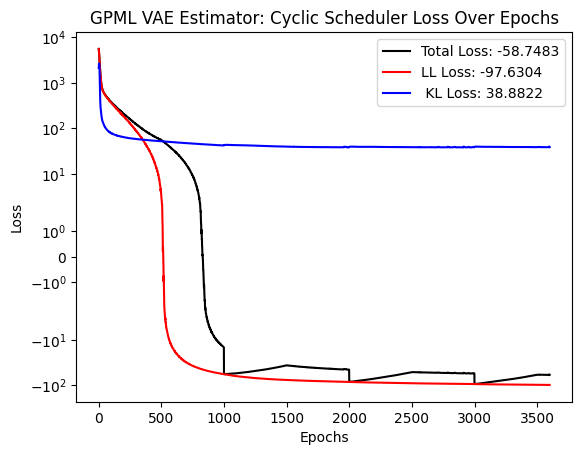

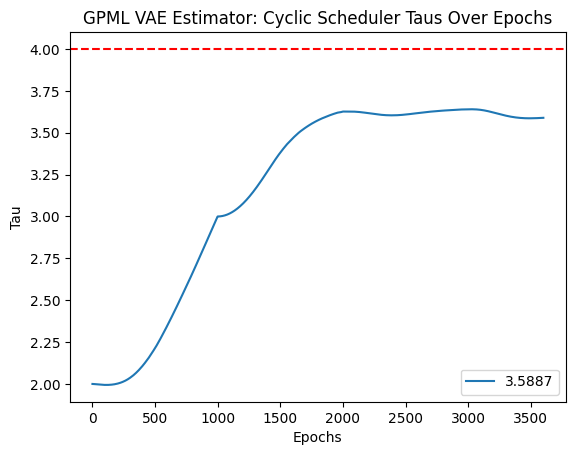

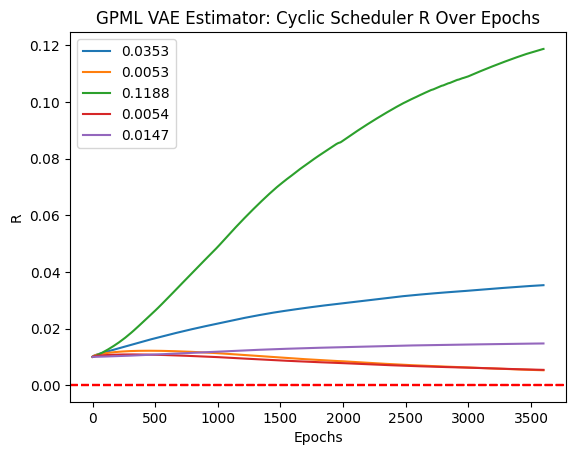

VAE Fit:  37%|███▋      | 3700/10000 [42:05<1:09:25,  1.51it/s]

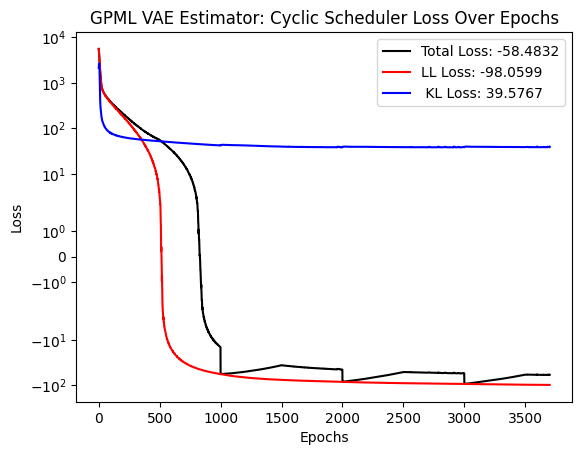

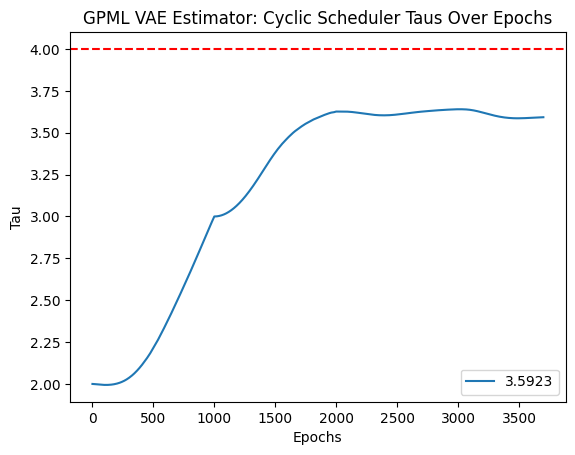

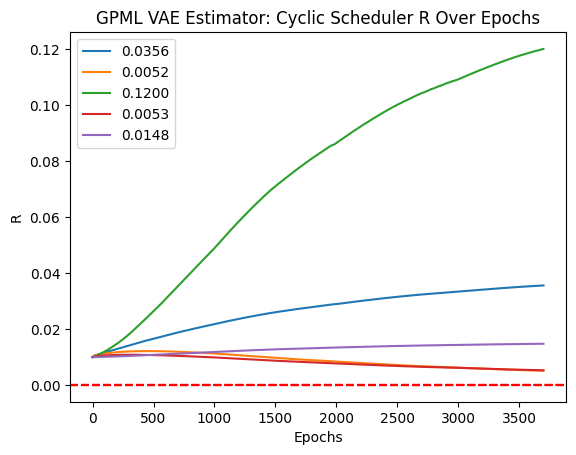

VAE Fit:  38%|███▊      | 3800/10000 [43:15<1:07:06,  1.54it/s]

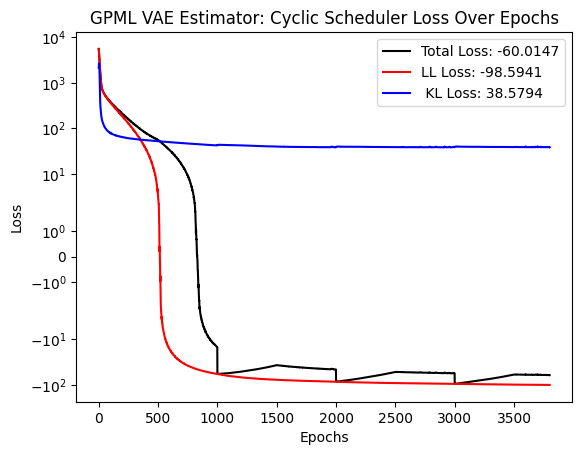

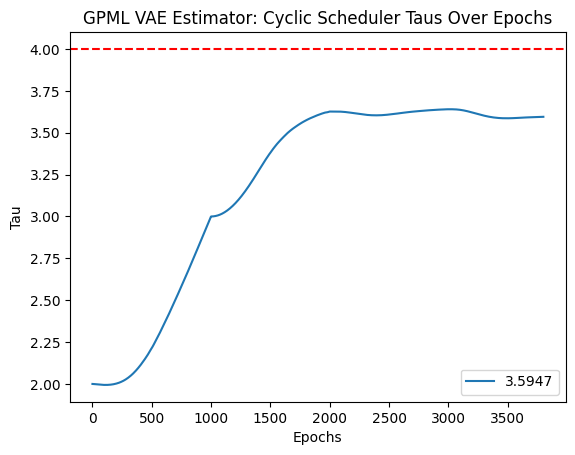

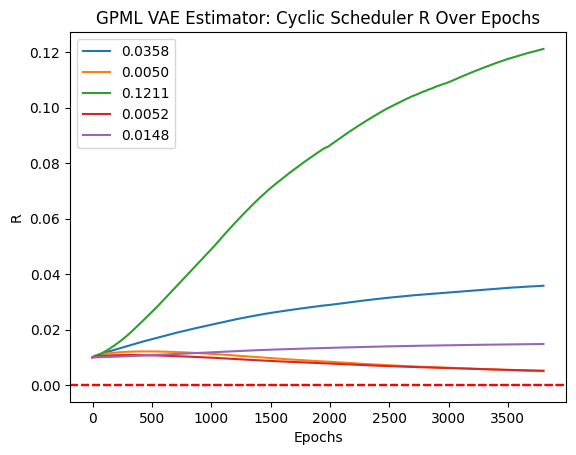

VAE Fit:  39%|███▉      | 3900/10000 [44:26<1:08:29,  1.48it/s]

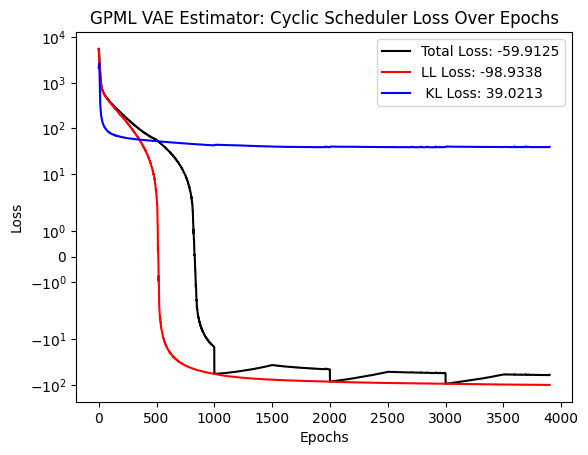

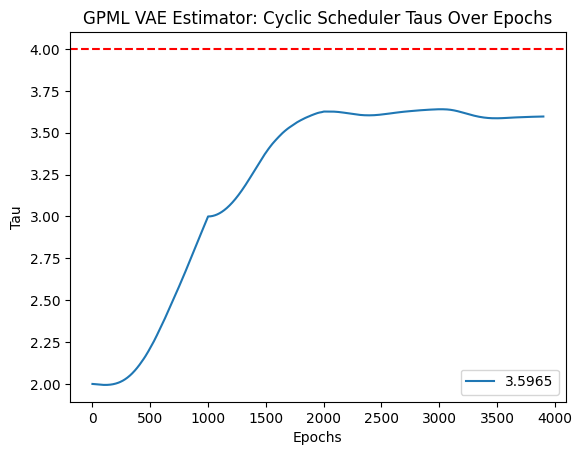

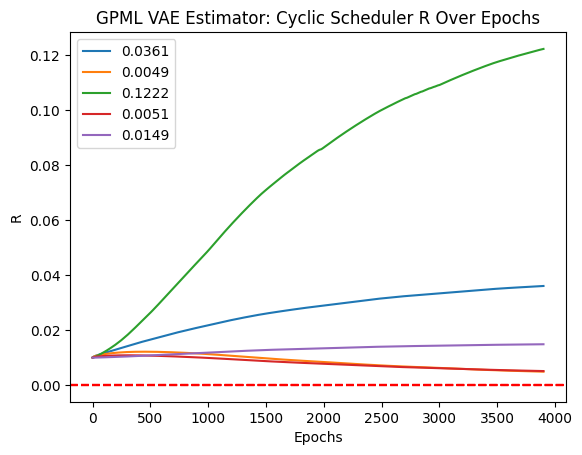

VAE Fit:  40%|████      | 4000/10000 [45:37<1:08:24,  1.46it/s]

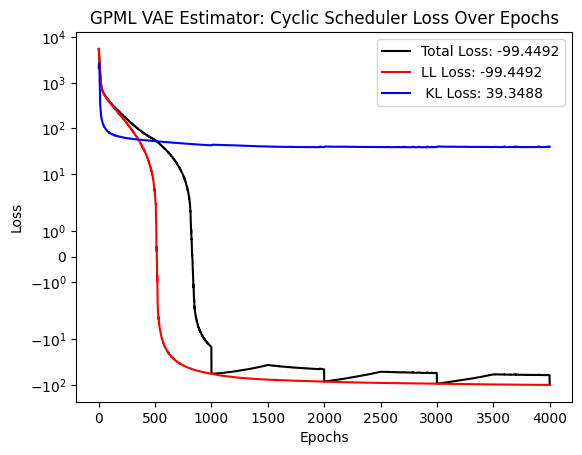

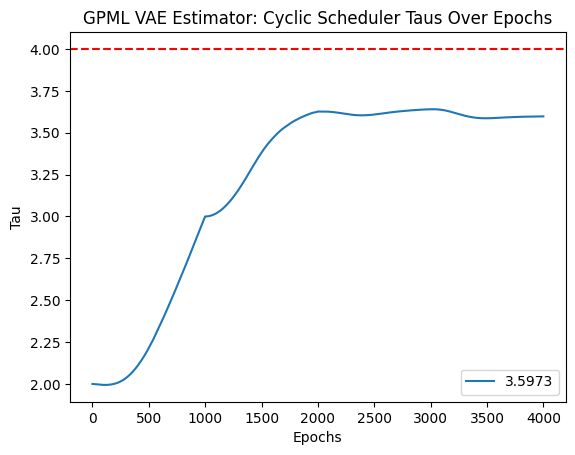

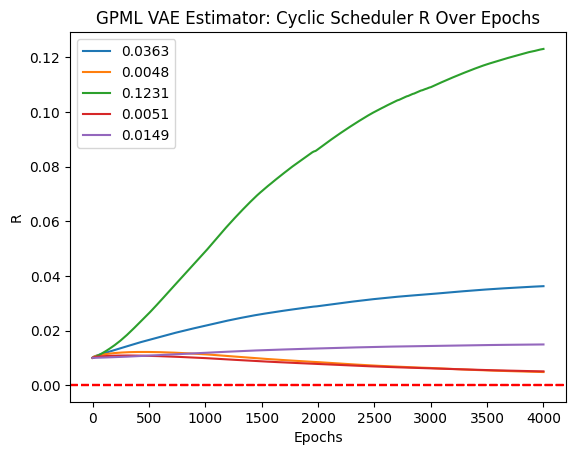

VAE Fit:  41%|████      | 4100/10000 [46:50<1:09:22,  1.42it/s]

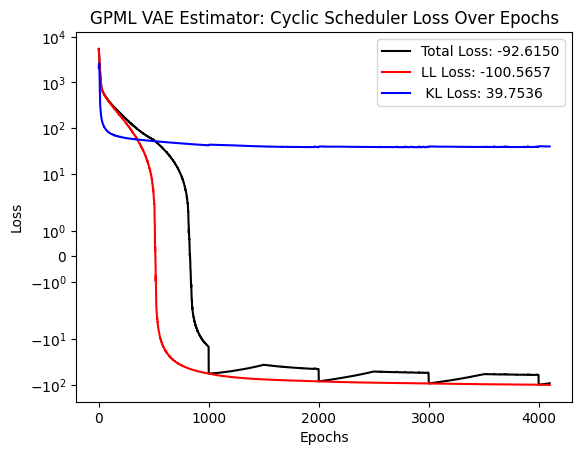

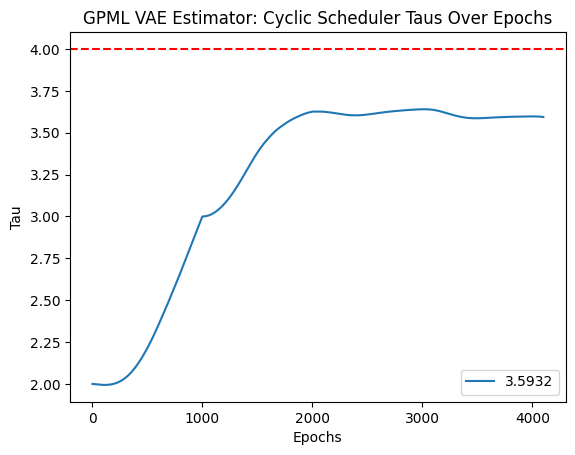

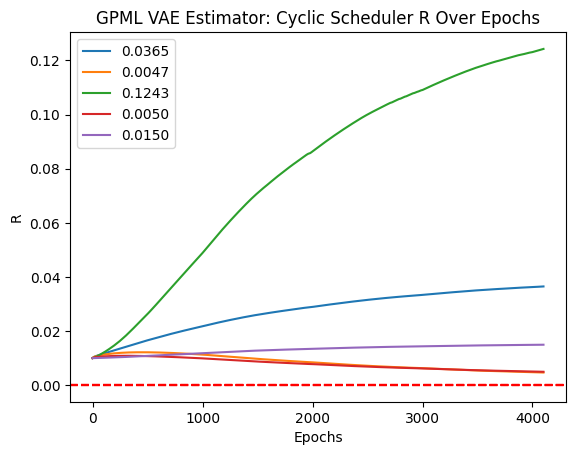

VAE Fit:  42%|████▏     | 4200/10000 [48:02<1:05:55,  1.47it/s]

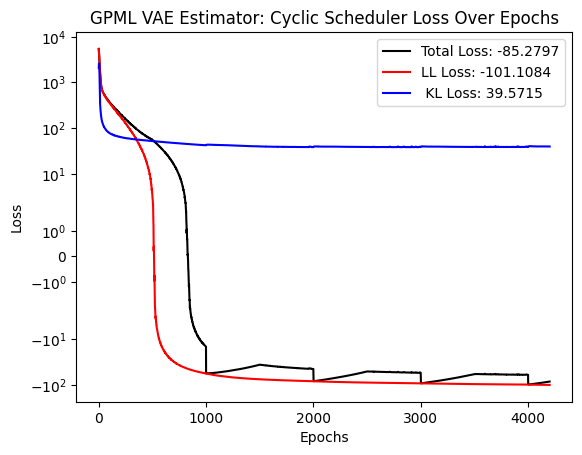

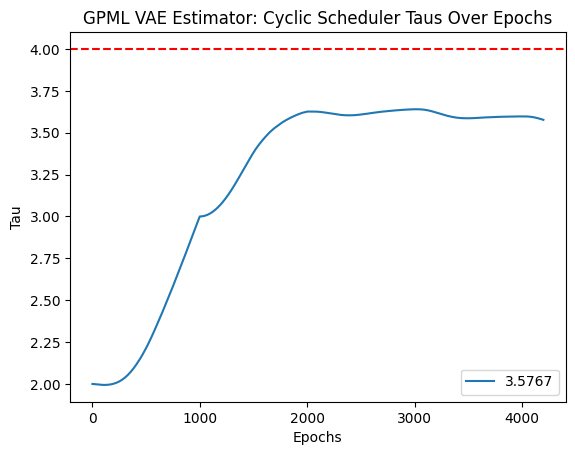

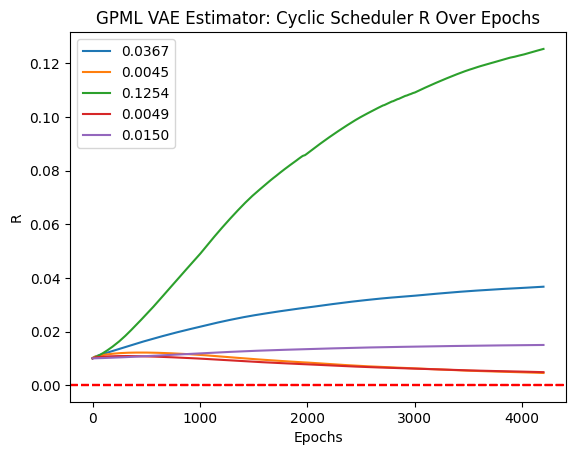

VAE Fit:  43%|████▎     | 4300/10000 [49:14<1:07:39,  1.40it/s]

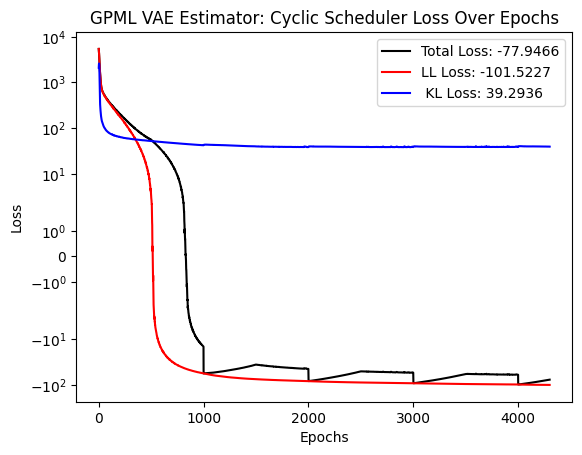

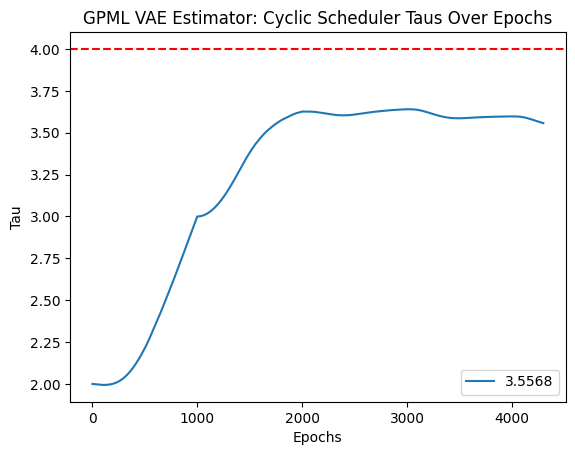

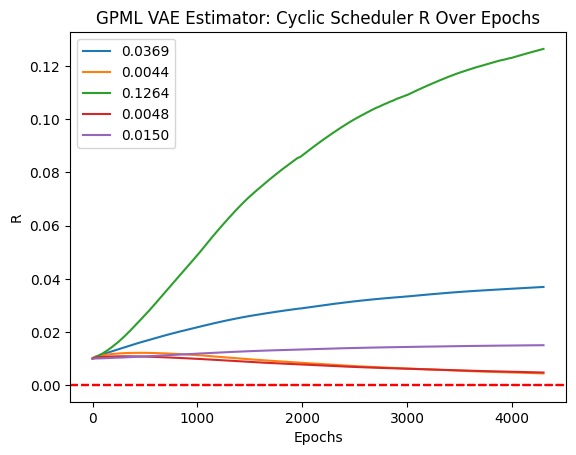

VAE Fit:  44%|████▍     | 4400/10000 [50:26<1:09:15,  1.35it/s]

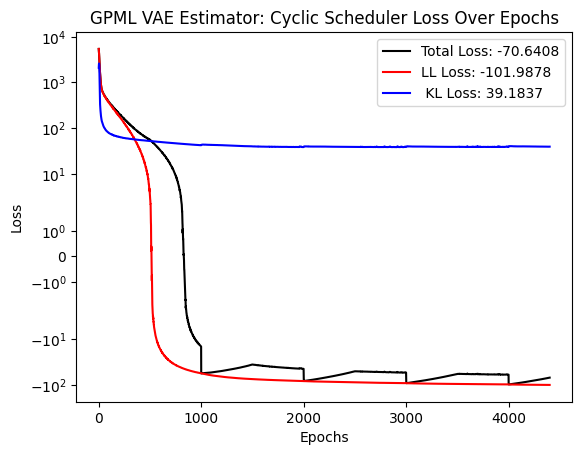

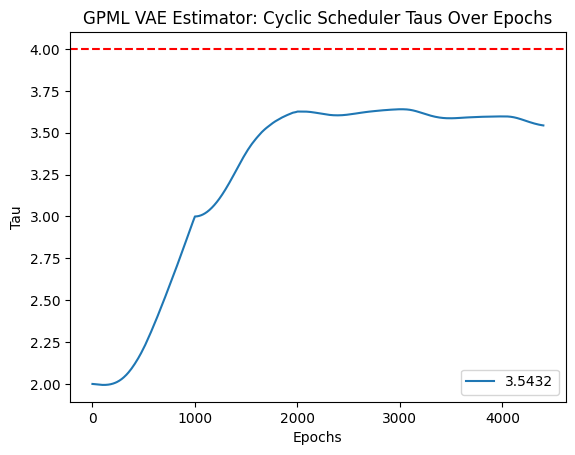

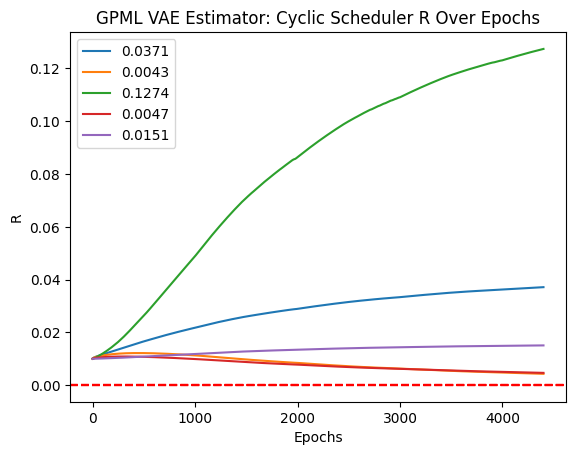

VAE Fit:  45%|████▌     | 4500/10000 [51:37<1:13:07,  1.25it/s]

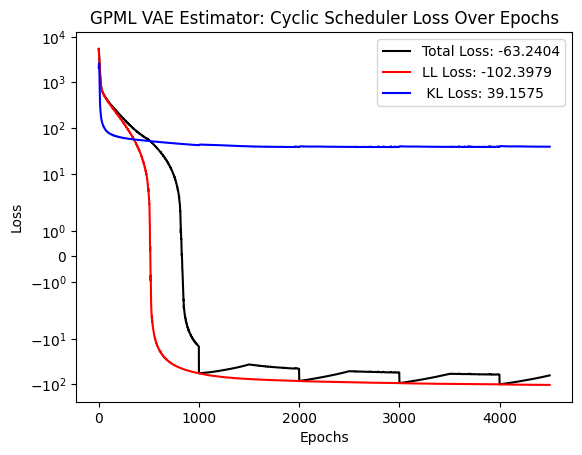

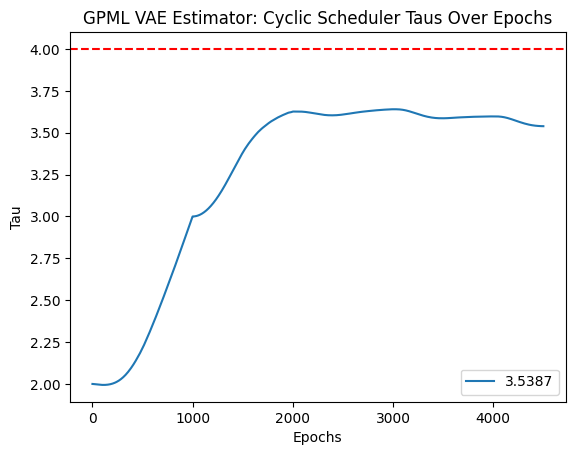

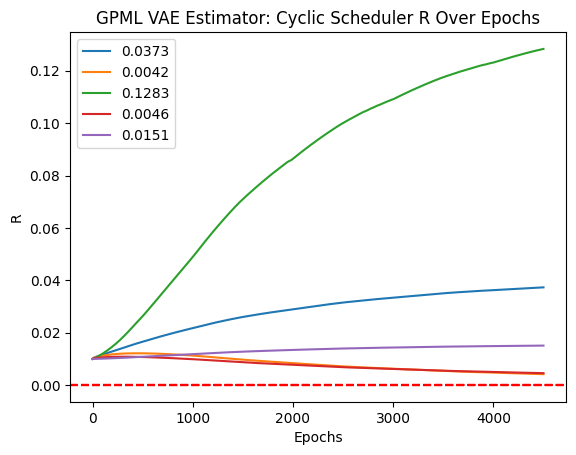

VAE Fit:  46%|████▌     | 4600/10000 [52:48<1:02:20,  1.44it/s]

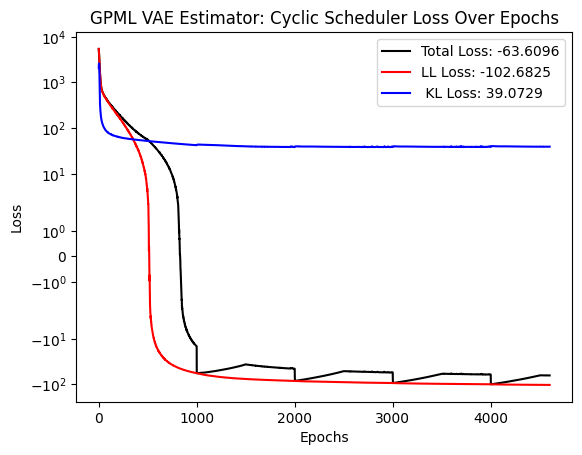

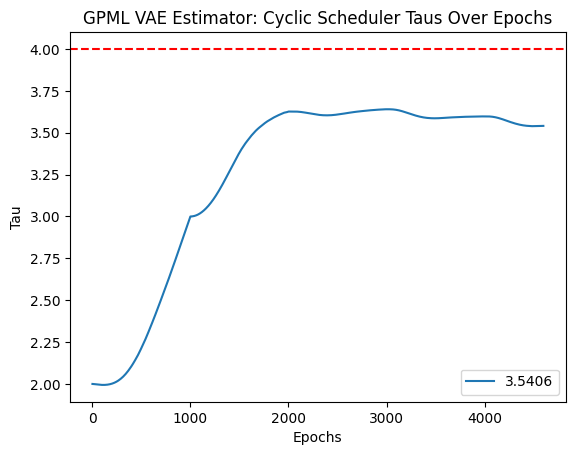

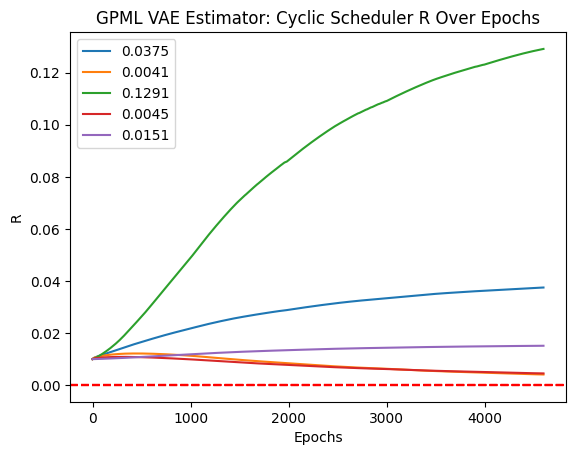

VAE Fit:  47%|████▋     | 4700/10000 [53:59<58:21,  1.51it/s]

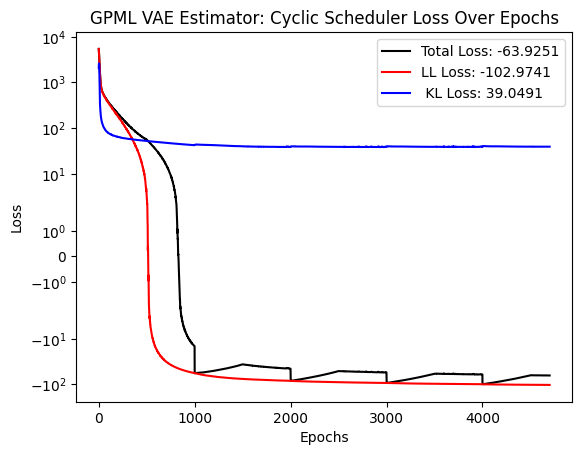

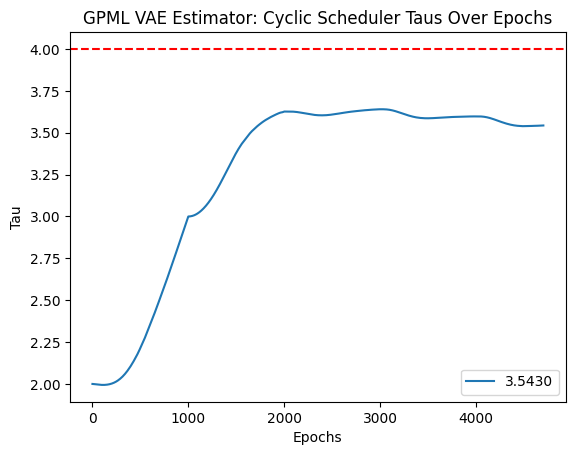

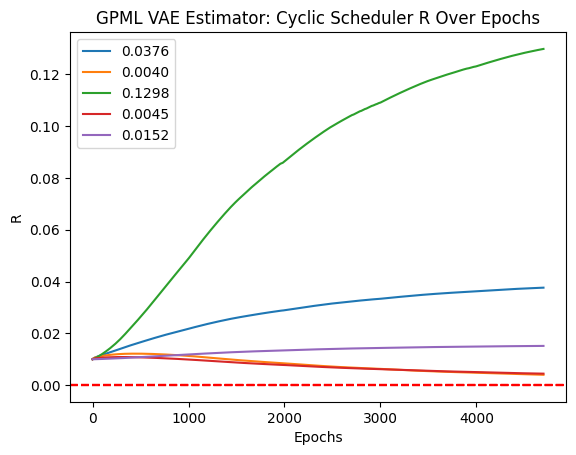

VAE Fit:  48%|████▊     | 4800/10000 [55:11<57:08,  1.52it/s]

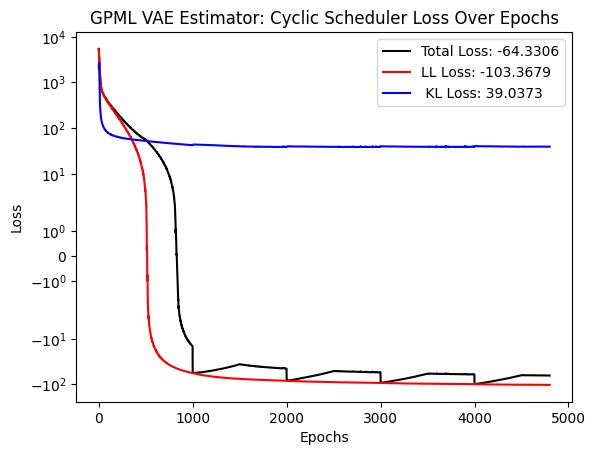

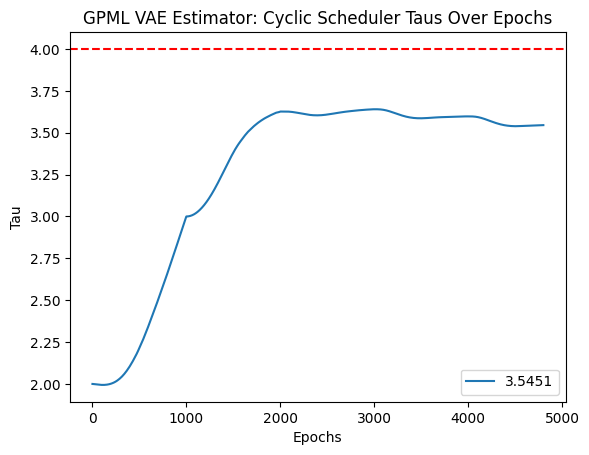

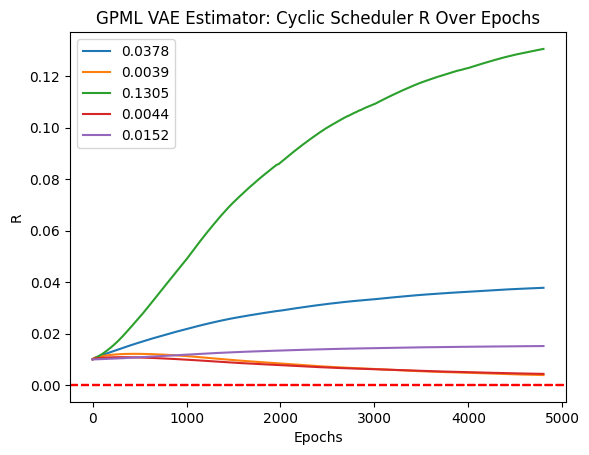

VAE Fit:  49%|████▉     | 4900/10000 [56:22<57:03,  1.49it/s]

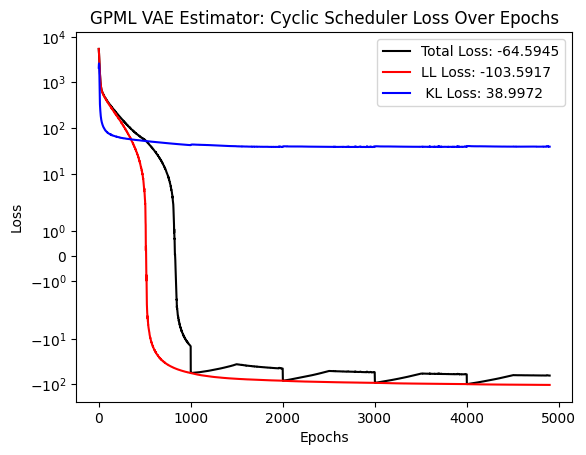

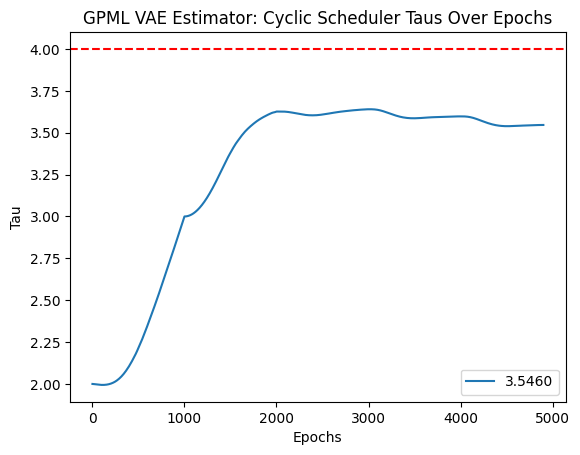

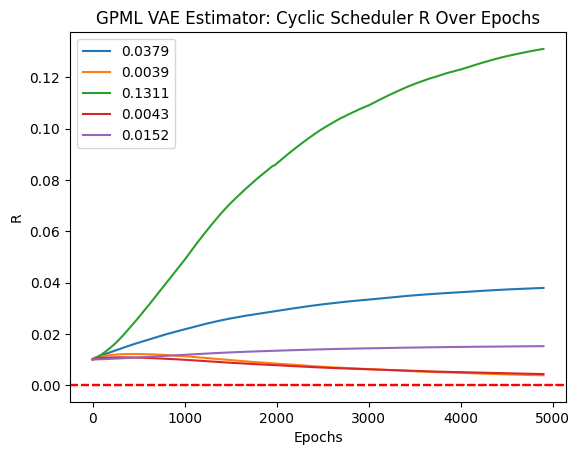

VAE Fit:  50%|█████     | 5000/10000 [57:32<58:37,  1.42it/s]

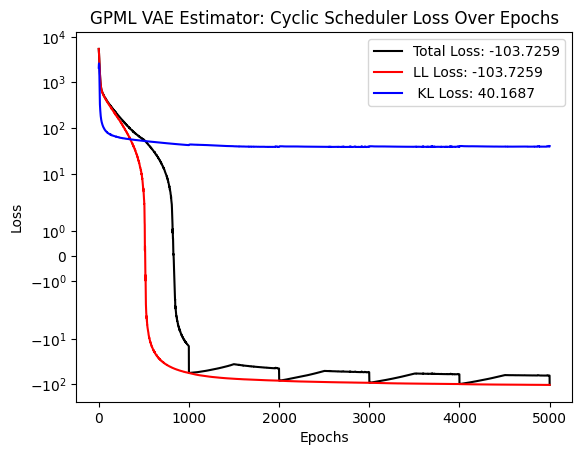

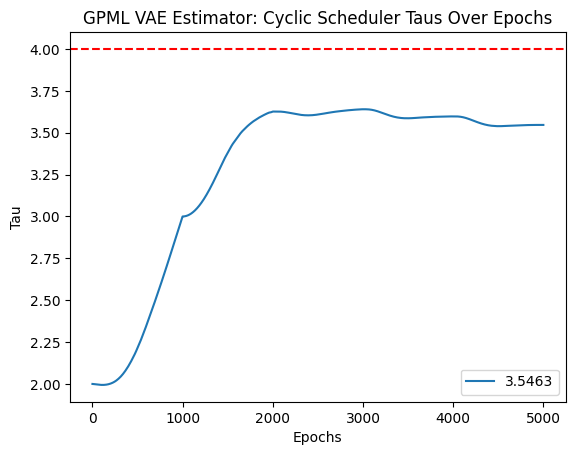

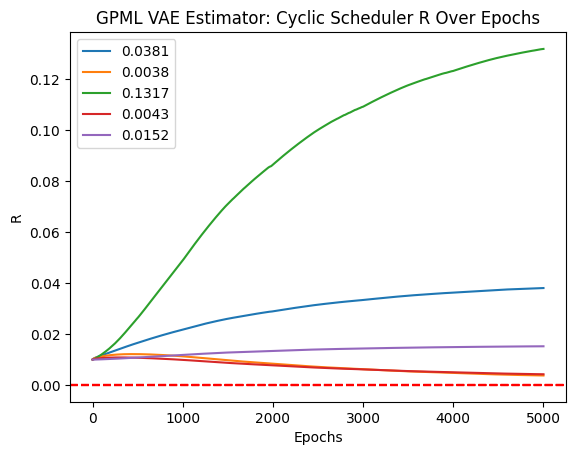

VAE Fit:  51%|█████     | 5100/10000 [58:44<59:50,  1.36it/s]  

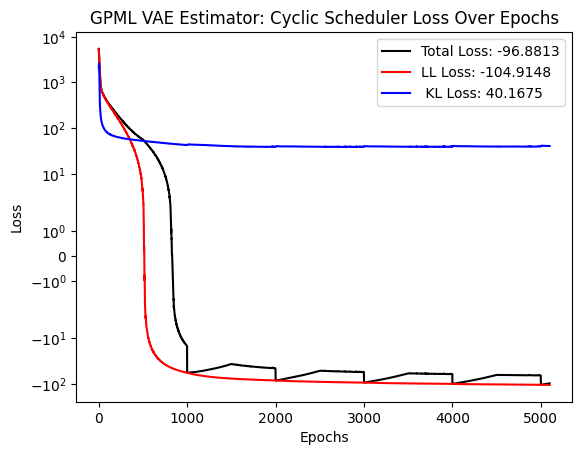

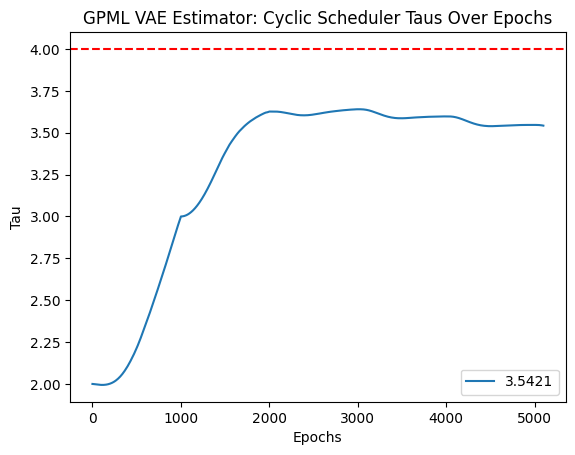

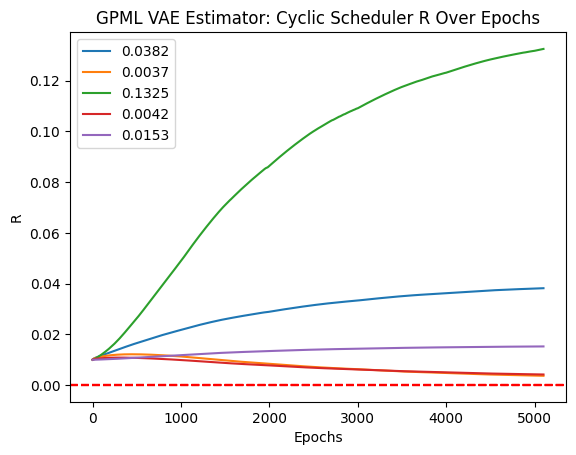

VAE Fit:  52%|█████▏    | 5200/10000 [59:55<1:04:07,  1.25it/s]

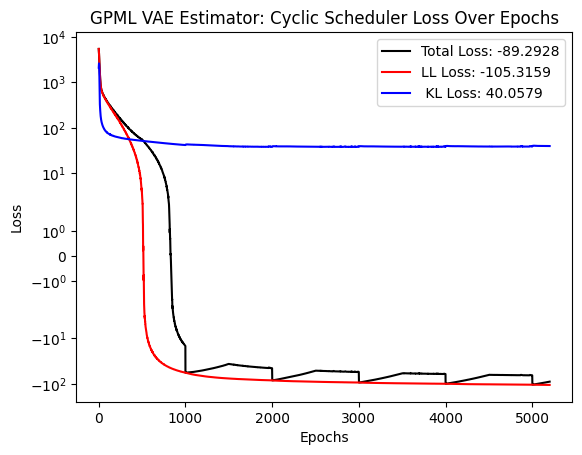

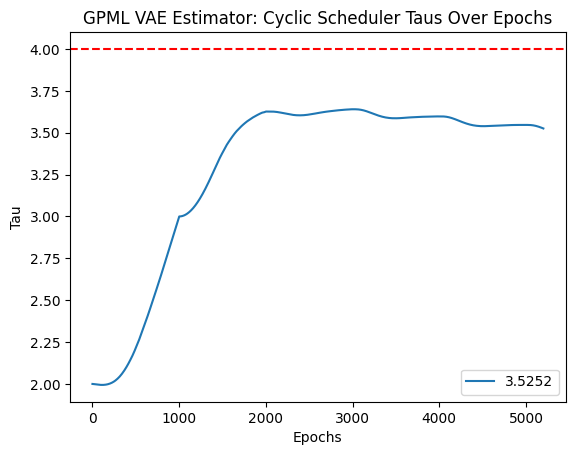

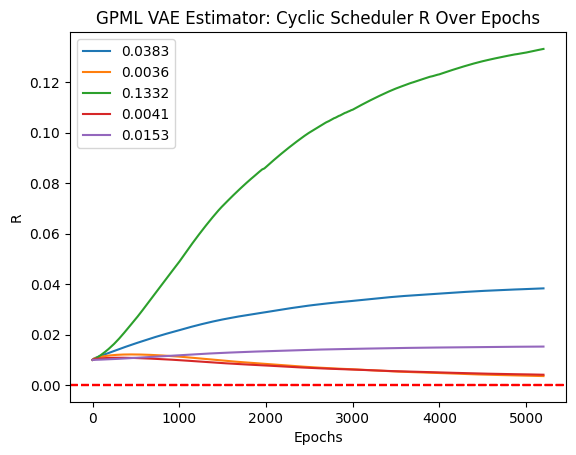

VAE Fit:  53%|█████▎    | 5300/10000 [1:01:06<52:16,  1.50it/s]

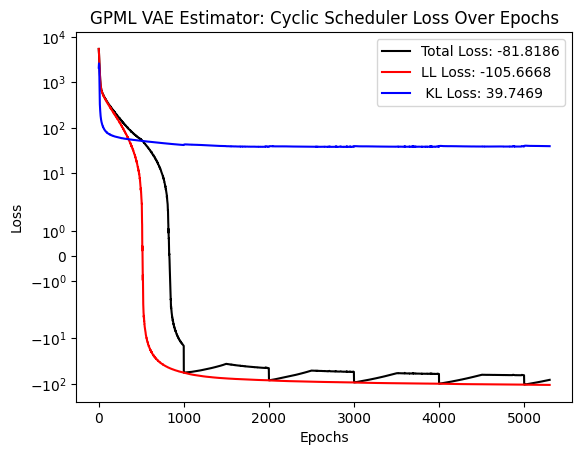

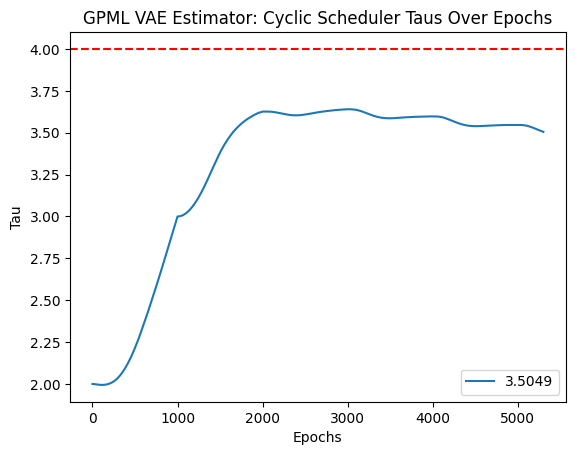

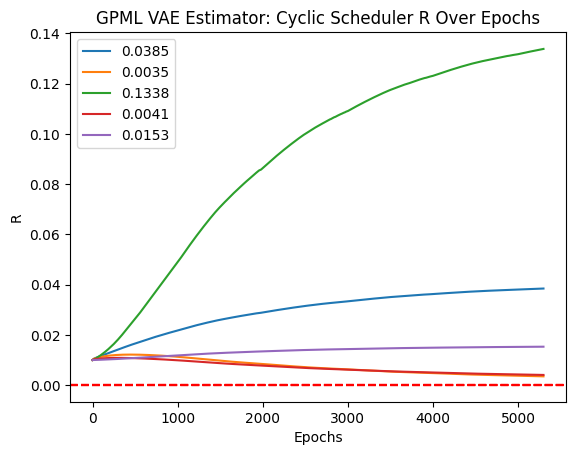

VAE Fit:  54%|█████▍    | 5400/10000 [1:02:17<51:18,  1.49it/s]

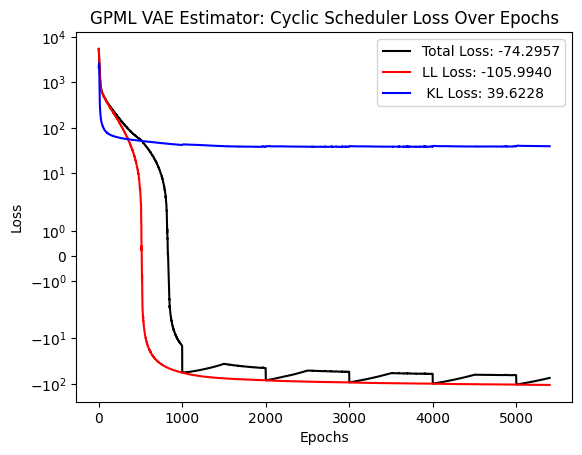

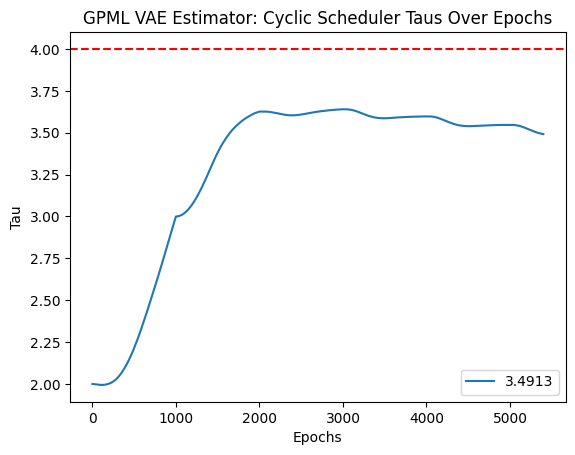

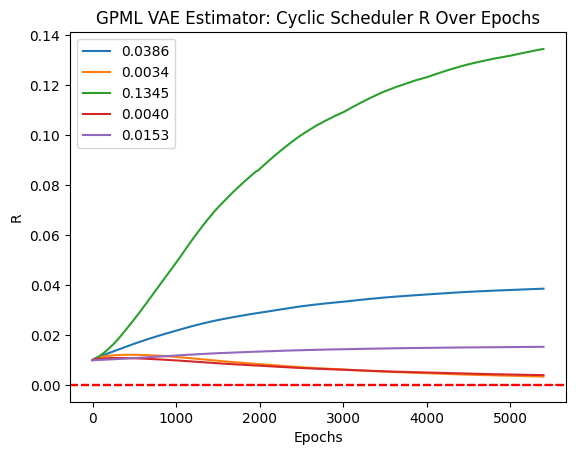

VAE Fit:  55%|█████▌    | 5500/10000 [1:03:29<50:46,  1.48it/s]

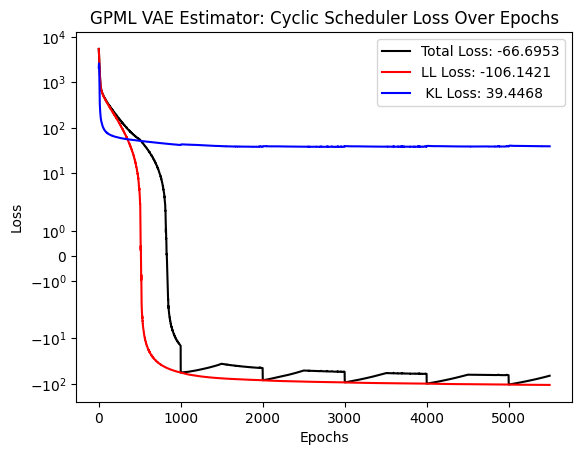

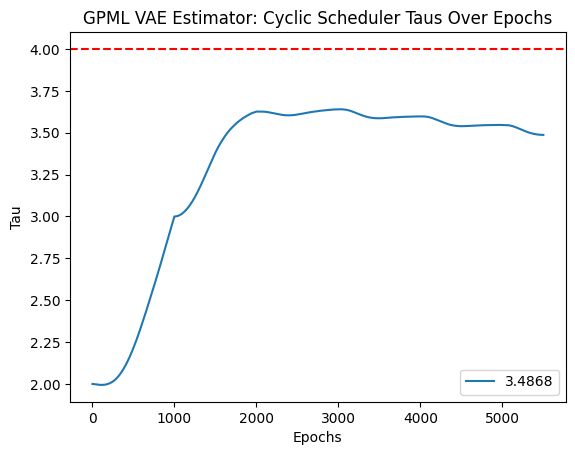

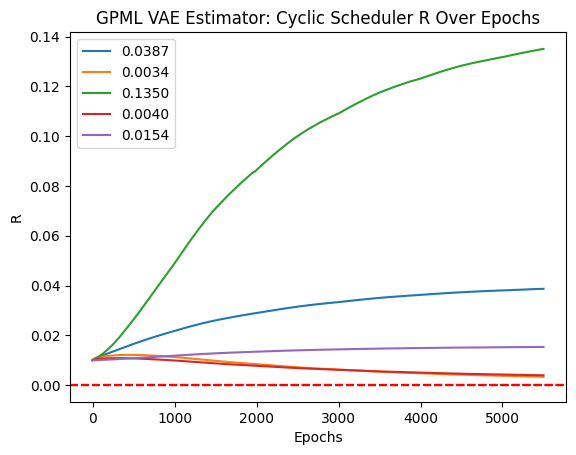

VAE Fit:  56%|█████▌    | 5600/10000 [1:04:40<49:37,  1.48it/s]

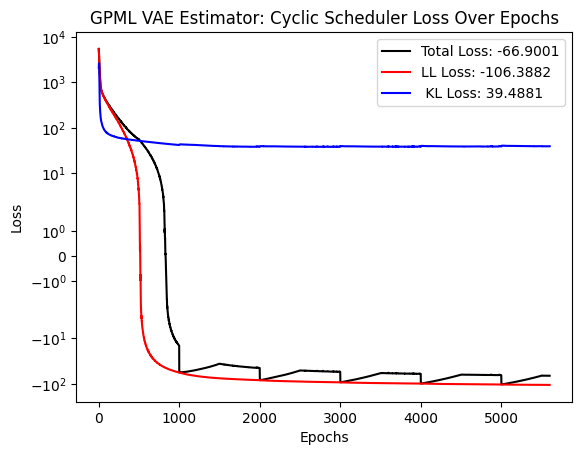

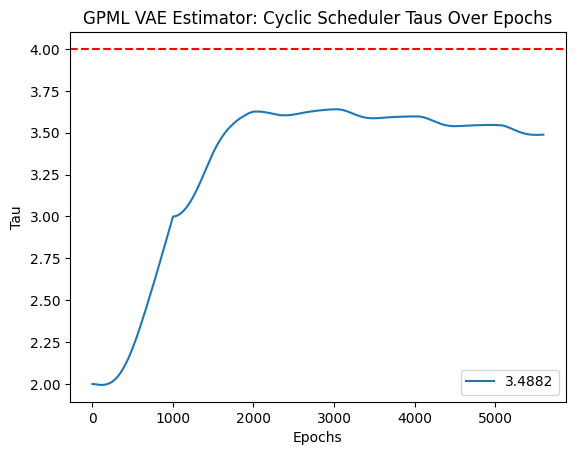

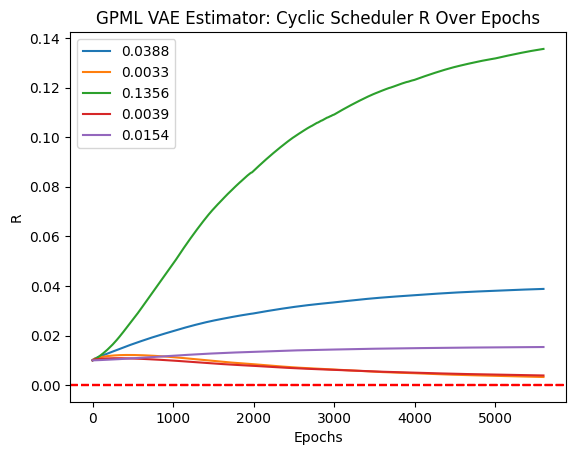

VAE Fit:  57%|█████▋    | 5700/10000 [1:05:52<48:44,  1.47it/s]

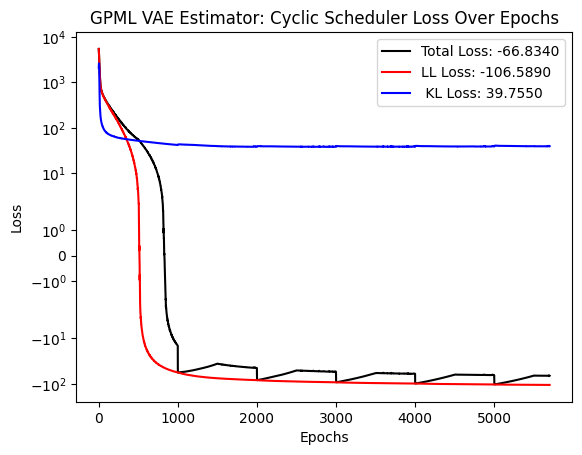

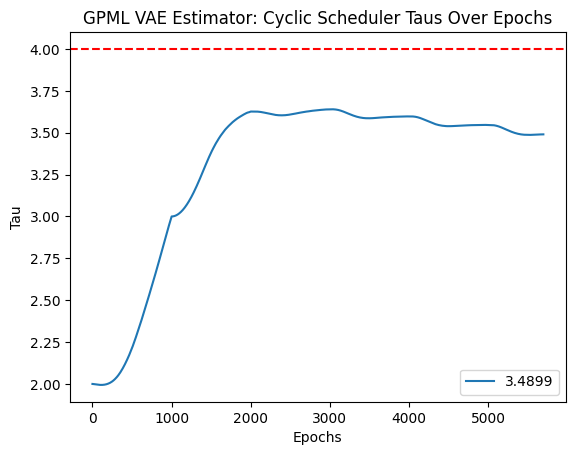

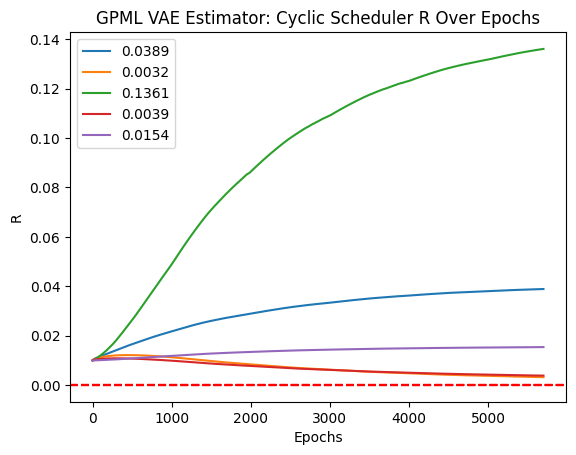

VAE Fit:  58%|█████▊    | 5800/10000 [1:07:04<49:06,  1.43it/s]

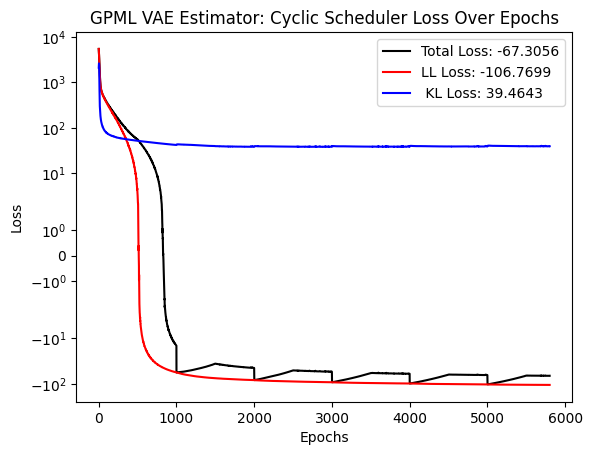

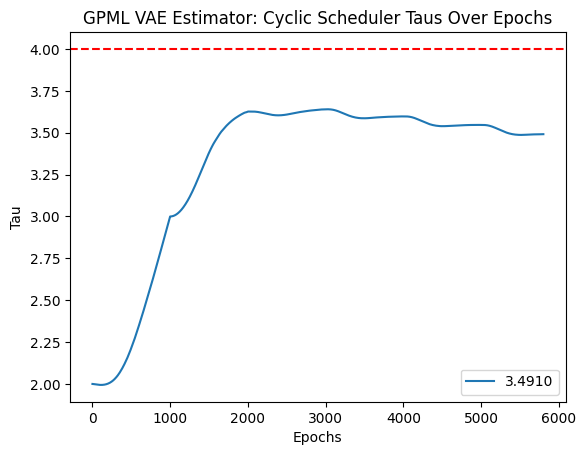

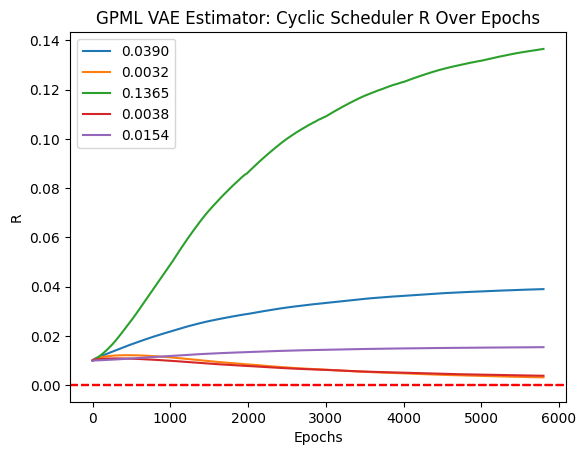

VAE Fit:  59%|█████▉    | 5900/10000 [1:08:15<50:35,  1.35it/s]

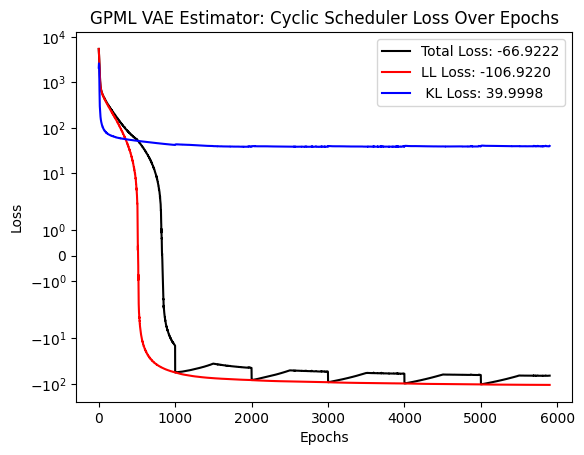

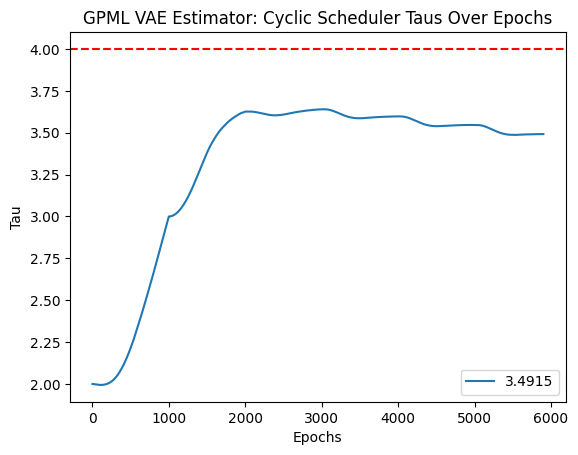

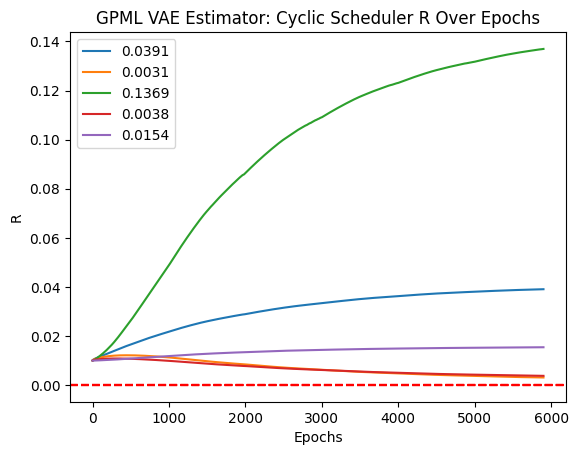

VAE Fit:  60%|██████    | 6000/10000 [1:09:27<51:05,  1.30it/s]

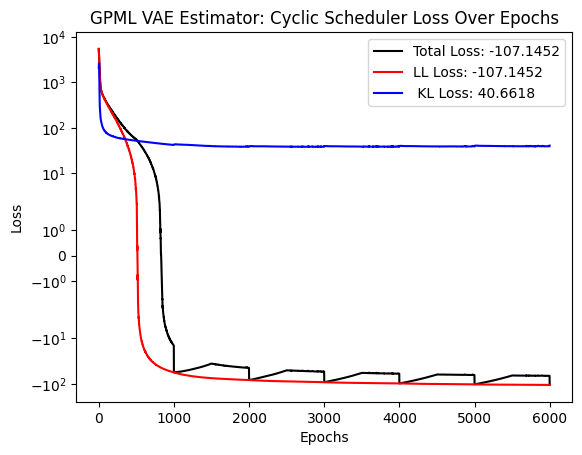

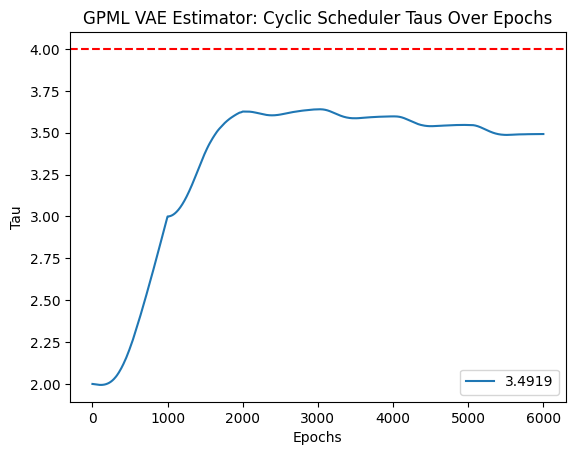

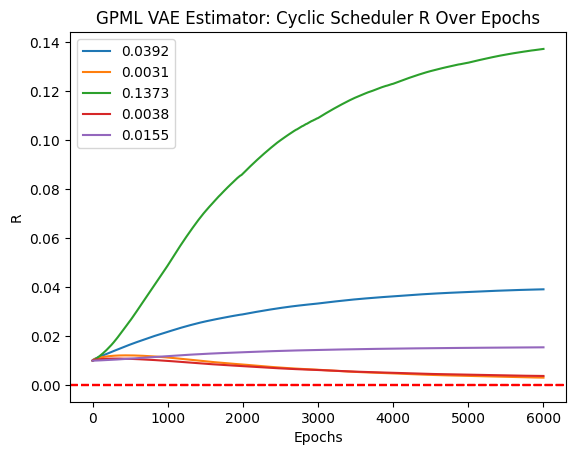

VAE Fit:  61%|██████    | 6100/10000 [1:10:39<53:27,  1.22it/s]

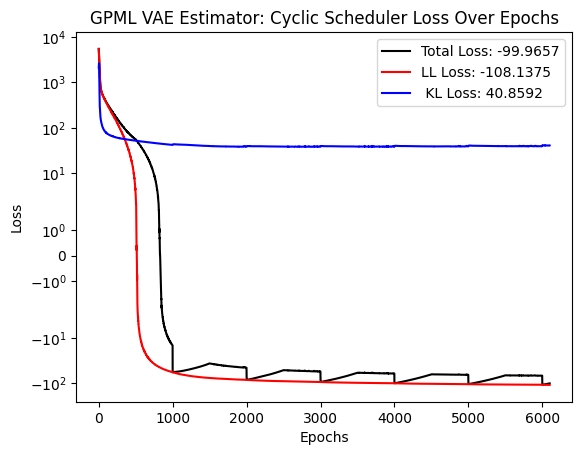

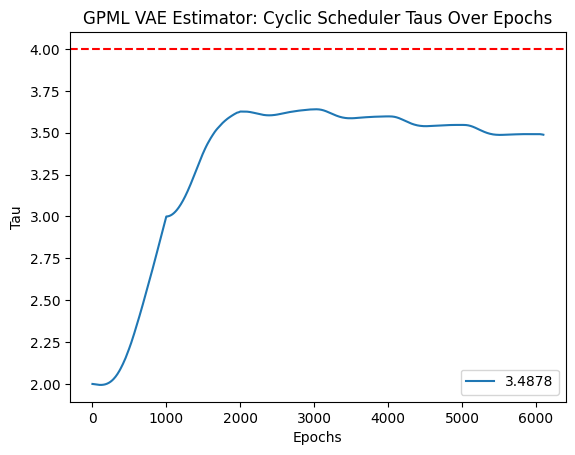

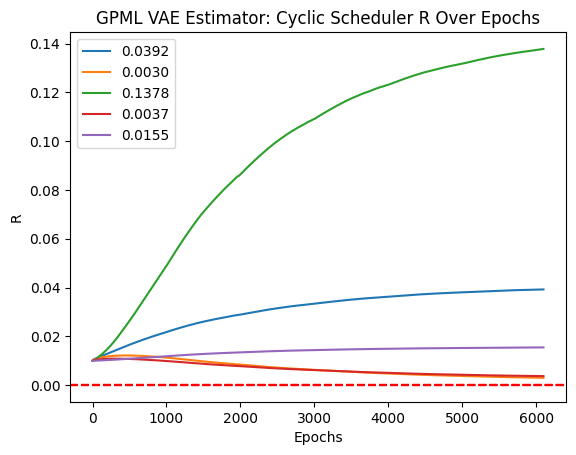

VAE Fit:  62%|██████▏   | 6200/10000 [1:11:50<47:14,  1.34it/s]

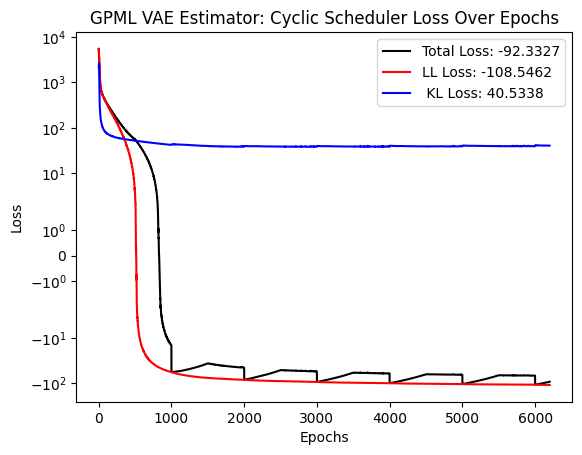

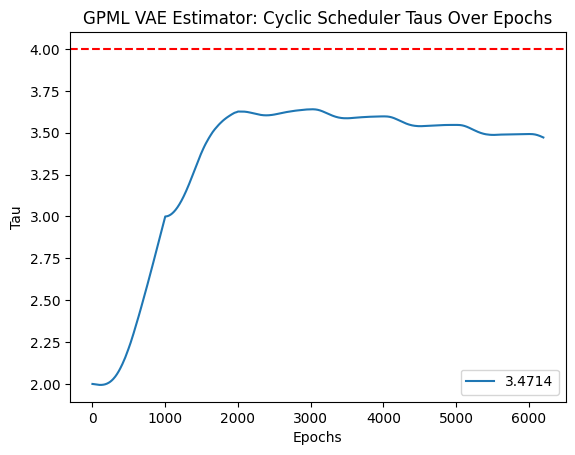

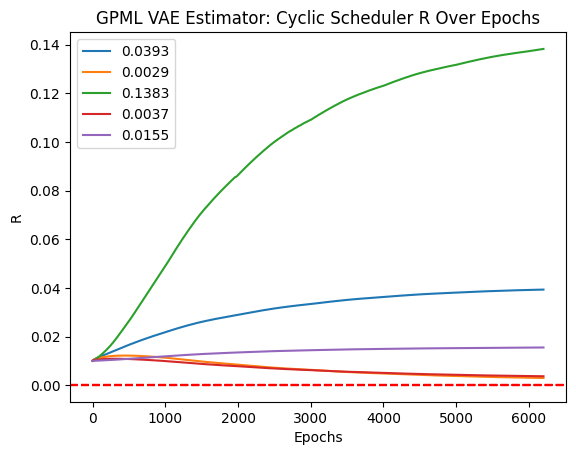

VAE Fit:  63%|██████▎   | 6300/10000 [1:13:05<52:52,  1.17it/s]

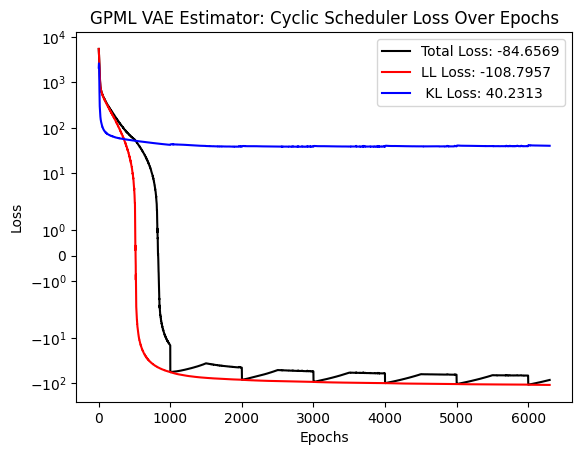

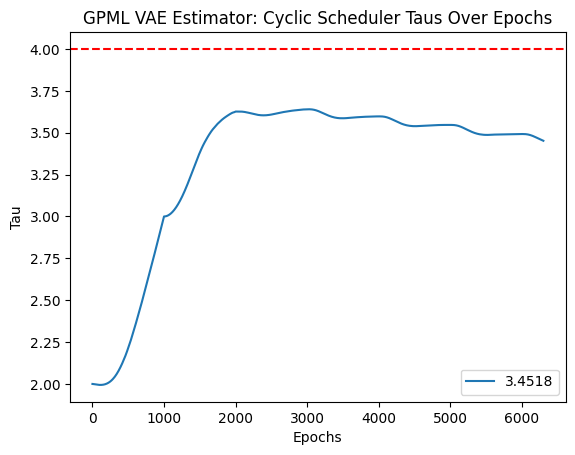

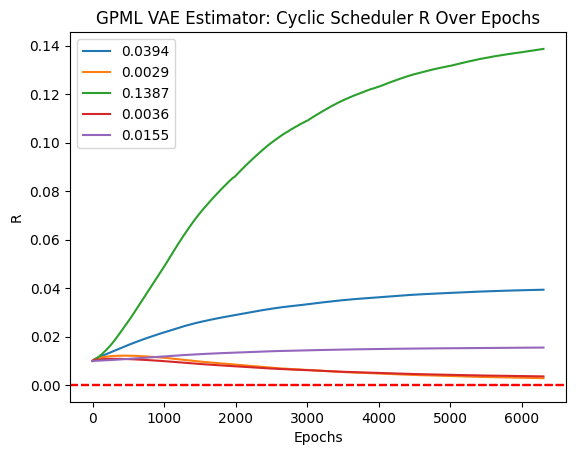

VAE Fit:  64%|██████▍   | 6400/10000 [1:14:18<50:57,  1.18it/s]

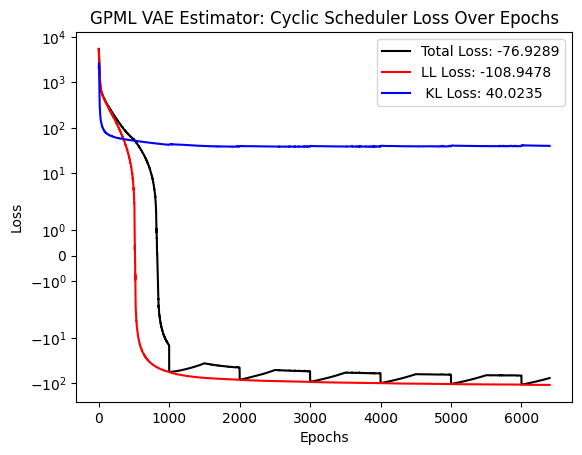

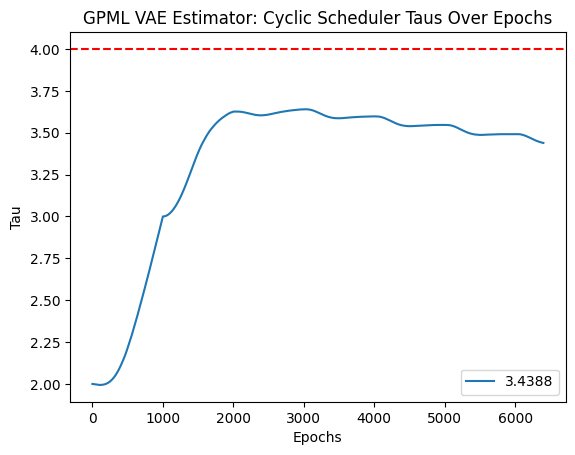

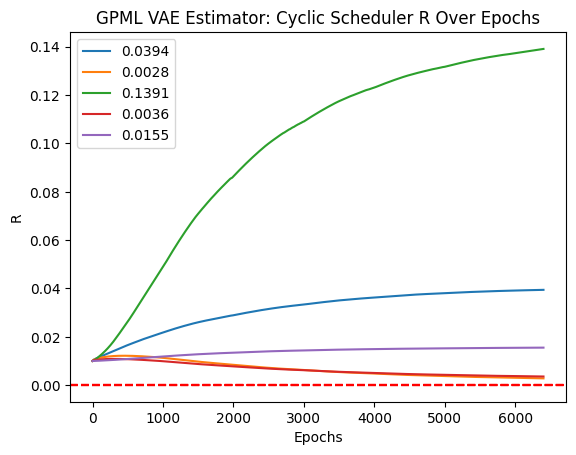

VAE Fit:  65%|██████▌   | 6500/10000 [1:15:30<46:04,  1.27it/s]

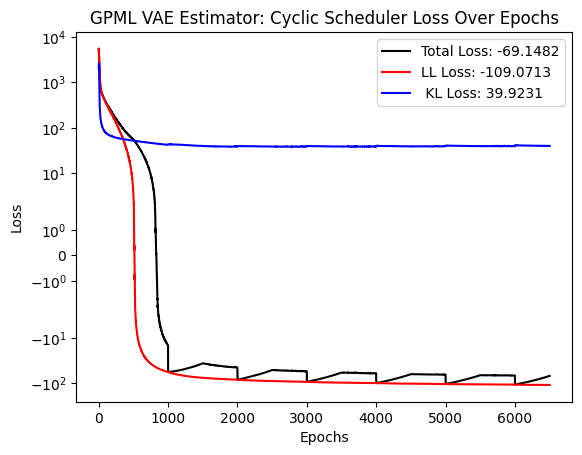

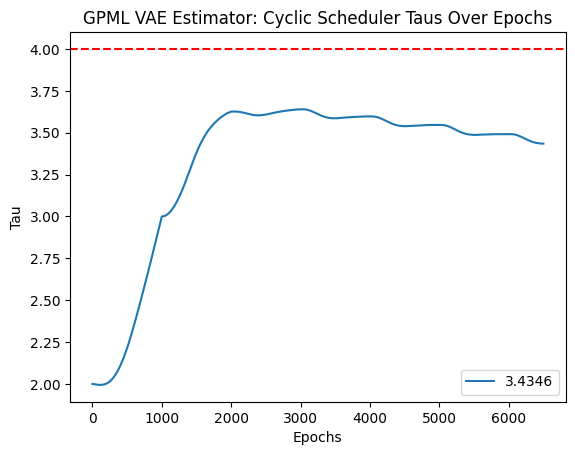

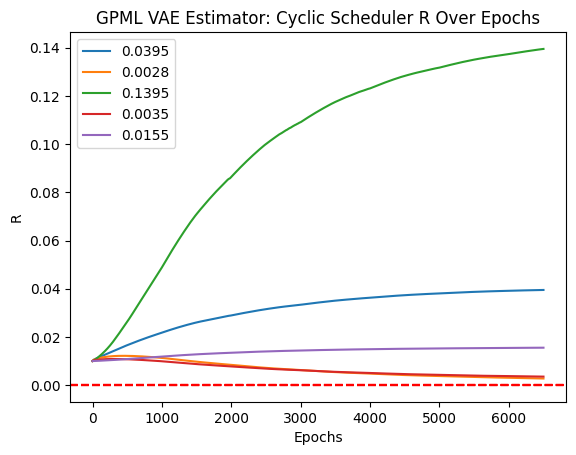

VAE Fit:  66%|██████▌   | 6600/10000 [1:16:44<45:38,  1.24it/s]

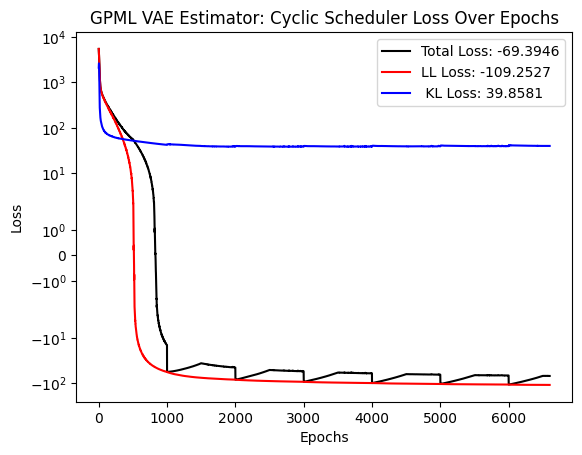

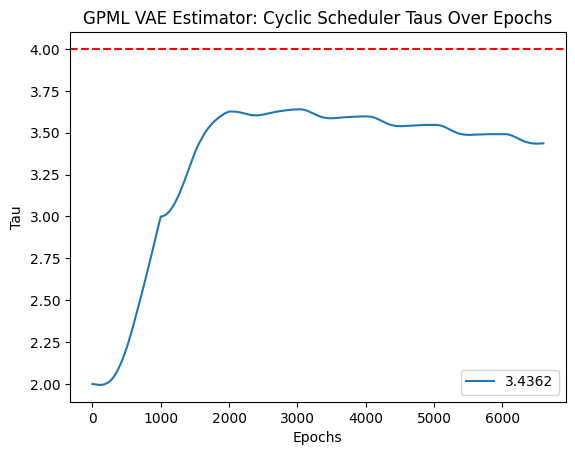

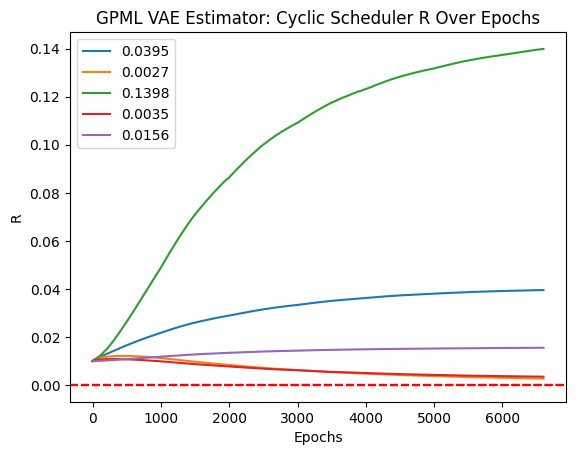

VAE Fit:  67%|██████▋   | 6700/10000 [1:17:57<42:08,  1.31it/s]

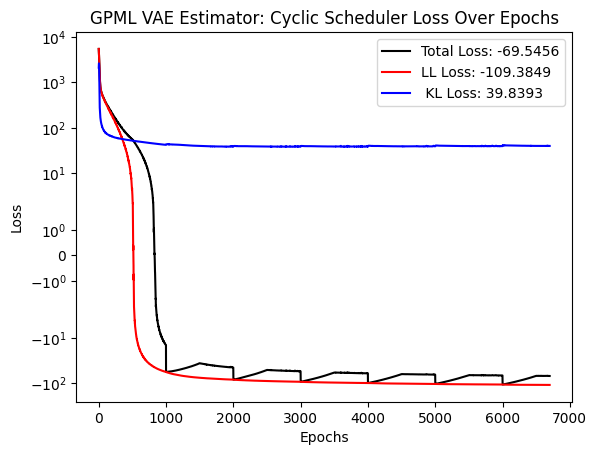

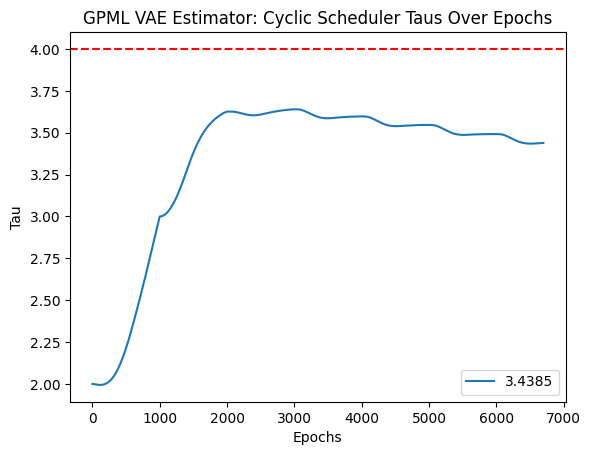

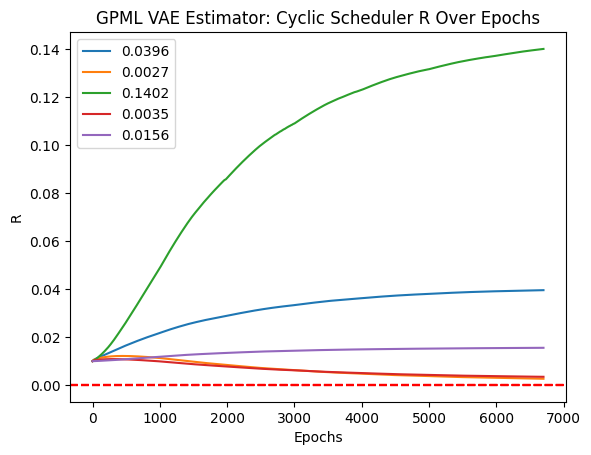

VAE Fit:  68%|██████▊   | 6800/10000 [1:19:12<39:11,  1.36it/s]

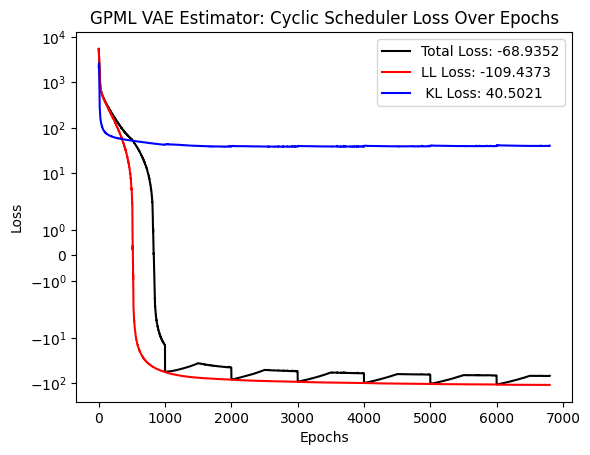

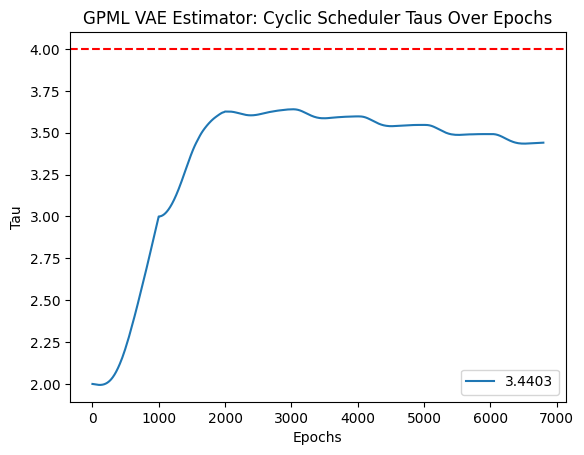

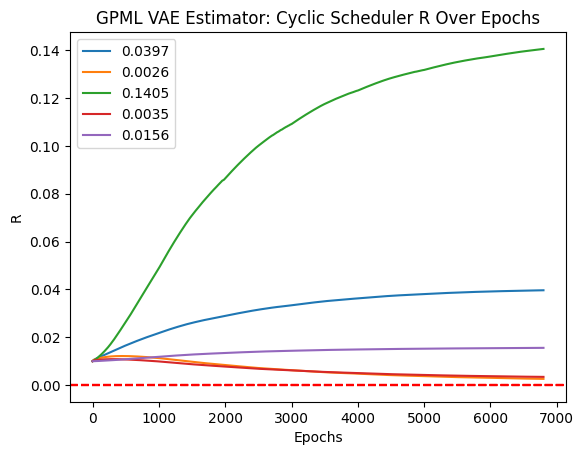

VAE Fit:  69%|██████▉   | 6900/10000 [1:20:28<36:41,  1.41it/s]

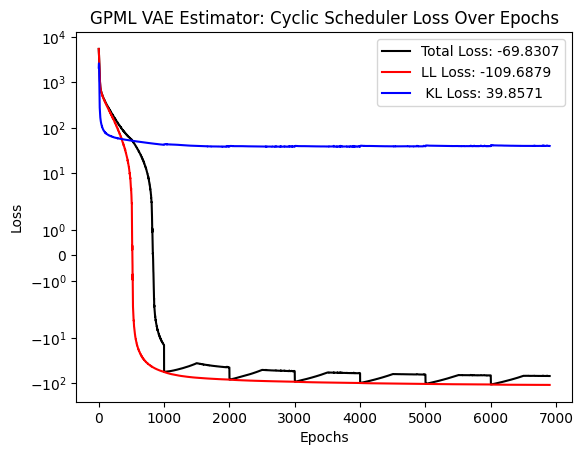

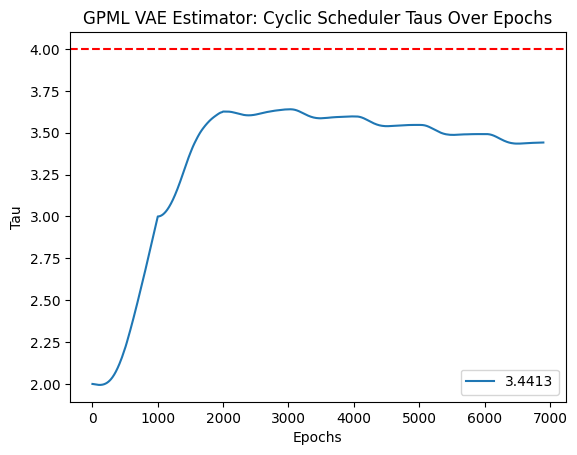

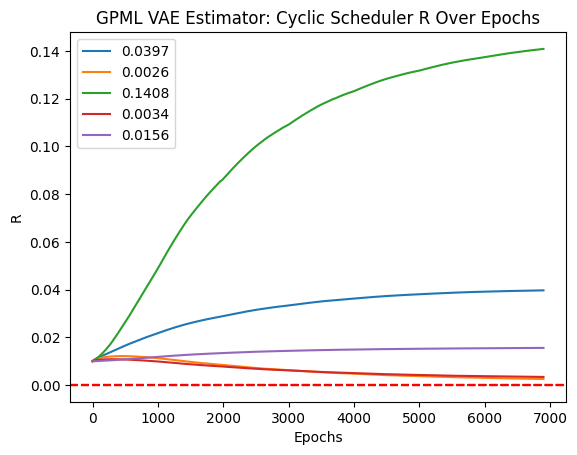

VAE Fit:  70%|███████   | 7000/10000 [1:21:42<33:48,  1.48it/s]

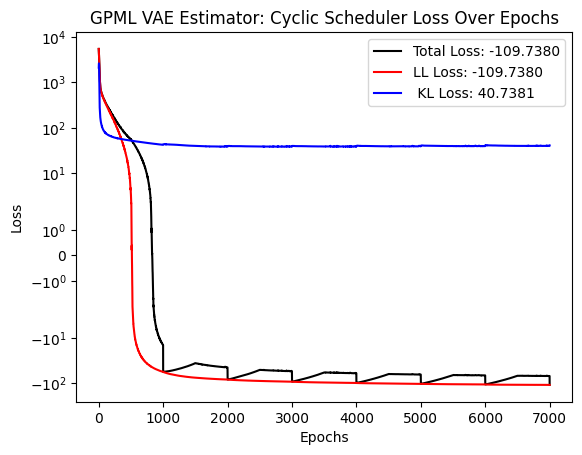

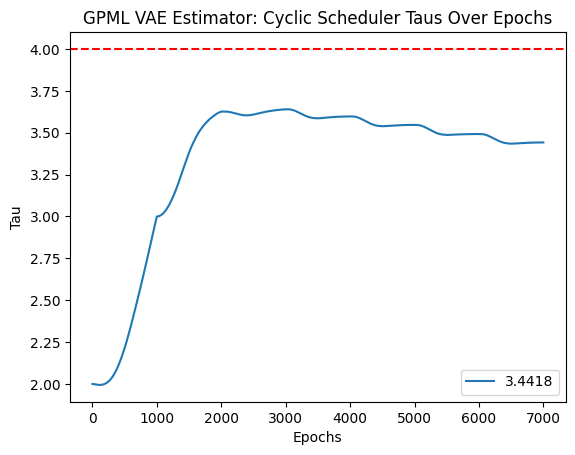

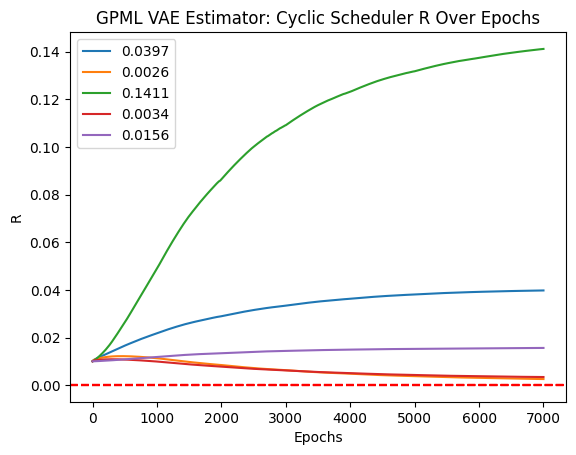

VAE Fit:  71%|███████   | 7100/10000 [1:22:55<33:06,  1.46it/s]

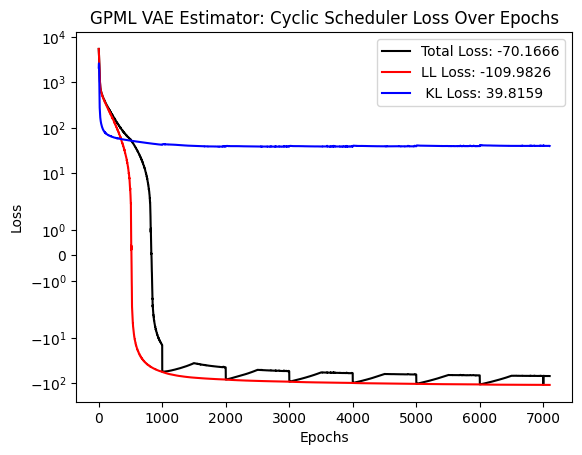

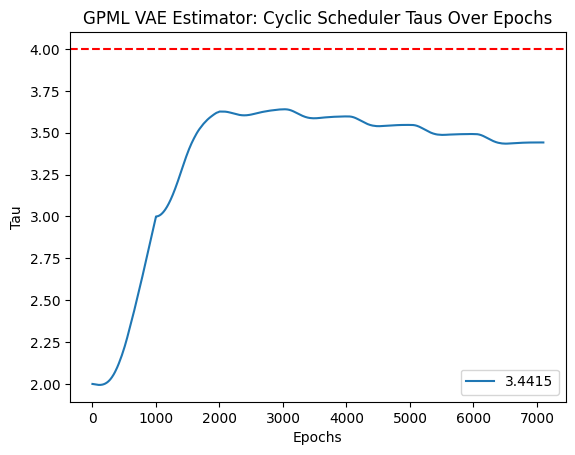

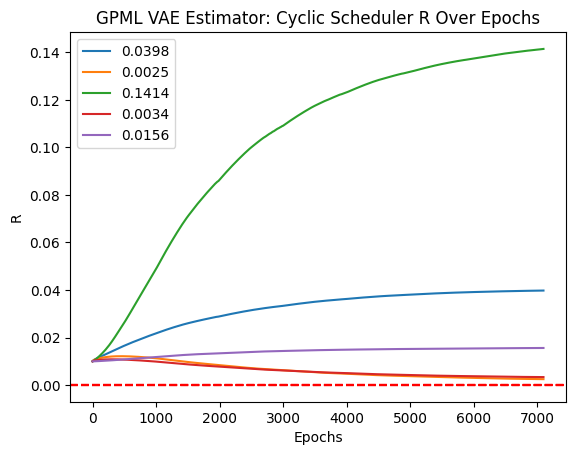

VAE Fit:  72%|███████▏  | 7200/10000 [1:24:09<32:17,  1.44it/s]

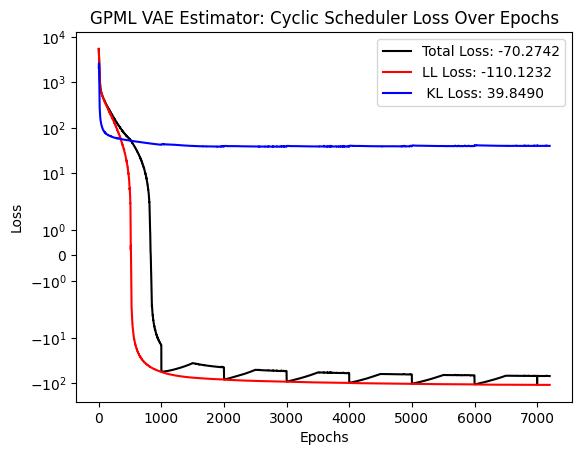

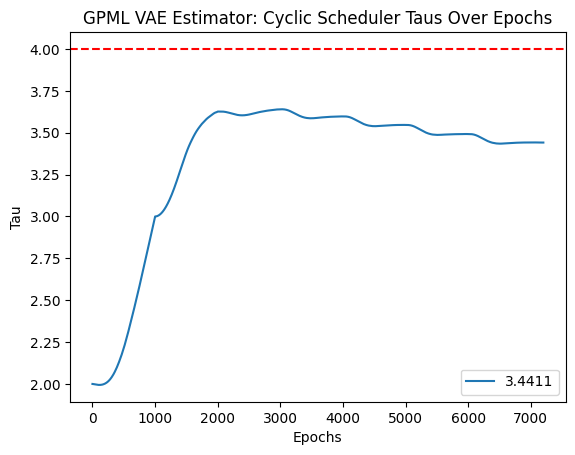

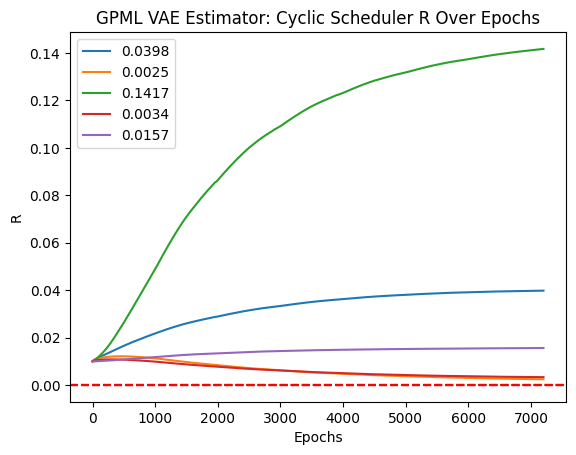

VAE Fit:  73%|███████▎  | 7300/10000 [1:25:22<31:06,  1.45it/s]

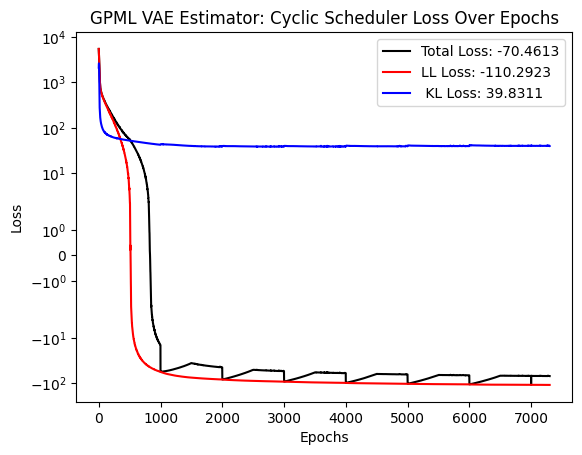

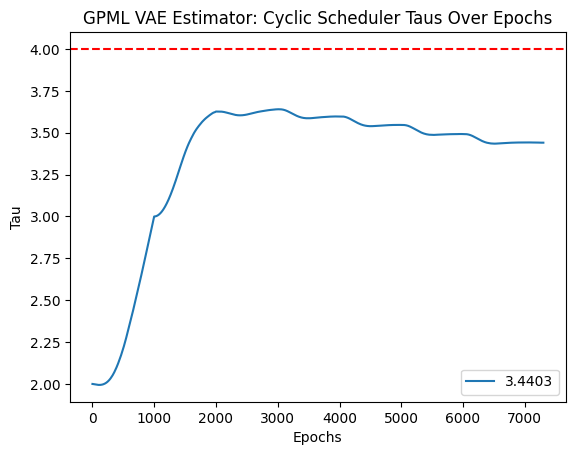

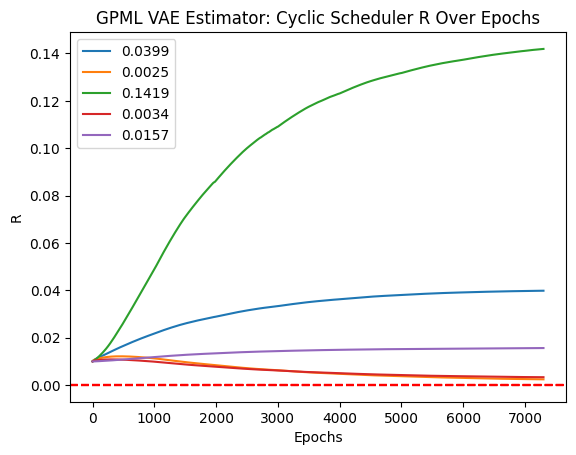

VAE Fit:  74%|███████▍  | 7400/10000 [1:26:35<31:25,  1.38it/s]

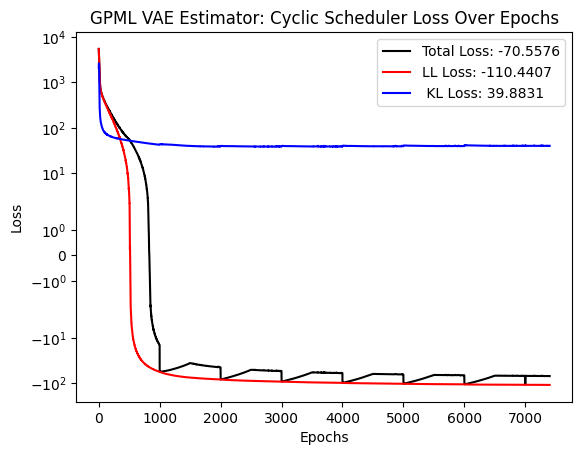

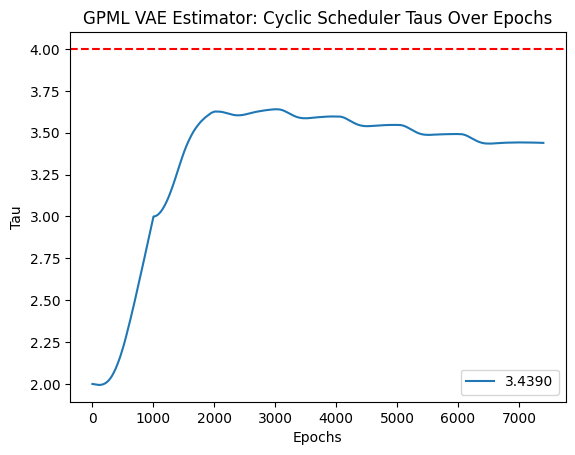

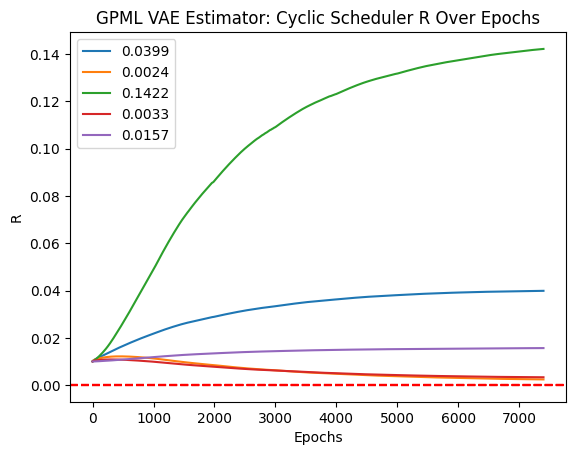

VAE Fit:  75%|███████▌  | 7500/10000 [1:27:47<28:42,  1.45it/s]

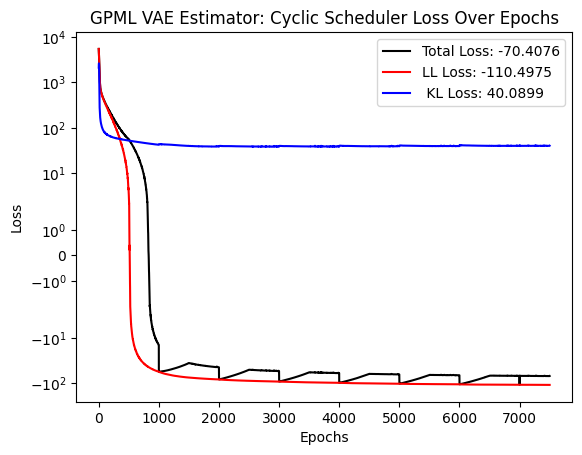

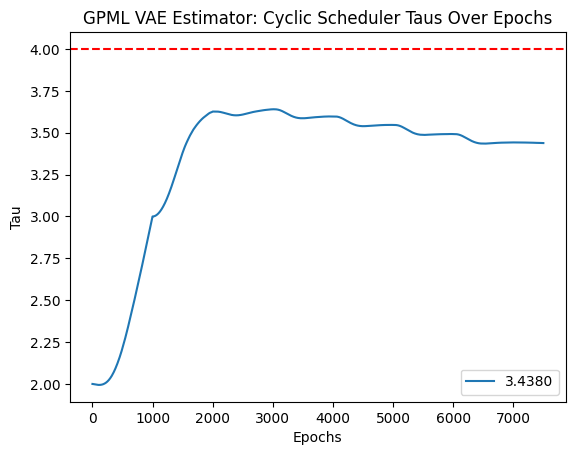

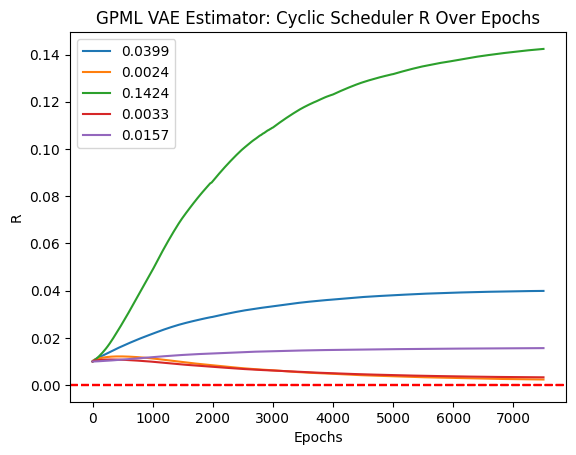

VAE Fit:  76%|███████▌  | 7600/10000 [1:28:59<27:50,  1.44it/s]

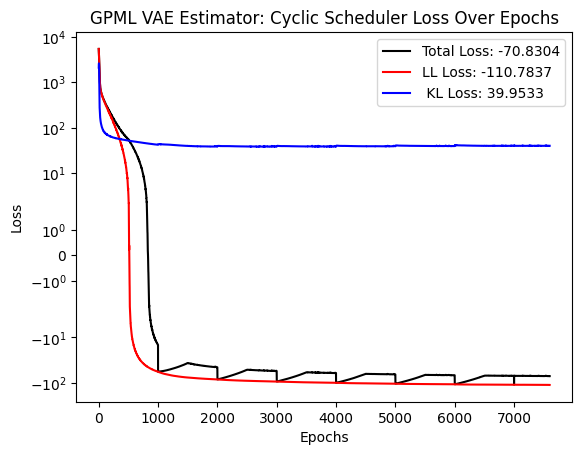

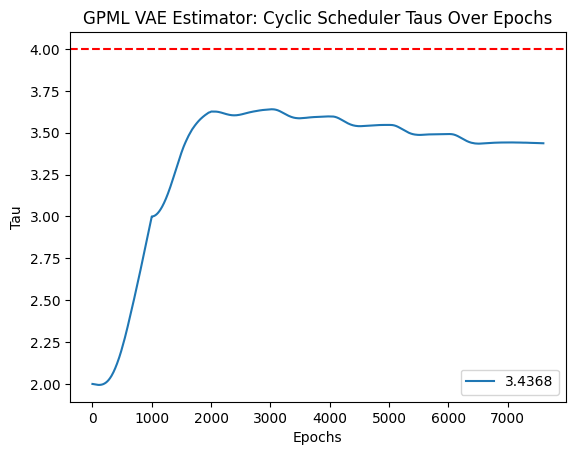

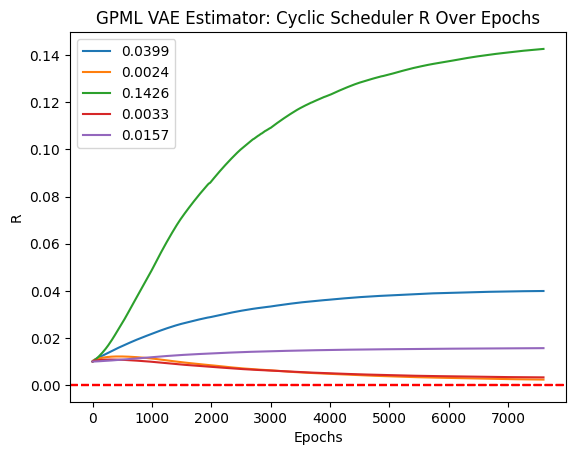

VAE Fit:  77%|███████▋  | 7700/10000 [1:30:12<28:09,  1.36it/s]

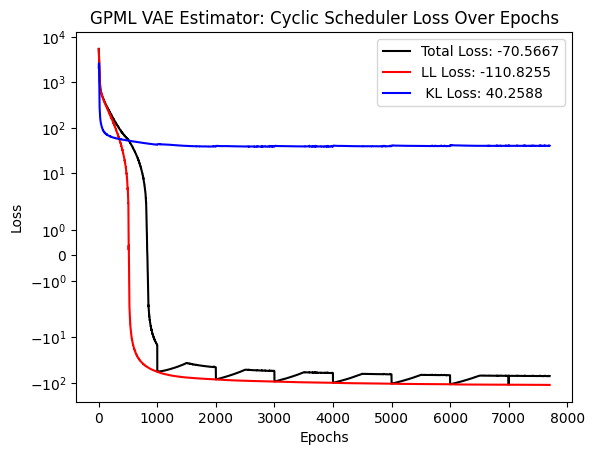

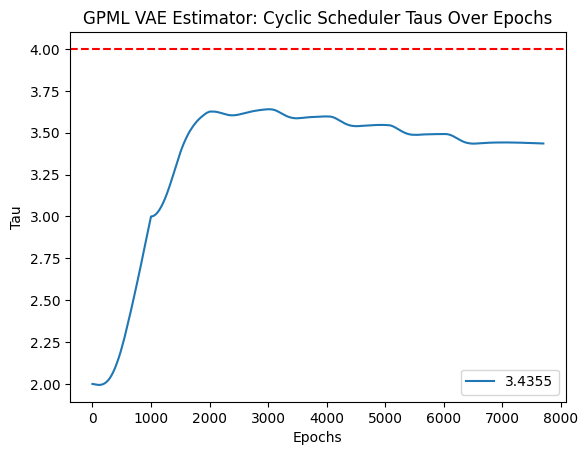

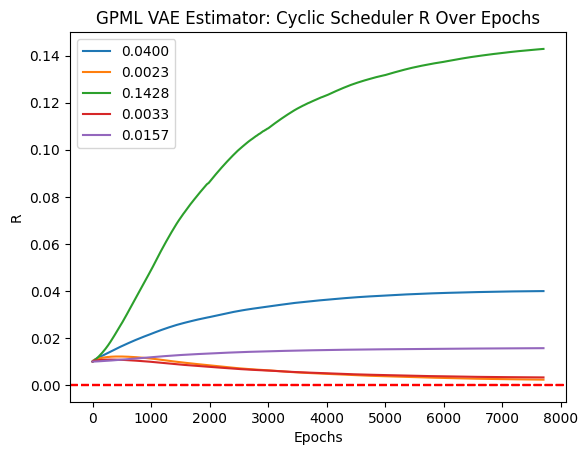

VAE Fit:  78%|███████▊  | 7800/10000 [1:31:24<28:31,  1.29it/s]

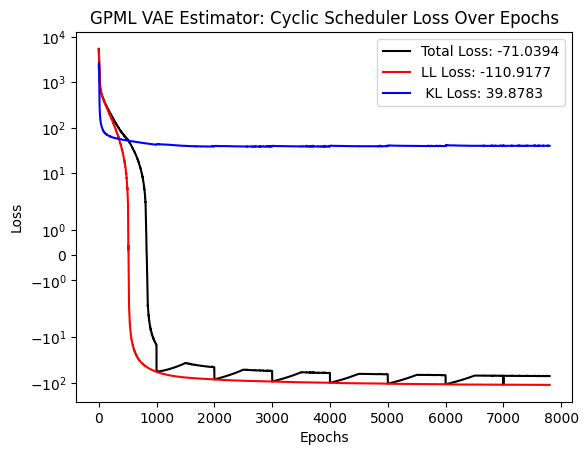

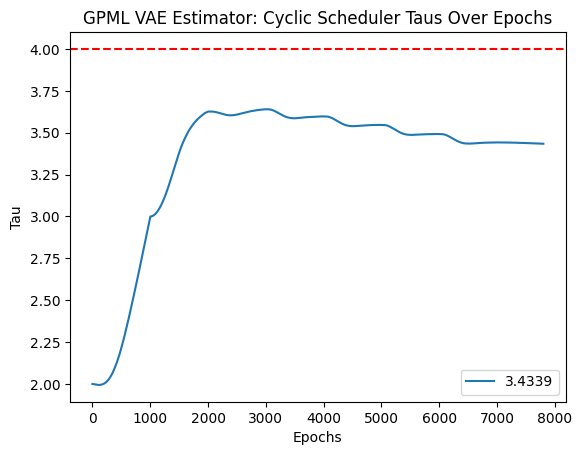

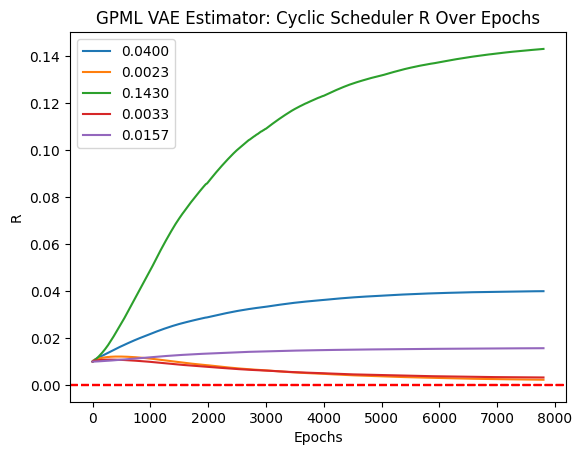

VAE Fit:  79%|███████▉  | 7900/10000 [1:32:37<28:25,  1.23it/s]

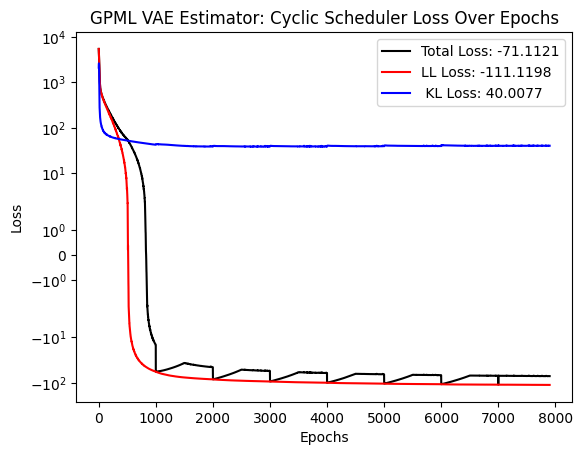

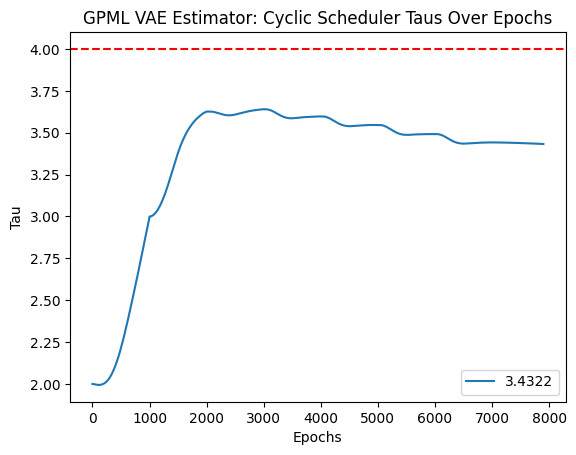

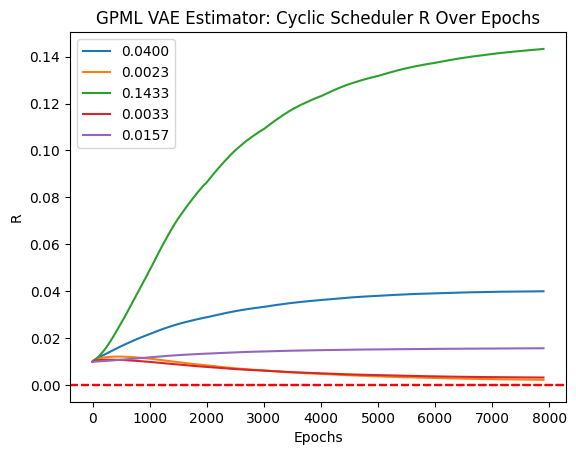

VAE Fit:  80%|████████  | 8000/10000 [1:33:52<25:49,  1.29it/s]

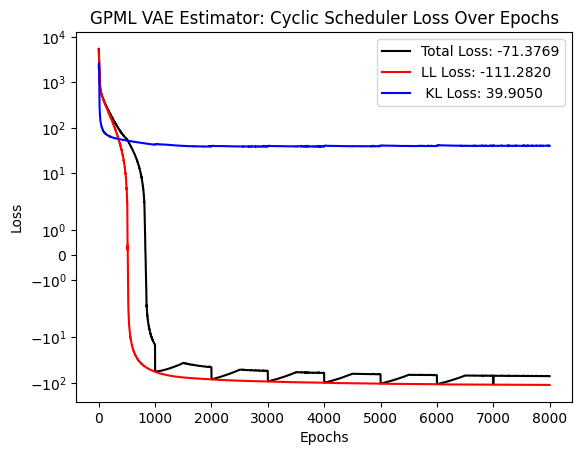

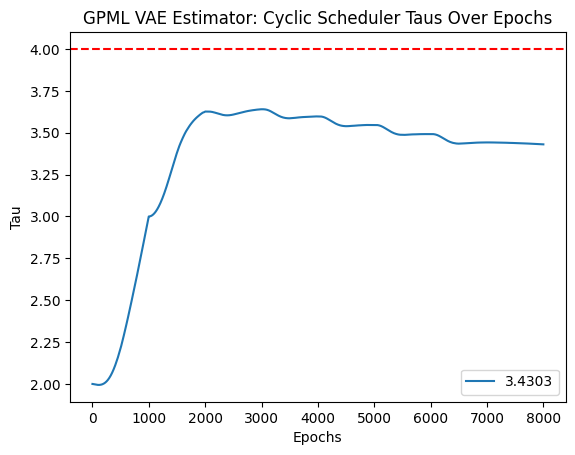

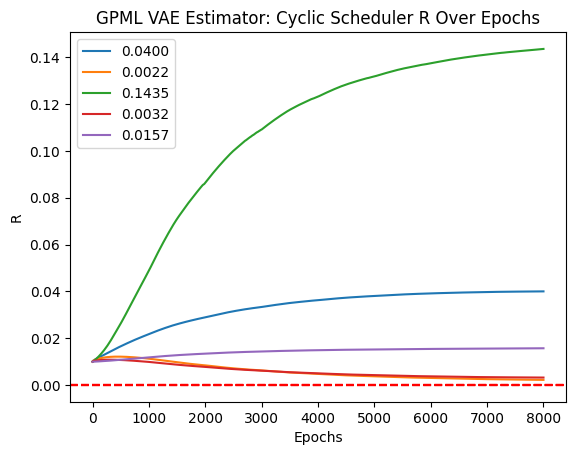

VAE Fit:  81%|████████  | 8100/10000 [1:35:08<23:18,  1.36it/s]

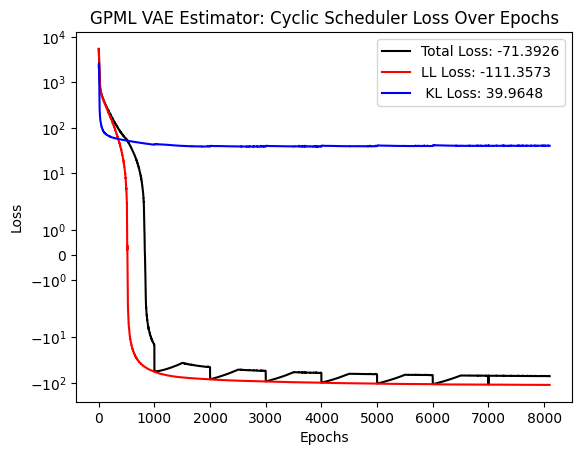

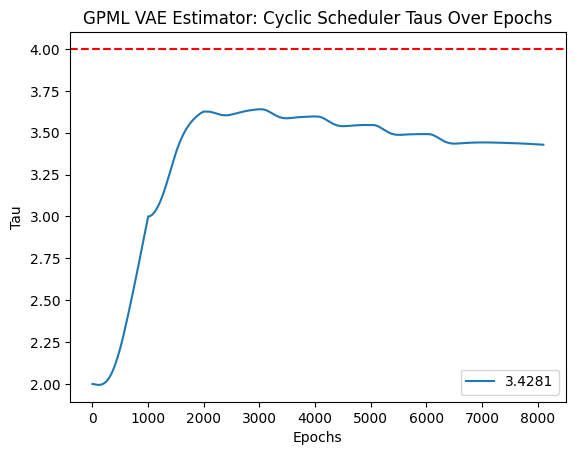

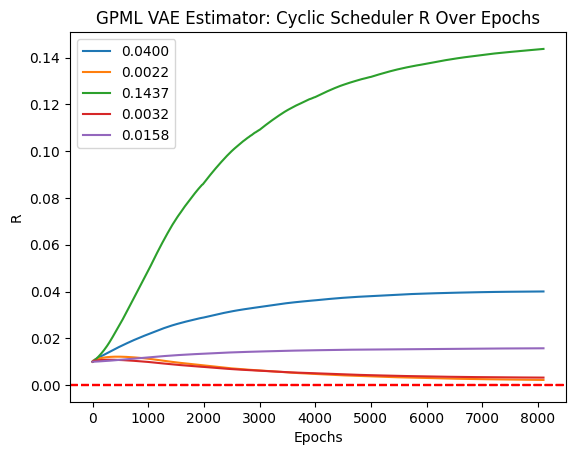

VAE Fit:  82%|████████▏ | 8200/10000 [1:36:22<21:18,  1.41it/s]

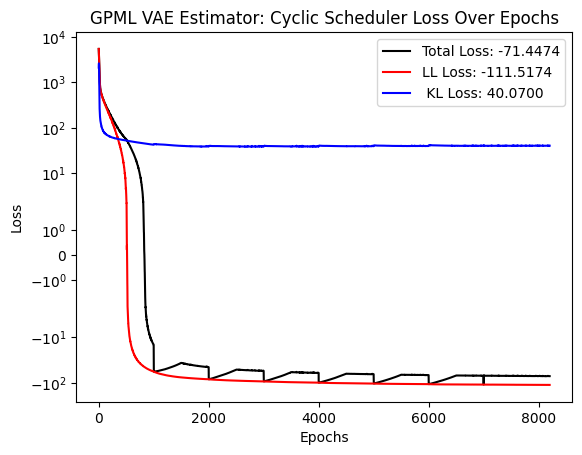

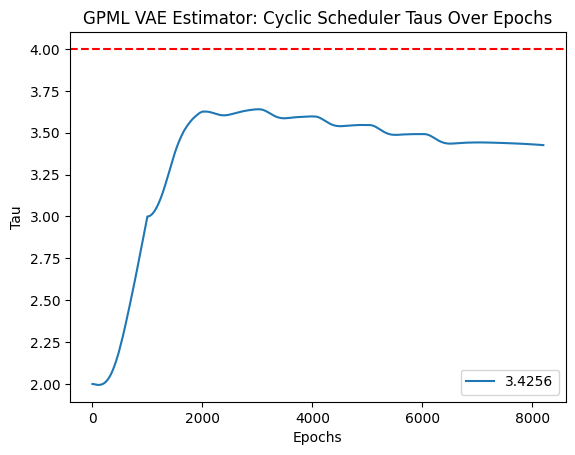

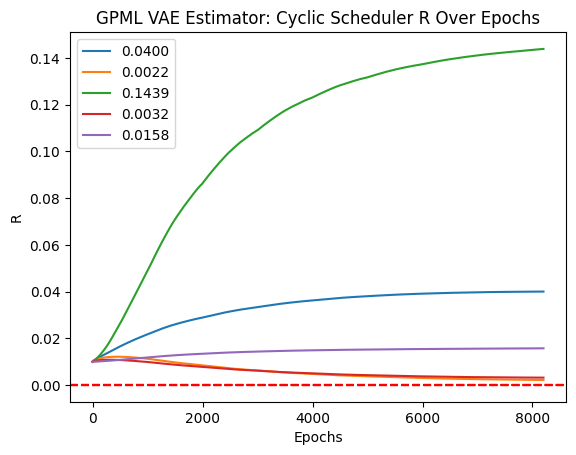

VAE Fit:  83%|████████▎ | 8300/10000 [1:37:36<19:57,  1.42it/s]

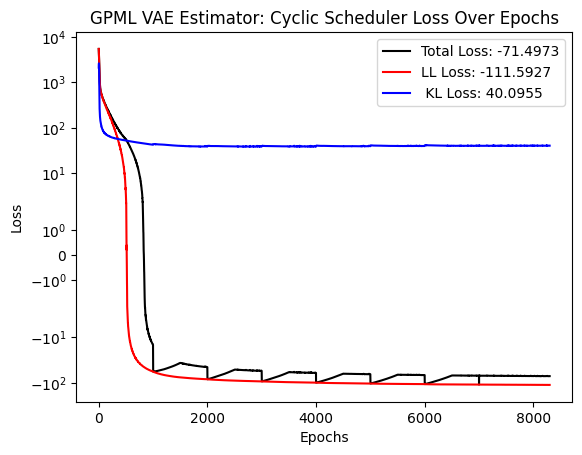

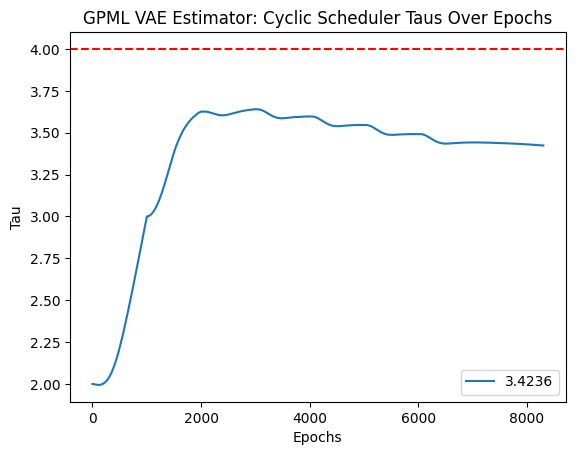

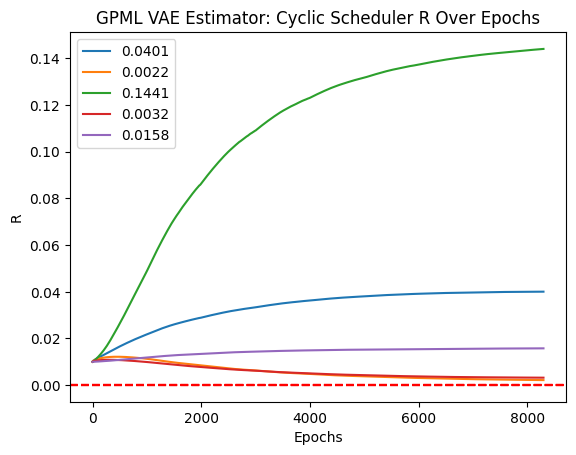

VAE Fit:  84%|████████▍ | 8400/10000 [1:38:50<19:02,  1.40it/s]

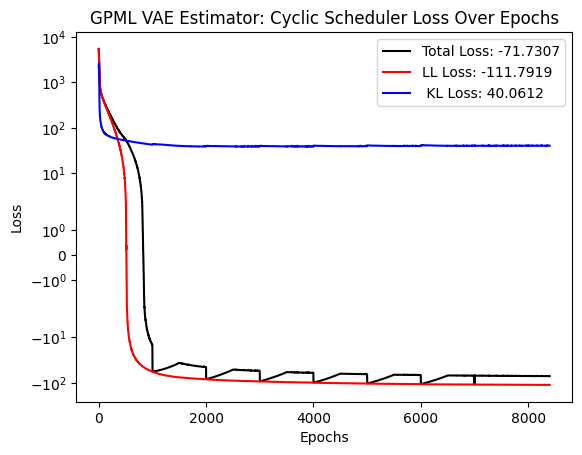

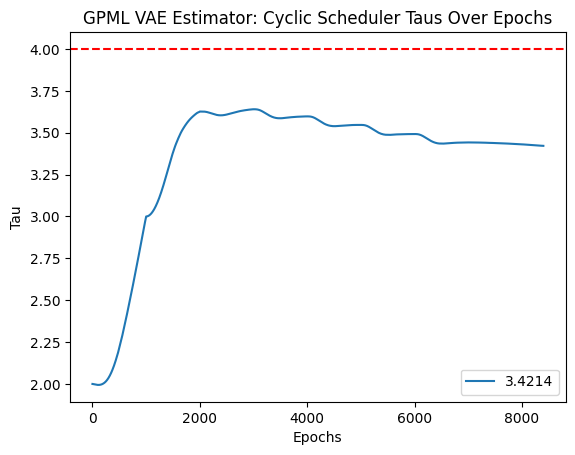

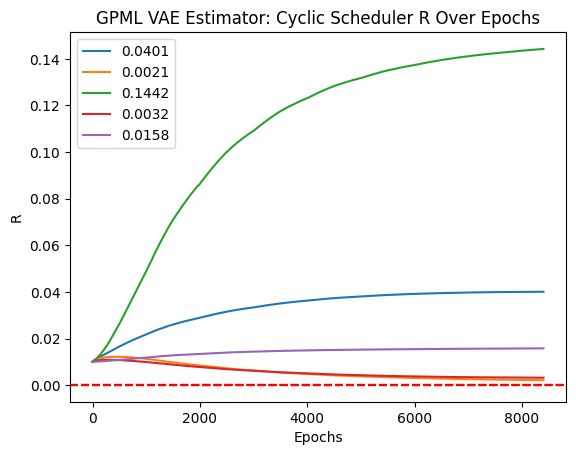

VAE Fit:  85%|████████▌ | 8500/10000 [1:40:05<17:29,  1.43it/s]

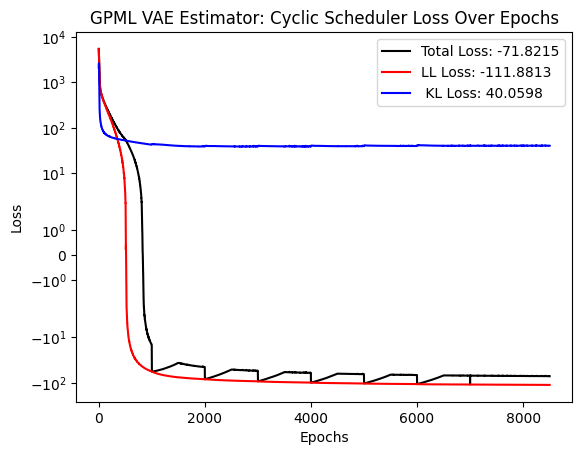

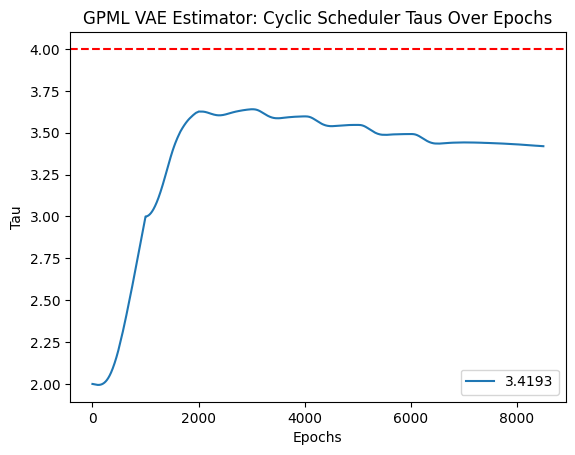

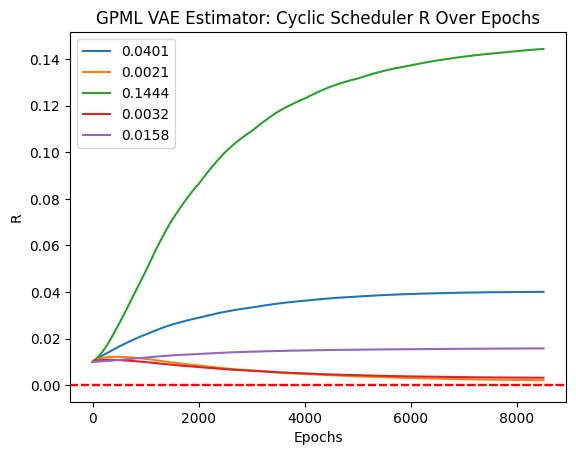

VAE Fit:  86%|████████▌ | 8600/10000 [1:41:20<16:42,  1.40it/s]

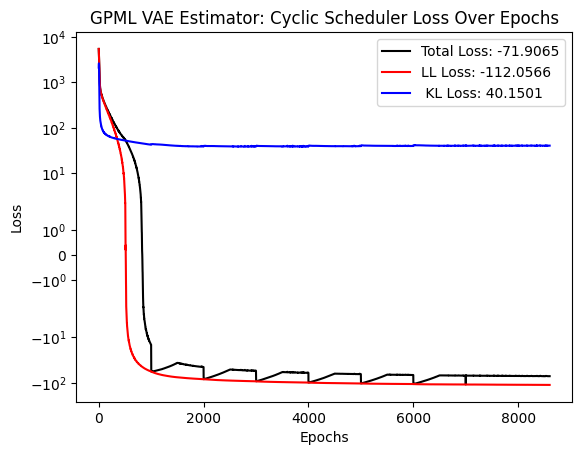

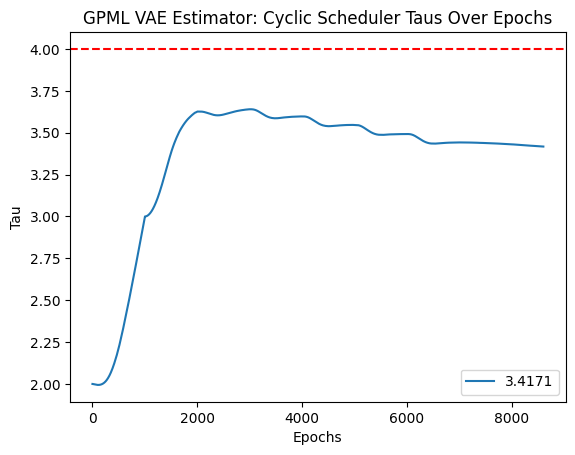

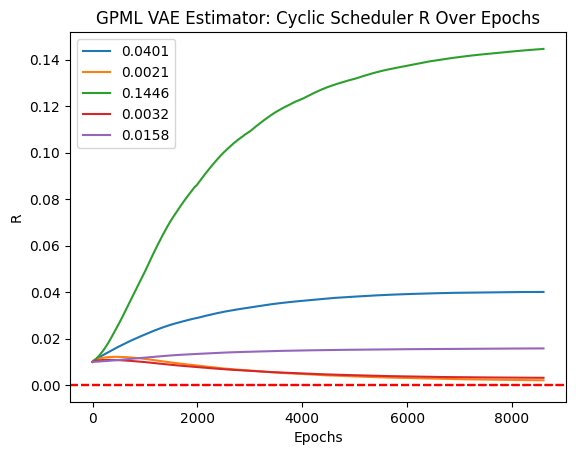

VAE Fit:  87%|████████▋ | 8700/10000 [1:42:35<15:00,  1.44it/s]

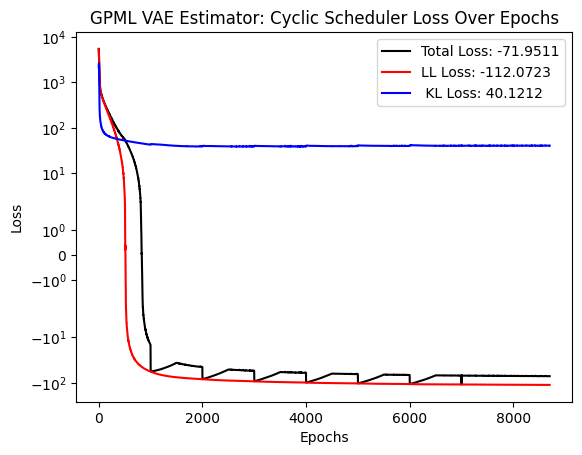

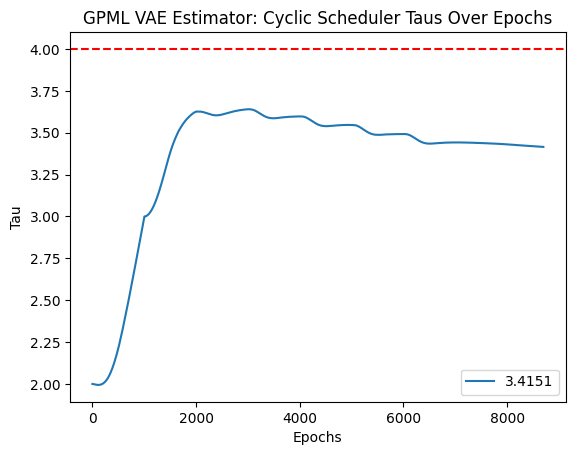

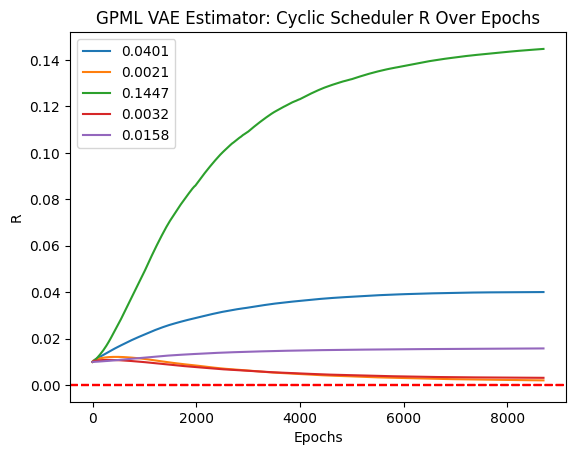

VAE Fit:  88%|████████▊ | 8800/10000 [1:43:51<14:13,  1.41it/s]

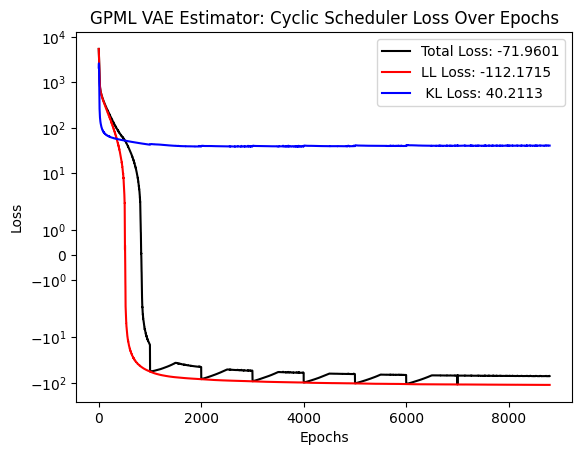

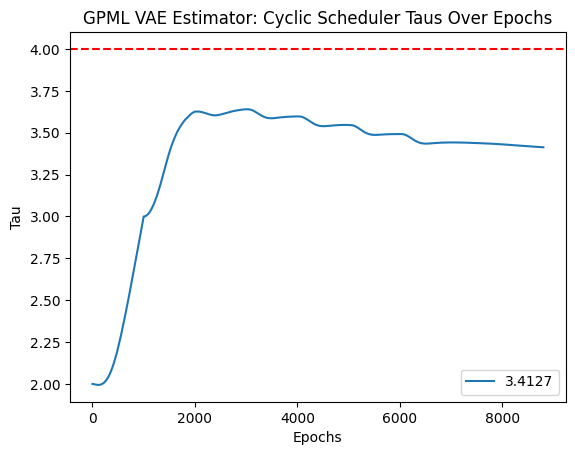

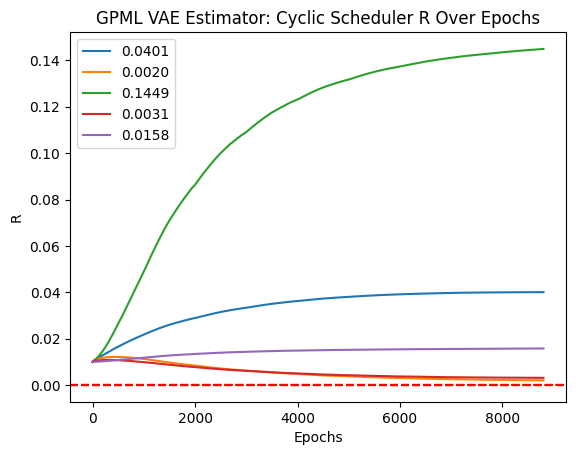

VAE Fit:  89%|████████▉ | 8900/10000 [1:45:05<14:32,  1.26it/s]

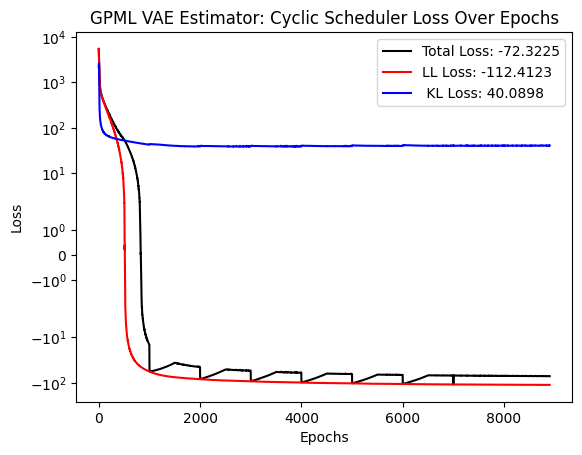

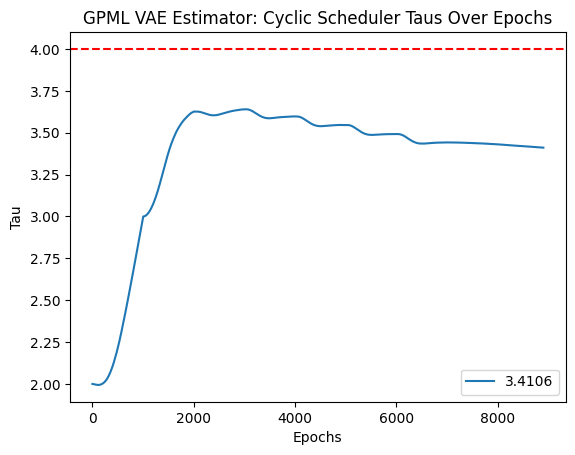

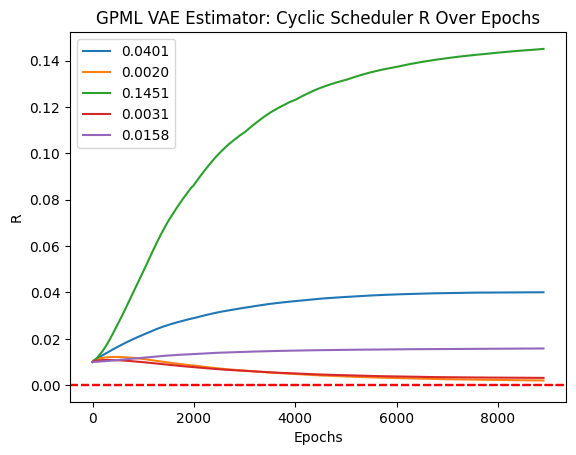

VAE Fit:  90%|█████████ | 9000/10000 [1:46:21<13:01,  1.28it/s]

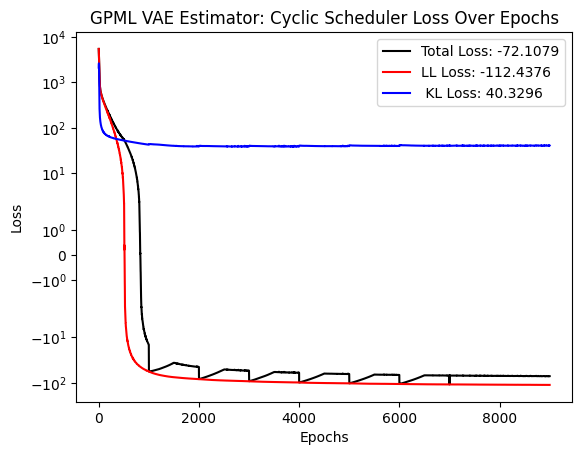

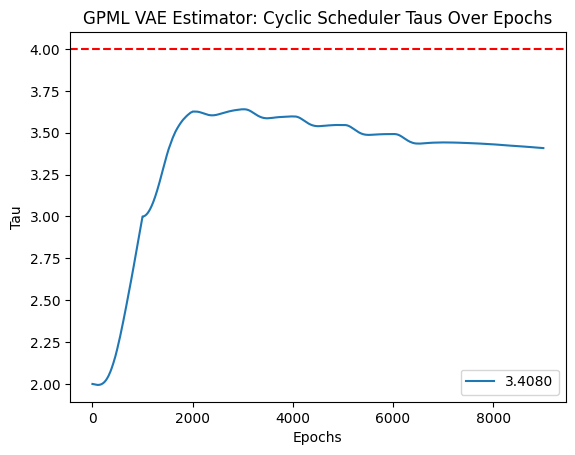

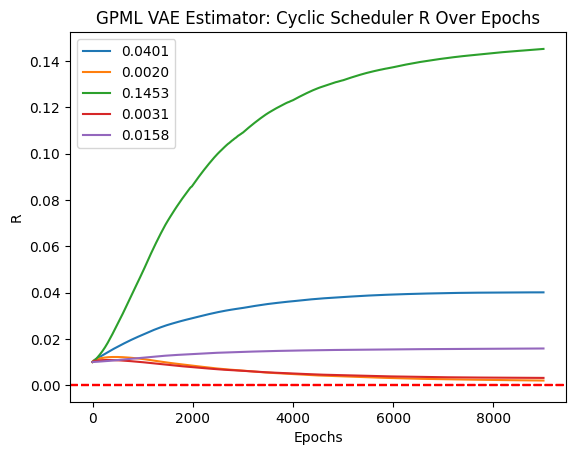

VAE Fit:  91%|█████████ | 9100/10000 [1:47:37<10:53,  1.38it/s]

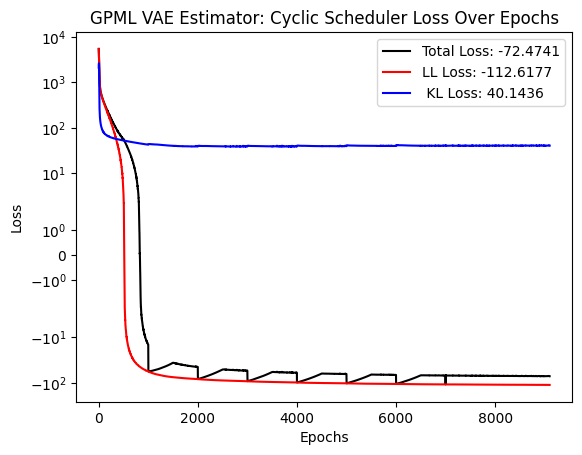

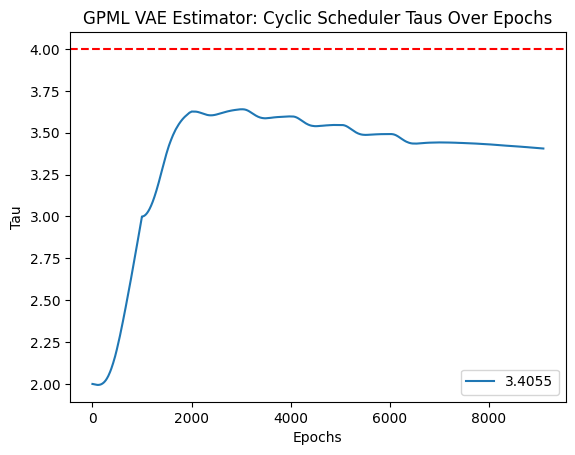

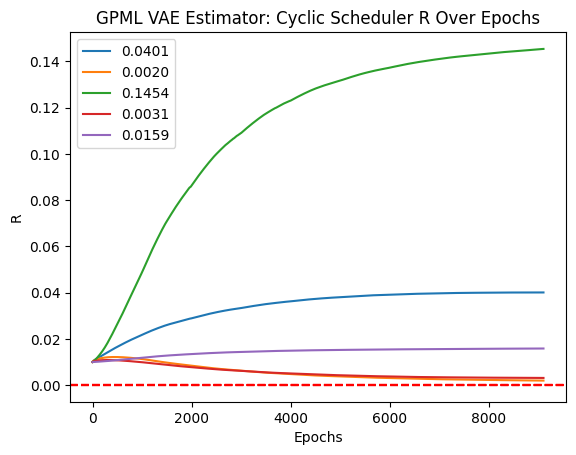

VAE Fit:  92%|█████████▏| 9200/10000 [1:48:52<09:29,  1.40it/s]

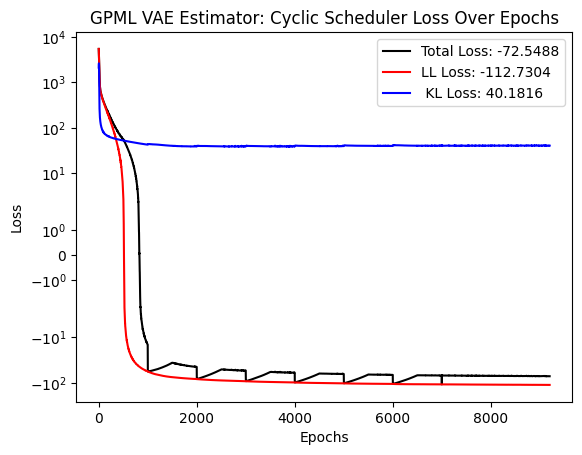

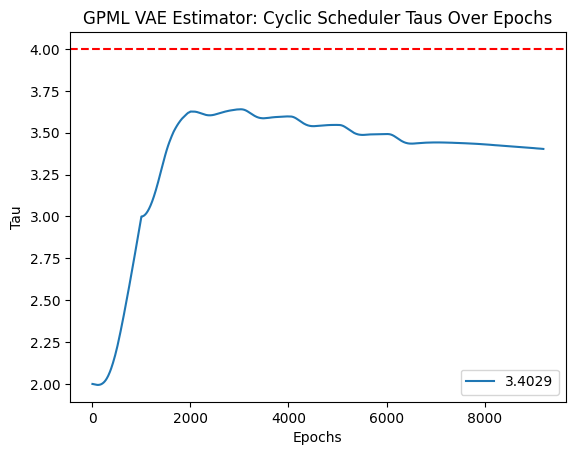

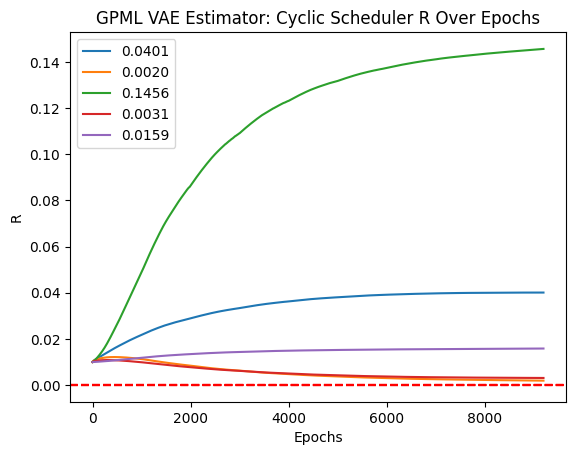

VAE Fit:  93%|█████████▎| 9300/10000 [1:50:07<08:26,  1.38it/s]

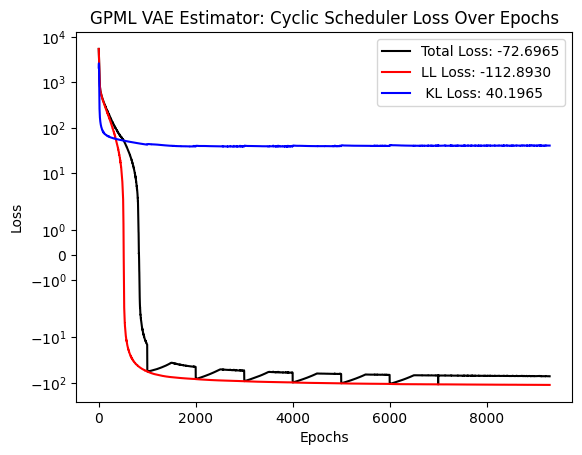

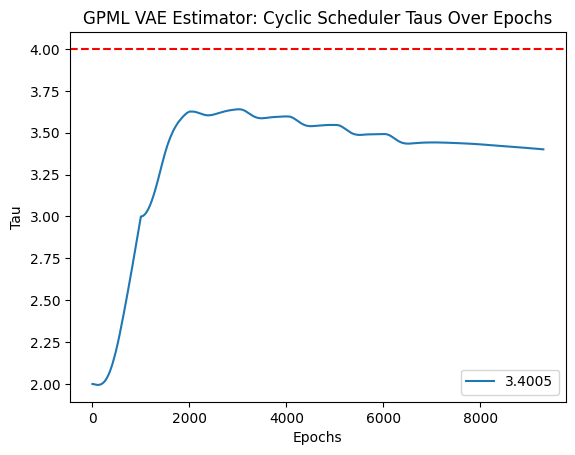

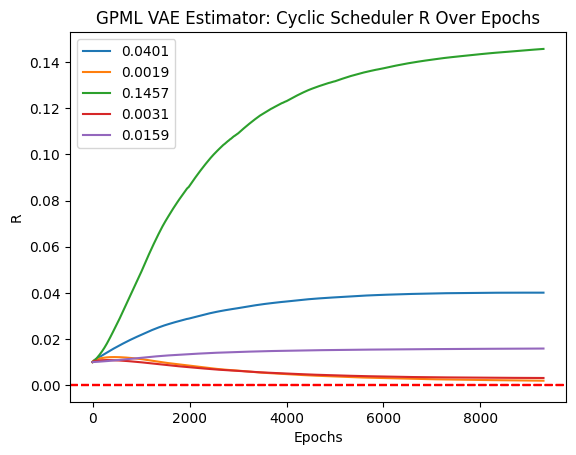

VAE Fit:  94%|█████████▍| 9400/10000 [1:51:24<07:04,  1.41it/s]

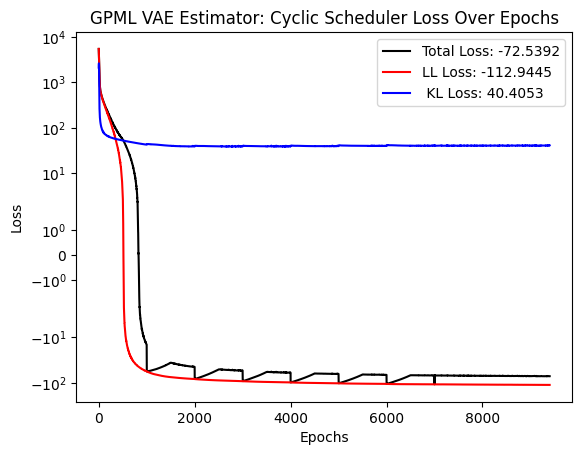

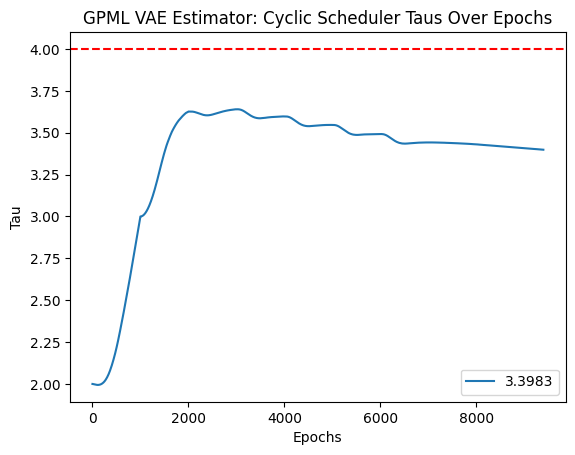

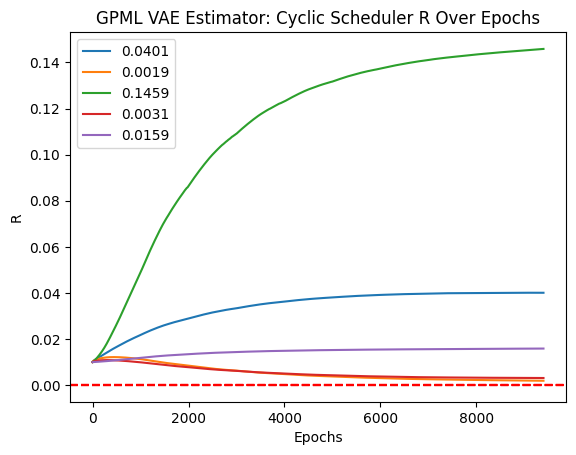

VAE Fit:  95%|█████████▌| 9500/10000 [1:52:41<06:36,  1.26it/s]

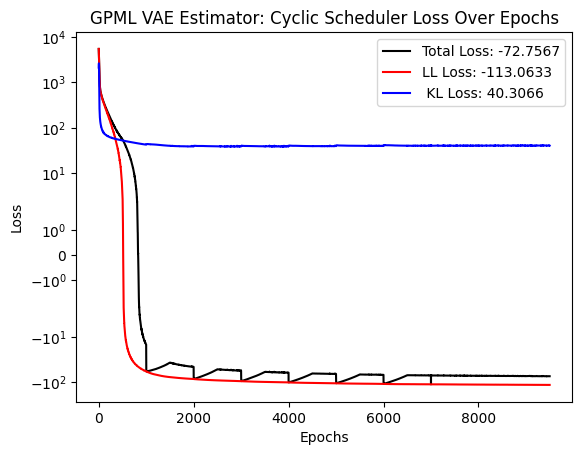

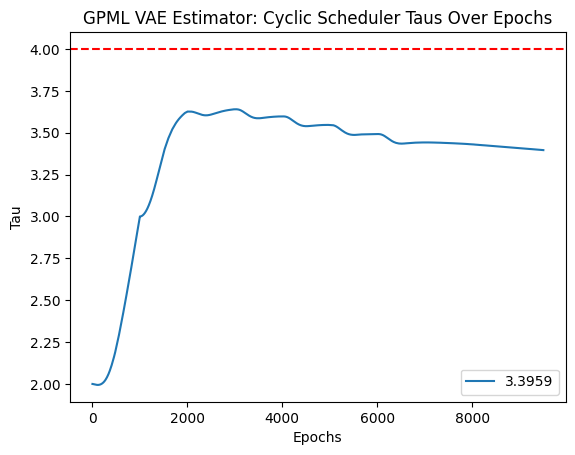

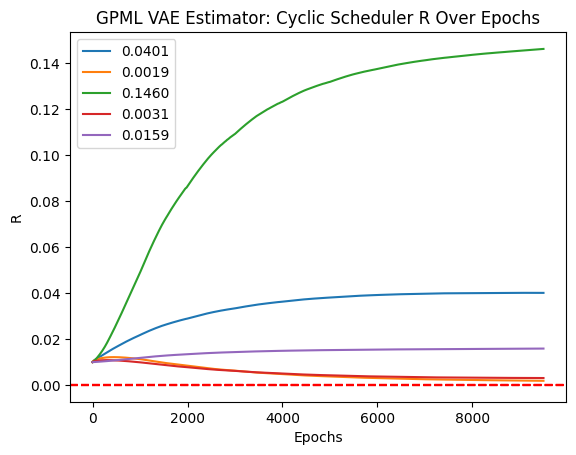

VAE Fit:  96%|█████████▌| 9600/10000 [1:53:59<04:49,  1.38it/s]

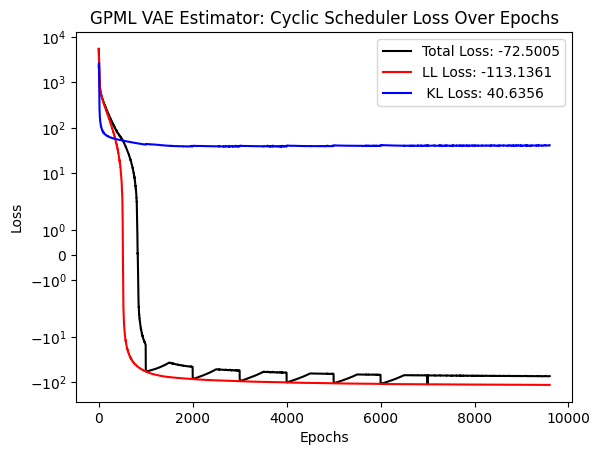

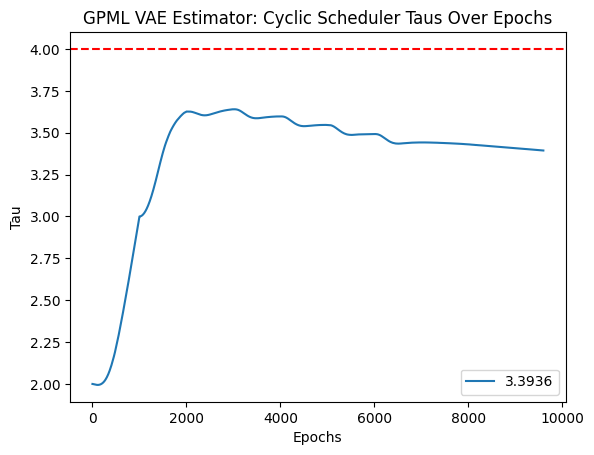

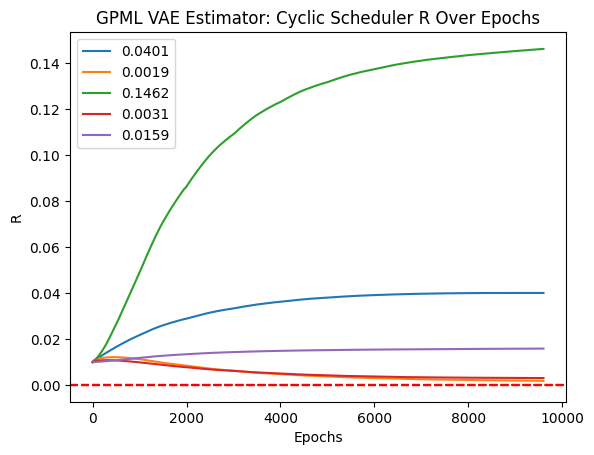

VAE Fit:  97%|█████████▋| 9700/10000 [1:55:13<03:34,  1.40it/s]

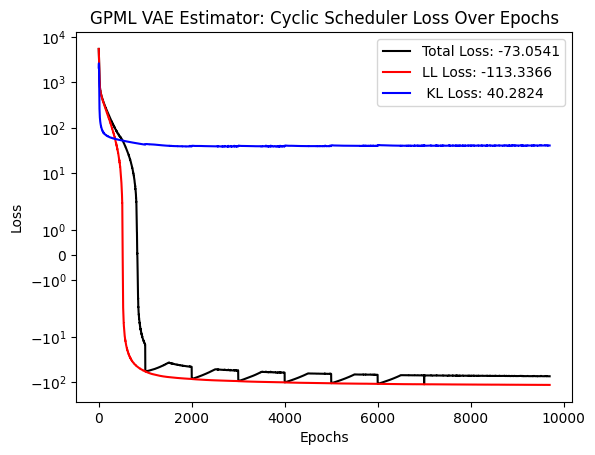

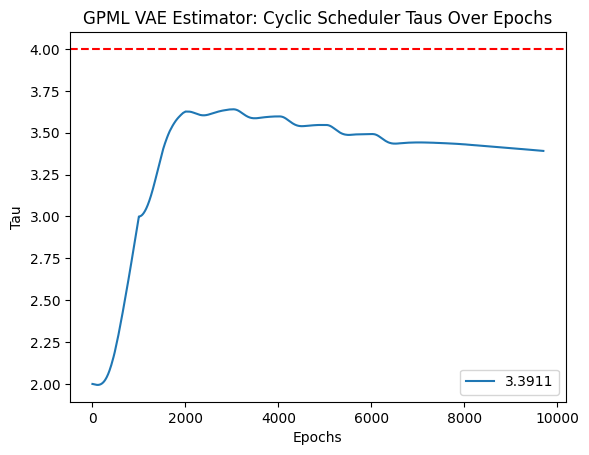

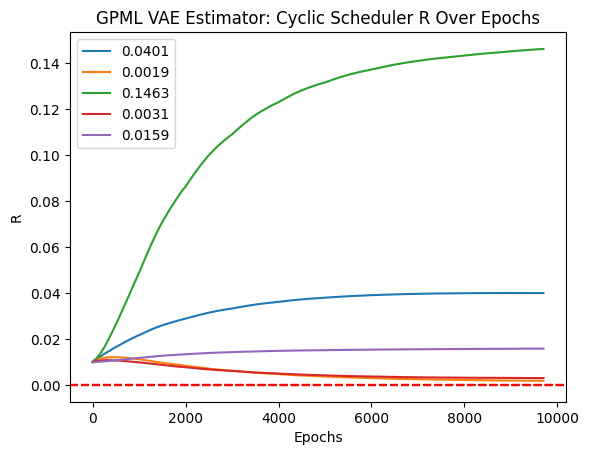

VAE Fit:  98%|█████████▊| 9800/10000 [1:56:28<02:20,  1.43it/s]

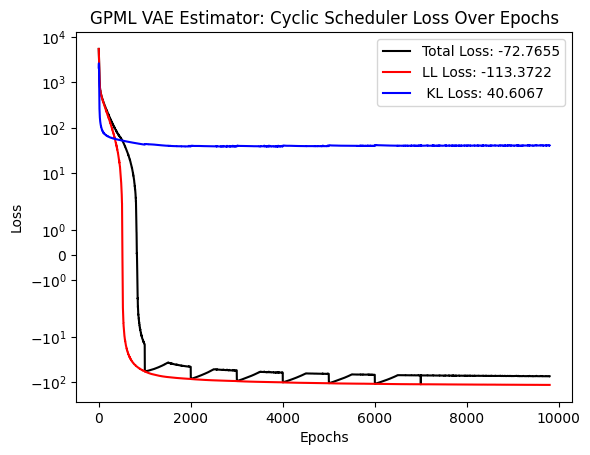

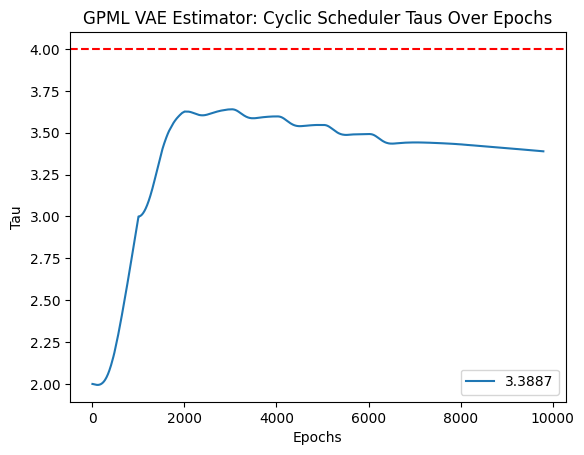

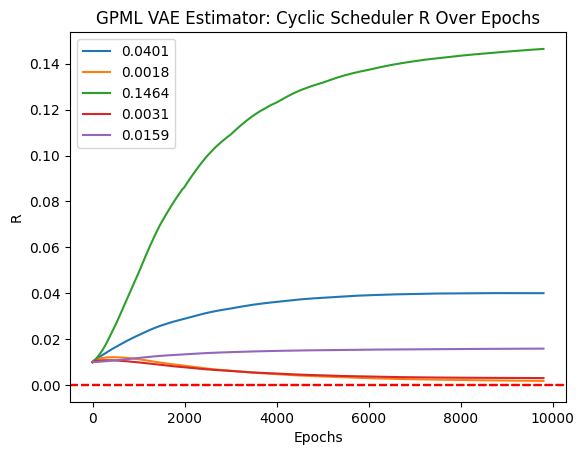

VAE Fit:  99%|█████████▉| 9900/10000 [1:57:45<01:10,  1.42it/s]

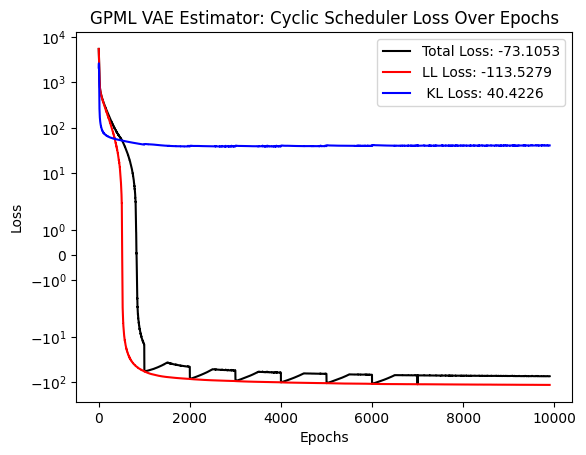

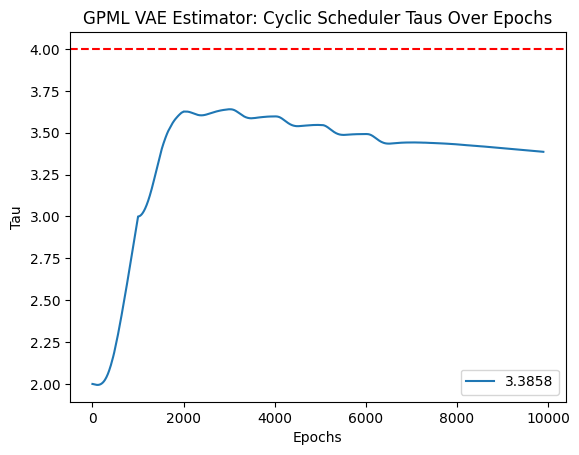

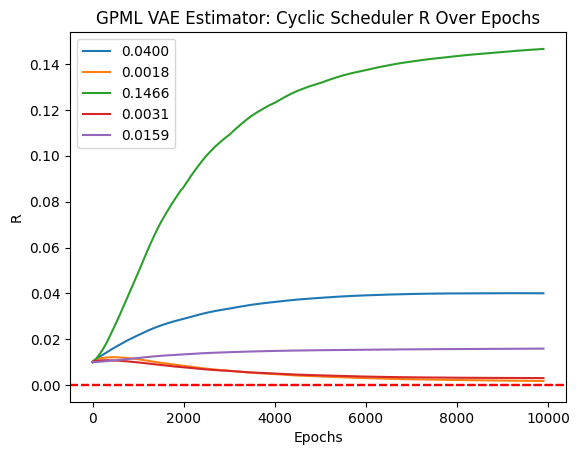

VAE Fit: 100%|██████████| 10000/10000 [1:59:00<00:00,  1.40it/s]


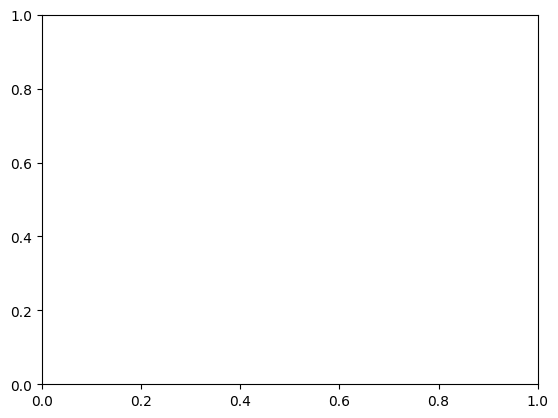

In [ ]:
def tester_parabola_cyclic():
    device = "cuda"
    latent_dims = 1
    observation_dims = 5
    true_taus = [4.0]
    true_R_diag = 0.0001
    hetero_r = True
    if hetero_r:
        true_R_diag = [true_R_diag]*observation_dims
    signal_sds = 0.99
    noise_sds = 1 - signal_sds

    with torch.no_grad():
        forward_model = HighDParabolaDecoder(latent_dims,observation_dims,device=device,alpha=1.0)
        parabola_dataset = dataset_constructor(forward_model,latent_dims, observation_dims,taus = true_taus,R_diag=true_R_diag,
                                               samples=1000,time_divisions=30,time_end=20.0,signal_sds=signal_sds,
                                               noise_sds=noise_sds,device=device)
    #plots latent
    plot_dataset(parabola_dataset,0)
    #test_encoder = TestEncoder(latent_dims,parabola_dataset["times"],parabola_dataset["model"])
    #linear encoder as is works
    #LinearEncoder(1,2,len(linear_dataset["times"]))
    #encoder = FeedforwardEncoder([(2000,nn.LeakyReLU()),(2000,nn.LeakyReLU())],
    #                             latent_dims,observation_dims,len(parabola_dataset["times"]))#
    encoder = FeedforwardEncoder([(4000,nn.LeakyReLU()),(4000,nn.LeakyReLU())],
                                 latent_dims,observation_dims,len(parabola_dataset["times"]),device=device,rank=0)
    fit_decoder =  FeedforwardNNDecoder([(30, nn.LeakyReLU())],latent_dims=latent_dims,observed_dims=observation_dims,device=device)
    #FeedforwardNNDecoder([(30, nn.LeakyReLU()),(30, nn.LeakyReLU())],latent_dims=latent_dims,observed_dims=observation_dims)
    #ConvexFeedforward([30],[30],latent_dims,observation_dims)
    #if didnt work, try with correct decoder
    #try fixing R and decoder, see if taus go correct
    vae = GPML_VAE(device,latent_dims,observation_dims,parabola_dataset["times"],encoder,forward_model,
                   train_decoder=False,initial_R_diag=[0.01]*observation_dims,train_R_diag=True,train_taus=True,initial_taus=[2.0]*latent_dims,
                   train_encoder=True,signal_sds=[signal_sds]*latent_dims,noise_sds=[noise_sds]*latent_dims)
    c_vae = torch.compile(vae)
    epochs = 10000
    c_vae.fit(parabola_dataset["X"],None,lr=1e-6,epochs=epochs,batch_size=100,approx_elbo_loss_samples=1,grad_clip=1000.0,
            hyper_scheduler=cycler(epochs,1000,0.8,0.5),mm=0.7,plotting_true_taus=true_taus,plotting_true_R_diag=true_R_diag,log_save_name="Cyclic Scheduler")
tester_parabola_cyclic()